<a href="https://colab.research.google.com/github/hanukatreddy/hanu/blob/master/Time_Series_Prediction_of_Mall_footfall_Updated.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1 - Objective and Problem statement

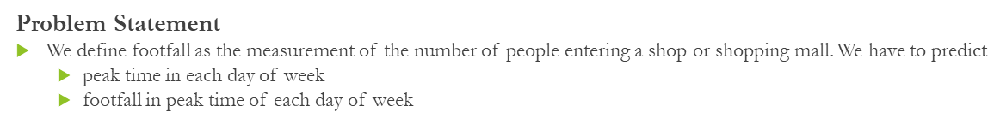

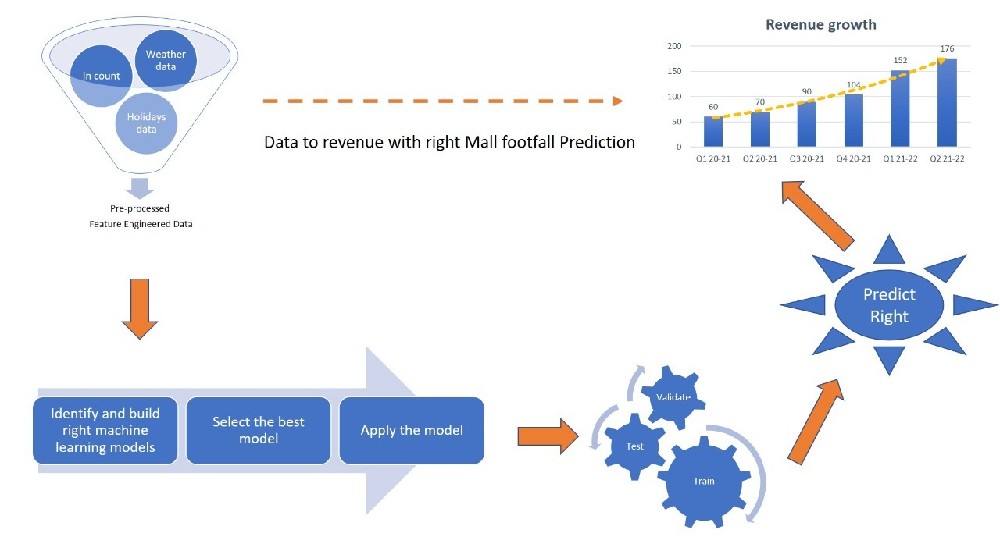

# 2 - High level Flow and architecture

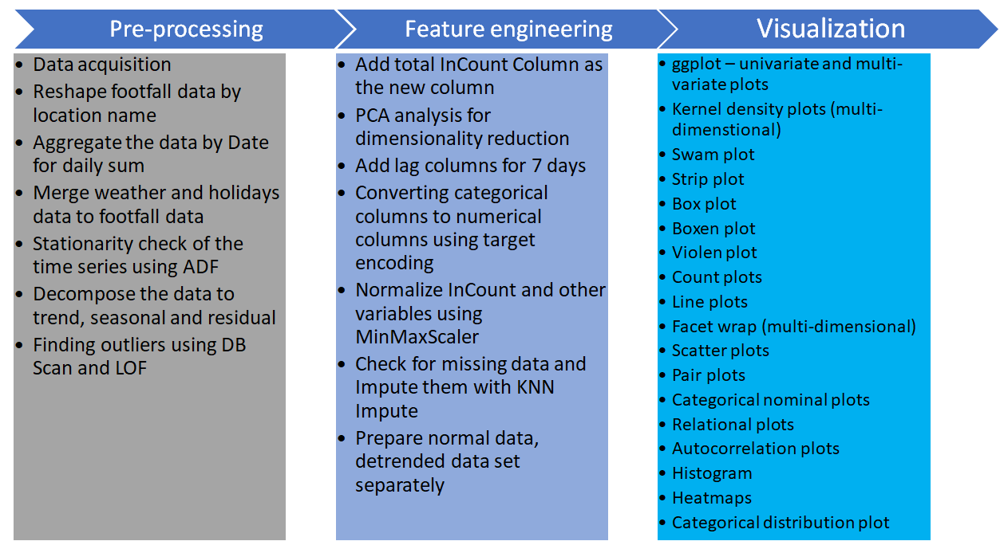

## 3 - Pre-processing & Feature Engineering

## 3.1 Data Acquisition

In [ ]:
!pip install --upgrade category_encoders
!pip install pmdarima
!pip install statsmodels --upgrade

     |████████████████████████████████| 81kB 3.5MB/s 
     |████████████████████████████████| 1.5MB 5.7MB/s 
     |████████████████████████████████| 2.1MB 25.5MB/s 
     |████████████████████████████████| 9.5MB 47.6MB/s 
  Found existing installation: Cython 0.29.21
    Uninstalling Cython-0.29.21:
      Successfully uninstalled Cython-0.29.21
  Found existing installation: statsmodels 0.10.2
    Uninstalling statsmodels-0.10.2:
      Successfully uninstalled statsmodels-0.10.2
Requirement already up-to-date: statsmodels in /usr/local/lib/python3.6/dist-packages (0.12.2)


In [ ]:
!pip install plotnine
!pip install dython
!pip install RegscorePy
!pip install catboost
!pip install -U yellowbrick





     |████████████████████████████████| 65.8MB 68kB/s 
     |████████████████████████████████| 276kB 4.1MB/s 
  Found existing installation: yellowbrick 0.9.1
    Uninstalling yellowbrick-0.9.1:
      Successfully uninstalled yellowbrick-0.9.1


In [ ]:
#!pip install http://h2o-release.s3.amazonaws.com/h2o/rel-zermelo/1/Python/h2o-3.32.0.1-py2.py3-none-any.whl

     |████████████████████████████████| 164.6MB 1.1MB/s 


In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from sklearn.preprocessing import LabelEncoder
from datetime import datetime
import calendar
from sklearn.preprocessing import MinMaxScaler
from category_encoders.target_encoder import TargetEncoder
import missingno as msno
from sklearn.impute import KNNImputer
import warnings
warnings.filterwarnings("ignore")
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN
from sklearn.neighbors import LocalOutlierFactor
from plotnine import *
from scipy import signal, fftpack
from statsmodels.tsa.seasonal import seasonal_decompose
from dateutil.parser import parse
from statsmodels.tsa.seasonal import STL
from dython import nominal
from statsmodels.tsa.stattools import adfuller, acf

from sklearn.decomposition import PCA
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf


# plotly
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly.graph_objs import Scatter, Figure, Layout
import plotly
import plotly.graph_objs as go
from tabulate import tabulate

# yellowbrick model visualizations
from yellowbrick.features import ParallelCoordinates
from yellowbrick.model_selection import FeatureImportances
from yellowbrick.regressor import ResidualsPlot
from yellowbrick.regressor import PredictionError

# regression models
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import HuberRegressor
from sklearn.linear_model import LassoLars
from sklearn.linear_model import PassiveAggressiveRegressor
from sklearn.linear_model import SGDRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.tree import ExtraTreeRegressor
from sklearn.svm import SVR
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.ensemble import GradientBoostingRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor
from sklearn.base import clone
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.model_selection import train_test_split, RandomizedSearchCV, KFold, cross_val_predict, cross_val_score,cross_validate
from sklearn.feature_selection import RFECV
from sklearn.metrics import make_scorer
from scipy.stats import loguniform
from RegscorePy import *
from math import log

# neural network model
from sklearn.neural_network import MLPRegressor
# LSTM models
#from keras.models import Sequential
#from keras.layers import Dense, Add, Concatenate, Reshape
#from keras.layers import LSTM, ConvLSTM2D, Bidirectional
#from keras.layers import Dropout, Average, RepeatVector, LeakyReLU, BatchNormalization
#from keras import optimizers
#from keras.optimizers.schedules import ExponentialDecay
#from keras.callbacks import ModelCheckpoint
#from keras.callbacks import ReduceLROnPlateau
#from keras.callbacks import LearningRateScheduler
#from keras.layers.merge import concatenate


#from keras.engine import training
#from keras.models import Model, Input

#from keras.layers import Flatten
#from keras.layers import TimeDistributed
#from keras.layers.convolutional import Conv1D
#from keras.layers.convolutional import MaxPooling1D
#from keras.callbacks import Callback
#from keras.models import load_model
#from keras.optimizers import Adam

# H2O models
#import h2o
#from h2o.estimators.gbm import H2OGradientBoostingEstimator
#from h2o.estimators import H2ORandomForestEstimator
#from h2o.estimators.stackedensemble import H2OStackedEnsembleEstimator
#from sklearn.pipeline import Pipeline
#from h2o.cross_validation import H2OKFold
#from h2o.model.regression import h2o_r2_score
#from h2o.grid.grid_search import H2OGridSearch
#from h2o.automl import H2OAutoML
#h2o.init()

# Fb prophet models
#from fbprophet import Prophet
#from fbprophet.plot import plot_plotly, plot_components_plotly

# ARIMA model
#from statsmodels.tsa import arima_model
#from statsmodels.tsa.arima.model import ARIMA
#import pmdarima as pm
#from pmdarima.pipeline import Pipeline
#from pmdarima.preprocessing import BoxCoxEndogTransformer

import glob
import os
from keras import backend as K


In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

dataset_folder = '/content/drive/My Drive/FootFallData'

Mounted at /content/drive


In [ ]:
df_foot_fall =pd.read_csv('/content/drive/MyDrive/FootFallData/footfall.csv')
df_weather_data= pd.read_csv('/content/drive/MyDrive/FootFallData/overall_weather.csv')
df_easter_sunday_holiday_data= pd.read_csv('/content/drive/MyDrive/FootFallData/Easter-Sundays.csv')
df_university_long_holidays_data= pd.read_csv('/content/drive/MyDrive/FootFallData/uni_hols_long.csv')
df_UK_bank_holidays_data= pd.read_csv('/content/drive/MyDrive/FootFallData/UKbankholidays.csv')
df_school_long_holidays_data= pd.read_csv('/content/drive/MyDrive/FootFallData/school_hols_long.csv')

## 4.2 Data preparation

In [ ]:

df_foot_fall.shape


(554360, 15)

In [ ]:
df_easter_sunday_holiday_data.shape

(18, 2)

In [ ]:
df_foot_fall.info

<bound method DataFrame.info of               Date  InCount  BRCWeek  ...  Week_yr          Hour_yr week_no
0       01-01-2009      268       53  ...  00-2009  00, 01-Jan-2009       1
1       01-01-2009      366       53  ...  00-2009  00, 01-Jan-2009       1
2       01-01-2009      273       53  ...  00-2009  00, 01-Jan-2009       1
3       01-01-2009      219       53  ...  00-2009  00, 01-Jan-2009       1
4       01-01-2009      132       53  ...  00-2009  00, 01-Jan-2009       1
...            ...      ...      ...  ...      ...              ...     ...
554355  31-12-2016      205       52  ...  52-2016  00, 31-Dec-2016      52
554356  31-12-2016      405       52  ...  52-2016  00, 31-Dec-2016      52
554357  31-12-2016      353       52  ...  52-2016  00, 31-Dec-2016      52
554358  31-12-2016      348       52  ...  52-2016  00, 31-Dec-2016      52
554359  31-12-2016      316       52  ...  52-2016  00, 31-Dec-2016      52

[554360 rows x 15 columns]>

In [ ]:
df_foot_fall.head()

,Date,InCount,BRCWeek,LocationName,Hour,Weekday,NewDate,Month,Year,Day,Day_yr,Month_yr,Week_yr,Hour_yr,week_no
0,01-01-2009,268,53,Briggate,0,Thursday,01-Jan-09,1,2009,1,Thursday/01-Jan-2009,Jan-09,00-2009,"00, 01-Jan-2009",1
1,01-01-2009,366,53,Briggate,1,Thursday,01-Jan-09,1,2009,1,Thursday/01-Jan-2009,Jan-09,00-2009,"00, 01-Jan-2009",1
2,01-01-2009,273,53,Briggate,2,Thursday,01-Jan-09,1,2009,1,Thursday/01-Jan-2009,Jan-09,00-2009,"00, 01-Jan-2009",1
3,01-01-2009,219,53,Briggate,3,Thursday,01-Jan-09,1,2009,1,Thursday/01-Jan-2009,Jan-09,00-2009,"00, 01-Jan-2009",1
4,01-01-2009,132,53,Briggate,4,Thursday,01-Jan-09,1,2009,1,Thursday/01-Jan-2009,Jan-09,00-2009,"00, 01-Jan-2009",1


In [ ]:
df_foot_fall.shape

(554360, 15)

### 4.2.1 Global parameters

In [ ]:
global_parameters = {
    "encoded_variables" : ['Weekday','Month','Day','Year', 'Week_no', 'abnormal_rain','high_temp','low_temp','high_wind','EasterSundayHoliday',
                'University_holidays','School_holidays','UKBankHoliday'],
    "input_cols_regression" : ['Month','Weekday','Day','Week_no','mean_temp','rain','wind_speed','abnormal_rain','high_temp','low_temp','high_wind','EasterSundayHoliday',
                  'University_holidays','School_holidays','UKBankHoliday'],
    "input_cols_regression_weekly" : ['Year','Week_no','mean_temp','rain','wind_speed'],
    "input_cols_GAN" :  ['Weekday','InCountTotal'],

    "input_cols_reg_with_extra_features" : ['Month','Weekday','Day','Week_no','mean_temp','rain','wind_speed','abnormal_rain','high_temp','low_temp','high_wind','EasterSundayHoliday',
                  'University_holidays','School_holidays','UKBankHoliday','Day sin','Month sin','Month cos','rolling_mean_incount', 'seasonal_incount','trend_incount'],
    "input_cols_neural_networks" : ['Month','Weekday','Day','Week_no','mean_temp','rain','wind_speed','abnormal_rain','high_temp','low_temp','high_wind','EasterSundayHoliday',
                  'University_holidays','School_holidays','UKBankHoliday','rolling_mean_incount','seasonal_incount','trend_incount','InCountTotal'],
    "input_cols_neural_networks_extra_features" : ['Month','Weekday','Day','Week_no','mean_temp','rain','wind_speed',
                  'University_holidays','School_holidays','UKBankHoliday','Day sin','Month sin','Month cos','rolling_mean_incount', 'seasonal_incount','trend_incount','InCountTotal'],
    #"deterministic_features" : ['Month','Weekday','Day','Week_no','EasterSundayHoliday',
     #             'University_holidays','School_holidays','UKBankHoliday','Day sin','Month sin','Month cos'],
    "deterministic_features" : ['Month','Weekday','Day','Week_no','EasterSundayHoliday',
                  'University_holidays','School_holidays','UKBankHoliday'],
    "input_cols_normalization" :['mean_temp','rain','wind_speed','Day sin','Week sin','Week cos','Month sin','Month cos','Year sin','Year cos'],
    "target_col_h2o":['InCountTotal_forecast1'],
    "data_set_days": 365*4, #4 years total data
    "test_data_set_days":365, # 1 year test data
    "test_data_set_weeks" : 30, # 30 weeks for test data
    "data_set_hours" : 24*365*3, # 24hours , 365 days, 3 years
    "n_timesteps" : 7,
    "n_forecast_steps" : 1,
    "train_split" : 0.8,
    "validation_split":0.1,
    "test_split":0.1,
    "lstm_training_needed" : False

}

### 4.2.2 MultiColumnEncoder Class

In [ ]:
class MultiColumnEncoder:
    def __init__(self,Categoricalcolumns = None,includedcolumns=None):
        self.columns = Categoricalcolumns # array of column names to encode
        self.included_cols = includedcolumns

    def fit(self,X,y=None):
        return self # not relevant here

    def transform_LabelEncoder(self,X):
        '''
        Transforms columns of X specified in self.columns using
        LabelEncoder(). If no columns specified, transforms all
        columns in X.
        '''
        output = X.copy()
        if self.columns is not None:
            for col in self.columns:
                output[col] = LabelEncoder().fit_transform(output[col])
        else:
            for colname,col in output.iteritems():
                output[colname] = LabelEncoder().fit_transform(col)
        return output

    def onehot_encode_integers(self, df):
        df = df.copy()
        df_encoded = pd.get_dummies(df, columns = self.included_cols)
        return df_encoded

    def fit_transform(self,X,y=None,encoding_type = 'target_encoding'):
      if encoding_type == 'onehot_encoding':
        return self.onehot_encode_integers(X)
      elif encoding_type == 'target_encoding':
        return self.target_encoding(X,y)

    def target_encoding(self,X, target_column):
        return TargetEncoder(cols=self.included_cols).fit_transform(X,X[target_column])



### 4.2.3 Lagging Class

In [ ]:
class Lagging:
  def __init__(self, location_name_list=None, n_timesteps=7, n_forecast_steps=1):
      self.n_timesteps = n_timesteps
      self.location_name_list = location_name_list # array of locations
      self.n_forecast_steps = n_forecast_steps

  def createforecastTargetVariables(self, df):
    # copy the InCount to other forecast columns
    for forecast_step in range(1, self.n_forecast_steps+1):
      df['InCountTotal'+'_forecast'+str(forecast_step)] = df['InCountTotal']

    #update multistep output variables
    for i in range(0, df.shape[0]-self.n_forecast_steps):
      for forecast_step in range(1, self.n_forecast_steps+1):
        df['InCountTotal'+'_forecast'+str(forecast_step)][i] = df['InCountTotal'][i+forecast_step]

    #remove the last nforecast rows as these do not have proper values after creating the forecast variables
    df.drop(df.tail(self.n_forecast_steps).index,inplace=True)
    return df

  def createLagVariables(self,df,location_wise_data = True): #Create lag variables of size=n_timesteps
      if location_wise_data == True:#location wise data
        for location in self.location_name_list:
            location = 'InCount'+location
            for lag in range(0, self.n_timesteps):
                df[location+'_lag'+str(lag+1)] = df[location].shift(periods=lag)
      else:# totalincount only
        for lag in range(0, self.n_timesteps):
            df['InCountTotal'+'_lag'+str(lag+1)] = df['InCountTotal'].shift(periods=lag)

      df.dropna(inplace = True)
      return df

  def createLagDiffVariables(self,df,location_wise_data = True): #Create lag variables of size=n_timesteps
    if location_wise_data == True:#location wise data
      for location in self.location_name_list:
        location = 'InCount'+location
        for lag in range(1, self.n_timesteps+1):
          df[location+'_lag'+str(lag)] = df[location].diff(periods=lag)
    else:# totalincount only
      for lag in range(1, self.n_timesteps+1):
          df['InCountTotal'+'_lag'+str(lag)] = df['InCountTotal'].diff(periods=lag)

    df.dropna(inplace = True)
    return df


### 4.2.4 Pre_Processing Class

In [ ]:
class pre_processing:
  def __init__(self,data_frame):
        self.data_frame = data_frame.copy() # which data_frame to pre-process
        self.location_name_list = []
        self.location_name_col_list=[]
        self.scaler_target = MinMaxScaler(feature_range = (0, 1))
        self.scaler_input = MinMaxScaler(feature_range = (0,1))
        self.scaler_target_each_location = MinMaxScaler(feature_range = (0,1))
        self.scaler_prophet = MinMaxScaler(feature_range = (0,1))
  def cleanup_data(self, col_name='Date'):
     # there is a white space in one of the date values in Easter holidays list. We need to remove that
     if( col_name in self.data_frame.columns):
        self.data_frame[col_name] = self.data_frame[col_name].str.replace(' ', '')
     return self.data_frame
  def aggregate(self,group_by_cols, retain_list=None):
      '''
      aggregate the column values based on conditions
      '''
      retain_list = {}
      # add all the location name columns to retain list
      for location_name in self.location_name_list:
        key = 'InCount'+location_name
        retain_list[key] = 'sum'
      # now aggregate based on Date
      self.data_frame = self.data_frame.groupby(group_by_cols).agg(retain_list).reset_index()
      return self.data_frame
  def createWeeklyData(self, data_frame):
    group_by_cols = ['Year','Week_no']
    retain_list = { 'InCountTotal':'sum', 'Month':'first', 'mean_temp':'mean', 'rain':'mean','wind_speed':'mean'}
    df = data_frame.groupby(group_by_cols).agg(retain_list).reset_index()
    return df

  def reshape_location_name(self, group_by_cols, target_col='InCount'):# Review this

      '''data_temp_df = pd.DataFrame(data=self.data_frame[['Date','Weekday','Month']])
      data_temp_df.drop_duplicates('Date', inplace=True)

      self.location_name_list = self.data_frame["LocationName"].unique()

      self.data_frame = self.data_frame.pivot_table(index=group_by_cols, columns='LocationName',values=[target_col]).reset_index()
      self.data_frame.columns = [''.join(col) for col in self.data_frame.columns]'''

      self.data_frame['Date'] = pd.to_datetime(self.data_frame['Date']).dt.strftime('%d-%b-%Y')
      self.location_name_list = self.data_frame["LocationName"].unique()

      self.data_frame = self.data_frame.pivot_table(index=group_by_cols, columns='LocationName',values=[target_col]).reset_index()
      self.data_frame.columns = [''.join(col) for col in self.data_frame.columns]

      #return self.data_frame.merge(data_temp_df, on='Date', how='inner')

  def encode_variables(self,included_cols, target_variable = 'InCountTotal', encoding_type = 'target_encoding'):
      '''
      categorical/target encoding of the column values
      '''
      self.data_frame = MultiColumnEncoder(includedcolumns = included_cols).fit_transform(self.data_frame,target_variable,encoding_type = 'target_encoding')
      return self.data_frame
  def imputeData(self):
      # fill missing values with mean column values as only missing column i see is InCountAlbionStSouth
      #print('impute data')
      self.data_frame.fillna(self.data_frame.mean(), inplace=True)
      return self.data_frame
  def pre_process(self,data_frame_type='Foot_Fall'):
      '''
      for different data frame types, do the different pre-processibg
      '''

      if(data_frame_type == 'EasterSunday'):
          # cleanup the date columns
          self.data_frame  = self.cleanup_data(col_name='Date')

      return self.data_frame


  def merge_data(self, data_to_merge, col_by ='Date'):
      data_to_merge['Date'] = pd.to_datetime(data_to_merge['Date']).dt.strftime('%d-%b-%Y')
      self.data_frame = self.data_frame.merge(data_to_merge, how='inner', left_on=col_by, right_on=col_by)
      return self.data_frame
  def add_new_column(self, data_to_add, new_col_name, source_date_format = '%d-%b-%Y', destination_date_format = '%m-%d-%Y' ):
      self.data_frame['Tempcolumn'] = pd.to_datetime(self.data_frame['Date'], format = source_date_format).dt.strftime('%d/%m/%Y')

      temp_data = data_to_add.copy()

      temp_data['Tempcolumn'] = pd.to_datetime(temp_data['Date'],format = destination_date_format).dt.strftime('%d/%m/%Y')

      self.data_frame[new_col_name] = (self.data_frame.set_index(['Tempcolumn']).index.isin(temp_data.set_index(['Tempcolumn']).index)).astype(int)
      temp_data.drop(['Tempcolumn'],axis=1)

      self.data_frame.drop(['Tempcolumn'],axis=1, inplace=True)

      return self.data_frame
  def createExtraDateColumns(self):

    date_time = pd.to_datetime(self.data_frame["Date"], format='%d-%b-%Y')
    timestamp_s = date_time.map(datetime.timestamp)

    dt_object = datetime.fromtimestamp(timestamp_s[0])
    print("dt_object:", dt_object)
    print("type(dt_object): ", type(dt_object))


    day = 24*60*60
    week = 7*day
    month = 31*day
    year = (365.2425)*day

    self.data_frame['Day sin'] = np.sin(timestamp_s * (2 * np.pi / day))
    #self.data_frame['Day cos'] = np.cos(timestamp_s * (2 * np.pi / day))
    self.data_frame['Week sin'] = np.sin(timestamp_s * (2 * np.pi / week))
    self.data_frame['Week cos'] = np.cos(timestamp_s * (2 * np.pi / week))
    self.data_frame['Month sin'] = np.sin(timestamp_s * (2 * np.pi / month))
    self.data_frame['Month cos'] = np.cos(timestamp_s * (2 * np.pi / month))
    self.data_frame['Year sin'] = np.sin(timestamp_s * (2 * np.pi / year))
    self.data_frame['Year cos'] = np.cos(timestamp_s * (2 * np.pi / year))



    return self.data_frame
  def createExtraFeatures(self, n_timesteps=7):
    # add seasonal and trend columns
    # Additive Decomposition
    result_add = seasonal_decompose(self.data_frame['InCountTotal'], model='additive',  freq=30)
    self.data_frame['seasonal_incount'] = result_add.seasonal
    self.data_frame['trend_incount'] = result_add.trend
    # rolling mean column
    self.data_frame['rolling_mean_incount'] = self.data_frame['InCountTotal'].shift(1).rolling(window=n_timesteps).mean()
    #expanding window
    self.data_frame['expanding_mean_incount'] = self.data_frame['InCountTotal'].shift(1).expanding(2).mean()
    return self.data_frame

  def createTimeSeries(self):
      self.data_frame["DateTime"] = pd.to_datetime(self.data_frame.Date.astype(str))
      self.data_frame = self.data_frame.set_index("DateTime")
      self.data_frame.drop(['Date'], inplace=True, axis=1)
      self.data_frame = self.data_frame.sort_index()

      self.data_frame['Month']=self.data_frame.index.month
      self.data_frame['Year']=self.data_frame.index.year
      self.data_frame['Day']= self.data_frame.index.day
      self.data_frame['Weekday']=self.data_frame.index.weekday
      self.data_frame['Week_no']=self.data_frame.index.week

      for i in range(len(self.data_frame)):
          self.data_frame['Weekday'].iloc[i]=calendar.day_name[self.data_frame['Weekday'].iloc[i]]

      return self.data_frame

  def createStationarySeries(self, col_name = 'InCountTotal', lag=1):
    # check for stationarity

    result = adfuller(self.data_frame[col_name].dropna())
    print("ADF test results for ",col_name )
    print('ADF Statistic: %f' % result[0])
    print('p-value: ', result[1])
    print('full result ', result)
    print("========================")

    for location in self.location_name_col_list:
      result = adfuller(self.data_frame[location].dropna())
      print("ADF test results for ",location )
      print('ADF Statistic: %f' % result[0])
      print('p-value: ', result[1])
      print('full result ', result)
      print("========================")

    #self.data_frame[col_name] = self.data_frame[col_name].diff(periods=lag)
    #self.data_frame.dropna(inplace = True)
    return self.data_frame

  def checkForMissingValues(self, location_name_list):
        for location in location_name_list:
            self.data_frame.loc[self.data_frame[self.data_frame['InCount'+location]==0].index,'InCount'+location] = np.NaN
        return self.data_frame

  def createLag_ForecastVariables(self,location_name_list=None, n_timesteps=7,n_forecast_steps = 1, location_wise_data = True):
      nLagClass = Lagging(location_name_list,n_timesteps, n_forecast_steps)
      self.data_frame = nLagClass.createLagVariables(self.data_frame,location_wise_data = location_wise_data)
      # create lag data for total mall incount
      #self.data_frame = nLagClass.createLagDiffVariables(self.data_frame, location_wise_data = location_wise_data)
      self.data_frame = nLagClass.createforecastTargetVariables(self.data_frame)

      return self.data_frame

  def addTotalIncountColumn(self):
    self.location_name_col_list=['InCount'+x for x in self.location_name_list]
    self.data_frame['InCountTotal'] = self.data_frame[self.location_name_col_list].sum(axis=1)
    self.data_frame['InCountTotal'] = self.data_frame['InCountTotal'].astype(int)
    return self.data_frame

  def normalizeTargetVariable(self):
    #print('normalization')
    self.data_frame[['InCountTotal']] = self.scaler_target.fit_transform(self.data_frame[['InCountTotal']])

    location_name_col_list=['InCount'+x for x in self.location_name_list]
    for location_col in location_name_col_list:
      self.data_frame[[location_col]] = self.scaler_target_each_location.fit_transform(self.data_frame[[location_col]])
    return self.data_frame


  def normalizeInputVariables(self, included_cols=None):
     #print('normalize input variables')
     self.data_frame[included_cols] = self.scaler_input.fit_transform(self.data_frame[included_cols])
     return self.data_frame

  def visualizeMissingValues(self):
       #print('missing values visualization')
       msno.bar(self.data_frame)

  #Imputation using KNN
  def imputeDataWithKnn(self):
    X = self.data_frame[['InCountCommercialStBarratts', 'InCountCommercialStLush']]
    imputer = KNNImputer(n_neighbors=2)
    imputed_df = imputer.fit_transform(X)
    imputed_df = pd.DataFrame(imputed_df, columns=X.columns)
    #print(imputed_df)
    #print(self.data_frame['InCountCommercialStBarratts'])
    self.data_frame['InCountCommercialStBarratts'] = imputed_df.values
    return self.data_frame

  #imputation using IterativeImputer which works similar to MICE
  def imputeDataWithIterativeImputation(self):
    X = self.data_frame[['InCountCommercialStBarratts', 'InCountCommercialStLush']]
    imputer = IterativeImputer(max_iter=10, verbose=0)
    imputed_df = imputer.fit_transform(X)
    imputed_df = pd.DataFrame(imputed_df, columns=X.columns)
    #print(imputed_df)
    #print(self.data_frame['InCountCommercialStBarratts'])
    self.data_frame['InCountCommercialStBarratts'] = imputed_df.values
    return self.data_frame


  def findoutliers_DBSCAN(self,columns,number_near):
      # This finction takes as input, the dataframe name, columns to be analysed for the outlier, nearesr neighbours to be considered as input
      # A new boolean column for outlier will be added with name Outlier_+column name and it will have values 1  If outlier and 0 otherwise
      # optimal eps is calculated based on distances
      nc=0
      fig, axs = plt.subplots(len(columns),figsize=(15,15))
      fig.tight_layout(pad=3.0)
      for col in columns:
          # finding the distances based on nearest neighbour to find optimal eps
          neigh = NearestNeighbors(n_neighbors=number_near)
          nbrs = neigh.fit(np.array(self.data_frame[col]).reshape(-1,1))
          distances, indices = nbrs.kneighbors(np.array(self.data_frame[col]).reshape(-1,1))
          distances = np.sort(distances, axis=0)
          distances = distances[:,1]

          # If plotted on a graph, a point with maximum curvature. , ie, a point with maximum slope gives the best eps
          maxslope=0
          neps=0
          diff=[] # A list to hold the differences in the distances
          for i in range (len(distances)-1):
              slope=( (distances[i]-distances[i+1])/(indices[i][0]-indices[i+1][0]))
              if (slope<1 and maxslope<slope):
                  maxslope=slope
                  neps=distances[i]
          db=DBSCAN(eps=neps, min_samples=number_near).fit(np.array(self.data_frame[col]).reshape(-1,1))
          labels=db.labels_
          self.data_frame['Outliers_'+col] = [1 if val ==-1 else 0 for val in labels]
          # Visualizing the Outliers marked
          outlier=[]
          outlierindex=[]
          datapoint=[]
          dataindex=[]
          for j in range(len(labels)):
              if (labels[j]==-1):
                  outlier.append(self.data_frame[col][j])
                  outlierindex.append(indices[j][0])
              else:
                  datapoint.append(self.data_frame[col][j])
                  dataindex.append(indices[j][0])
          axs[nc].scatter(outlierindex,outlier,color='red')
          axs[nc].scatter(dataindex,datapoint,color='blue')
          axs[nc].set_title(col+" DBCSAN Outlers marked in Red")
          nc=nc+1
          n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
          n_noise_ = list(labels).count(-1)
          print(col+'Analysis')
          print('Optimal eps is ',neps)
          print('Estimated number of clusters: %d' % n_clusters_)
          print('Estimated number of noise points: %d' % n_noise_)
      plt.show
      return self.data_frame
  def findoutliers_lof(self,columns,number_near):
      # This finction takes as input, the dataframe name, columns to be analysed for the outlier, nearesr neighbours to be considered as input
      # A new boolean column for outlier will be added with name Outlier_+column name and it will have values 1  If outlier and 0 otherwise

      nc=0
      fig, axs = plt.subplots(len(columns),figsize=(15,15))
      fig.tight_layout(pad=3.0)
      for col in columns:
          clf = LocalOutlierFactor(n_neighbors=number_near)
          pred=clf.fit_predict(np.array(self.data_frame[col]).reshape(-1,1))
          #scores = clf.negative_outlier_factor_
          self.data_frame['Lof_Outlier'+col]=[1 if val ==-1 else 0 for val in pred]

          # Visualizing the Outliers marked
          outlier=[]
          outlierindex=[]
          datapoint=[]
          dataindex=[]

          for j in range(len(self.data_frame['Lof_Outlier'+col])):
              if (self.data_frame['Lof_Outlier'+col][j]==1):
                  outlier.append(self.data_frame[col][j])
                  outlierindex.append(j+1)
              else:
                  datapoint.append(self.data_frame[col][j])
                  dataindex.append(j+1)

          axs[nc].scatter(dataindex,datapoint,color='blue')
          axs[nc].scatter(outlierindex,outlier,color='red')
          axs[nc].set_title(col+" LOF Outlers marked in Red")
          nc=nc+1
      return self.data_frame

  def detrend_time_series(self, target_col='InCountTotal'):# using signal.detrend()
    inCountData = self.data_frame[target_col]
    self.data_frame[target_col] = signal.detrend(self.data_frame[target_col])
    de_trended_Incount = self.data_frame[target_col]

    from matplotlib import pyplot as plt
    plt.figure(figsize=(16, 8))
    plt.plot(inCountData, label="normal InCount")
    plt.plot(de_trended_Incount, label="detrended InCount")
    plt.legend(loc='best')
    plt.show()
    return self.data_frame

  def decomposeTimeSeries(self):

    # Multiplicative Decomposition
    result_mul = seasonal_decompose(self.data_frame['InCountTotal'], model='multiplicative',  freq=30)
    # Additive Decomposition
    result_add = seasonal_decompose(self.data_frame['InCountTotal'], model='additive',  freq=30)

    detrended = self.data_frame['InCountTotal'].values - result_add.trend - result_add.seasonal

    # Plot
    plt.rcParams.update({'figure.figsize': (16,8)})
    result_add.plot().suptitle('Additive Decompose using seasonal_decompose', fontsize=22)
    plt.show()

    plt.figure(figsize=(16, 8))
    plt.plot(detrended,label='detrended')
    plt.plot(self.data_frame['InCountTotal'], label="normal InCount")
    plt.show()

    plt.figure(figsize=(16, 8))
    result_add.resid.plot(kind='kde', title='residual Density')
    plt.show()

    self.data_frame['InCountTotal'] = detrended
    df_decomposed = pd.concat([result_add.seasonal, result_add.trend, result_add.resid, result_add.observed], axis=1)
    df_decomposed.columns = ['seas', 'trend', 'resid', 'actual_incount_total_values']
    self.data_frame = pd.concat([self.data_frame,df_decomposed], axis=1)

    self.data_frame.dropna(inplace = True)

  def decomposeTime_Series_for_locations(self):

    location_name_col_list=['InCount'+x for x in self.location_name_list]
    for location_col in location_name_col_list:
      # Multiplicative Decomposition
      result_add = seasonal_decompose(self.data_frame[location_col], model='additive',  freq=30)
      result_mul = seasonal_decompose(self.data_frame[location_col], model='multiplicative', freq=30)
      detrended = self.data_frame[location_col].values - result_add.trend - result_add.seasonal
      # Plot
      plt.rcParams.update({'figure.figsize': (16,8)})
      result_add.plot().suptitle('Additive Decompose using seasonal_decompose ' + location_col, fontsize=22)
      plt.show()

      plt.figure(figsize=(16, 8))
      result_add.resid.plot(kind='kde', title='residual Density for '+ location_col )
      plt.show()

      plt.figure(figsize=(16, 8))
      plt.plot(detrended,label='detrended '+ location_col)
      plt.plot(self.data_frame[location_col], label="normal InCount for "+ location_col)
      plt.show()
      self.data_frame[location_col] = detrended


  def decompose_STL(self):

    plt.rcParams.update({'figure.figsize': (16,8)})
    res = STL(self.data_frame['InCountTotal'], period=30).fit()

    detrended = self.data_frame['InCountTotal'].values - res.trend - res.seasonal

    res.plot().suptitle('Decompose InCountTotal using STL ', fontsize=22)
    plt.show()

    plt.figure(figsize=(16, 10))
    plt.plot(detrended, label='detrended data')
    plt.plot(self.data_frame['InCountTotal'], label='original data')
    plt.title('detrended and original data using STL')
    plt.show()

  def applypca(self,pcollist,ncomp=0,varpercent=0):
    # This function takes the dataframe on which Principal Component Analysis needs to be done and the % of variance expected to be retained
    # the function then returns the number of optimal principal components and the dataframe with those principal components.
    var_cum_variance = []
    pcadf=pd.DataFrame(self.data_frame[pcollist])
    if((ncomp>0) & (ncomp<=len(pcadf.columns))):
        pca = PCA(n_components=ncomp)
        principalComponents = pca.fit_transform(pcadf)
        var_cum_variance = np.cumsum(pca.explained_variance_ratio_)
        bestncomp=ncomp
        principalDf = (pd.DataFrame(data = principalComponents)).iloc[:,:bestncomp]
        contributionDf=pd.DataFrame(data=pca.components_,columns=pcadf.columns).loc[:bestncomp]
    elif((varpercent>0) & (varpercent<=100)):
        pca = PCA(n_components=len(pcadf.columns))
        principalComponents = pca.fit_transform(pcadf)
        varratio=pca.explained_variance_ratio_
        var_cum_variance = np.cumsum(pca.explained_variance_ratio_)
        for i in range(len(varratio)+1):
            if(varpercent>=np.sum(varratio[:i])*100):
                bestncomp=i
        principalDf = (pd.DataFrame(data = principalComponents)).iloc[:,:bestncomp]
        contributionDf=pd.DataFrame(data=pca.components_,columns=pcadf.columns).loc[:bestncomp]
    else:
        print('Incorrect parameters passed. Either numer of components- 0>ncomp>=number of columns OR the percent of variance to be retained -0 >varpercent >=100')
        bestncomp=-1
        principalDf = pd.DataFrame(data = [])

    return bestncomp,principalDf,contributionDf, var_cum_variance

  def findoutliersfulldata(self,number_near,metrics='euclidean'):
        odf=pd.DataFrame(self.data_frame)
        ncol=len(odf.columns)
        # finding the distances based on nearest neighbour to find optimal eps
        neigh = NearestNeighbors(n_neighbors=number_near,metric=metrics)
        nbrs = neigh.fit(np.array(odf).reshape(-1,ncol))
        distances, indices = nbrs.kneighbors(np.array(odf).reshape(-1,ncol))
        distance=[]
        for i in range (len(distances)):
          distance.append(np.sum(distances[i]))
        distance = np.sort(distance, axis=0)
        #distance = distance[:,1]
        # If plotted on a graph, a point with maximum curvature. , ie, a point with maximum slope gives the best eps
        maxslope=0
        neps=0
        diff=[] # A list to hold the differences in the distances
        for i in range (len(distance)-1):
                slope=( (distance[i]-distance[i+1])/(indices[i][0]-indices[i+1][0]))
                if (slope<1 and maxslope<slope):
                    maxslope=slope
                    neps=distance[i]
        pca = PCA(n_components=2)
        principalComponents = pca.fit_transform(odf)
        principalDf = pd.DataFrame(data = principalComponents, columns = ['D1','D2'])

        db=DBSCAN(eps=neps, min_samples=number_near,metric=metrics).fit(np.array(odf).reshape(-1,ncol))
        labels=db.labels_

        clf = LocalOutlierFactor(n_neighbors=number_near)
        pred=clf.fit_predict(np.array(odf).reshape(-1,ncol))
        odf['Outliers'] = [1 if val ==-1 else 0 for val in labels]

        n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
        n_noise_ = list(labels).count(-1)
        print('DBSCAN Analysis on Full Data')
        print('Optimal eps is ',neps)
        print('Estimated number of clusters: %d' % n_clusters_)
        print('Estimated number of noise points: %d' % n_noise_)

        n_clusters_ = len(set(pred)) - (1 if -1 in labels else 0)
        n_noise_ = list(pred).count(-1)
        print('LOF Analysis on Full Data')
        #print('Estimated number of clusters: %d' % n_clusters_)
        print('Estimated number of noise points: %d' % n_noise_)

        #principalDf=data_frame

        # Visualizing the Outliers marked
        outlier=[]
        outlierindex=[]
        datapoint=[]
        dataindex=[]
        for j in range(len(labels)):
          if (labels[j]==-1):
              #outlier.append(np.sum(np.array(principalDf.iloc[j])))
              outlier.append(((principalDf.iloc[j]['D1'])))
              outlierindex.append(((principalDf.iloc[j]['D2'])))
          else:
              #datapoint.append(np.sum(np.array(principalDf.iloc[j])))
              datapoint.append(((principalDf.iloc[j]['D1'])))
              dataindex.append(((principalDf.iloc[j]['D2'])))

        fig = plt.figure(figsize=(20,10))
        plt.scatter(datapoint,dataindex,color='blue')
        plt.scatter(outlier,outlierindex,color='red')
        plt.title("DBSCAN Outlers on Full Data marked in Red")
        plt.show

        #scores = clf.negative_outlier_factor_
        print(len(pred),len(principalDf))
        #for i in range(len(pred)):
        #      print(i, pred[i])
        odf['Lof_Outlier']=[1 if val ==-1 else 0 for val in pred]

        # Visualizing the Outliers marked
        outlier=[]
        outlierindex=[]
        datapoint=[]
        dataindex=[]
        for j in range(len(odf['Lof_Outlier'])):
            if (odf['Lof_Outlier'][j]==1):
              #outlier.append(np.sum(np.array(principalDf.iloc[j])))
              outlier.append(((principalDf.iloc[j]['D1'])))
              outlierindex.append(((principalDf.iloc[j]['D2'])))
            else:
              #datapoint.append(np.sum(np.array(principalDf.iloc[j])))
              datapoint.append(((principalDf.iloc[j]['D1'])))
              dataindex.append(((principalDf.iloc[j]['D2'])))

        fig = plt.figure(figsize=(20,10))
        plt.scatter(datapoint,dataindex,color='blue')
        plt.scatter(outlier,outlierindex,color='red')
        plt.title("LOF Outlers on Full Data marked in Red")
        plt.show

        return odf



### 4.2.5 Do_All_Pre_Processing Function

In [ ]:
def do_all_pre_processing(for_visualization_only = False):
  global df_easter_sunday_holiday_data, df_university_long_holidays_data, df_school_long_holidays_data, df_UK_bank_holidays_data
  princdf=[]
  compdf=[]
  var_cum_variance = []
  # process the main data set
  pre_process_foot_fall = pre_processing(df_foot_fall)

  pre_process_foot_fall.reshape_location_name(['Date','Hour'])
  pre_process_foot_fall.data_frame = pre_process_foot_fall.imputeData()

  pre_process_foot_fall.aggregate('Date')
  # add the incountTotal column for the total mall's incount
  pre_process_foot_fall.addTotalIncountColumn()

  data_prophet = pre_process_foot_fall.data_frame[["Date","InCountTotal"]].copy()

  pre_process_foot_fall.createStationarySeries()

  if for_visualization_only == False:
    # Normalize the inCount columns
    pre_process_foot_fall.normalizeTargetVariable()

  # Merge weather data and foot fall data based on date
  data_final = pre_process_foot_fall.merge_data(df_weather_data, col_by='Date')

  # add new column for EasterHolidays
  pre_process_easter_sunday_data = pre_processing(df_easter_sunday_holiday_data)
  df_easter_sunday_holiday_data = pre_process_easter_sunday_data.pre_process(data_frame_type='EasterSunday')
  pre_process_foot_fall.add_new_column(df_easter_sunday_holiday_data,'EasterSundayHoliday', destination_date_format = '%m-%d-%Y' )

  # add a new column for university holidays
  pre_process_foot_fall.add_new_column(df_university_long_holidays_data,'University_holidays', destination_date_format = '%d-%b-%y' )

  # add a new column for School holidays
  pre_process_foot_fall.add_new_column(df_school_long_holidays_data,'School_holidays', destination_date_format = '%d-%b-%y' )

  # add a new column for UK Bank holidays
  pre_process_foot_fall.add_new_column(df_UK_bank_holidays_data,'UKBankHoliday', destination_date_format = '%d-%b-%y' )

  #create extra columns from the date
  pre_process_foot_fall.createExtraDateColumns()
  # create time series
  pre_process_foot_fall.createTimeSeries()

  pre_process_foot_fall.createExtraFeatures(global_parameters['n_timesteps'])

  if for_visualization_only == False:
    # encode the variable - categorial with one-hotencoding or target encoding
    pre_process_foot_fall.encode_variables(global_parameters['encoded_variables'], target_variable = 'InCountTotal', encoding_type = 'target_encoding')


  # store the location name list
  location_name_list = pre_process_foot_fall.location_name_list

  #check if there are any locations which has the 0 count for a particular day, if yes consider that as missing value and impute value
  data_final = pre_process_foot_fall.checkForMissingValues(location_name_list)

  if for_visualization_only == True:

    pre_process_foot_fall.visualizeMissingValues()
  # impute the missing data
    #Based on visualization we see there are only 2 missing values for CommercialStBarratts, will use the KNN for imputing the missing values
    data_final = pre_process_foot_fall.imputeDataWithKnn()




  if for_visualization_only == False:
    # N-lag Days: Create lag variables for each gate/location
    pre_process_foot_fall.createLag_ForecastVariables(location_name_list, n_timesteps=7, n_forecast_steps = 7, location_wise_data = False)
    # normalize input variables
    data_final = pre_process_foot_fall.normalizeInputVariables(global_parameters['input_cols_normalization'])

  data_final_detrended = data_final.copy()

  data_final.to_csv("merged_mall_footfall.csv")

  data_outliersremoved = data_final.copy()
  data_weekly = None
  if for_visualization_only == False:
    collist=pre_process_foot_fall.location_name_col_list
    collist.append('InCountTotal')
    pre_process_foot_fall.findoutliers_DBSCAN(collist,number_near=7)
    pre_process_foot_fall.findoutliers_lof(collist,number_near=7)

    data_final = pre_process_foot_fall.data_frame.copy()
    pre_process_foot_fall.findoutliersfulldata(2)
    pcollist= global_parameters['input_cols_reg_with_extra_features'] + list([ 'InCountTotal_lag'+str(index+1) for index in range(0,global_parameters['n_timesteps'])])
    print(pcollist)
    _,_,_, var_cum_variance =pre_process_foot_fall.applypca(pcollist,len(pcollist))
    npcacomp,princdf,compdf, _ =pre_process_foot_fall.applypca(pcollist,varpercent=99)

    print('Number of Principal components are',npcacomp)
    #add the target variable to PCA dataframe
    princdf['InCountTotal'] = data_final['InCountTotal_forecast1'].values
    pre_process_foot_fall.decompose_STL()
    pre_process_foot_fall.decomposeTimeSeries()
    pre_process_foot_fall.decomposeTime_Series_for_locations()
    data_final_detrended = pre_process_foot_fall.data_frame.copy()

    data_outliersremoved=data_final[data_final.columns][data_final['Outliers_InCountTotal']==0]
    data_outliers=data_final[data_final.columns][data_final['Outliers_InCountTotal']==1]

    data_outliersremoved.to_csv("outliers_removed.csv")
    data_outliers.to_csv("outlier_data.csv")
    data_final_detrended.to_csv("detrended_data.csv")
    princdf.to_csv("pca_features.csv")

    data_weekly = pre_process_foot_fall.createWeeklyData(data_final)
    data_weekly.to_csv("weekly_data.csv")


  return data_final, data_final_detrended, data_outliersremoved, data_prophet,data_weekly, location_name_list, pre_process_foot_fall.scaler_target, pre_process_foot_fall.scaler_input,pre_process_foot_fall.scaler_target_each_location,pre_process_foot_fall.scaler_prophet,princdf,compdf,var_cum_variance

ADF test results for  InCountTotal
ADF Statistic: -7.638551
p-value:  1.9231439534300742e-11
full result  (-7.638551478845224, 1.9231439534300742e-11, 28, 2869, {'1%': -3.4326313386090552, '5%': -2.8625479402718623, '10%': -2.5673065559730883}, 70040.73650505886)
ADF test results for  InCountBriggate
ADF Statistic: -7.700908
p-value:  1.3401466510358263e-11
full result  (-7.700908426691125, 1.3401466510358263e-11, 27, 2870, {'1%': -3.4326305430048927, '5%': -2.8625475888928142, '10%': -2.5673063689009217}, 61610.271294970735)
ADF test results for  InCountBriggateAtMcDs
ADF Statistic: -6.974070
p-value:  8.51761597365347e-10
full result  (-6.974070388567212, 8.51761597365347e-10, 28, 2869, {'1%': -3.4326313386090552, '5%': -2.8625479402718623, '10%': -2.5673065559730883}, 56063.748851183336)
ADF test results for  InCountAlbionStNorth
ADF Statistic: -8.167221
p-value:  8.816775130806516e-13
full result  (-8.167220917131141, 8.816775130806516e-13, 28, 2869, {'1%': -3.4326313386090552, '5%

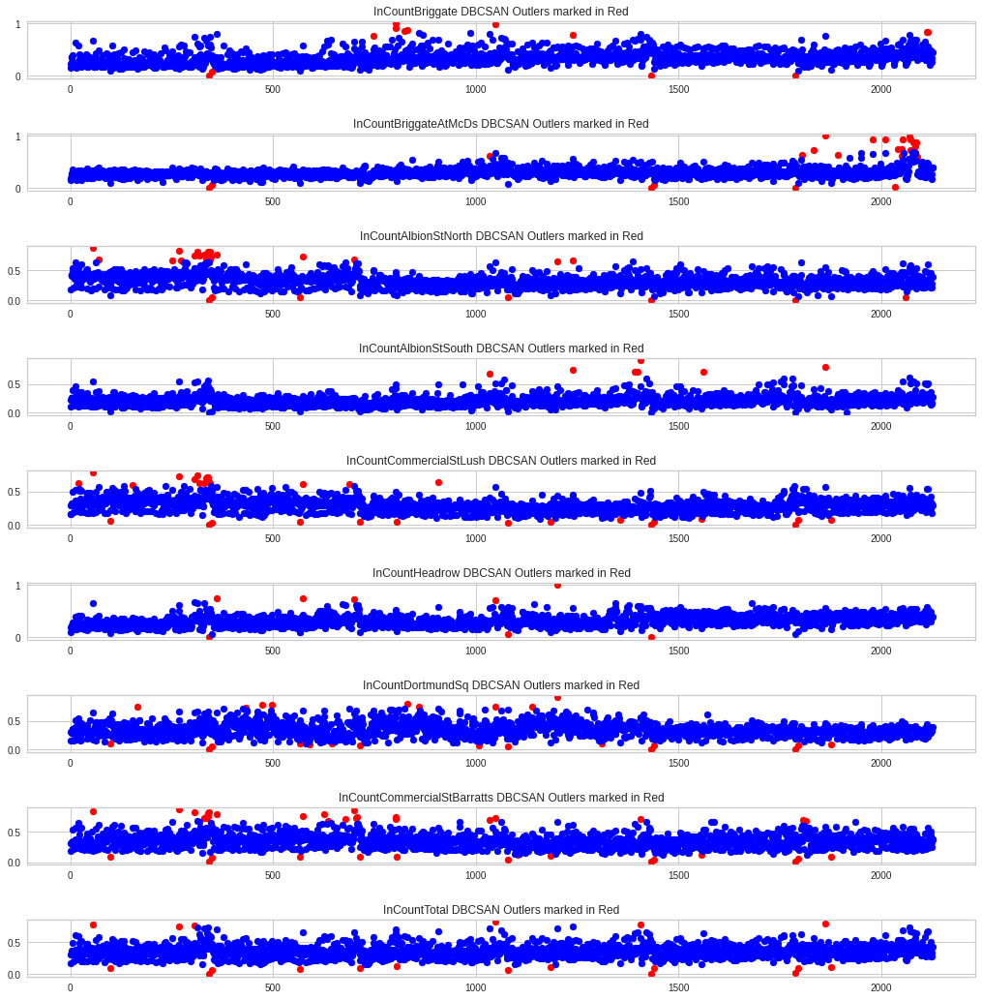

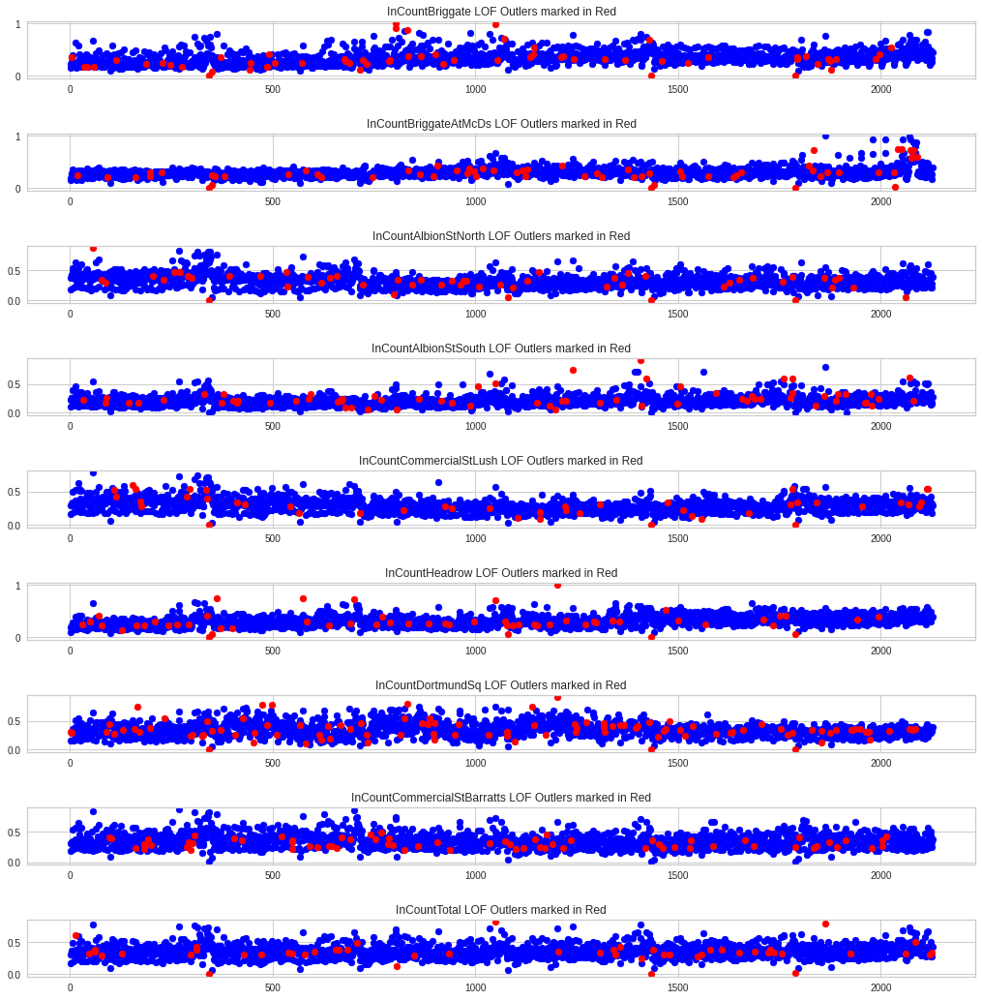

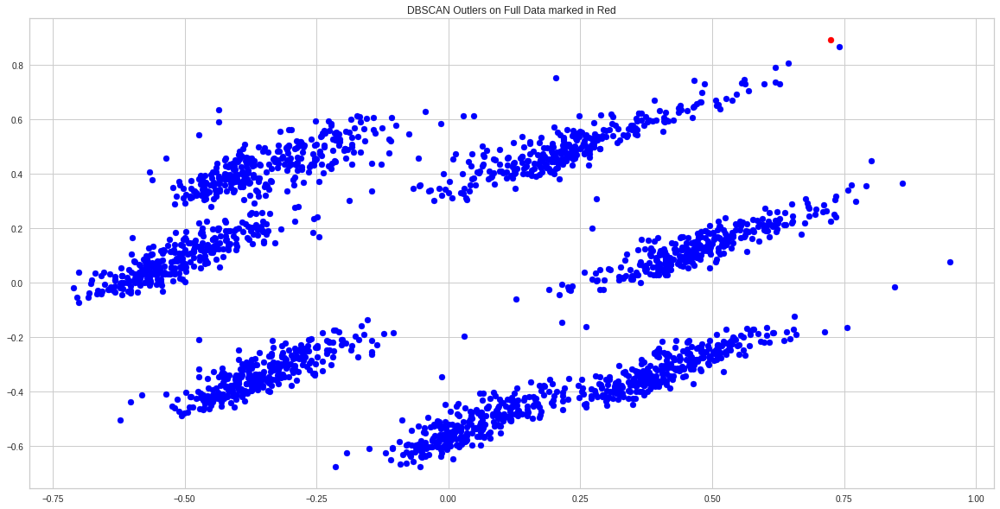

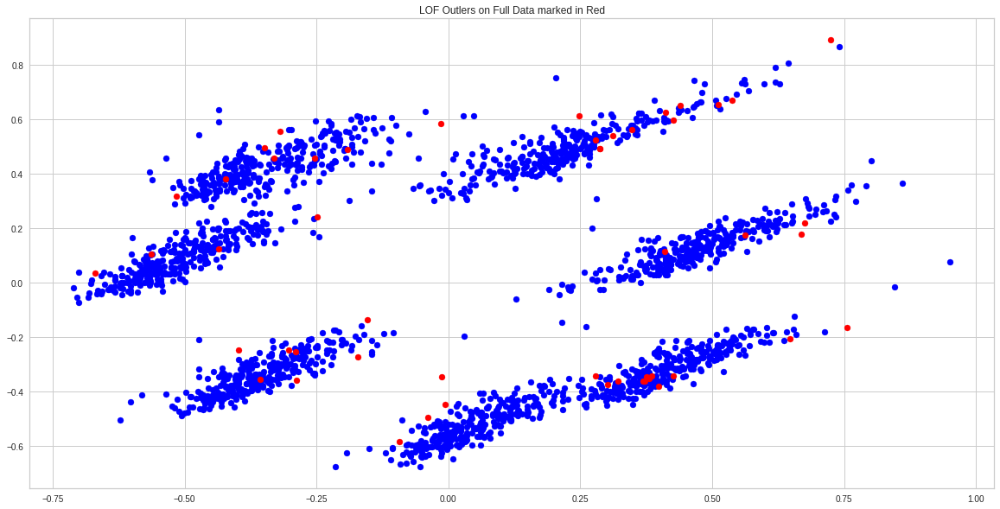

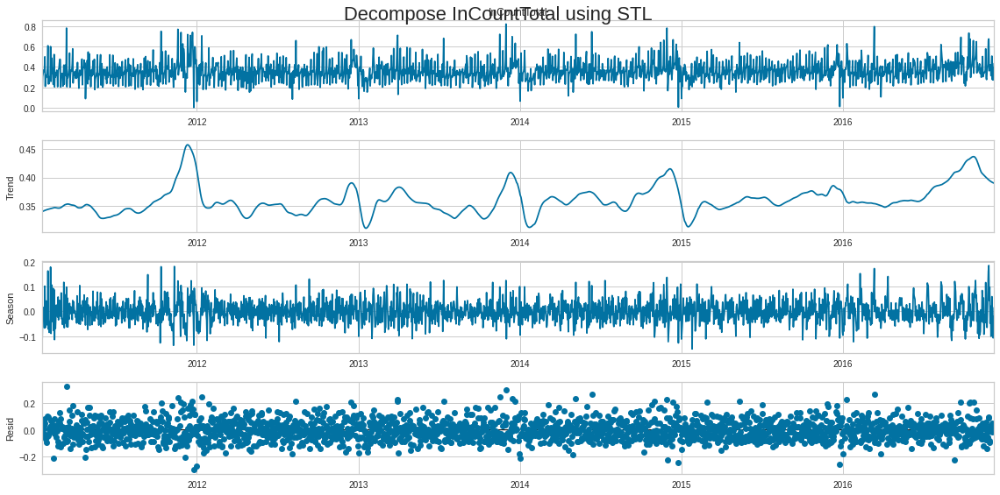

...

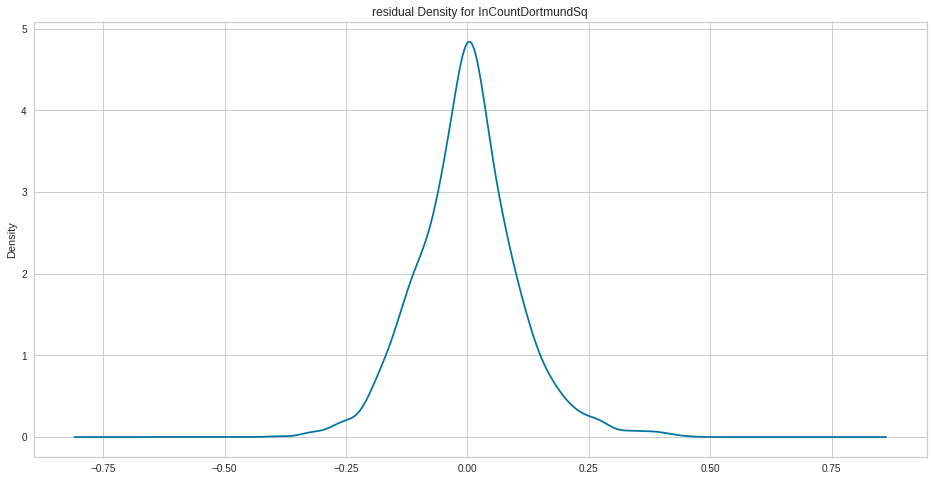

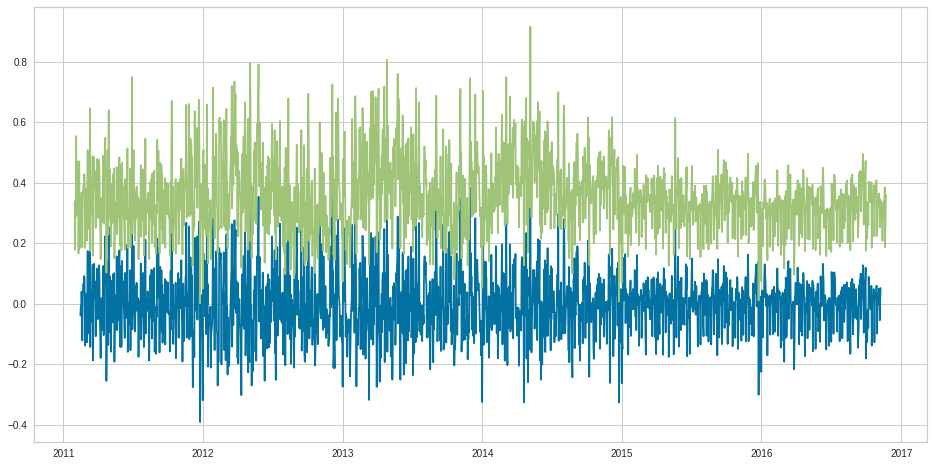

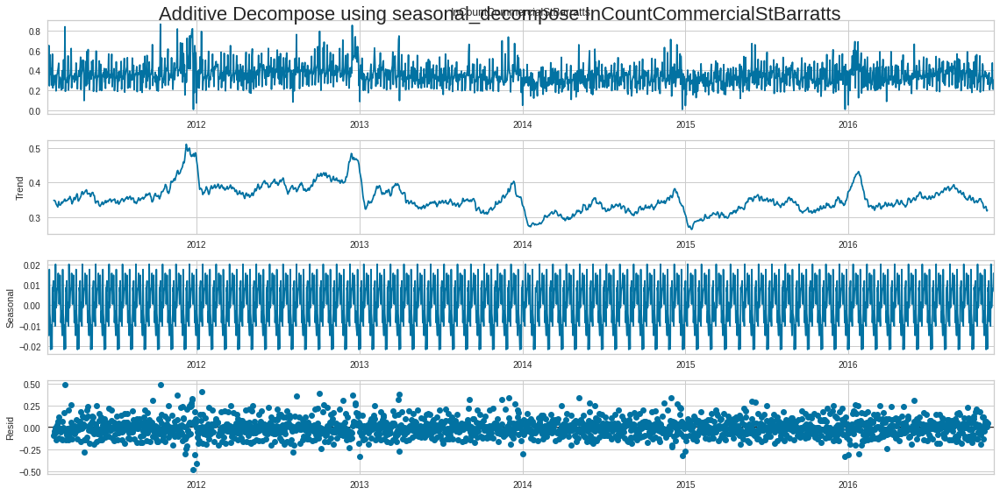

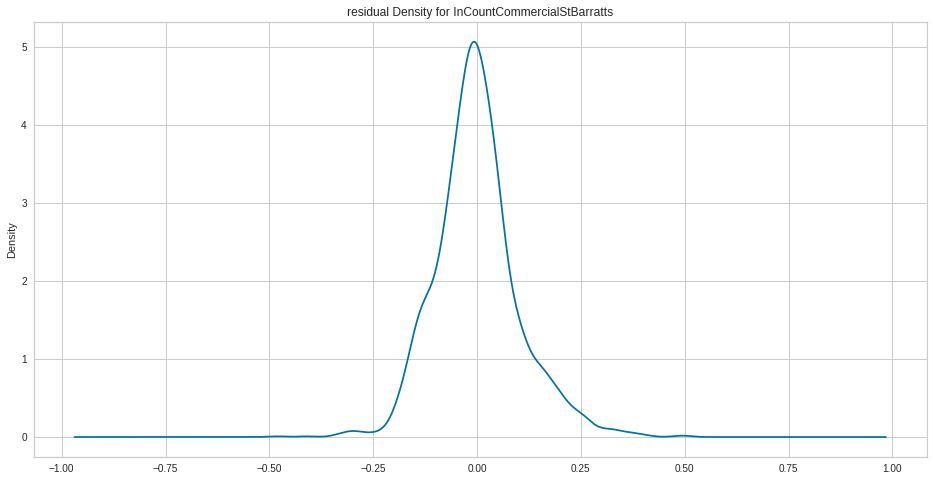

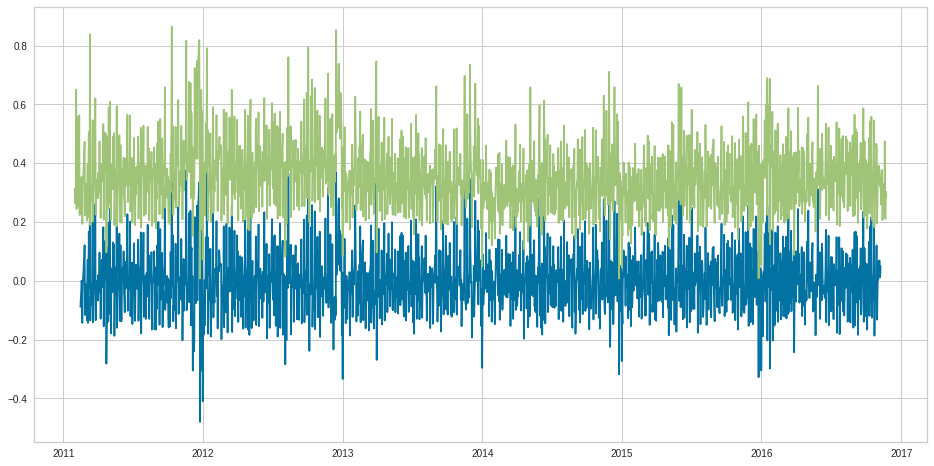

In [ ]:
data_final, data_final_detrended, data_outliersremoved,data_prophet, data_weekly, location_name_list, scaler_target, scaler_input,scaler_target_each_location, scaler_prophet, princdf,compdf, var_cum_variance  = do_all_pre_processing()


In [ ]:
data_weekly.shape

(310, 7)

### 4.2.6 Observations

#### Outlier Analysis Observations

1) Only 2 Outliers that too not significant are seen when DBSCAN is applied on the entire data, including the categorical variables

2) Only 19(Less than 1%) Outliers that too not significant are Identified on the Incount Total column when DBSCAN is applied.

3) LOF is giving far more outliers compared to DBSCAN, but does not seem very relevant on the current problem statement

#### Decomposing Data to Trend, Seasonality, noise, residue
1) There is no visible trend seen in the Incount data using seasonal_decompose

2)  STL (Seasonal-Trend decomposition using LOESS - LOcally Estimated Scatterplot Smoothing) shows a smoother trend

3) The residual denisity data for all the gates and IncoutTotal almost follows a normal distribution


####Outliers

In [ ]:
col_list = ['InCountTotal'] + global_parameters['input_cols_regression']
data_final[col_list][data_final['Outliers_InCountTotal']==1]

,InCountTotal,Month,Weekday,Day,Week_no,mean_temp,rain,wind_speed,abnormal_rain,high_temp,low_temp,high_wind,EasterSundayHoliday,University_holidays,School_holidays,UKBankHoliday
DateTime,,,,,,,,,,,,,,,,
2011-03-12,0.780612,0.359455,0.447228,0.449297,0.364350,0.380435,0.050725,0.493333,0.364312,0.362618,0.362609,0.356361,0.362024,0.360550,0.359835,0.363050
2011-04-24,0.089486,0.350510,0.290781,0.359001,0.355734,0.619565,0.000000,0.173333,0.364312,0.362618,0.362609,0.362459,0.195055,0.362844,0.359835,0.363050
2011-10-12,0.749507,0.374611,0.354995,0.449297,0.387682,0.217391,0.007246,0.173333,0.364312,0.362618,0.356087,0.362459,0.362024,0.360550,0.359835,0.363050
2011-11-19,0.768943,0.383045,0.447228,0.375084,0.398347,0.380435,0.007246,0.133333,0.364312,0.362618,0.362609,0.362459,0.362024,0.360550,0.359835,0.363050
2011-12-25,0.002429,0.408446,0.290781,0.334371,0.467548,0.500000,0.021739,0.533333,0.364312,0.362618,0.362609,0.356361,0.362024,0.362844,0.366438,0.363050
2012-01-01,0.061849,0.321822,0.290781,0.283453,0.379925,0.405797,0.173913,0.413333,0.336153,0.362618,0.362609,0.356361,0.362024,0.362844,0.366438,0.363050
2012-08-04,0.084510,0.348947,0.447228,0.361797,0.333548,0.449275,0.014493,0.280000,0.364312,0.362618,0.362609,0.362459,0.362024,0.362844,0.366438,0.363050
2013-01-01,0.088911,0.321822,0.347879,0.283453,0.340113,0.318841,0.000000,0.373333,0.364312,0.362618,0.362609,0.356361,0.362024,0.362844,0.366438,0.297055
2013-03-31,0.130484,0.359455,0.290781,0.367509,0.362894,0.163043,0.000000,0.226667,0.364312,0.362618,0.356087,0.362459,0.195055,0.362844,0.366438,0.363050


#### PCA Observations

Just 11 components are able to explain 90% of the variance of the entire data(Including Categorical variables that are encoded)

In [ ]:
data_final.describe()

,InCountBriggate,InCountBriggateAtMcDs,InCountAlbionStNorth,InCountAlbionStSouth,InCountCommercialStLush,InCountHeadrow,InCountDortmundSq,InCountCommercialStBarratts,InCountTotal,mean_temp,rain,wind_speed,abnormal_rain,high_temp,low_temp,high_wind,EasterSundayHoliday,University_holidays,School_holidays,UKBankHoliday,Day sin,Week sin,Week cos,Month sin,Month cos,Year sin,Year cos,Month,Year,Day,Weekday,Week_no,seasonal_incount,trend_incount,rolling_mean_incount,expanding_mean_incount,InCountTotal_lag1,InCountTotal_lag2,InCountTotal_lag3,InCountTotal_lag4,InCountTotal_lag5,InCountTotal_lag6,InCountTotal_lag7,InCountTotal_forecast1,InCountTotal_forecast2,InCountTotal_forecast3,InCountTotal_forecast4,InCountTotal_forecast5,InCountTotal_forecast6,InCountTotal_forecast7,Outliers_InCountBriggate,Outliers_InCountBriggateAtMcDs,Outliers_InCountAlbionStNorth,Outliers_InCountAlbionStSouth,Outliers_InCountCommercialStLush,Outliers_InCountHeadrow,Outliers_InCountDortmundSq,Outliers_InCountCommercialStBarratts,Outliers_InCountTotal,Lof_OutlierInCountBriggate,Lof_OutlierInCountBriggateAtMcDs,Lof_OutlierInCountAlbionStNorth,Lof_OutlierInCountAlbionStSouth,Lof_OutlierInCountCommercialStLush,Lof_OutlierInCountHeadrow,Lof_OutlierInCountDortmundSq,Lof_OutlierInCountCommercialStBarratts,Lof_OutlierInCountTotal
count,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2.127000e+03,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000,2127.000000
mean,0.335690,0.302723,0.329462,0.218807,0.293302,0.322113,0.357576,0.353479,0.360891,0.477171,0.044691,0.236201,0.361532,0.361549,0.361557,0.361559,0.361553,0.361540,0.361521,0.361685,0.497417,0.500125,4.740822e-01,0.493301,0.500026,0.499087,0.490646,0.361306,0.361348,0.361542,0.361482,0.360938,-0.000005,0.360771,0.360449,0.354592,0.360891,0.360283,0.360311,0.360492,0.360392,0.360515,0.360559,0.360990,0.361038,0.361104,0.361133,0.361172,0.361250,0.361287,0.006112,0.012694,0.013164,0.003291,0.015515,0.003761,0.011283,0.018806,0.008933,0.029619,0.030089,0.025388,0.031500,0.021157,0.026798,0.049365,0.031970,0.023977
std,0.123331,0.088781,0.101919,0.085464,0.093558,0.098360,0.116068,0.108812,0.095681,0.188751,0.091050,0.131779,0.008402,0.002188,0.002399,0.002163,0.008858,0.001137,0.002880,0.009395,0.279136,0.362888,3.718977e-01,0.353443,0.355128,0.356610,0.350512,0.019691,0.010305,0.025661,0.043798,0.025940,0.010145,0.026288,0.040588,0.003939,0.095681,0.095882,0.096146,0.096264,0.096040,0.096256,0.096278,0.095592,0.095590,0.095619,0.095628,0.095649,0.095714,0.095783,0.077958,0.111976,0.114004,0.057286,0.123617,0.061227,0.105648,0.135871,0.094112,0.169574,0.170873,0.157337,0.174705,0.143940,0.161531,0.216681,0.175961,0.153015
min,0.002641,0.005235,0.002635,0.000823,0.002592,0.004290,0.001589,0.007601,0.002429,0.000000,0.000000,0.000000,0.336153,0.357071,0.356087,0.356361,0.195055,0.360550,0.359835,0.297055,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.321822,0.350823,0.283453,0.290781,0.302526,-0.027499,0.293553,0.243647,0.341243,0.002429,0.002429,0.002429,0.002429,0.002429,0.002429,0.002429,0.002429,0.002429,0.002429,0.002429,0.002429,0.002429,0.002429,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%

In [ ]:
data_final.head()

,InCountBriggate,InCountBriggateAtMcDs,InCountAlbionStNorth,InCountAlbionStSouth,InCountCommercialStLush,InCountHeadrow,InCountDortmundSq,InCountCommercialStBarratts,InCountTotal,mean_temp,rain,wind_speed,abnormal_rain,high_temp,low_temp,high_wind,EasterSundayHoliday,University_holidays,School_holidays,UKBankHoliday,Day sin,Week sin,Week cos,Month sin,Month cos,Year sin,Year cos,Month,Year,Day,Weekday,Week_no,seasonal_incount,trend_incount,rolling_mean_incount,expanding_mean_incount,InCountTotal_lag1,InCountTotal_lag2,InCountTotal_lag3,InCountTotal_lag4,InCountTotal_lag5,InCountTotal_lag6,InCountTotal_lag7,InCountTotal_forecast1,InCountTotal_forecast2,InCountTotal_forecast3,InCountTotal_forecast4,InCountTotal_forecast5,InCountTotal_forecast6,InCountTotal_forecast7,Outliers_InCountBriggate,Outliers_InCountBriggateAtMcDs,Outliers_InCountAlbionStNorth,Outliers_InCountAlbionStSouth,Outliers_InCountCommercialStLush,Outliers_InCountHeadrow,Outliers_InCountDortmundSq,Outliers_InCountCommercialStBarratts,Outliers_InCountTotal,Lof_OutlierInCountBriggate,Lof_OutlierInCountBriggateAtMcDs,Lof_OutlierInCountAlbionStNorth,Lof_OutlierInCountAlbionStSouth,Lof_OutlierInCountCommercialStLush,Lof_OutlierInCountHeadrow,Lof_OutlierInCountDortmundSq,Lof_OutlierInCountCommercialStBarratts,Lof_OutlierInCountTotal
DateTime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2011-01-16,0.144990,0.152117,0.174702,0.103634,0.165548,0.101790,0.153852,0.178262,0.168968,0.478261,0.007246,0.133333,0.364312,0.362618,0.362609,0.362459,0.362024,0.36055,0.359835,0.36305,0.806646,7.225209e-01,2.566836e-13,0.350126,0.020417,0.628072,0.983320,0.321822,0.361373,0.364693,0.290781,0.361919,-0.012106,0.351746,0.399199,0.356678,0.168968,0.442961,0.353102,0.323813,0.466332,0.331004,0.513297,0.306589,0.333570,0.360520,0.370871,0.356540,0.499025,0.209436,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2011-01-17,0.226875,0.190434,0.371551,0.226422,0.294893,0.189173,0.302167,0.305534,0.306589,0.369565,0.000000,0.013333,0.364312,0.362618,0.362609,0.362459,0.362024,0.36055,0.359835,0.36305,0.127377,2.774791e-01,4.048428e-13,0.257037,0.060416,0.636367,0.981045,0.321822,0.361373,0.360611,0.341959,0.302526,0.003584,0.354102,0.371354,0.344947,0.306589,0.168968,0.442961,0.353102,0.323813,0.466332,0.331004,0.333570,0.360520,0.370871,0.356540,0.499025,0.209436,0.318123,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
2011-01-18,0.270840,0.255994,0.408813,0.265268,0.301911,0.171907,0.295252,0.300615,0.333570,0.271739,0.000000,0.066667,0.364312,0.362618,0.356087,0.362459,0.362024,0.36055,0.359835,0.36305,0.412148,1.125211e-13,3.568959e-01,0.173895,0.118359,0.644622,0.978628,0.321822,0.361373,0.357818,0.347879,0.302526,-0.009886,0.352260,0.341824,0.342690,0.333570,0.306589,0.168968,0.442961,0.353102,0.323813,0.466332,0.360520,0.370871,0.356540,0.499025,0.209436,0.318123,0.293407,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2011-01-19,0.356666,0.289017,0.420419,0.265973,0.304929,0.185703,0.305162,0.310774,0.360520,0.271739,0.007246,0.093333,0.364312,0.362618,0.356087,0.362459,0.362024,0.36055,0.359835,0.36305,0.696919,9.903113e-02,8.019377e-01,0.104104,0.191874,0.652833,0.976070,0.321822,0.361373,0.375084,0.354995,0.302526,-0.000175,0.349134,0.342191,0.342184,0.360520,0.333570,0.306589,0.168968,0.442961,0.353102,0.323813,0.370871,0.356540,0.499025,0.209436,0.318123,0.293407,0.312168,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
2011-01-20,0.366489,0.273040,0.429449,0.262360,0.320930,0.237713,0.301123,0.331628,0.370871,0.177536,0.000000,0.053333,0.364312,0.362618,0.356087,0.362459,0.362024,0.36055,0.359835,0.36305,0.981690,5.000000e-01,1.000000e+00,0.050521,0.277951,0.661000,0.973370,0.321822,0.361373,0.365819,0.365574,0.302526,0.008529,0.352852,0.327075,0.343149,0.370871,0.360520,0.333570,0.306589,0.168968,0.442961,0.353102,0.356540,0.499025,0.209436,0.318123,0.293407,0.312168,0.335476,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0


###### PCA Output

In [ ]:
princdf

,0,1,2,3,4,5,6,7,8,9,10,11,InCountTotal
0,0.501186,-0.072834,-0.305815,0.007210,-0.073542,0.033058,0.159510,0.042412,0.083294,0.066633,0.139283,-0.155842,0.306589
1,0.473293,-0.160209,0.374247,-0.102821,-0.212009,-0.044546,0.141883,0.035961,0.022237,-0.020510,-0.198609,0.013213,0.333570
2,0.430700,-0.253826,0.089324,-0.202355,-0.177654,-0.071719,0.105374,-0.061570,-0.064900,-0.116211,0.113052,0.016409,0.360520
3,0.370065,-0.335813,-0.193561,-0.195929,-0.150879,-0.111659,0.013438,-0.069540,-0.050136,0.142080,0.000183,-0.094872,0.370871
4,0.298613,-0.405949,-0.477639,-0.290647,-0.201103,-0.096817,-0.026635,-0.065144,0.122234,0.018815,-0.062022,0.115900,0.356540
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2122,-0.274768,-0.411468,-0.113133,-0.089756,-0.076417,0.087092,0.054679,0.095785,0.097241,0.115622,0.175271,0.016293,0.393165
2123,-0.359710,-0.346921,-0.398152,0.084068,0.171826,0.075083,-0.016654,-0.013887,0.059496,-0.055236,-0.174380,-0.016392,0.272368
2124,-0.422223,-0.263957,0.278268,0.151538,-0.135616,0.064667,0.107704,0.104022,-0.013881,-0.091874,0.172050,0.058827,0.345800
2125,-0.469288,-0.174786,-0.007275,0.167731,-0.037596,0.040813,0.063860,-0.006845,-0.094975,0.083027,-0.080609,-0.105311,0.433450


#### The contribution of each Feature for the principal components

In [ ]:
compdf

,Month,Weekday,Day,Week_no,mean_temp,rain,wind_speed,abnormal_rain,high_temp,low_temp,high_wind,EasterSundayHoliday,University_holidays,School_holidays,UKBankHoliday,Day sin,Month sin,Month cos,rolling_mean_incount,seasonal_incount,trend_incount,InCountTotal_lag1,InCountTotal_lag2,InCountTotal_lag3,InCountTotal_lag4,InCountTotal_lag5,InCountTotal_lag6,InCountTotal_lag7
0,0.000143,-0.000201,0.004861,0.007279,-0.014059,-0.007177,-0.024392,0.000234,0.000204,-0.000099,0.000178,0.000168,0.000004,-0.000123,0.000763,0.006666,-0.160914,-0.985591,0.013086,0.006266,0.001137,0.016580,0.017557,0.016903,0.015575,0.014153,0.011739,0.009442
1,0.000305,0.000149,0.002103,0.001417,-0.006632,0.001153,0.013375,0.000330,-0.000167,-0.000221,-0.000030,0.000469,0.000025,-0.000326,0.001441,-0.013345,0.986276,-0.161999,-0.008832,-0.000257,-0.000914,0.004022,-0.000763,-0.003636,-0.006697,-0.010143,-0.012275,-0.014071
2,0.000693,-0.000724,0.004562,0.001049,0.004766,-0.000284,-0.000102,-0.000390,0.000057,0.000046,-0.000203,-0.000214,0.000019,0.000005,0.000042,-0.999829,-0.014242,-0.004330,0.001685,0.000378,0.001318,0.005261,0.003096,0.003004,-0.003204,-0.003292,0.000605,0.001026
3,-0.003089,-0.000715,-0.002258,-0.001626,0.998510,-0.008011,-0.022389,0.000650,-0.007905,0.008412,0.001319,-0.000045,0.001377,0.001414,0.000871,0.004862,0.003854,-0.014502,-0.007989,0.004044,0.001313,0.007251,0.018843,0.006670,-0.007817,-0.005108,-0.021194,-0.030592
4,0.020332,-0.000998,-0.004046,0.014581,0.025544,0.193777,0.969184,-0.013037,0.001565,0.003163,-0.011864,-0.000972,0.000206,0.000899,-0.002978,0.000043,-0.013477,-0.019622,0.045212,-0.004097,0.019095,-0.055826,0.026625,0.068061,0.044162,0.070435,0.048324,0.028408
5,0.081877,-0.013730,0.006713,0.112470,0.010910,-0.112346,-0.088966,0.008718,0.000297,0.000940,0.000422,0.000249,-0.000267,0.001099,-0.000662,0.002111,0.026341,0.039503,0.322717,0.004432,0.150878,0.271740,0.337377,0.373096,0.394432,0.375083,0.348663,0.292907
6,-0.009098,-0.148497,-0.047704,-0.041389,0.034172,0.165891,-0.097310,-0.012942,-0.000866,-0.000167,0.001315,-0.000972,-0.000074,0.000867,-0.011650,-0.005536,0.015080,-0.009263,0.046819,-0.004708,-0.007611,-0.582932,-0.423583,-0.194885,0.065754,0.254902,0.433772,0.343698
7,-0.007176,-0.134106,-0.031610,-0.000490,-0.018104,0.245692,-0.106679,-0.019633,-0.000127,-0.000618,0.001201,-0.006844,0.000035,-0.000662,-0.003525,-0.003524,-0.001363,0.001930,0.007306,-0.004209,-0.023352,-0.490645,0.101102,0.414601,0.423183,0.090114,-0.296395,-0.458157
8,0.002127,-0.090142,-0.013567,0.006591,0.003781,0.119543,-0.038346,-0.008967,0.000371,0.000170,0.000423,-0.005415,0.000096,0.000367,-0.002419,0.004137,0.002531,-0.000226,0.035160,-0.002729,0.008090,-0.264797,0.265805,0.433353,-0.255128,-0.627361,0.078225,0.425515
9,-0.004048,-0.066067,-0.009104,0.005205,-0.015090,-0.067714,-0.013227,0.005955,0.000167,0.000358,0.000256,-0.002074,-0.000199,-0.001343,0.005811,0.000916,-0.000247,0.001273,0.007327,-0.000249,-0.008484,-0.220202,0.455901,-0.003915,-0.577168,0.287779,0.389428,-0.407889


[0.27410066 0.54519011 0.71412958 0.79147247 0.83003109 0.85913497
 0.8816237  0.90256698]


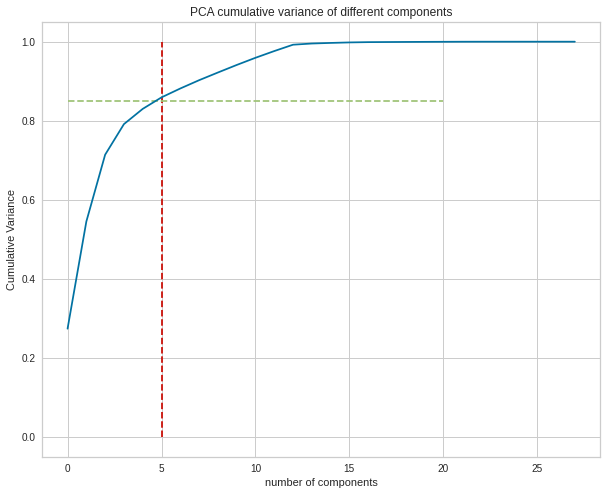

In [ ]:
print(var_cum_variance[0:8])
# Plotting the scree plot with a mark on 85 percentile of variance being captured
fig = plt.figure(figsize=[10,8])
plt.vlines(x=5, ymax=1, ymin=0, colors="r", linestyles="--")
plt.hlines(y=0.85, xmax=20, xmin=0, colors="g", linestyles="--")
plt.plot(var_cum_variance)
plt.ylabel("Cumulative Variance")
plt.xlabel("number of components")
plt.title("PCA cumulative variance of different components")
plt.show()

#### Observation from PCA cumulative variance
Just 5 components are able to explain 85% of the variance in the data

ADF test results for  InCountTotal
ADF Statistic: -7.638551
p-value:  1.9231439534300742e-11
full result  (-7.638551478845224, 1.9231439534300742e-11, 28, 2869, {'1%': -3.4326313386090552, '5%': -2.8625479402718623, '10%': -2.5673065559730883}, 70040.73650505886)
ADF test results for  InCountBriggate
ADF Statistic: -7.700908
p-value:  1.3401466510358263e-11
full result  (-7.700908426691125, 1.3401466510358263e-11, 27, 2870, {'1%': -3.4326305430048927, '5%': -2.8625475888928142, '10%': -2.5673063689009217}, 61610.271294970735)
ADF test results for  InCountBriggateAtMcDs
ADF Statistic: -6.974070
p-value:  8.51761597365347e-10
full result  (-6.974070388567212, 8.51761597365347e-10, 28, 2869, {'1%': -3.4326313386090552, '5%': -2.8625479402718623, '10%': -2.5673065559730883}, 56063.748851183336)
ADF test results for  InCountAlbionStNorth
ADF Statistic: -8.167221
p-value:  8.816775130806516e-13
full result  (-8.167220917131141, 8.816775130806516e-13, 28, 2869, {'1%': -3.4326313386090552, '5%

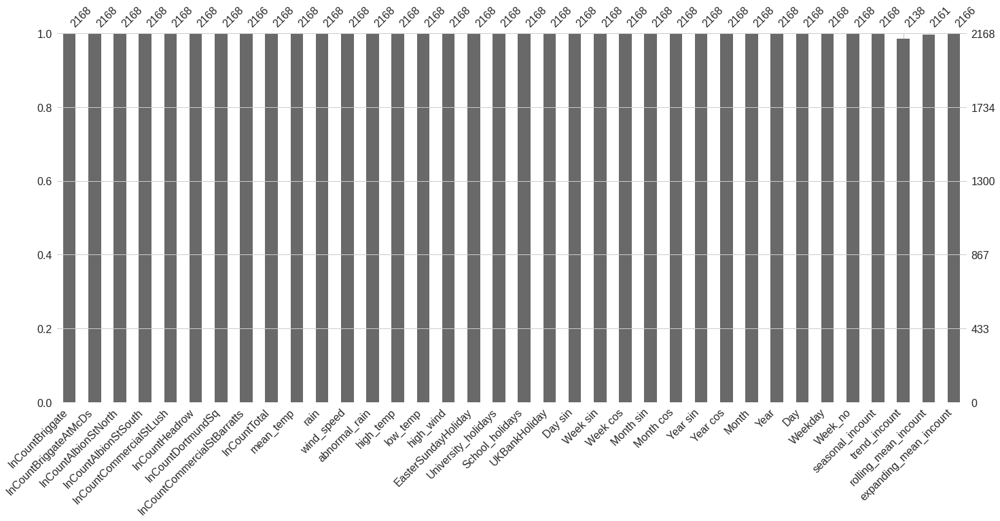

In [ ]:
data_for_visualization,_,_,_,_,_,_,_,_,_,_,_,_ =  do_all_pre_processing(for_visualization_only = True)

#### Missing Data Observation
1. Only Missing data in column InCountCommercialStBarrats for two days

In [ ]:
data_for_visualization.head()

,InCountBriggate,InCountBriggateAtMcDs,InCountAlbionStNorth,InCountAlbionStSouth,InCountCommercialStLush,InCountHeadrow,InCountDortmundSq,InCountCommercialStBarratts,InCountTotal,mean_temp,rain,wind_speed,abnormal_rain,high_temp,low_temp,high_wind,EasterSundayHoliday,University_holidays,School_holidays,UKBankHoliday,Day sin,Week sin,Week cos,Month sin,Month cos,Year sin,Year cos,Month,Year,Day,Weekday,Week_no,seasonal_incount,trend_incount,rolling_mean_incount,expanding_mean_incount
DateTime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2011-01-01,9467.0,7102.0,5231.0,5714.0,5725.0,3571.0,6052.0,4905.0,47767,0.0,0.0,0.0,0,0,1,0,0,1,1,0,-7.057106e-12,0.974928,-0.222521,0.394356,0.918958,0.000989,1.000000,1,2011,1,Saturday,52,7496.532165,NaN,NaN,NaN
2011-01-02,25301.0,11546.0,19660.0,23456.0,23612.0,9496.0,19989.0,16110.0,149170,7.4,0.0,0.5,0,0,0,0,0,1,1,0,-2.758567e-12,0.433884,-0.900969,0.571268,0.820763,0.018191,0.999835,1,2011,2,Sunday,52,-109.827460,NaN,NaN,NaN
2011-01-03,29684.0,12684.0,21773.0,23512.0,29148.0,11064.0,21238.0,17330.0,166433,5.1,0.0,1.3,0,0,1,0,0,1,1,1,1.539971e-12,-0.433884,-0.900969,0.724793,0.688967,0.035387,0.999374,1,2011,3,Monday,1,2881.822071,NaN,NaN,98468.500000
2011-01-04,35663.0,18484.0,25526.0,31434.0,38829.0,15068.0,31595.0,24229.0,220828,14.1,0.0,3.9,0,0,0,1,0,1,1,0,-8.713405e-12,-0.974928,-0.222521,0.848644,0.528964,0.052573,0.998617,1,2011,4,Tuesday,1,1201.609395,NaN,NaN,121123.333333
2011-01-05,26538.0,9361.0,10573.0,9733.0,16505.0,8281.0,19130.0,12049.0,112170,11.8,0.0,3.0,0,0,0,1,0,1,0,0,-4.414867e-12,-0.781831,0.623490,0.937752,0.347305,0.069744,0.997565,1,2011,5,Wednesday,1,-2106.344361,NaN,NaN,146049.500000


In [ ]:
data_final[['InCountTotal_lag7','InCountTotal_lag6','InCountTotal_lag5','InCountTotal_lag4','InCountTotal_lag3','InCountTotal_lag2','InCountTotal_lag1','InCountTotal','InCountTotal_forecast1']].head(15)

,InCountTotal_lag7,InCountTotal_lag6,InCountTotal_lag5,InCountTotal_lag4,InCountTotal_lag3,InCountTotal_lag2,InCountTotal_lag1,InCountTotal,InCountTotal_forecast1
DateTime,,,,,,,,,
2011-01-16,0.513297,0.331004,0.466332,0.323813,0.353102,0.442961,0.168968,0.168968,0.306589
2011-01-17,0.331004,0.466332,0.323813,0.353102,0.442961,0.168968,0.306589,0.306589,0.333570
2011-01-18,0.466332,0.323813,0.353102,0.442961,0.168968,0.306589,0.333570,0.333570,0.360520
2011-01-19,0.323813,0.353102,0.442961,0.168968,0.306589,0.333570,0.360520,0.360520,0.370871
2011-01-20,0.353102,0.442961,0.168968,0.306589,0.333570,0.360520,0.370871,0.370871,0.356540
2011-01-21,0.442961,0.168968,0.306589,0.333570,0.360520,0.370871,0.356540,0.356540,0.499025
2011-01-22,0.168968,0.306589,0.333570,0.360520,0.370871,0.356540,0.499025,0.499025,0.209436
2011-01-23,0.306589,0.333570,0.360520,0.370871,0.356540,0.499025,0.209436,0.209436,0.318123
2011-01-24,0.333570,0.360520,0.370871,0.356540,0.499025,0.209436,0.318123,0.318123,0.293407


In [ ]:
data_final[data_final.isnull().any(1)]

,InCountBriggate,InCountBriggateAtMcDs,InCountAlbionStNorth,InCountAlbionStSouth,InCountCommercialStLush,InCountHeadrow,InCountDortmundSq,InCountCommercialStBarratts,InCountTotal,mean_temp,rain,wind_speed,abnormal_rain,high_temp,low_temp,high_wind,EasterSundayHoliday,University_holidays,School_holidays,UKBankHoliday,Day sin,Week sin,Week cos,Month sin,Month cos,Year sin,Year cos,Month,Year,Day,Weekday,Week_no,seasonal_incount,trend_incount,rolling_mean_incount,expanding_mean_incount,InCountTotal_lag1,InCountTotal_lag2,InCountTotal_lag3,InCountTotal_lag4,InCountTotal_lag5,InCountTotal_lag6,InCountTotal_lag7,InCountTotal_forecast1,InCountTotal_forecast2,InCountTotal_forecast3,InCountTotal_forecast4,InCountTotal_forecast5,InCountTotal_forecast6,InCountTotal_forecast7,Outliers_InCountBriggate,Outliers_InCountBriggateAtMcDs,Outliers_InCountAlbionStNorth,Outliers_InCountAlbionStSouth,Outliers_InCountCommercialStLush,Outliers_InCountHeadrow,Outliers_InCountDortmundSq,Outliers_InCountCommercialStBarratts,Outliers_InCountTotal,Lof_OutlierInCountBriggate,Lof_OutlierInCountBriggateAtMcDs,Lof_OutlierInCountAlbionStNorth,Lof_OutlierInCountAlbionStSouth,Lof_OutlierInCountCommercialStLush,Lof_OutlierInCountHeadrow,Lof_OutlierInCountDortmundSq,Lof_OutlierInCountCommercialStBarratts,Lof_OutlierInCountTotal
DateTime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,


In [ ]:
data_for_visualization[data_for_visualization.isnull().any(1)]

,InCountBriggate,InCountBriggateAtMcDs,InCountAlbionStNorth,InCountAlbionStSouth,InCountCommercialStLush,InCountHeadrow,InCountDortmundSq,InCountCommercialStBarratts,InCountTotal,mean_temp,rain,wind_speed,abnormal_rain,high_temp,low_temp,high_wind,EasterSundayHoliday,University_holidays,School_holidays,UKBankHoliday,Day sin,Week sin,Week cos,Month sin,Month cos,Year sin,Year cos,Month,Year,Day,Weekday,Week_no,seasonal_incount,trend_incount,rolling_mean_incount,expanding_mean_incount
DateTime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2011-01-01,9467.0,7102.0,5231.0,5714.0,5725.0,3571.0,6052.0,4905.0,47767,0.0,0.0,0.0,0,0,1,0,0,1,1,0,-7.057106e-12,9.749279e-01,-0.222521,0.394356,0.918958,0.000989,1.000000,1,2011,1,Saturday,52,7496.532165,NaN,NaN,NaN
2011-01-02,25301.0,11546.0,19660.0,23456.0,23612.0,9496.0,19989.0,16110.0,149170,7.4,0.0,0.5,0,0,0,0,0,1,1,0,-2.758567e-12,4.338837e-01,-0.900969,0.571268,0.820763,0.018191,0.999835,1,2011,2,Sunday,52,-109.827460,NaN,NaN,NaN
2011-01-03,29684.0,12684.0,21773.0,23512.0,29148.0,11064.0,21238.0,17330.0,166433,5.1,0.0,1.3,0,0,1,0,0,1,1,1,1.539971e-12,-4.338837e-01,-0.900969,0.724793,0.688967,0.035387,0.999374,1,2011,3,Monday,1,2881.822071,NaN,NaN,98468.500000
2011-01-04,35663.0,18484.0,25526.0,31434.0,38829.0,15068.0,31595.0,24229.0,220828,14.1,0.0,3.9,0,0,0,1,0,1,1,0,-8.713405e-12,-9.749279e-01,-0.222521,0.848644,0.528964,0.052573,0.998617,1,2011,4,Tuesday,1,1201.609395,NaN,NaN,121123.333333
2011-01-05,26538.0,9361.0,10573.0,9733.0,16505.0,8281.0,19130.0,12049.0,112170,11.8,0.0,3.0,0,0,0,1,0,1,0,0,-4.414867e-12,-7.818315e-01,0.623490,0.937752,0.347305,0.069744,0.997565,1,2011,5,Wednesday,1,-2106.344361,NaN,NaN,146049.500000
2011-01-06,29650.0,17219.0,22010.0,29404.0,38484.0,15400.0,28754.0,24878.0,205799,14.9,0.0,2.6,0,0,0,0,0,1,0,0,-1.163281e-13,2.432373e-13,1.000000,0.988468,0.151428,0.086893,0.996218,1,2011,6,Thursday,1,-1338.410558,NaN,NaN,139273.600000
2011-01-07,27573.0,17149.0,17177.0,24005.0,34278.0,13751.0,25869.0,23061.0,182863,14.6,0.0,1.6,0,0,0,0,0,1,0,0,-1.036970e-11,7.818315e-01,0.623490,0.998717,-0.050649,0.104017,0.994575,1,2011,7,Friday,1,-1814.800934,NaN,NaN,150361.166667
2011-01-08,20587.0,15236.0,19502.0,21998.0,28353.0,12069.0,17002.0,20898.0,155645,21.2,0.0,1.2,0,1,0,0,0,1,0,0,-6.071166e-12,9.749279e-01,-0.222521,0.968077,-0.250653,0.121111,0.992639,1,2011,8,Saturday,1,2656.688268,NaN,155004.285714,155004.285714
2011-01-09,24422.0,15148.0,17651.0,22509.0,33451.0,13674.0,25247.0,24117.0,176219,15.1,0.0,1.3,0,0,0,0,0,1,0,0,-1.772627e-12,4.338837e-01,-0.900969,0.897805,-0.440394,0.138168,0.990409,1,2011,9,Sunday,1,-5865.976286,NaN,170415.428571,155084.375000


In [ ]:
data_for_visualization.loc['2014-08-13':'2014-08-13']

,InCountBriggate,InCountBriggateAtMcDs,InCountAlbionStNorth,InCountAlbionStSouth,InCountCommercialStLush,InCountHeadrow,InCountDortmundSq,InCountCommercialStBarratts,InCountTotal,mean_temp,rain,wind_speed,abnormal_rain,high_temp,low_temp,high_wind,EasterSundayHoliday,University_holidays,School_holidays,UKBankHoliday,Day sin,Week sin,Week cos,Month sin,Month cos,Year sin,Year cos,Month,Year,Day,Weekday,Week_no,seasonal_incount,trend_incount,rolling_mean_incount,expanding_mean_incount
DateTime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2014-08-13,36808.0,16118.0,13989.0,21940.0,20797.0,11963.0,18455.0,14882.0,140070,15.9,0.1,2.5,0,1,0,0,0,1,1,0,-8.233064e-12,-0.781831,0.62349,-0.790776,-0.612106,-0.657508,-0.753448,8,2014,13,Wednesday,33,-1402.962906,167944.583333,171639.857143,171913.225513


In [ ]:
print(location_name_list)

['Briggate' 'BriggateAtMcDs' 'AlbionStNorth' 'AlbionStSouth'
 'CommercialStLush' 'Headrow' 'DortmundSq' 'CommercialStBarratts']


# 5 - Data Visualization

## 5.1 Visualisation Class

In [ ]:
class Visualization:
    def __init__(self,data_frame = None, location_name_list=None):
        self.data_frame = data_frame # array of column names to encode
        self.location_name_list = location_name_list
        self.colors = ['b','r','g','p']
        self.distmapping = { 'W': 'Weekly', 'M': 'Monthly','Y':'Yearly'}
        self.cols_to_keep = ['mean_temp','rain','wind_speed','abnormal_rain','high_temp','low_temp','high_wind','EasterSundayHoliday',
                             'University_holidays','School_holidays','UKBankHoliday']

        self.modified_location_name_list=['InCount'+x for x in self.location_name_list]
        self.init_gg_plots()


    def init_gg_plots(self):
      theme_set(
            theme_538() +
            theme(
                figure_size = (8, 4),
                text = element_text(
                    size = 8,
                    color = 'black',
                    family = 'DejaVu Sans'
                ),
                plot_title = element_text(
                    color = 'black',
                    family = 'DejaVu Sans',
                    weight = 'bold',
                    size = 12
                ),
                axis_title = element_text(
                    color = 'black',
                    family = 'DejaVu Sans',
                    weight = 'bold',
                    size = 6
                ),
            )
        )

    def uni_variate_ggplot_histogram(self, x_list,x_limit_list, y_limit_list ):
      index = 0
      for col in x_list:
        fig = ggplot(self.data_frame) + geom_histogram(aes(x = col),fill = 'blue', color = 'red') + labs(title = col +' distribution - (median = dashed line; mean = solid line)', x = col, y = 'Frequency',
            ) + scale_x_continuous(
                limits = (0, x_limit_list[index]),
                labels = self.labels(0, x_limit_list[index], int(x_limit_list[index]/10)),
                breaks = self.breaks(0, x_limit_list[index], int(x_limit_list[index]/10))
            )+  scale_y_continuous(
                limits = (0, y_limit_list[index]),
                labels = self.labels(0, y_limit_list[index], int(y_limit_list[index]/10)),
                breaks = self.breaks(0, y_limit_list[index], int(y_limit_list[index]/10))
            )+ geom_vline(aes(xintercept = self.data_frame[col].mean()), color = 'gray')+ geom_vline(aes(xintercept = self.data_frame[col].median()), linetype = 'dashed', color = 'gray')
        fig.draw()
        index += 1

    def facet_ggplot_histogram(self, x, facet_wrap_cols, x_limit, y_limit):
      fig= ggplot(self.data_frame) + geom_histogram(aes(x = x),fill = 'blue', color = 'red') + labs(title =x +' distribution', x = x, y = 'Frequency',
          ) + scale_x_continuous(
              limits = (0, x_limit),
              labels = self.labels(0, x_limit, int(x_limit/10)),
              breaks = self.breaks(0, x_limit, int(x_limit/10))
          )+  scale_y_continuous(
              limits = (0, y_limit),
              labels = self.labels(0, y_limit, int(y_limit/10)),
              breaks = self.breaks(0, y_limit, int(y_limit/10))
          )+ theme(figure_size = (16, 24)) + facet_wrap(facet_wrap_cols, ncol = len(facet_wrap_cols), labeller='label_both')
      fig.draw()

    def scatter_plot_ggplot(self, x = 'InCountTotal',y='rain', hue='Weekday', color = 'red', x_limit=200000, y_limit=15):
      fig = ggplot(self.data_frame) + geom_point(aes(x = x,y=y, fill=hue),alpha = 0.5, color = color) + labs(title ='Scatter plot of '+ x + ' and '+y, x = x, y = y,
        ) +scale_x_continuous(
              limits = (0, x_limit),
              labels = self.labels(0, x_limit, int(x_limit/10)),
              breaks = self.breaks(0, x_limit, int(x_limit/10))
          )+  scale_y_continuous(
              limits = (0, y_limit),
              labels = self.labels(0, y_limit, int(y_limit/10)),
              breaks = self.breaks(0, y_limit, int(y_limit/10))
        )+ theme(figure_size = (12, 8))
      fig.draw()

    def labels(self, from_, to_, step_):
      return pd.Series(np.arange(from_, to_ + step_, step_)).apply(lambda x: '{:,}'.format(x)).tolist()
    def breaks(self, from_, to_, step_):
      return pd.Series(np.arange(from_, to_ + step_, step_)).tolist()

    def plot_graphs(self, plot_type = 'boxplot', col_name = 'InCount', nplotrows=4,nplotcols=2):

        location_area_index = 0
        for i in range(nplotrows):# 4 rows of plots
            fig = plt.figure(figsize=(16,8))
            for j in range(nplotcols):# 2 colums of sub plots
              ax1 = fig.add_subplot(1, 2, j+1)
              if(col_name == 'InCount'):
                target_variable = self.modified_location_name_list[location_area_index]
              else:
                target_variable = col_name

              if(plot_type == 'boxplot'):
                ax1.boxplot(self.data_frame[target_variable])
              elif(plot_type == 'histogram'):
                n, bins, patches = ax1.hist(self.data_frame[target_variable], bins=200, color=self.colors[j], density=True)
              elif(plot_type == 'heatmap'):
                cols = self.cols_to_keep.copy()
                cols.append(target_variable)
                sns.heatmap(self.data_frame[cols].corr(), annot=True, linewidths=.20)

              ax1.set_xlabel('Mall foot fall - ' + col_name + " for " + self.location_name_list[location_area_index] )
              ax1.set_ylabel('Frequency')
              ax1.set_title('Mall foot fall '+ plot_type +' - ' + col_name + " for " + self.location_name_list[location_area_index])
              location_area_index +=1

    def show_timedistribution(self, distribution_type='W', col_name='InCount'):
      for location_name in self.location_name_list:
        if(col_name == 'InCount'):
          target_variable = col_name + location_name
        else:
          target_variable = col_name
        self.data_frame[target_variable].resample(distribution_type).mean().plot(figsize = (20,8))

        xlabel = self.distmapping[distribution_type]
        plt.xlabel(xlabel)
        plt.ylabel('Mall Foot fall')
        plt.legend(self.location_name_list)
        plt.title("Mall Foot fall for different locations - " + xlabel)
    def show_pairplot(self,one_location_only = True, kind='scatter'):
      sns.set_style('whitegrid')
      cols = self.cols_to_keep
      cols.append('InCount'+self.location_name_list[0])
      sns.pairplot(self.data_frame[cols], kind=kind)

    def comparegates(self):
        gatecorrdata=data_final[self.modified_location_name_list]
        sns.pairplot(gatecorrdata)
        plt.show()
        sns.heatmap(gatecorrdata.corr(), annot = True)
        plt.show()

    def bi_variate_kernel_density_plot(self, x, y_list, hue_list=None):

      nplotrows = len(hue_list)
      nplotcols = len(y_list)
      for i in range(nplotrows):# 4 rows of plots
            fig = plt.figure(figsize=(16,8))
            for j in range(nplotcols):# 2 colums of sub plots
              ax1 = fig.add_subplot(1, 3, j+1)

              sns.kdeplot(data = self.data_frame, x=x, y=y_list[j], hue=hue_list[i])

              ax1.set_xlabel('KDE plot ' + x  )
              ax1.set_ylabel(y_list[j])
              ax1.set_title('KDE plot '+ x +' and ' + y_list[j] )


    def plot_graphs_for_list(self, plot_type = 'boxplot', col_list = ['rain'], target_col='InCountTotal'):

        col_index = 0
        nplotrows =1
        nplotcols = 1
        if(len(col_list)>1):
          nplotrows = int(len(col_list)/2)
          nplotcols = 2
        for i in range(nplotrows):# 4 rows of plots
            fig = plt.figure(figsize=(16,8))
            for j in range(nplotcols):# 2 colums of sub plots
              ax1 = fig.add_subplot(1, 2, j+1)

              col_name = col_list[col_index]
              if(plot_type == 'boxplot'):
                ax1.boxplot(self.data_frame[col_name])
              elif(plot_type == 'histogram'):
                n, bins, patches = ax1.hist(self.data_frame[col_name], bins=10, color=self.colors[j],density=True)
              elif(plot_type == 'kdeplot'):
                  #sns.kdeplot(self.data_frame, color=self.colors[j], shade=True, Label=col_name, hue='Weekday')
                  sns.kdeplot(data = self.data_frame, x= target_col, shade=True, hue=col_name)
              ax1.set_xlabel(col_name + " for " + self.location_name_list[0] )
              ax1.set_ylabel('Frequency')
              ax1.set_title(plot_type +' - ' + col_name )
              col_index +=1

    def show_categorical_plots(self, style="swarm", x='Weekday',y='InCountTotal', hue='Month', order=["Sunday", "Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday"]):
      if style == "swarm":
          sns.swarmplot(x=x, y=y,data=self.data_frame,order=order)
      elif style == "swarm_with_hue":
          sns.swarmplot(x=x, y=y,hue=hue, data=self.data_frame,order=order)
      elif style == "stripplot":
          sns.stripplot(x=x, y=y,data=self.data_frame,order=order)
      elif style == "stripplot_with_hue":
          sns.stripplot(x=x, y=y,hue=hue, data=self.data_frame,order=order)
      elif style == "box":
          sns.boxplot(x=x, y=y, data=self.data_frame, whis=np.inf,order=order)
      elif style == "box_with_hue":
          sns.boxplot(x=x, y=y, hue=hue, data=self.data_frame, whis=np.inf,order=order)
      elif style == "violen":
          sns.violinplot(x=x, y=y, data=self.data_frame,order=order)
      elif style == "boxen":
          sns.boxenplot(x=x, y=y, data=self.data_frame,order=order)
      else:
            print("no style is selected")

    def ggplot_swarm(self, dataframe, x_column, y_column, hue=None):
      ax = sns.swarmplot(x=x_column, y=y_column, hue=hue, data=dataframe, size=6)
      ax.set_title(x_column + " and " + y_column + " analysis.")

    def ggplot_count(self, dataframe, x_column, y_column, hue=None):
      ax = sns.countplot(x=x_column, hue=hue, data=dataframe)
      ax.set_title(x_column + " and " + y_column + " analysis.")

    def ggplot_cat(self, dataframe, x_column, y_column, col, hue=None):
      g = sns.catplot(x=x_column, y=y_column,
                hue=hue, col=col,
                data=dataframe, kind="swarm",
                height=6, aspect=.7);

    def relplot_cat(self, dataframe, x_column, y_column, col, row, size, hue=None):
        g = sns.relplot(x=x_column,y=y_column,
                        hue=hue,col=col,
                        row=row,size=size,
                        data=dataframe,palette=["b", "r"]);


    def plotcategoricaldist(self,catcollist,featlist):
        dd=pd.DataFrame(self.data_frame)
        numb=len(dd)
        fig, axs = plt.subplots(len(catcollist),figsize=(15,40))
        fig.tight_layout(pad=2.0)
        nc=0

        for col in(catcollist):
            uniq=dd[col].unique()
            pcnt=[]
            for val in uniq:
                pcnt.append(100*(dd[col][dd[col]==val].count())/numb)

            hts=axs[nc].bar(uniq,pcnt)

            for h in (hts):
                ht=h.get_height()
                axs[nc].text(h.get_x(), 1.05*ht, str(round(ht,2)))
            axs[nc].set_title(col+'Percentage Distribution in the Data')

            nc=nc+1
        plt.show


        fig, axs = plt.subplots(len(catcollist),figsize=(15,40))
        fig.tight_layout(pad=2.0)
        nc=0

        for catcol in catcollist:
            uniq=dd[catcol].unique()
            rn = np.arange(len(uniq))
            bwidth=.05

            for feature in featlist:
                temp=[]
                pcnt=[]
                for colval in uniq:
                    temp.append(np.sum(dd[feature][dd[catcol]==colval]))
                    pcnt.append(100*(dd[catcol][dd[catcol]==colval].count())/numb)
                axs[nc].bar(rn,temp,width=bwidth,label=feature)

                rn = [x + bwidth for x in rn]
            axs[nc].set_title(catcol+'Distribution in the Data')
            #plt.legend()
            plt.xticks([r + (bwidth*len(uniq)) for r in range(len(uniq))], uniq)
            nc=nc+1


        plt.show()


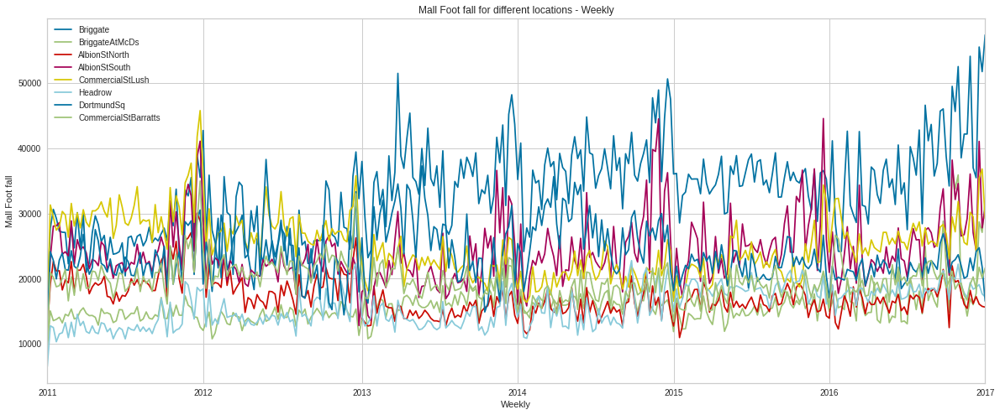

In [ ]:
#from visualization import Visualization
graphs = Visualization(data_for_visualization,location_name_list)
graphs.show_timedistribution('W')

## 5.2 Observations
1. Incount is higher during the last weeks of Decemeber
2. 'Briggate' : There seems to be downward trend in 2015. overall, this seems to be the main gate
3. 'AlbionStNorth' : There is a downward trend throughout




## 5.3 Plots

### Line Plot

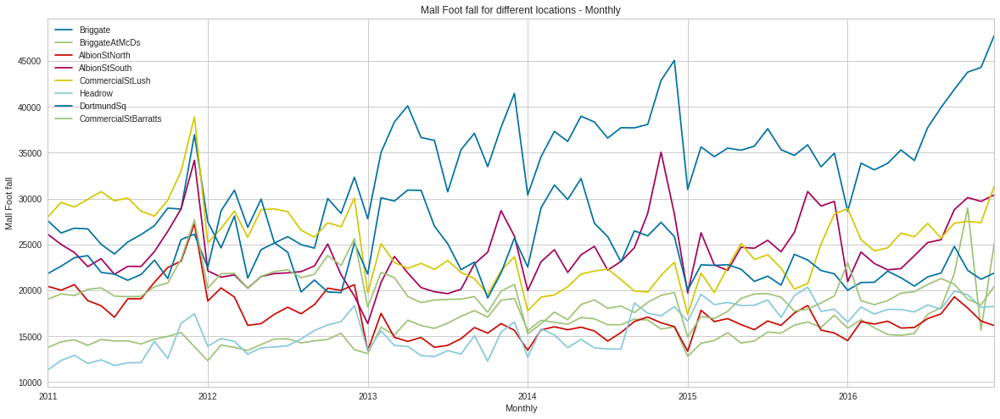

In [ ]:
graphs.show_timedistribution('M')

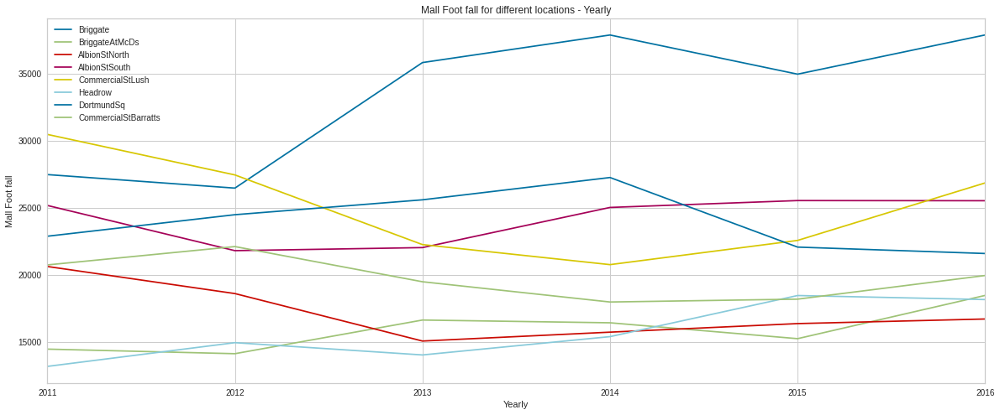

In [ ]:
graphs.show_timedistribution('Y')

### KDE plots

#### KDE plots for 'InCountTotal'

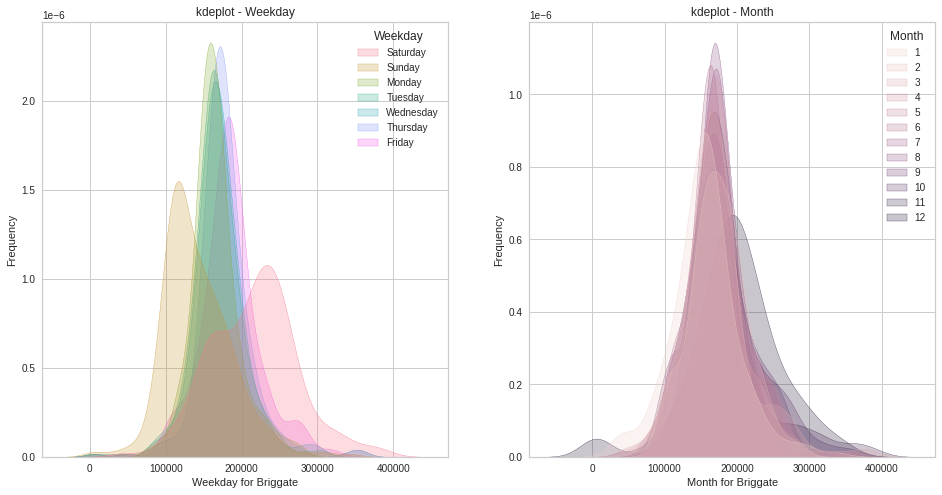

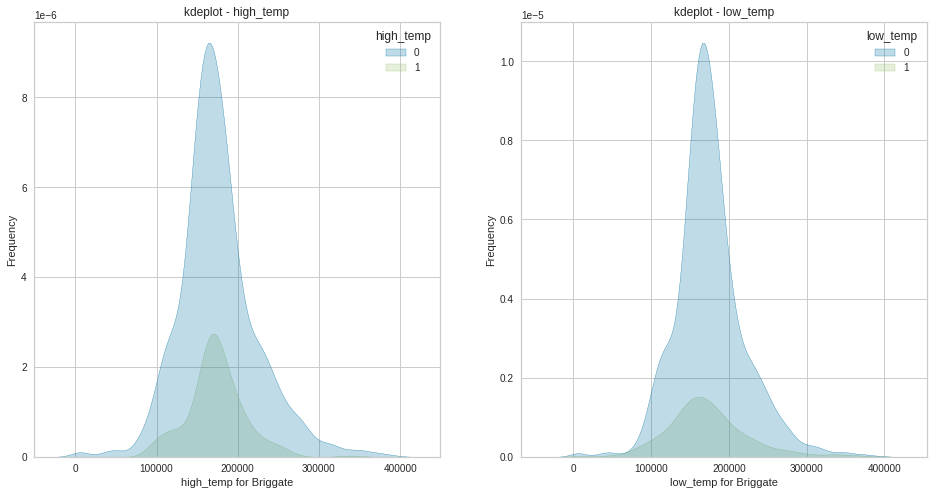

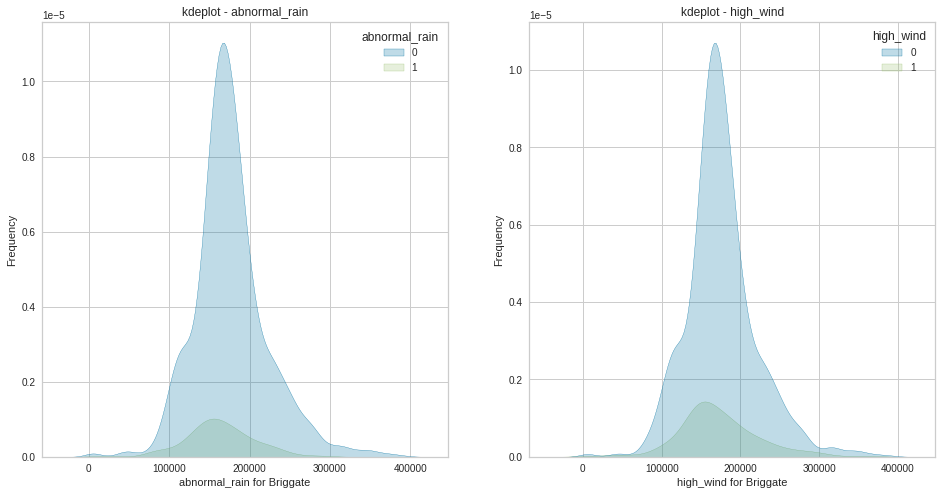

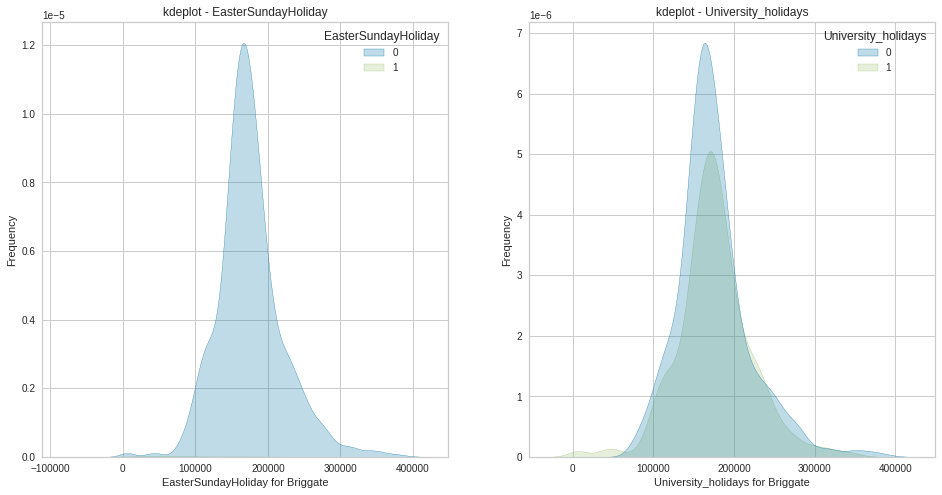

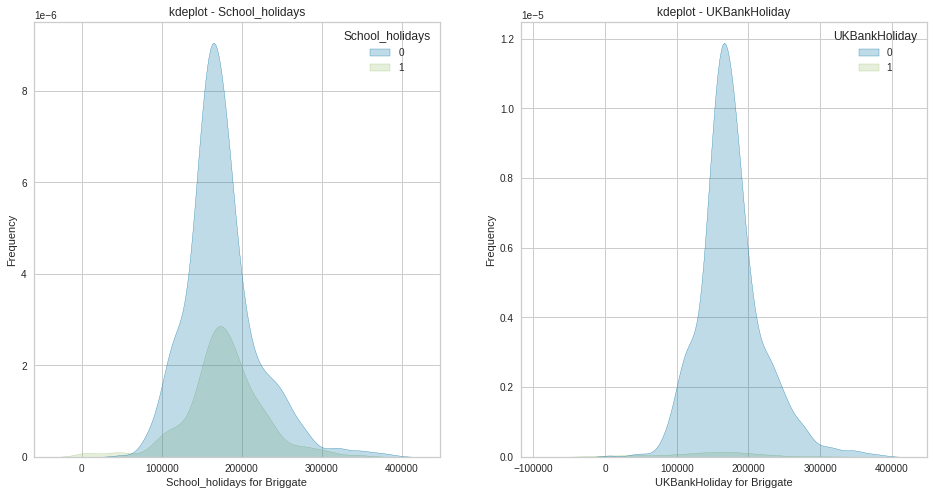

In [ ]:
graphs.plot_graphs_for_list(plot_type = 'kdeplot', target_col = 'InCountTotal', col_list= ['Weekday','Month','high_temp','low_temp','abnormal_rain','high_wind','EasterSundayHoliday','University_holidays','School_holidays','UKBankHoliday'])



Observations:
1. weekday : Saturday seems to be having more incoount as expected
2. Month : December is seen as the busy month with more footfall
3. high_temp, low_temp, abnormal_rain : Incount is high in the absence of these
4. EasterSundayHoliday : InCount is very low
5. Other holidays : We do not see any significant impact on the InCount.

#### Bi-variate KDE plots

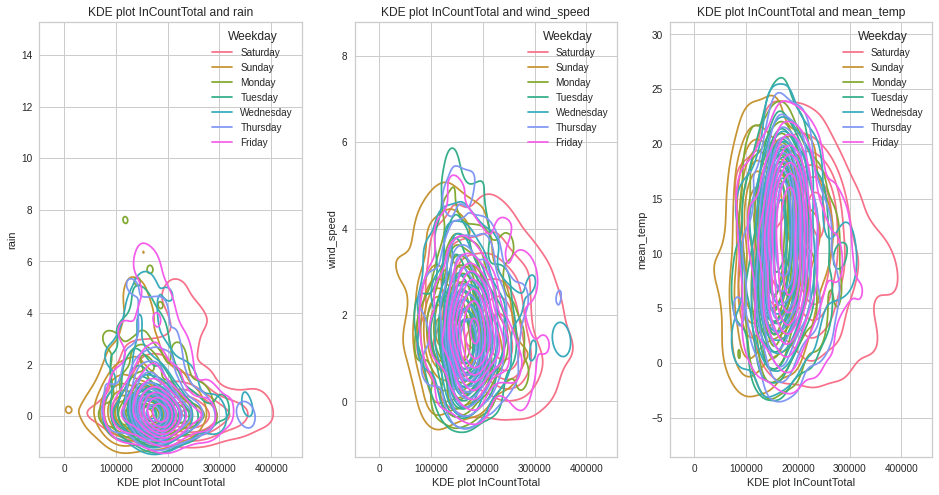

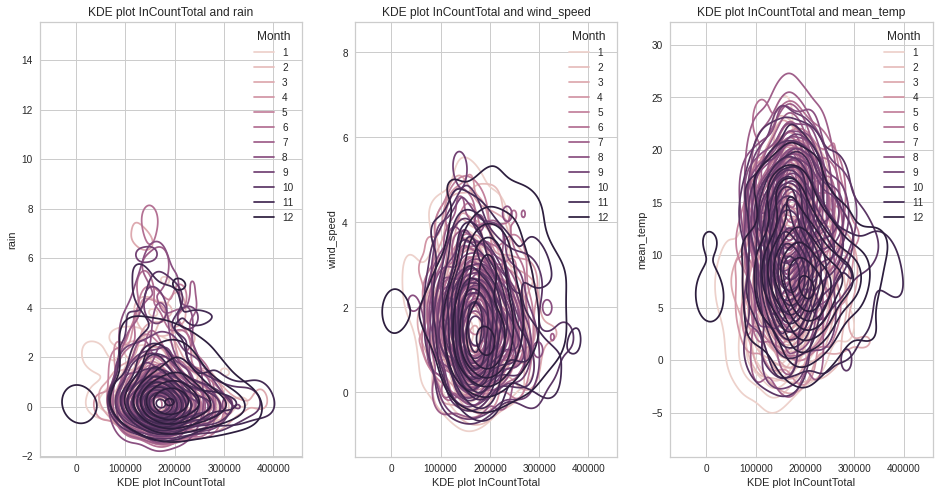

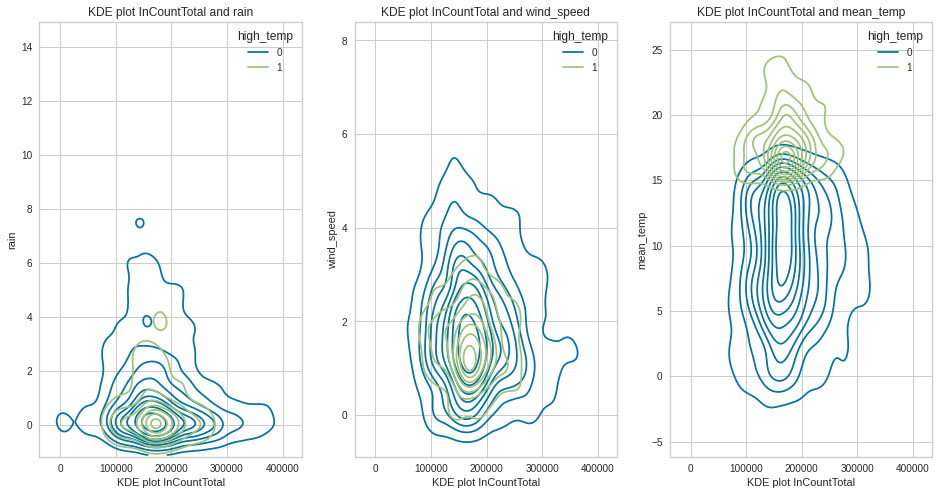

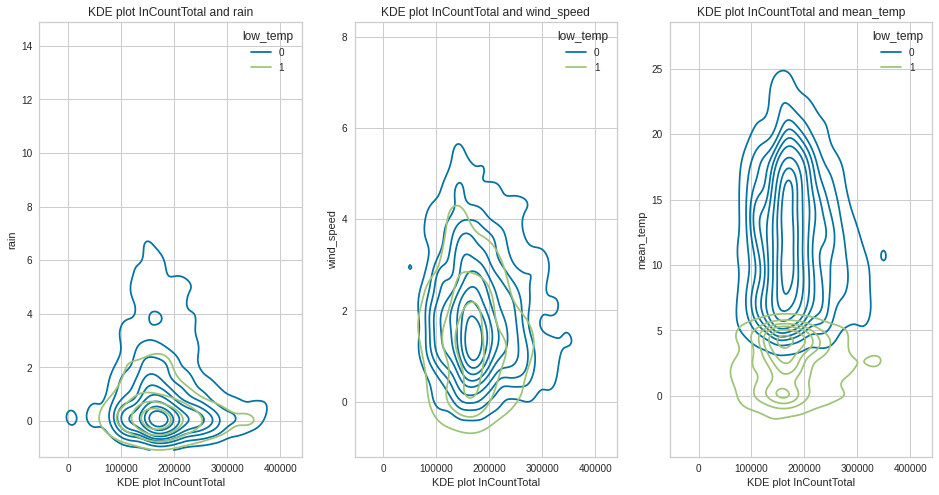

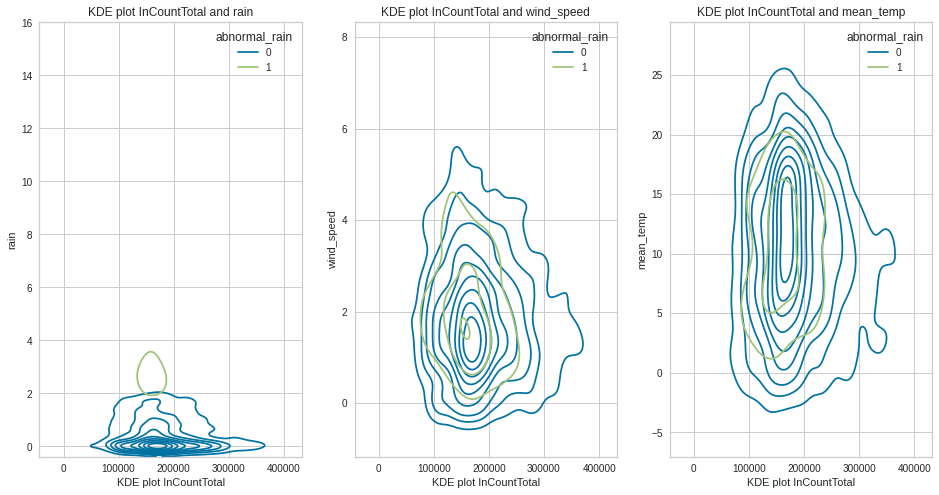

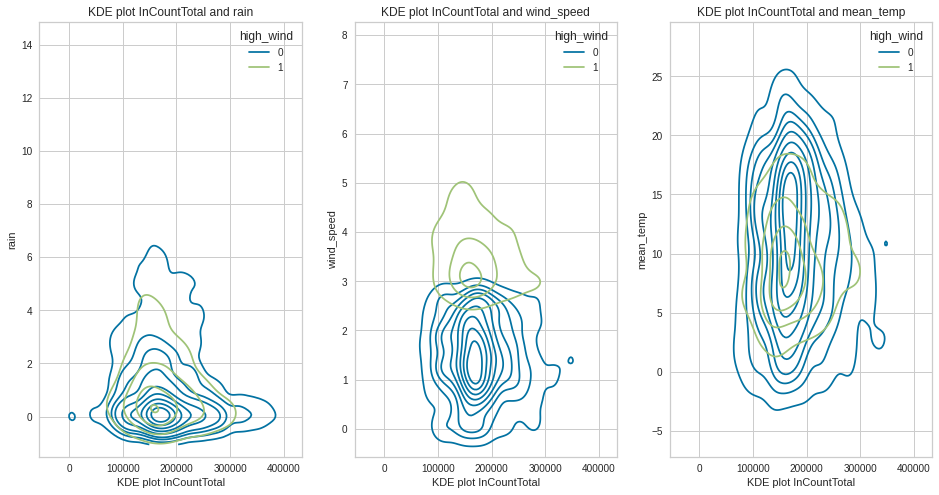

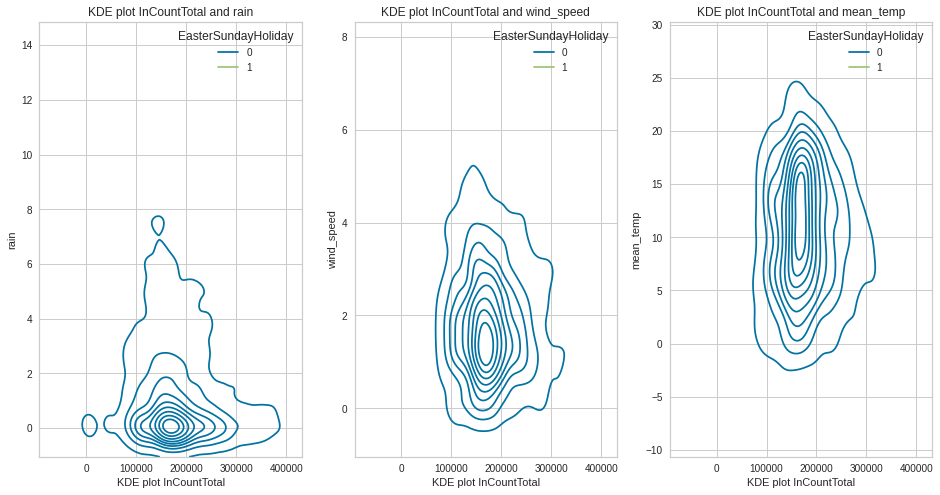

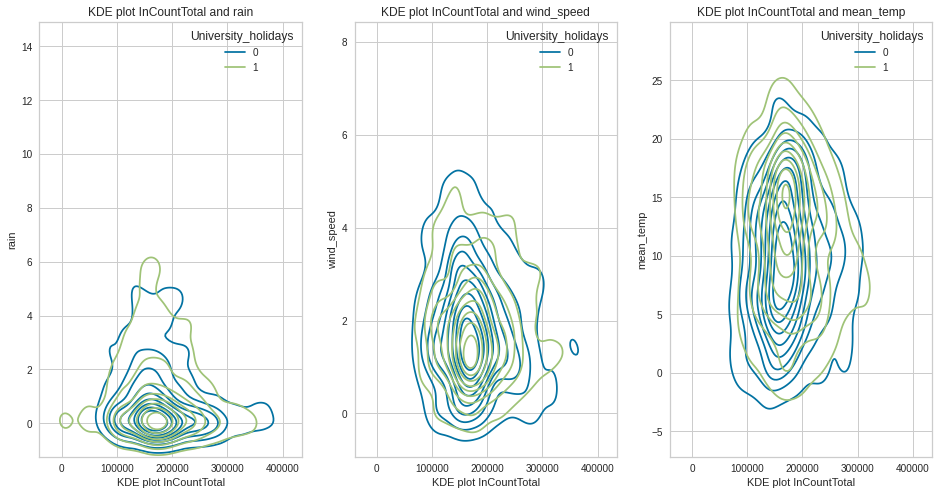

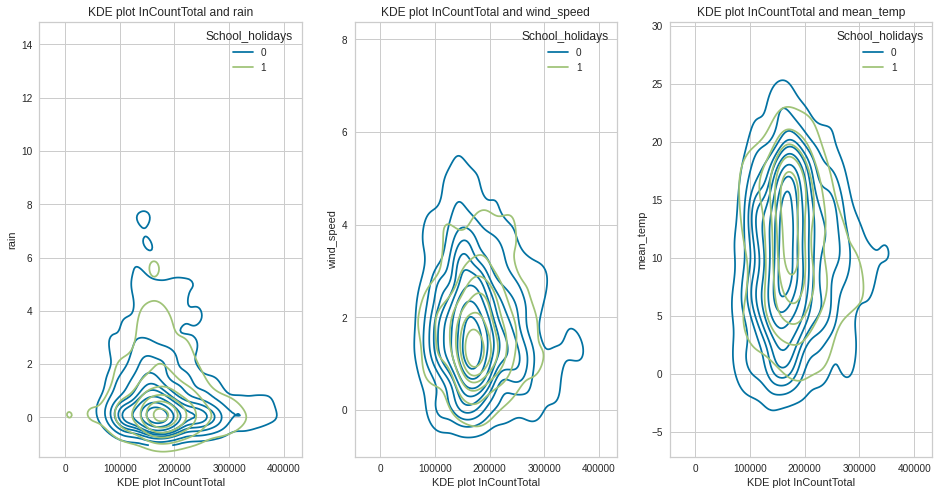

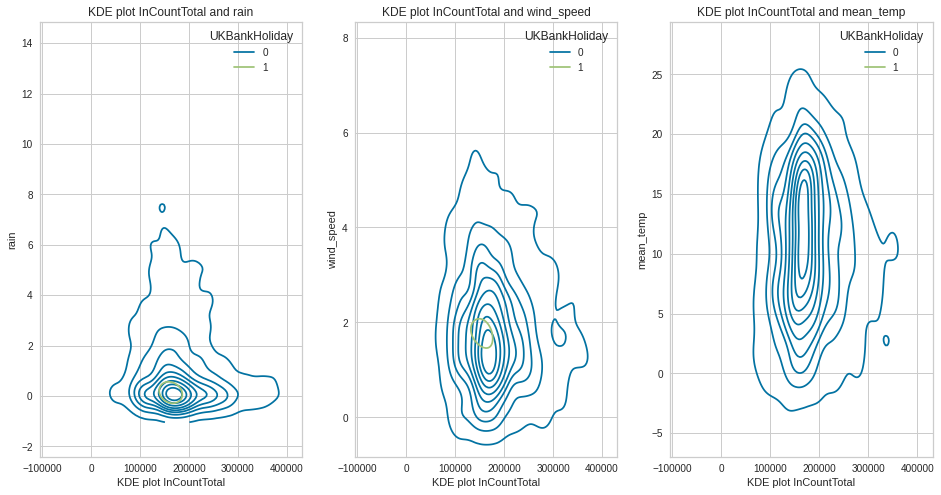

In [ ]:
graphs.bi_variate_kernel_density_plot('InCountTotal',['rain','wind_speed','mean_temp'], hue_list= ['Weekday','Month','high_temp','low_temp','abnormal_rain','high_wind','EasterSundayHoliday','University_holidays','School_holidays','UKBankHoliday'] )

Observations:
1. weekday : when the rain is low, Saturday seems to be having more incount as expected
2. Month : December is seen as the busy month with more footfall regardless of rain/temp situation
3. high_temp, low_temp, abnormal_rain : Incount is high in the absence of these
4. EasterSundayHoliday : InCount is very low
5. Other holidays : We do not see any significant impact on the InCount.

### Univariate Histogram ggplot

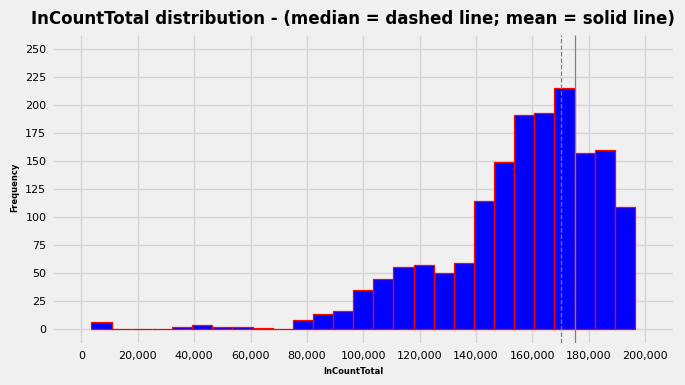

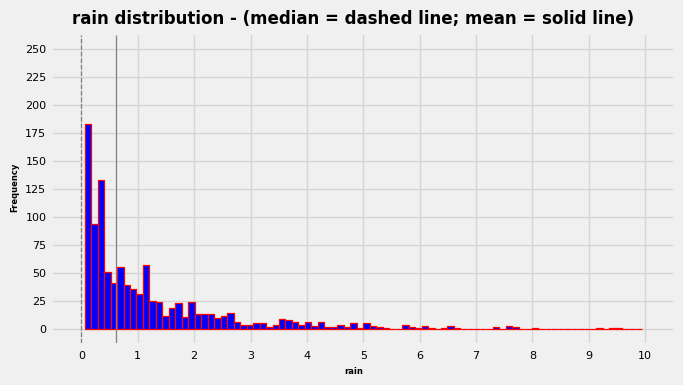

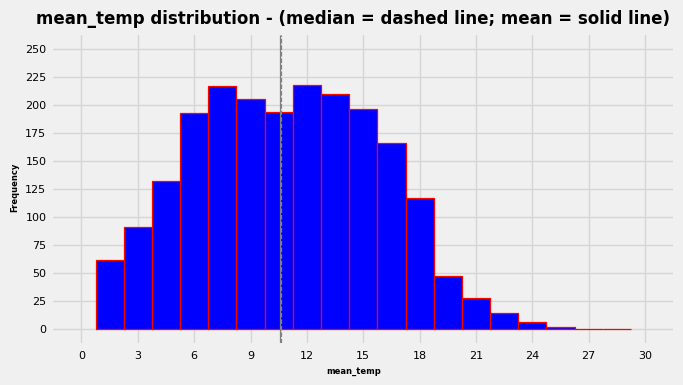

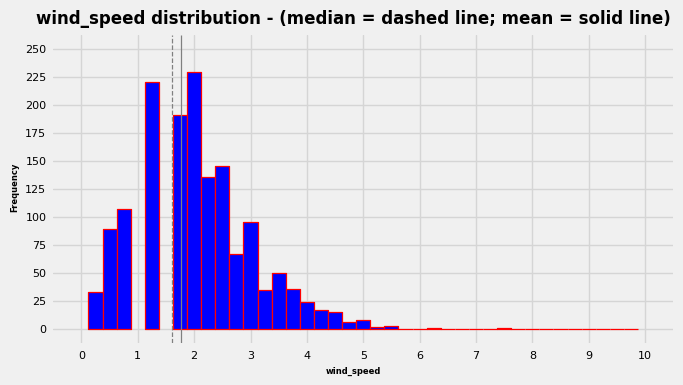

In [ ]:
graphs.uni_variate_ggplot_histogram(['InCountTotal', 'rain','mean_temp','wind_speed'],[200000,10,30,10],[250,250,250,250])

Observations:
1. mean of InCount : 180000
2. mean of rain < 1
3. mean of temp : 10.5
4. mean of wind_speed : ~1.75

### Facet Histogram ggplot

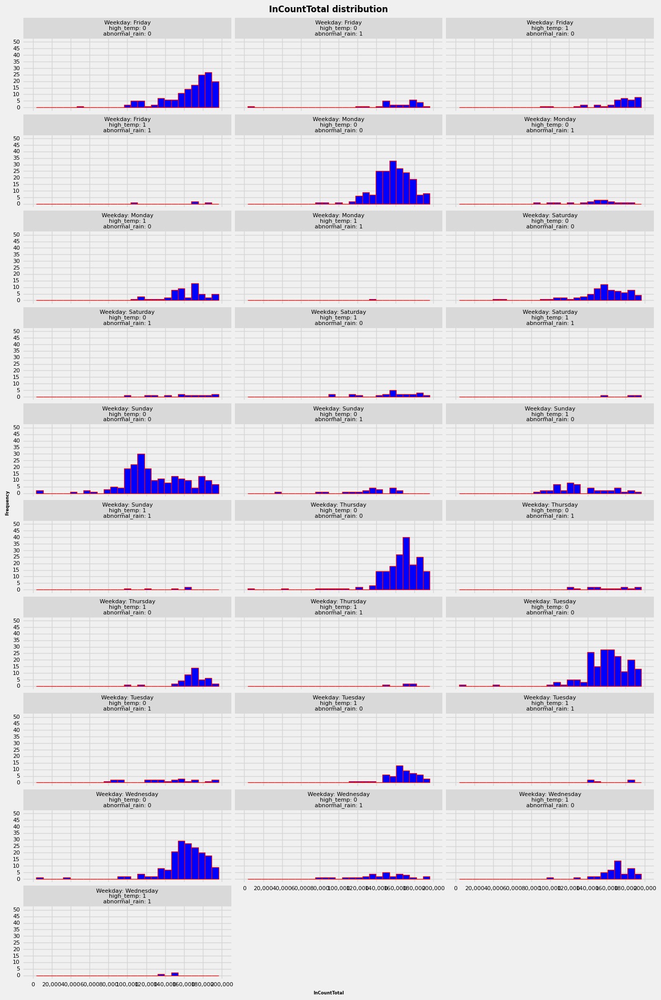

In [ ]:
graphs.facet_ggplot_histogram('InCountTotal',('Weekday','high_temp','abnormal_rain'),200000,50)

Observations

1) The Incount is significanty low during the days with Abnormal rain and also High temperture

2) Abnormal rain seems to have more impact on the Incount than the High temperature. Days with only Abnormal rain has slightly low footfall than the days with only High Temperature


### Scatter ggplot



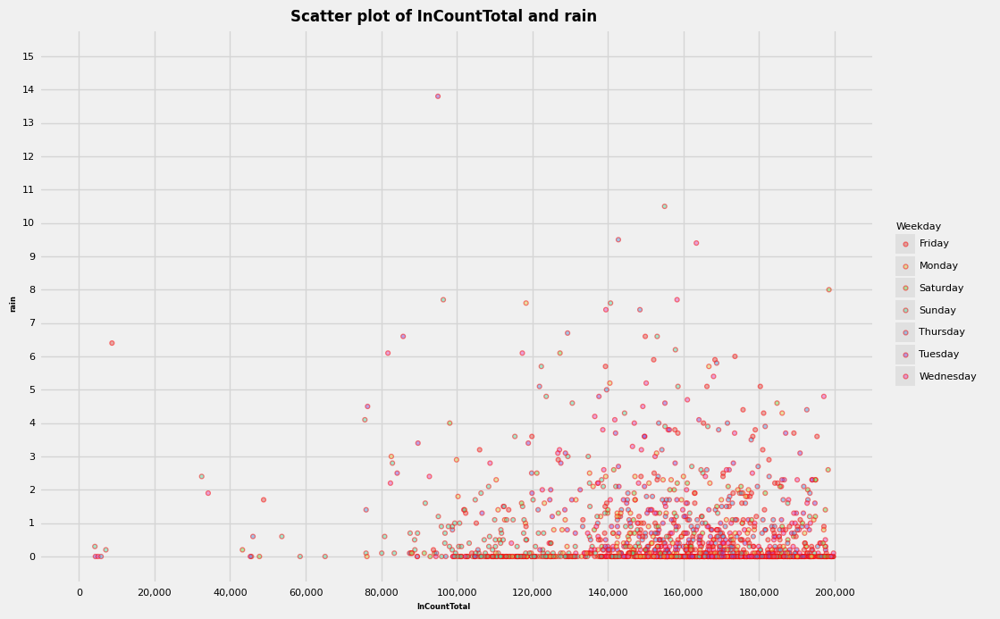

In [ ]:
graphs.scatter_plot_ggplot(x = 'InCountTotal',y='rain', hue='Weekday', x_limit=200000, y_limit=15)

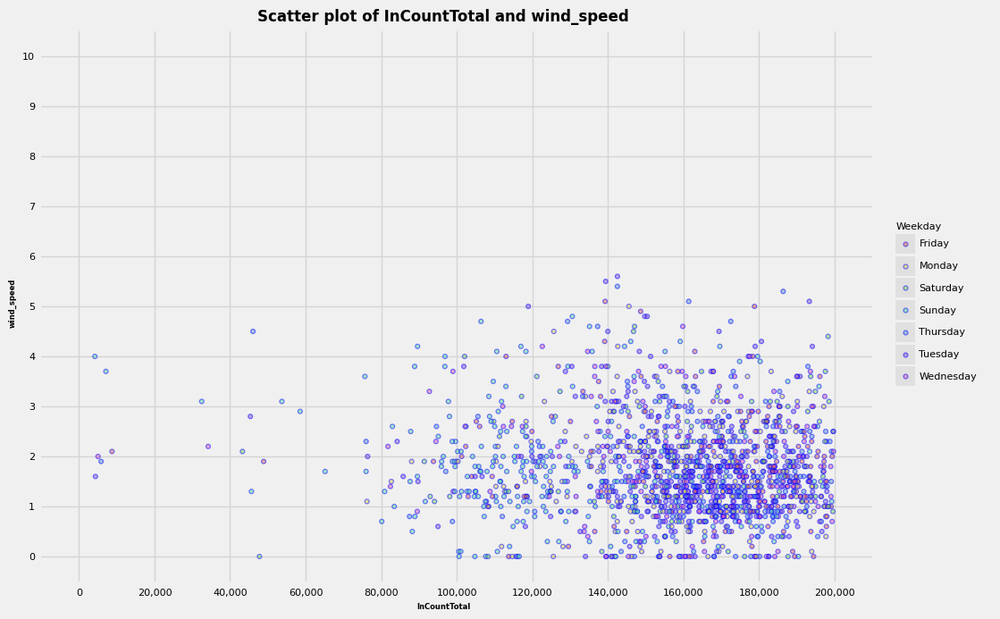

In [ ]:
graphs.scatter_plot_ggplot(x = 'InCountTotal',y='wind_speed', hue='Weekday', color = 'blue', x_limit=200000, y_limit=10)

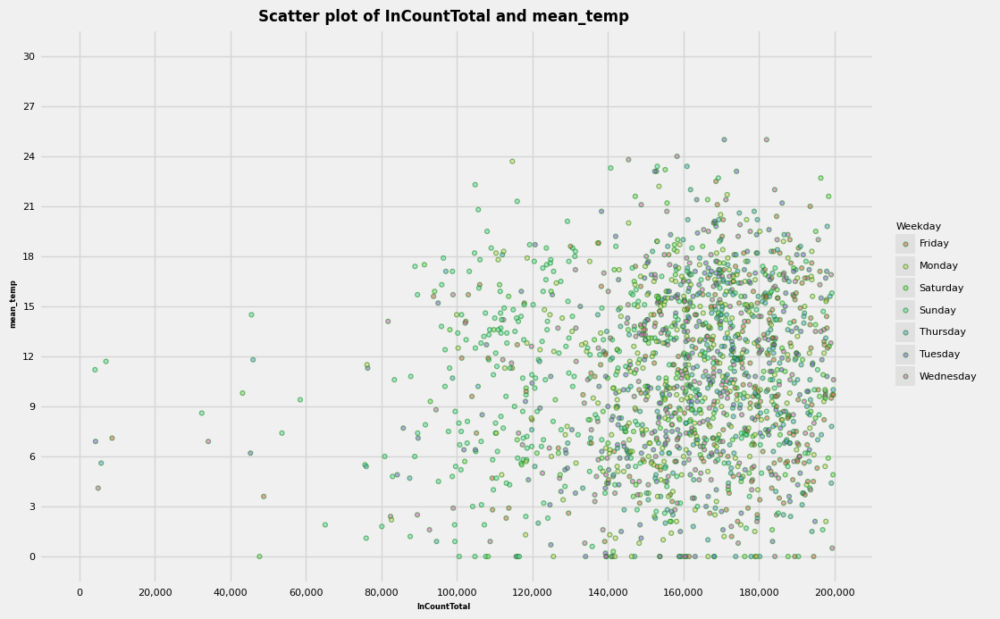

In [ ]:
graphs.scatter_plot_ggplot(x = 'InCountTotal',y='mean_temp', hue='Weekday', color = 'green', x_limit=200000, y_limit=30)

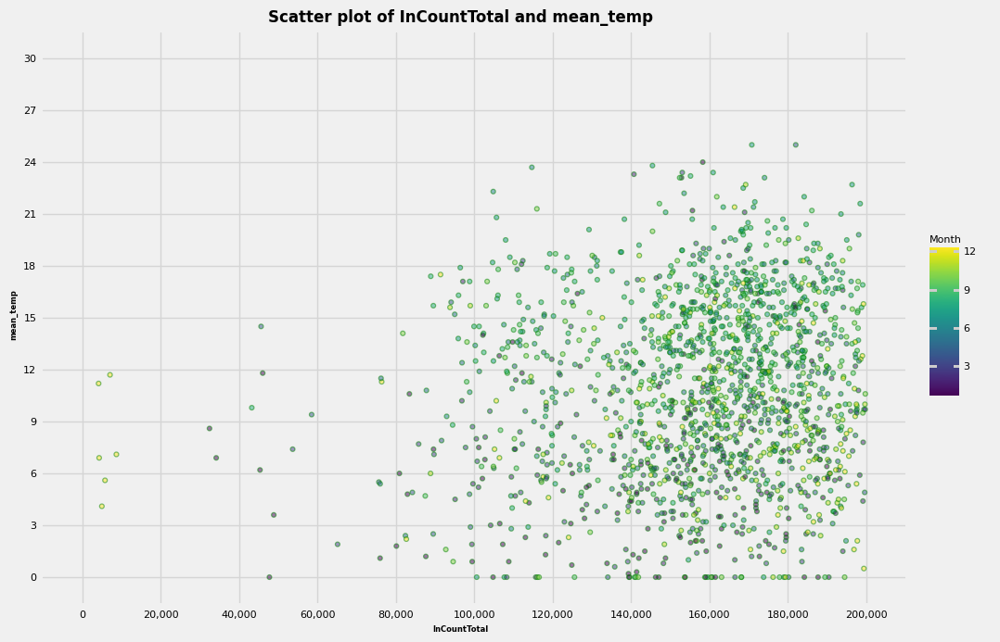

In [ ]:
graphs.scatter_plot_ggplot(x = 'InCountTotal',y='mean_temp', hue='Month', color = 'green', x_limit=200000, y_limit=30)

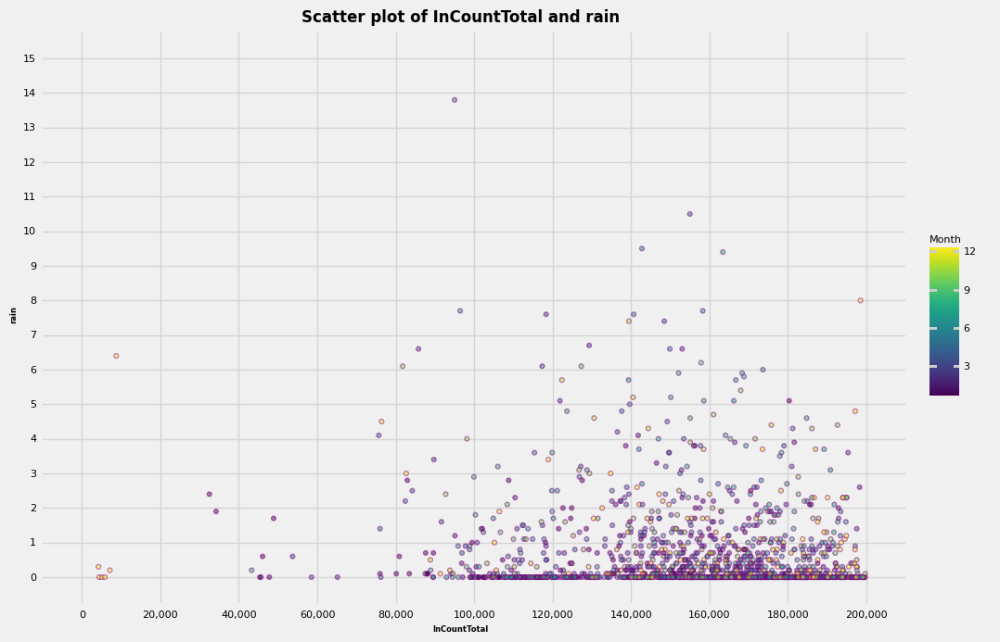

In [ ]:
graphs.scatter_plot_ggplot(x = 'InCountTotal',y='rain', hue='Month', color = 'purple', x_limit=200000, y_limit=15)

### Swarm plot

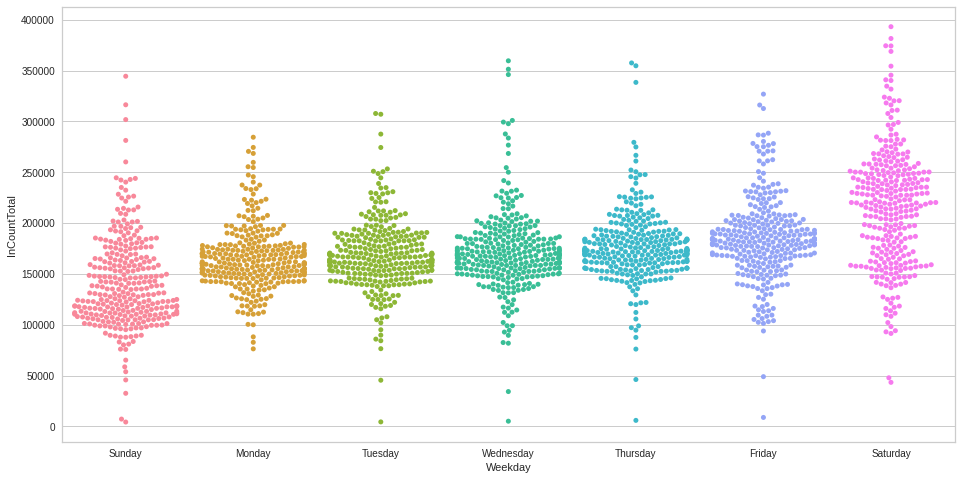

In [ ]:
graphs.show_categorical_plots(style="swarm")


### Swarm plot with Hue

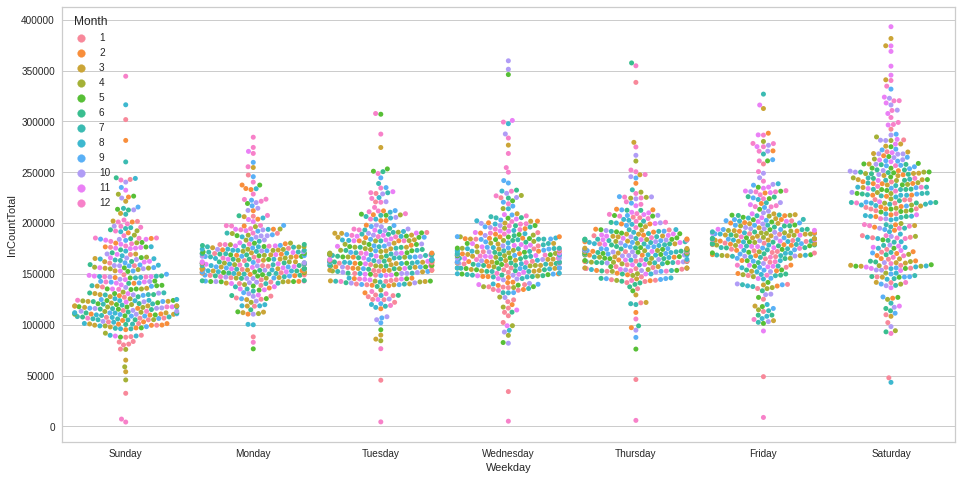

In [ ]:
graphs.show_categorical_plots(style="swarm_with_hue")

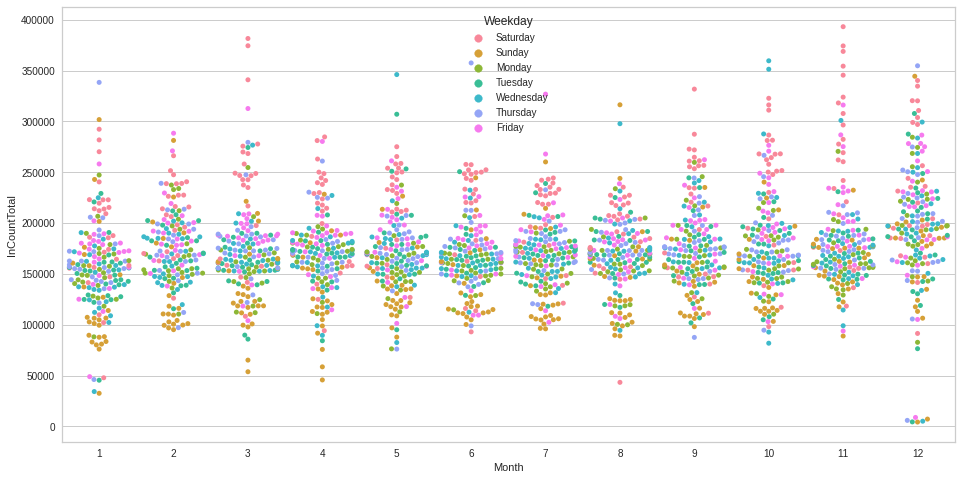

In [ ]:
graphs.show_categorical_plots(style="swarm_with_hue", x='Month',hue='Weekday',order=[1,2,3,4,5,6,7,8,9,10,11,12])

### Strip plot

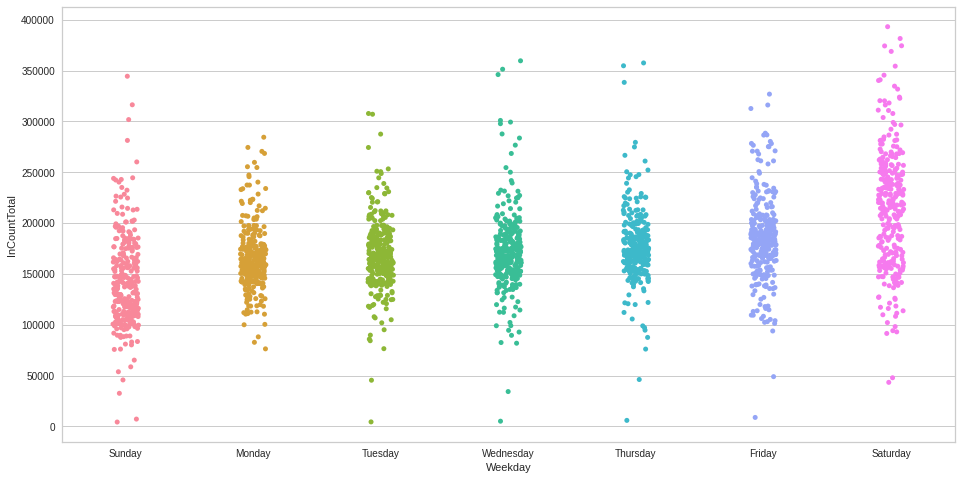

In [ ]:
graphs.show_categorical_plots(style="stripplot")

### Strip plot with Hue

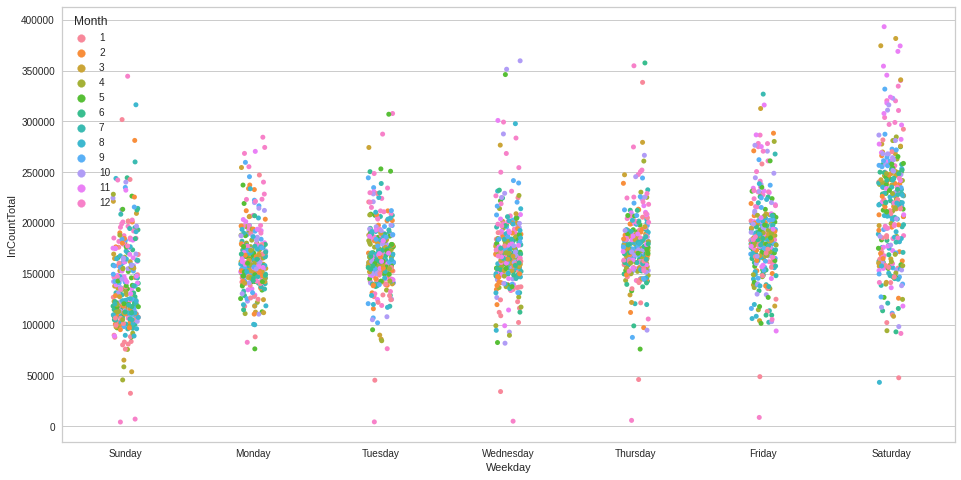

In [ ]:
graphs.show_categorical_plots(style="stripplot_with_hue")

Observations from Scatter Plots (Swarm and Strip with Hue) :
1. Weekdays : There is a gradual increase in incount from Sunday to Saturday. Saturday being highest incount
2. Months : we can see a seasonal trend in months - peaks in the months of Dec, Nov and March. Lower in the summer months(Jul and August) and also in Jan

### Box plot

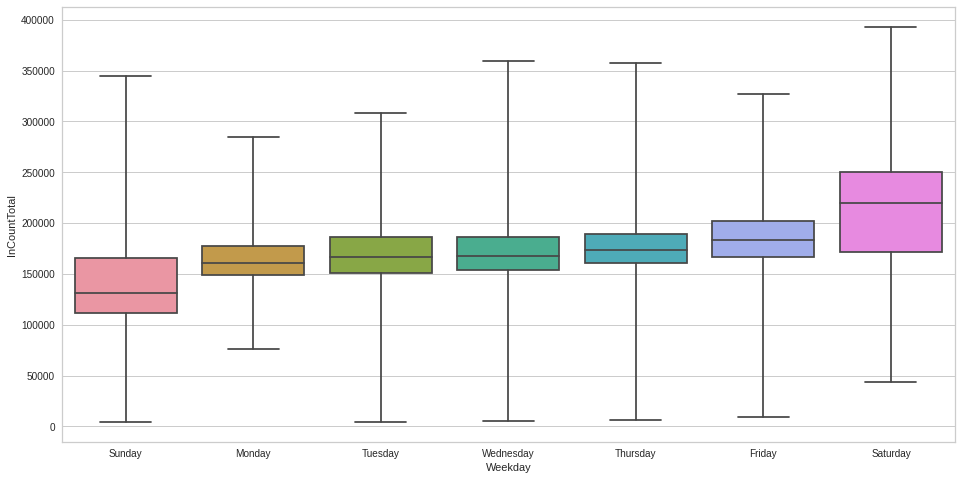

In [ ]:
graphs.show_categorical_plots(style="box")

Observations for Box Plot:
1. The Total variation of Incount is seen similar on Sunday, Wednesday, Thursday and Saturday.
2. The variation within the middle 50% is higher during Saturday followed by Sunday.
3. However the median is highest on Saturday, which is more than the 75% of overall InCount on the other days.
4. We see a Left skew on Saturday, Right Skew on Sunday, while the other days we see Symmetric distribution.

### Violen plot

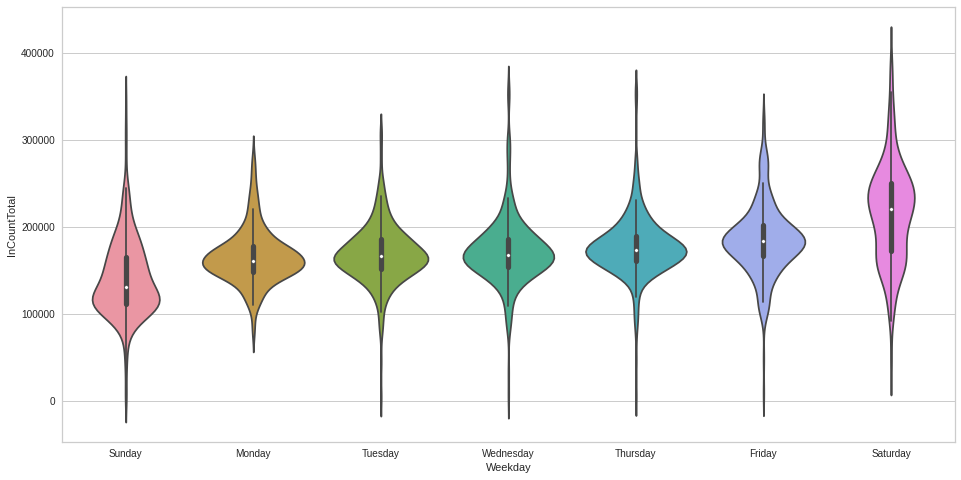

In [ ]:
graphs.show_categorical_plots(style="violen")

### Boxen plot

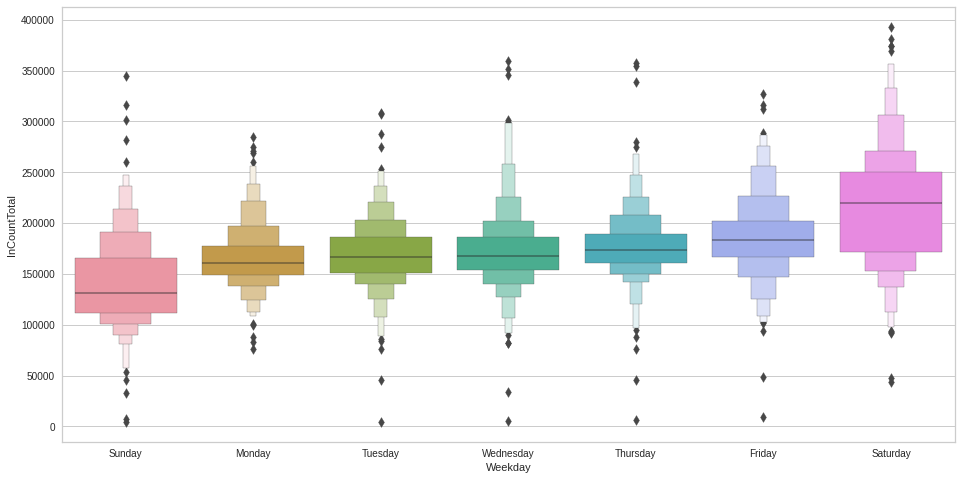

In [ ]:
graphs.show_categorical_plots(style="boxen")

Observations for Distribution plots:
1, Distribution of data in more on Saturday which is between 100000 and 300000

2, Monday to Friday the distribution is similar

3, On some of the days the distribution is also minimum except monday and saturdays.

4, Saturday we can see that there are some data which has count of ,400000 count compared to other days where data is normally at 350000

### Autocorrelation plots

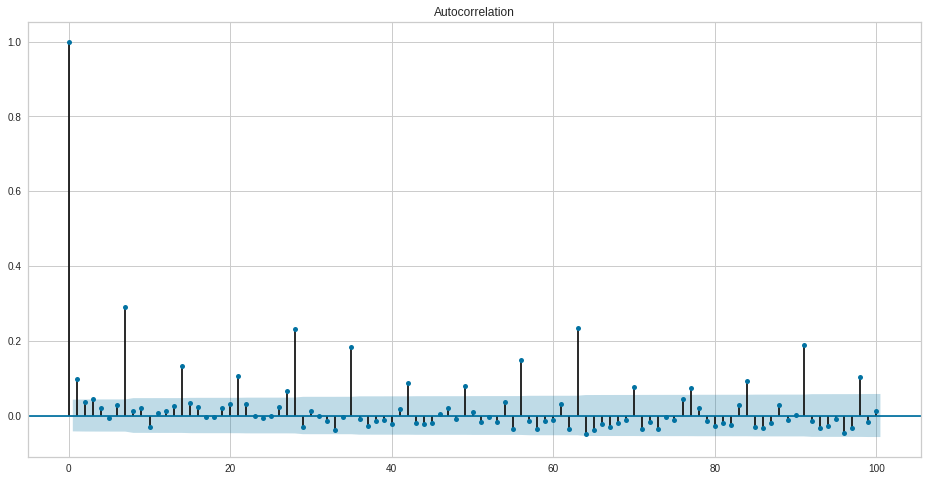

In [ ]:
plot_acf(data_final['InCountTotal'], lags=100)
plt.show()

Observations:
1. every 7th day seems to have some correlations --> inline with the trend on different days
2. every 4 weeks (say, month - 30 days), there is a correlation

### Histogram plot

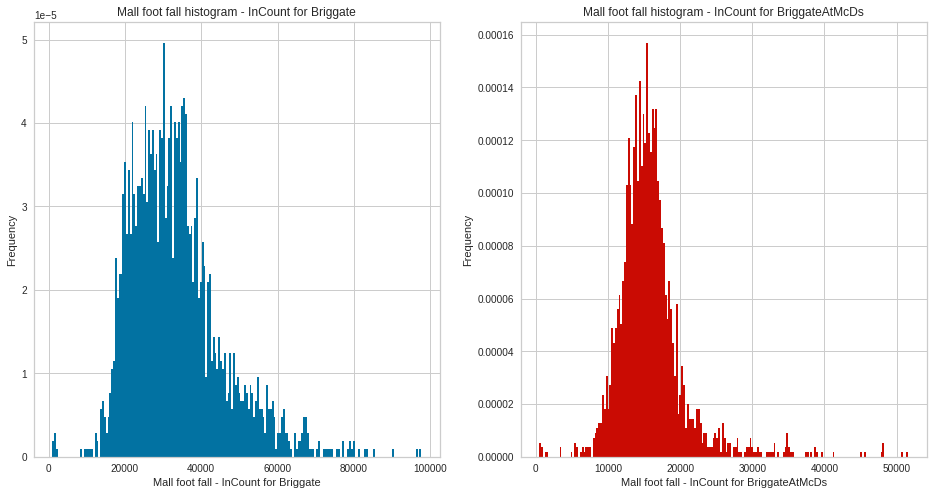

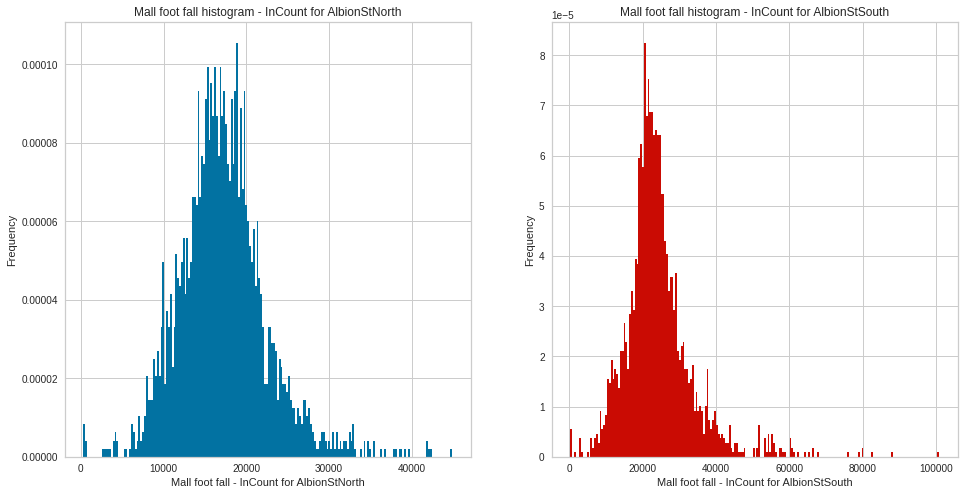

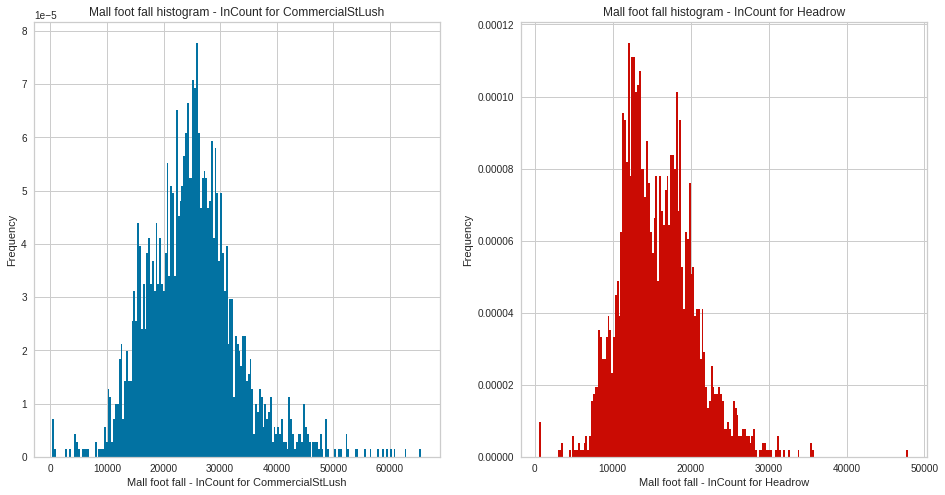

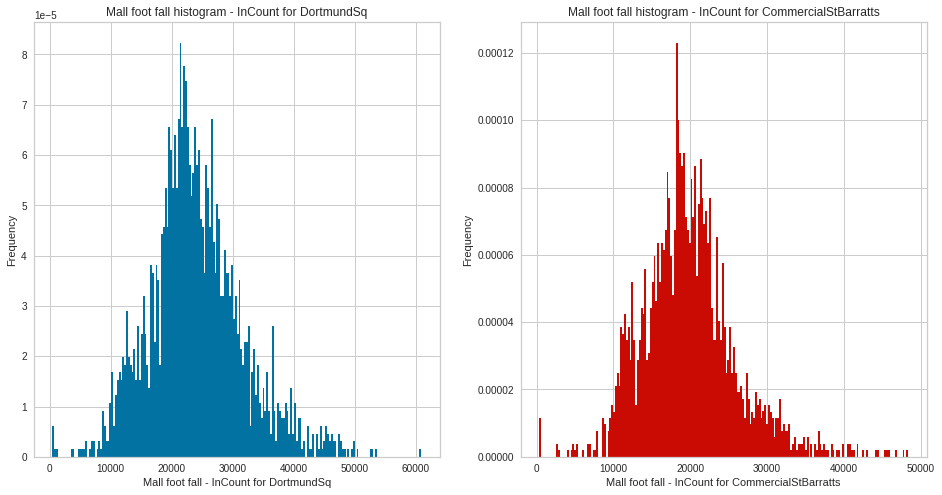

In [ ]:
graphs.plot_graphs(plot_type = 'histogram')

Observations

The Incount for the gates - Briggate, CommercialStLush, Headrow and CommercialStBarrats are slightly skewed towards higher incount. Rest of the gates Incount is almost normally distributed.

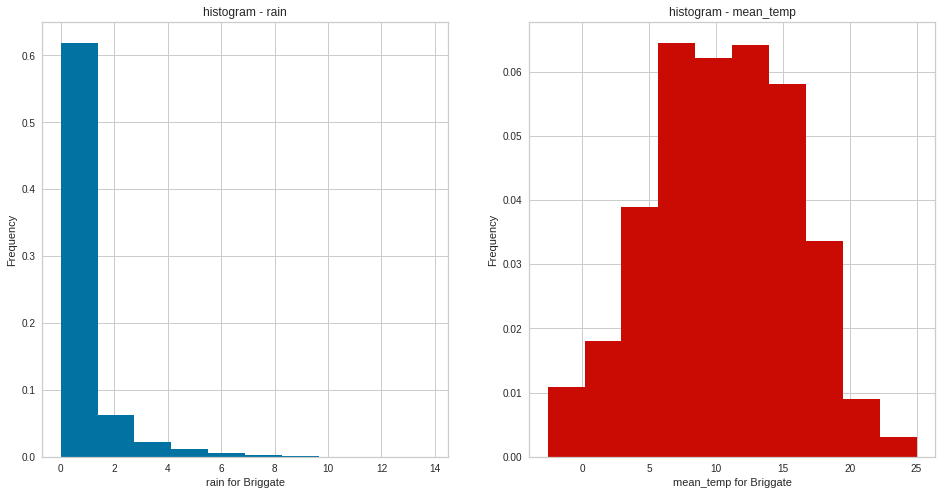

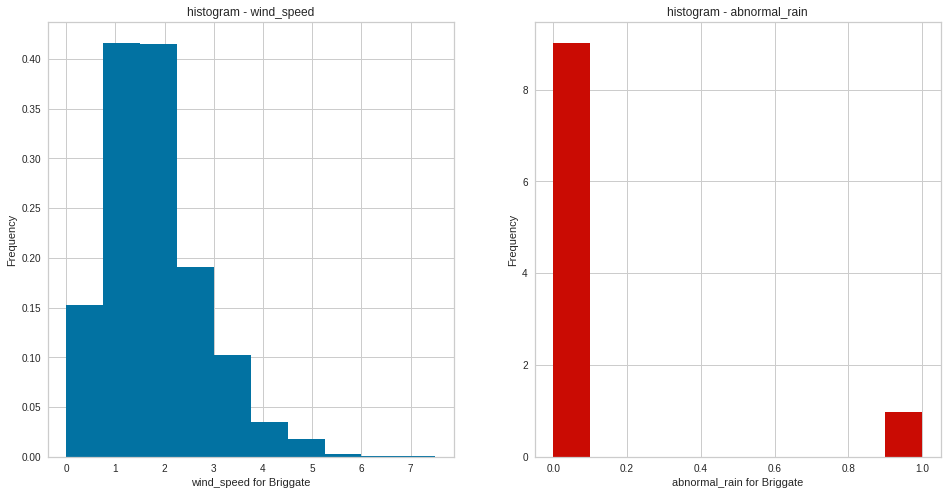

In [ ]:
graphs.plot_graphs_for_list(plot_type = 'histogram', col_list =['rain','mean_temp','wind_speed','abnormal_rain'])

Observations

1) Incount is lower as windSpeed is higher

2) Incount is lower, as the rain is higher

3) Incount is significantly low during Abnormal rain

4) Incount is almost normally distributed over mean temperature. The Incount is lower when the mean teamperature is low or high.



### Box plot (outlier) for InCount

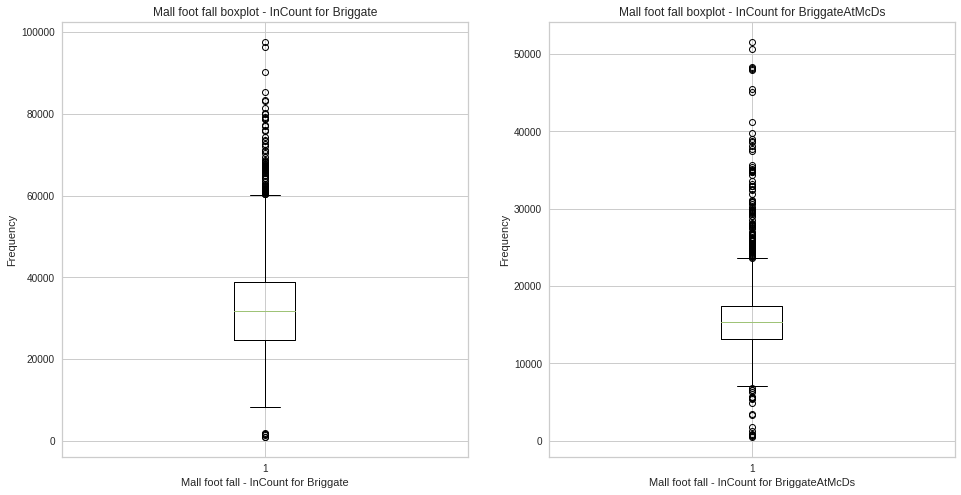

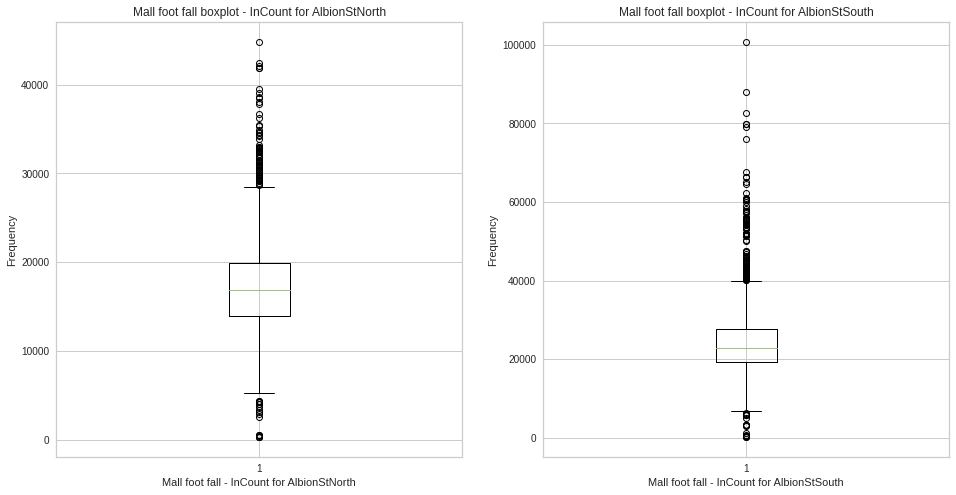

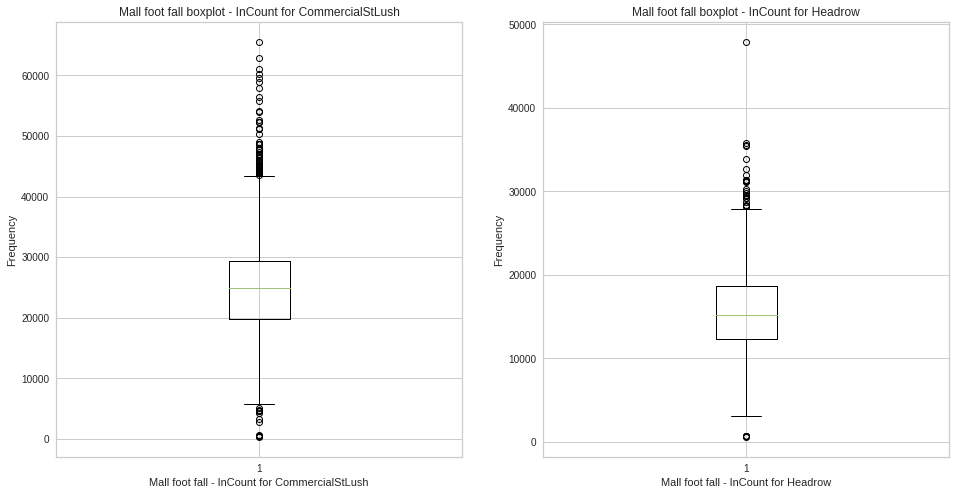

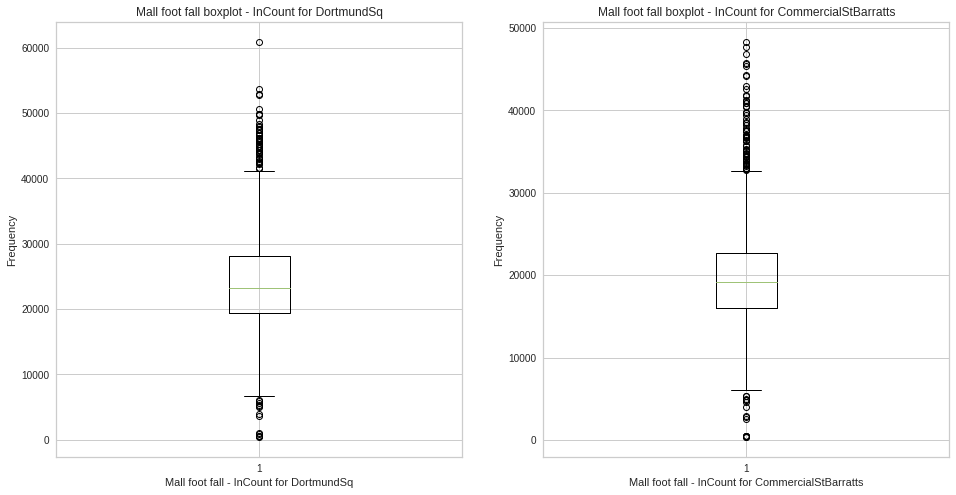

In [ ]:
graphs.plot_graphs(plot_type = 'boxplot')

In [ ]:
for location in graphs.modified_location_name_list:
  print(data_for_visualization[location].nlargest(2))

DateTime
2013-03-30    97623.0
2013-11-30    96325.0
Name: InCountBriggate, dtype: float64
DateTime
2016-03-12    51606.0
2016-10-12    50716.0
Name: InCountBriggateAtMcDs, dtype: float64
DateTime
2011-03-12    44852.0
2011-10-12    42398.0
Name: InCountAlbionStNorth, dtype: float64
DateTime
2014-11-29    100790.0
2016-03-12     88058.0
Name: InCountAlbionStSouth, dtype: float64
DateTime
2011-03-12    65560.0
2011-11-26    62929.0
Name: InCountCommercialStLush, dtype: float64
DateTime
2014-05-07    47913.0
2012-08-12    35750.0
Name: InCountHeadrow, dtype: float64
DateTime
2014-05-07    60911.0
2013-04-27    53649.0
Name: InCountDortmundSq, dtype: float64
DateTime
2011-10-12    48339.0
2012-12-15    47691.0
Name: InCountCommercialStBarratts, dtype: float64


Observations : There are a few days where incount is much higher than other days

### Boxplot for other attributes

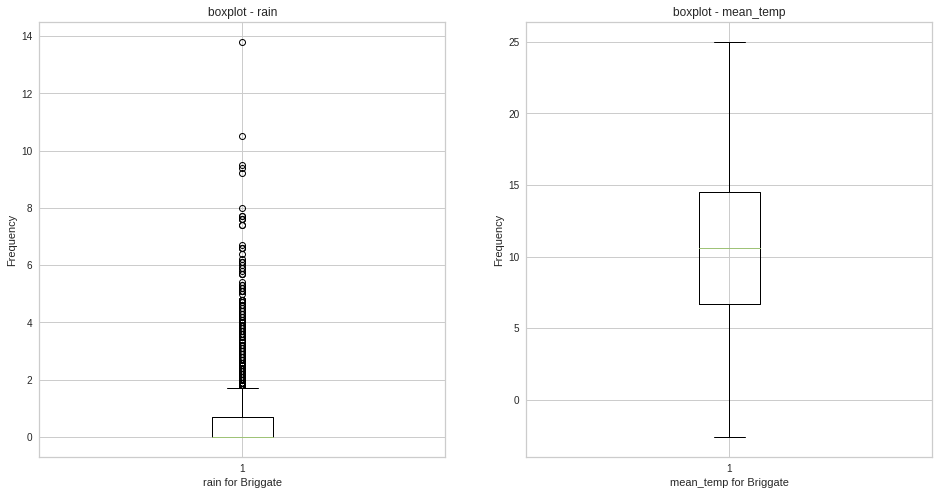

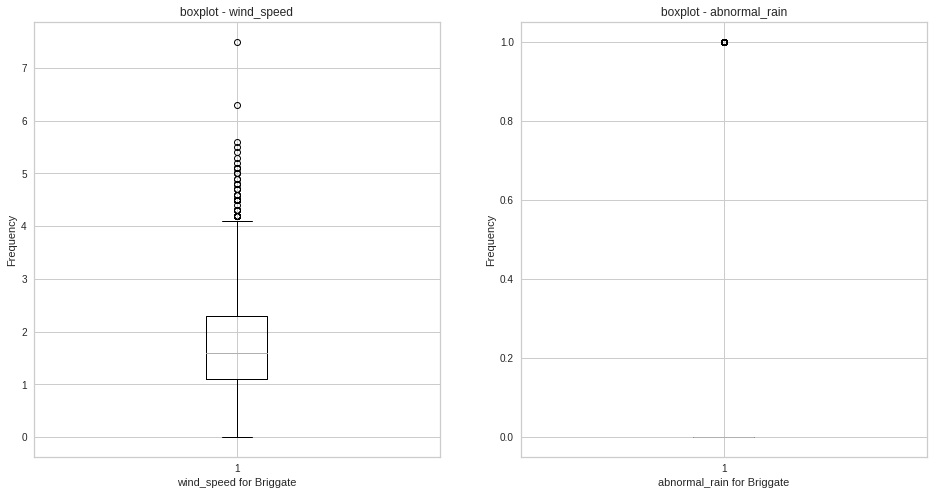

In [ ]:
graphs.plot_graphs_for_list(plot_type = 'boxplot', col_list =['rain','mean_temp','wind_speed','abnormal_rain'])

Observations :
1. mean_temp , abnormal_rain : no outliers
2. rain : There is one day with rain = 13.8
3. wind speed is high on a few days

### Pair plot & Heatmap

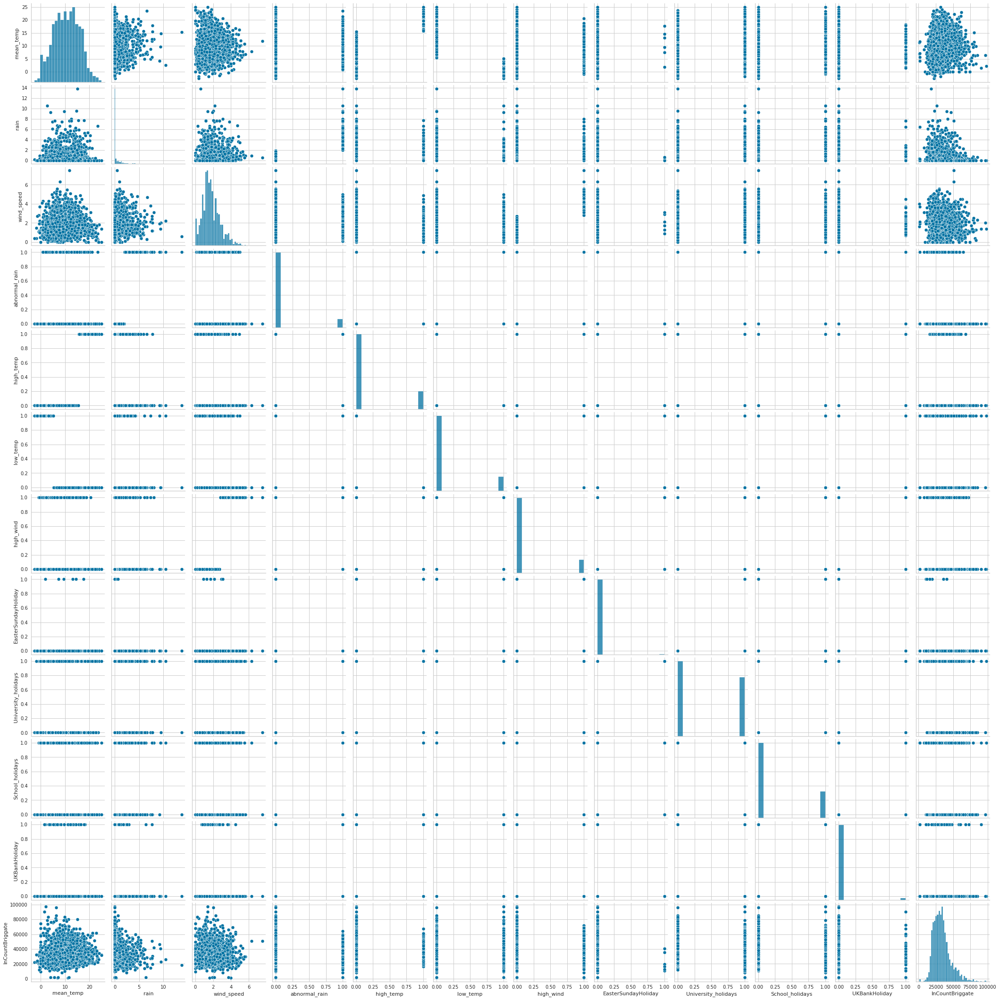

In [ ]:
graphs.show_pairplot()

Observations:
1. rain : when there is no rain or less rain, incount is higher
2. wind-speed : When the wind-speed is lower, the incount is higher
3. abnormal_rain : when there is no abnormal_rain, incount is higher. linked with rain attribute
4. high_temp : when there is no high_temp, Incount is higher
5. low_temp : There is no impact on Incount if low_temp or not
6. high_wind : if there is no high_wind, Incount is higher
7. EasterSundayHoliday : if it's EasterSunday, the InCount is very **low**
8. School Holday/University Holiday - we do not see any major changes in the in-flow
9. UK Bank holiday - Incount is slighlty lower on bank holidays

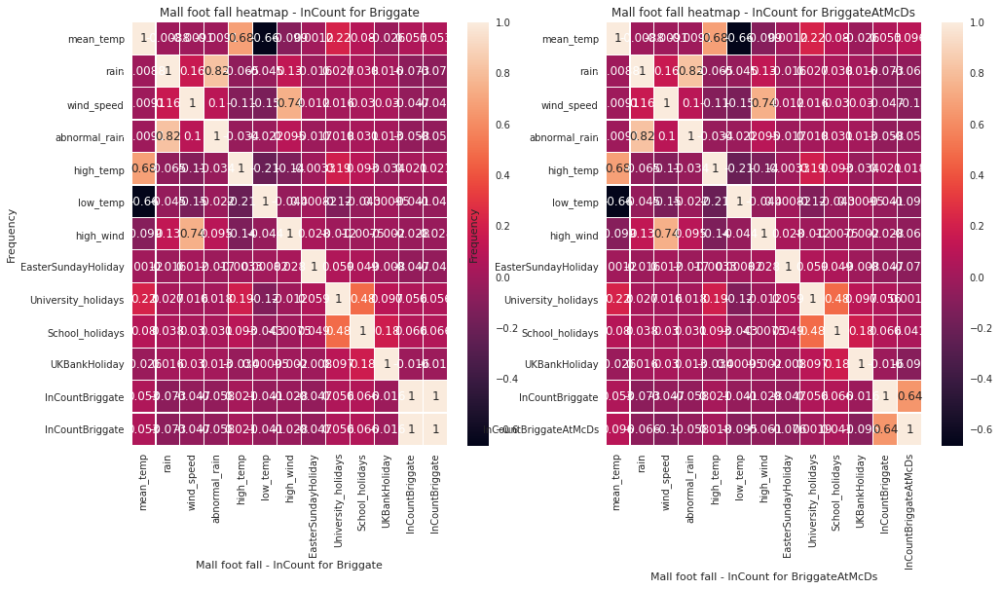

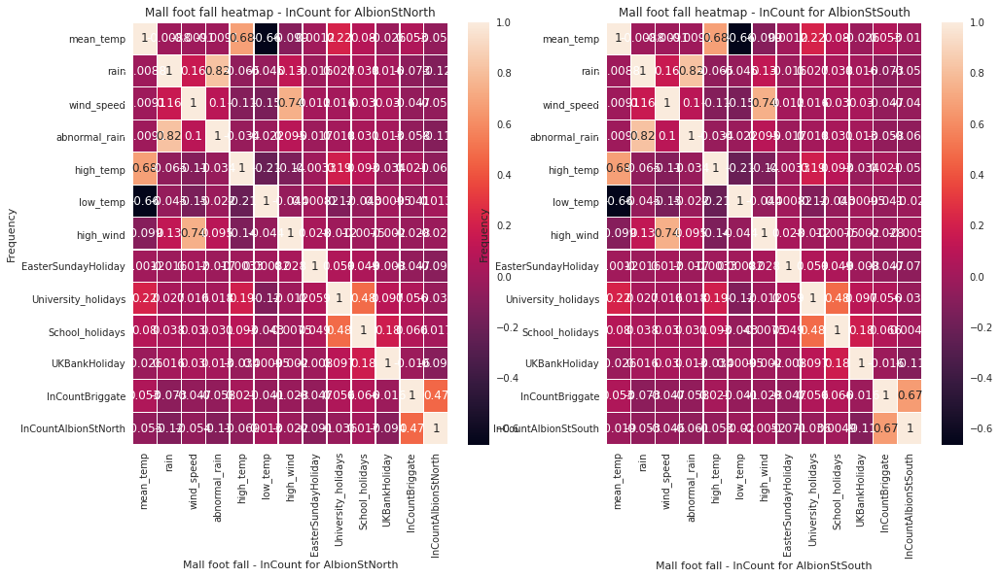

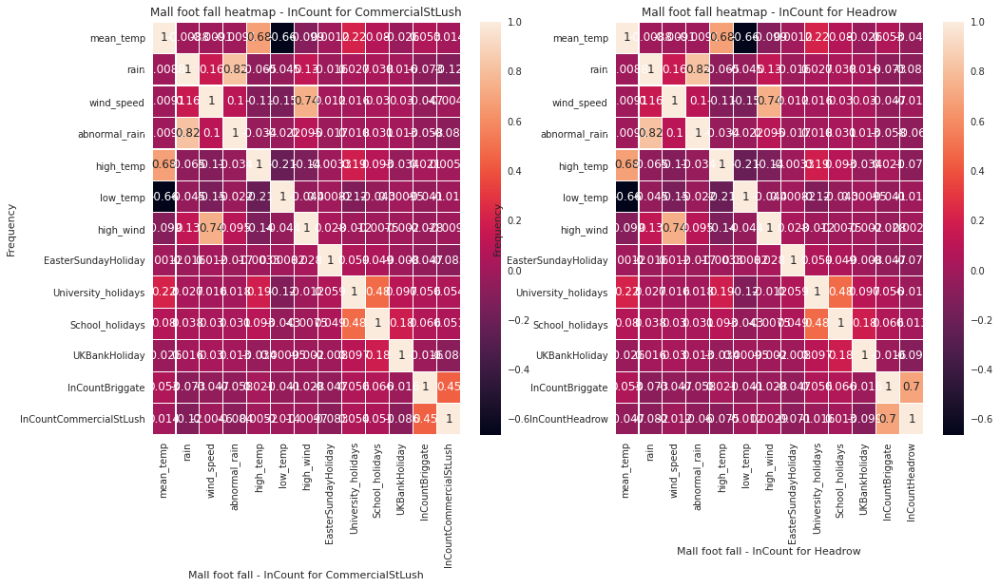

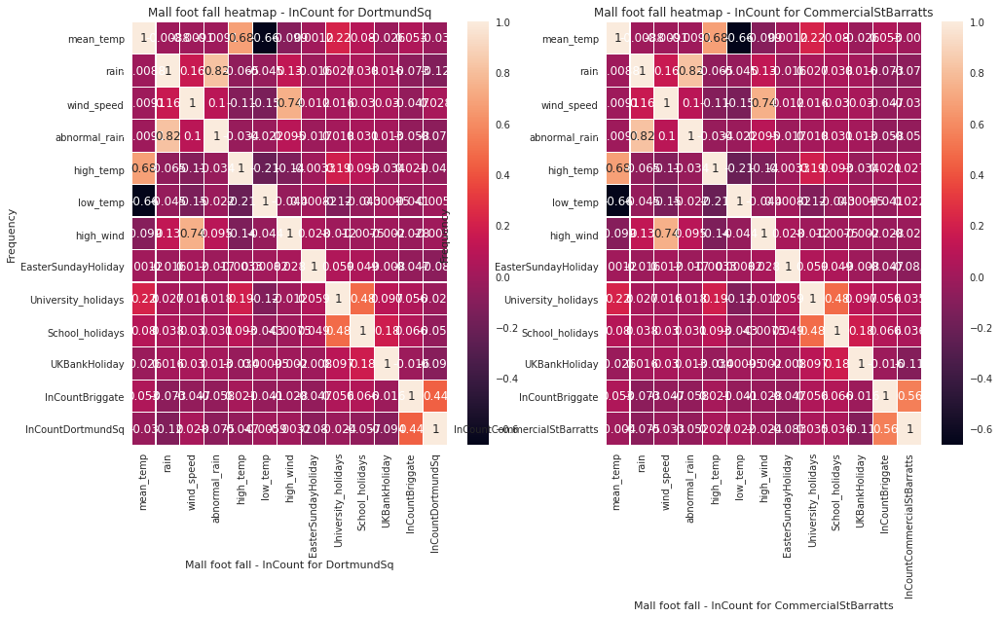

In [ ]:
graphs.plot_graphs(plot_type='heatmap')

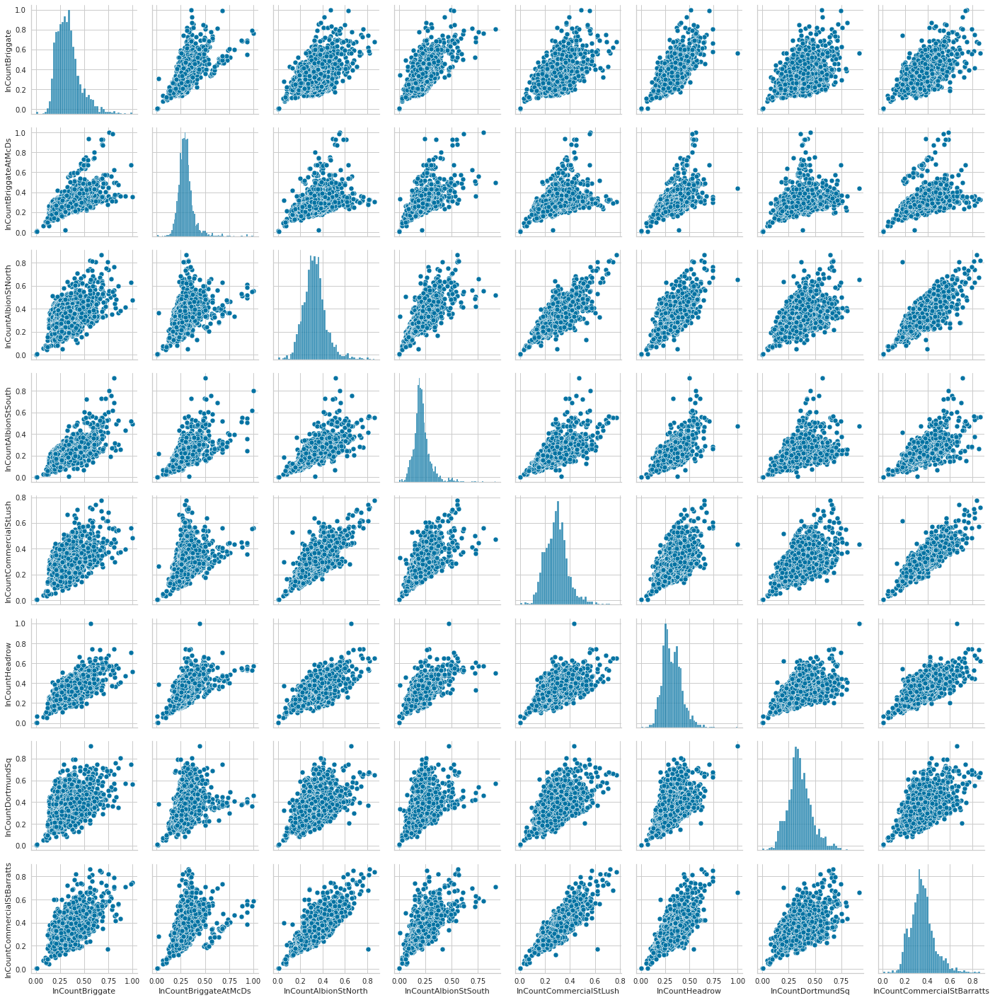

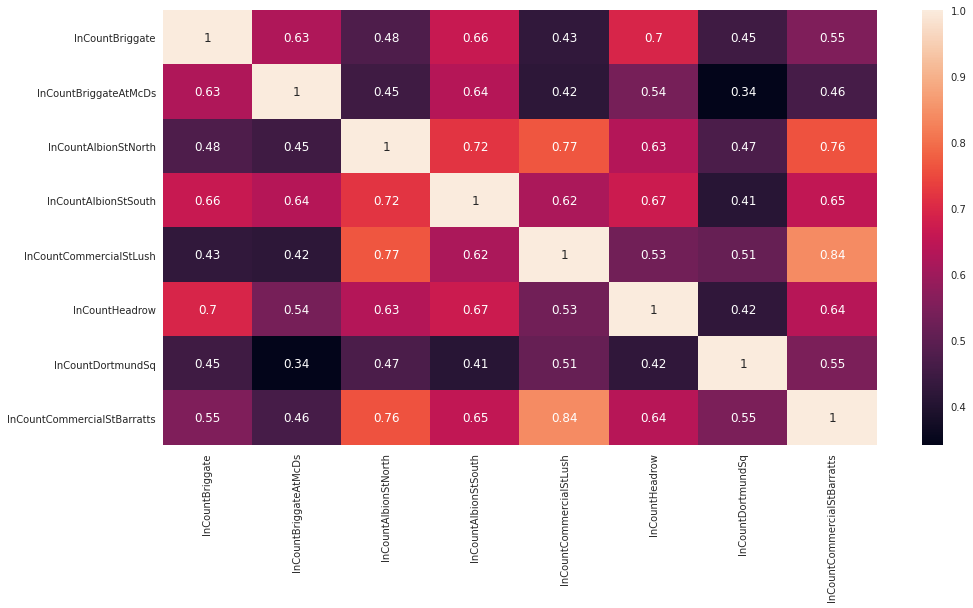

In [ ]:
graphs.comparegates()

Observation: The gates CommercialStLush and CommercialStBarratts are closely correlated

Categorical Columns Correlation

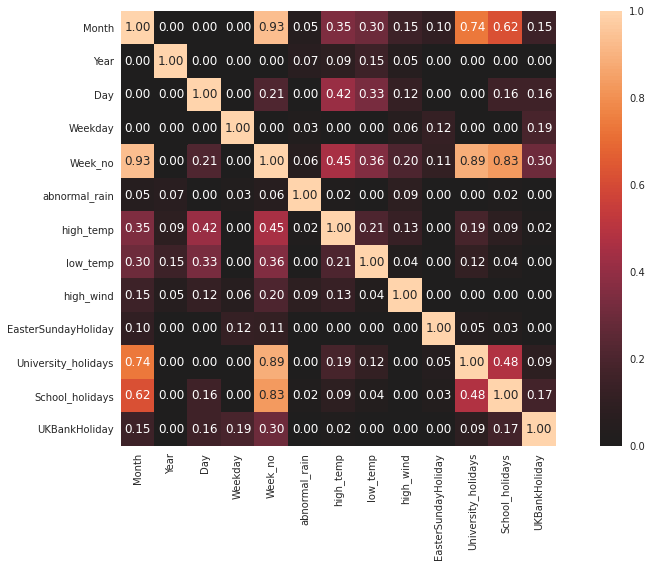

{'ax': <matplotlib.axes._subplots.AxesSubplot at 0x7f6febb5b470>,
 'corr':                         Month      Year  ...  School_holidays  UKBankHoliday
 Month                1.000000  0.000000  ...         0.624025       0.148756
 Year                 0.000000  1.000000  ...         0.000000       0.000000
 Day                  0.000000  0.000000  ...         0.159011       0.159078
 Weekday              0.000000  0.000000  ...         0.000000       0.192558
 Week_no              0.931246  0.000000  ...         0.831083       0.298920
 abnormal_rain        0.051983  0.065359  ...         0.019227       0.000000
 high_temp            0.349905  0.087648  ...         0.089432       0.021590
 low_temp             0.303700  0.149553  ...         0.035817       0.000000
 high_wind            0.154519  0.050504  ...         0.000000       0.000000
 EasterSundayHoliday  0.104473  0.000000  ...         0.032141       0.001377
 University_holidays  0.736057  0.000000  ...         0.479293      

In [ ]:
nominal.associations(data_for_visualization[['Month', 'Year', 'Day', 'Weekday', 'Week_no', 'abnormal_rain', 'high_temp', 'low_temp', 'high_wind', 'EasterSundayHoliday', 'University_holidays', 'School_holidays','UKBankHoliday']], nominal_columns='all')

Observations for Categorical Correlation:
1. School and University Holidays has correlation with Month, Week No and Day
2. School and University Holidays are correlated


### Swarm plot

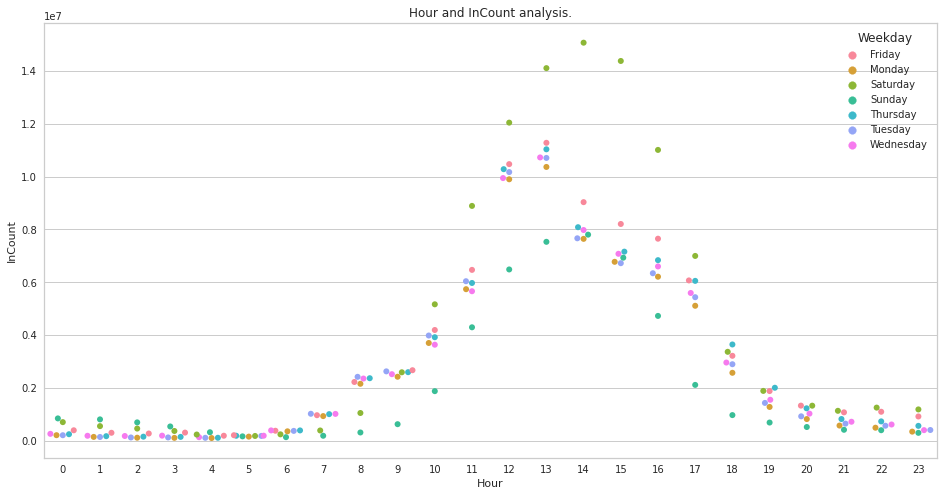

In [ ]:
df_Weekday_Hour = df_foot_fall.groupby(['Weekday', 'Hour'],as_index=False)['InCount'].sum()
graphs.ggplot_swarm(df_Weekday_Hour, 'Hour', 'InCount', 'Weekday')

Observations from Weekday wise Hour and Incount:
1. On Friday and Saturday mall has more people between 11:00 to 16:00 hours
2. On Monday, Tuesday, Wednesday and Thursday mall has more people between 12:00 to 14: hours.
3. Sunday has more people between 12:00 to 16:00 hours.

We can also see that hours 13:00-17:00 are busy hours.

### Cat plot

Weather impact on Incount - Multivariate

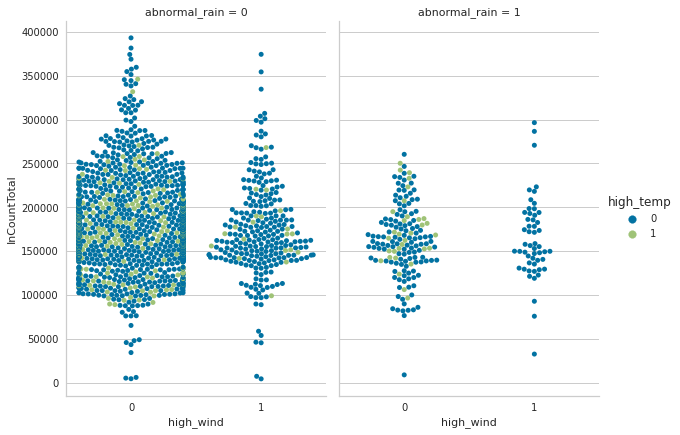

In [ ]:
graphs.ggplot_cat(data_for_visualization, "high_wind", "InCountTotal", "abnormal_rain", "high_temp")

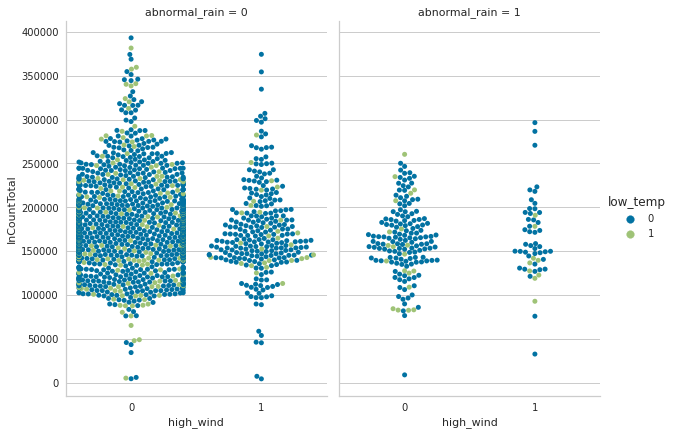

In [ ]:
graphs.ggplot_cat(data_for_visualization, "high_wind", "InCountTotal", "abnormal_rain", "low_temp")

Observations from weather impact:
1. Incount is high during no abnormal rain, no high wind and normal temperature (not high nor low).
2. Incount is less during abnormal rain, high wind, low & high temperature.

Holidays impact on Incount - Multivariate

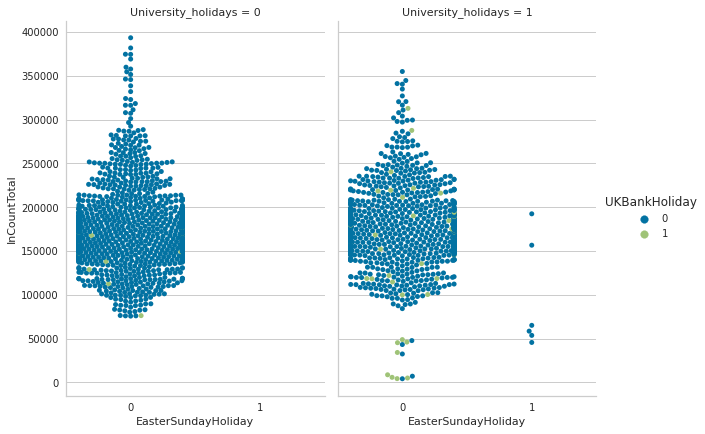

In [ ]:
graphs.ggplot_cat(data_for_visualization, "EasterSundayHoliday", "InCountTotal", "University_holidays", "UKBankHoliday")

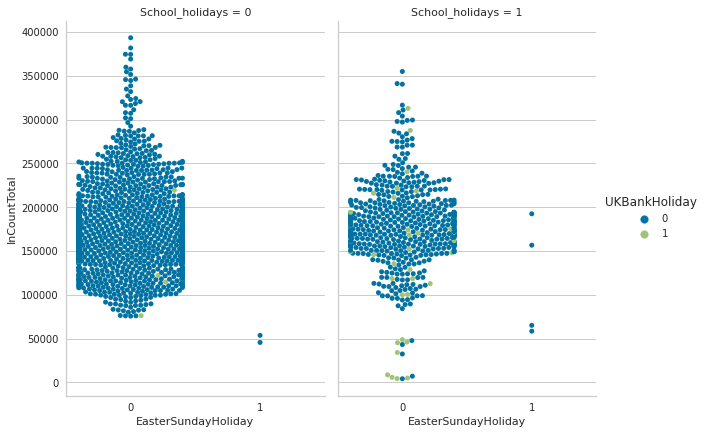

In [ ]:
graphs.ggplot_cat(data_for_visualization, "EasterSundayHoliday", "InCountTotal", "School_holidays", "UKBankHoliday")

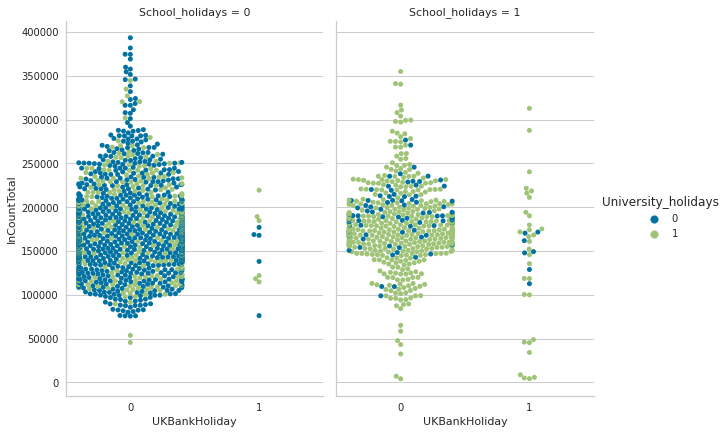

In [ ]:
graphs.ggplot_cat(data_for_visualization, "UKBankHoliday", "InCountTotal", "School_holidays", "University_holidays")

Observations from holidays impact:
1. Incount is high during no easter sunday holiday and no UK bank holiday.
2. Incount is very low when there is easter sunday holiday or UK bank holiday.


### Rel plot

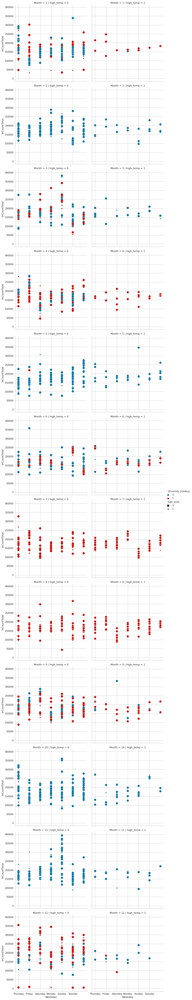

In [ ]:
graphs.relplot_cat(data_for_visualization, "Weekday","InCountTotal", "high_temp", "Month", "high_wind", "University_holidays")

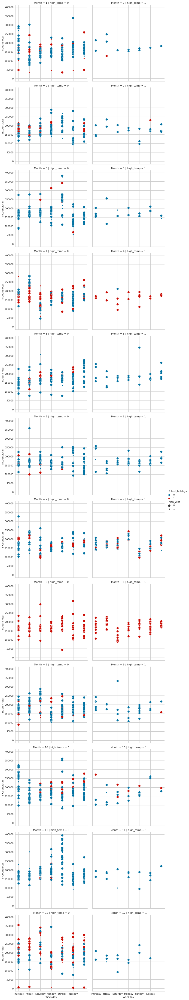

In [ ]:
graphs.relplot_cat(data_for_visualization, "Weekday","InCountTotal", "high_temp", "Month", "high_wind", "School_holidays")

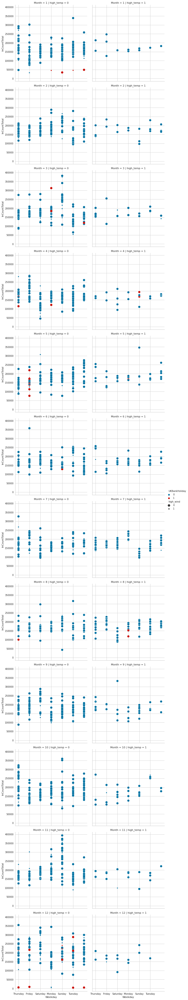

In [ ]:
graphs.relplot_cat(data_for_visualization, "Weekday","InCountTotal", "high_temp", "Month", "high_wind", "UKBankHoliday")

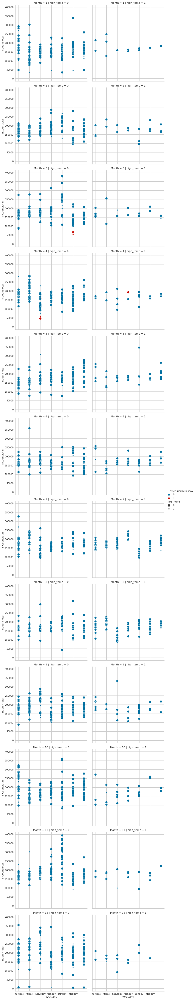

In [ ]:
graphs.relplot_cat(data_for_visualization, "Weekday","InCountTotal", "high_temp", "Month", "high_wind", "EasterSundayHoliday")

Observations  for MultiDimensional Categorical Columns:

University Holidays:
1, For Month 7, Month 8 and Month 9 there are more universisy holidays, where the incount is between 100000 to 250000 when there is high temp or low temp

2, For Month 10 and Month 11 there is more incount even though there is no universisy holidays, it sometimes got incount more than 350000

3, For Month 12 if there are university holidays the incount is more when the temperature is less compared to temperature which is high


School Holidays:
1, For Month 8 there are more school holidays so the incount is around 250000 even if the there is high or low temperature

2, For Month 10 and Month 11 there is more incount even though there is no universisy holidays, it sometimes got incount more than 350000

3, For Month 12 if there are university holidays the incount is more when the temperature is less compared to temperature which is high



UKBankHolidays and EasterSundayHolidays:
1, The incount is not more when there is a UK Bank holiday and EasterSunday Holidays, it seems Bank holidays/EasterSunday Holidays are not impacting much to the incount


In [ ]:
data_final.shape

(2127, 68)

### Bar plot

Plotting the distribution of each Categorical variable

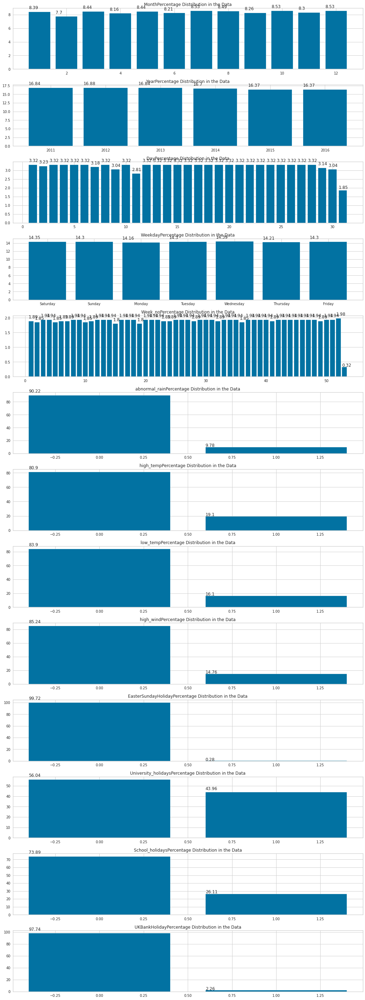

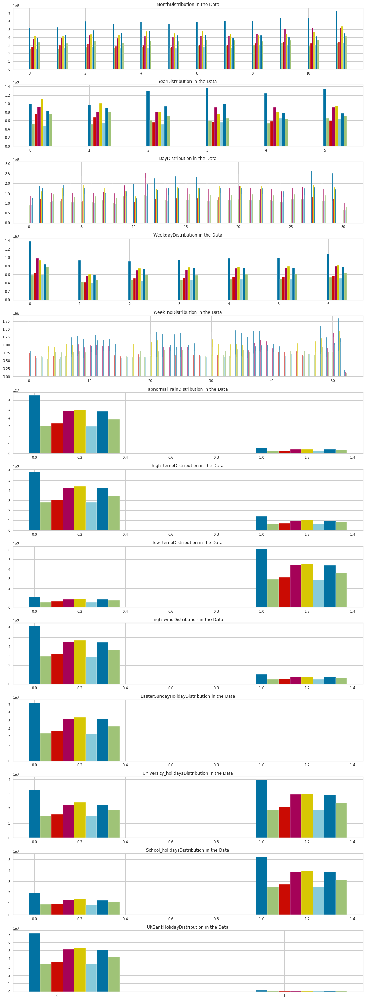

In [ ]:
catcollist=['Month', 'Year', 'Day', 'Weekday', 'Week_no', 'abnormal_rain', 'high_temp', 'low_temp', 'high_wind', 'EasterSundayHoliday', 'University_holidays', 'School_holidays','UKBankHoliday']
featlist=['InCountBriggate', 'InCountBriggateAtMcDs', 'InCountAlbionStNorth','InCountAlbionStSouth', 'InCountCommercialStLush', 'InCountHeadrow','InCountDortmundSq', 'InCountCommercialStBarratts']
graphs.plotcategoricaldist(catcollist,featlist)

Observations from the Categorical variables Percentage Distribution:

Incount on dates 9th and 11th are slightly lower compared to other dates.

9.78 % of days are with Abnormal Rain

19.1% of the Total days are with High Temperature

16.1% of the Total days are with Low Temperature

14.76% of the Total days are with High Wind

43.96% of the Total days are University Holidays

26.11% of the Total days are School Holidays

2.26% of the Total days are Bank Holidays

Biggate has more incount compared to other gates

Saturday has more Incount compared to other days

Incount is low during Abnornal Rains, High Wind, High Temperature, Low Temperature.

Incount is very low on Easter Sundays and UK Bank Holidays

Incount is slightly higher on school and university holidays


## 5.4 Graphs for detrended data

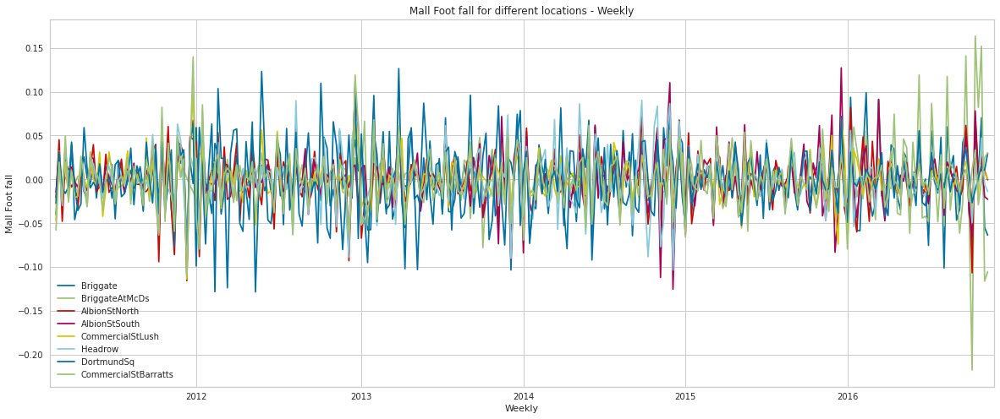

In [ ]:
graphs = Visualization(data_final_detrended,location_name_list)
graphs.show_timedistribution('W')

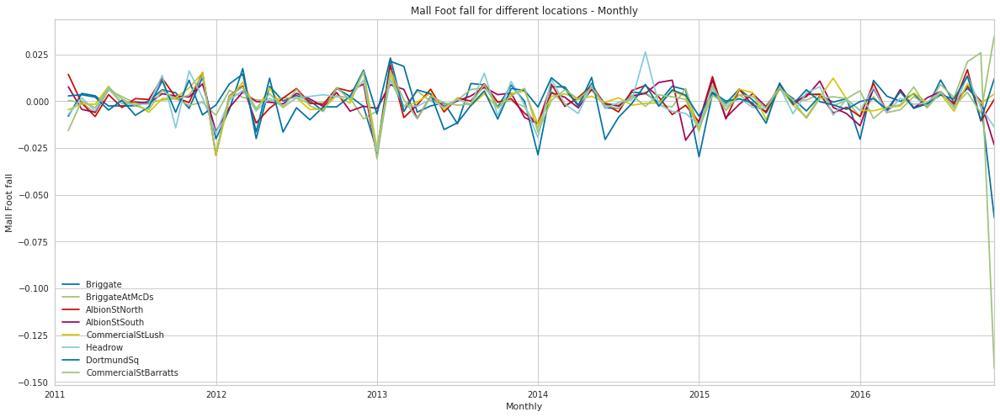

In [ ]:
graphs = Visualization(data_final_detrended,location_name_list)
graphs.show_timedistribution('M')

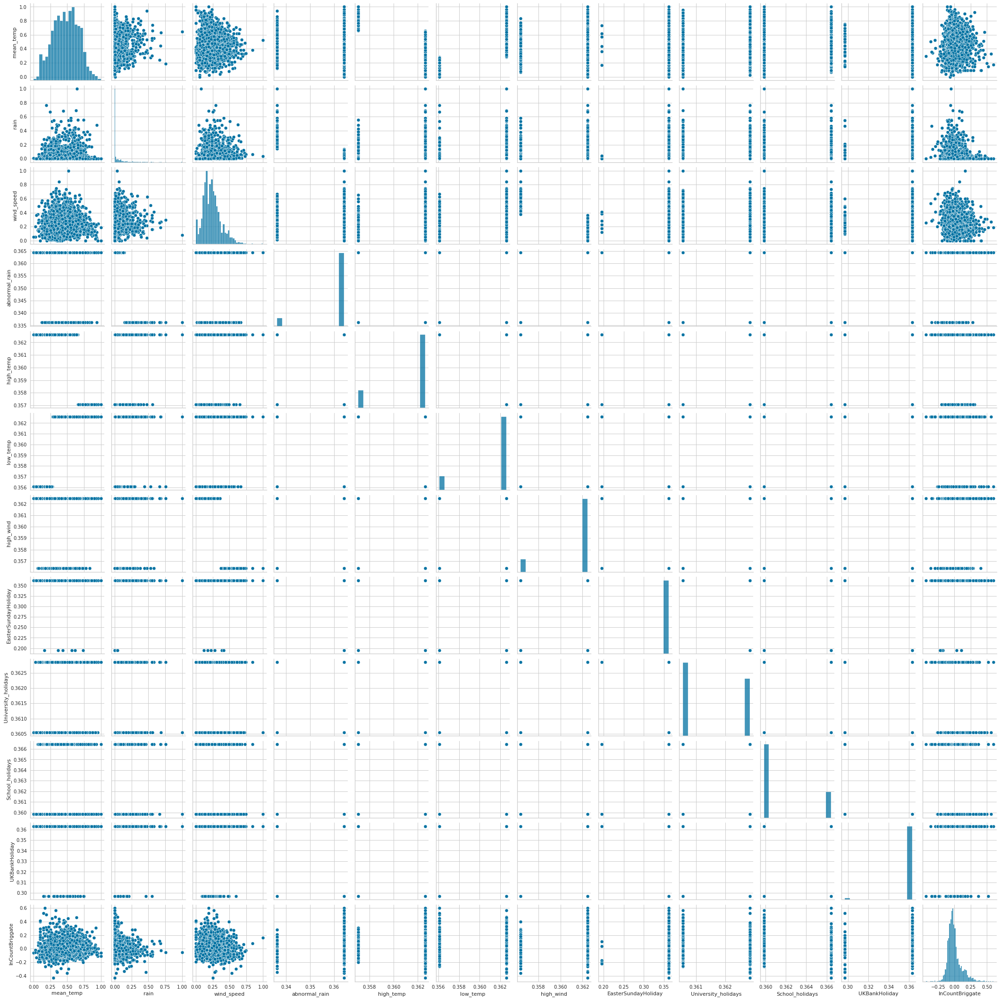

In [ ]:
graphs.show_pairplot()

## 5.5 Summary of top observations

1. Missing data is seen with for 2 days only with one specific gate. This is imupted with KNN Impute
2. Stationarity check on the data : Augmented Dickey-Fuller (ADF) test shows p-value << 0.05, so the series is already stationary
3. Decomposing Data to Trend, Seasonality, noise, residuals ==> a.) There is no visible trend seen in the Incount data, b). there is seasonality visible c.)The residual denisity data for all the gates and IncoutTotal almost follows a normal distribution
4. PCA - 85% variance achievable with 6 principal components and 90% variance preserved with 11 components
5. Outlier detection - a) Only 2 Outliers that too not significant are seen when DBSCAN is applied on the entire data, including the categorical variables
b) LOF is giving far more outliers compared to DBSCAN, but does not seem very relevant on the current problem statement
6. Autocorrelation plot - evey 7th day or multples of 7th seem to have correlation
7. rain : when there is no rain or less rain, incount is higher
8. wind-speed : When the wind-speed is lower, the incount is higher
9. Incount is low during Abnornal Rains, High Wind, High Temperature, Low Temperature.
10. Abnormal rain seems to have more impact on the Incount than the High temperature. Days with only Abnormal rain has slightly low footfall than the days with only High Temperature
11. EasterSundayHoliday : if it's EasterSunday, the InCount is very **low**
12. School Holday/University Holiday - we do not see any major changes in the in-flow
13. UK Bank holiday - Incount is slightly lower on bank holidays   
14. Weekdays : There is a gradual increase in incount from Sunday to Saturday. Saturday having highest incount
15. Month : we can see a seasonal trend in months - peaks in the months of Dec, Nov and March. Lower in the summer months(Jul and August) and also in Jan
16. Hourly analysis: busy hours are 13.00-17.00 a) On Friday and Saturday mall has more people between 11:00 to 16:00 hours , b) On Monday, Tuesday, Wednesday and Thursday mall has more people between 12:00 to 14: hours. c) Sunday has more people between 12:00 to 16:00 hours.
17. School holidays and University Holidays are highly correlated to each other


# 6 - Model preparation

## 6.1 train_test_validation_data_set Class

In [ ]:
class train_test_validation_data_set:
  def __init__(self,data_frame,train_split=global_parameters["train_split"], validation_split=global_parameters["validation_split"], test_split= global_parameters["test_split"]):
        self.data_frame = data_frame.copy() # which data_frame to pre-process
        self.train_split = train_split
        self.validation_split = validation_split
        self.test_split = test_split

  def prepare_pca_datasets(self,n_timesteps=global_parameters["n_timesteps"],n_forecast_steps = global_parameters["n_forecast_steps"], shuffle=False):

    X_columns = self.data_frame.columns.values
    X_columns = X_columns[:-1]
    X_dataset = self.data_frame.iloc[:,:-1]
    y_col = 'InCountTotal'
    y_dataset = self.data_frame[y_col].values

    return X_dataset, y_dataset, X_columns


  def prepare_regression_datasets(self,n_timesteps=global_parameters["n_timesteps"],n_forecast_steps = global_parameters["n_forecast_steps"], input_cols=None,shuffle=False):

    # input variables
    df_temp =  self.data_frame[input_cols]

    # remove the first n_timesteps rows from this dataset.
    df_temp.drop(df_temp.head(n_timesteps).index,inplace=True)
    # remove the last n_timesteps rows from this dataset.
    df_temp.drop(df_temp.tail(n_forecast_steps).index,inplace=True)
    df_temp = df_temp.values

    target_data = self.data_frame['InCountTotal'].values
    target_data = target_data.reshape(-1,1)

    X_dataset =[]
    y_dataset = []

    for i in range(n_timesteps, target_data.shape[0]-n_forecast_steps):
      X_dataset.append(target_data[i-n_timesteps:i,0])
      y_dataset = np.concatenate((y_dataset,target_data[i:i+n_forecast_steps,0].flatten()),axis=0)

    X_columns = list(['InCountTotal_lag'+str(i) for i in range(n_timesteps,0,-1)])
    X_columns = X_columns + list(input_cols)

    X_dataset = pd.DataFrame(X_dataset)
    df_temp = pd.DataFrame(df_temp)

    df = pd.concat([X_dataset,df_temp],axis=1)
    df.columns = X_columns
    df.to_csv("regression_dataset_X.csv")
    X_dataset = df.values
    data_set_len =  X_dataset.shape[0]

    df_y = pd.DataFrame(y_dataset, columns=['InCountTotal'])
    df_y.to_csv("regression_dataset_y.csv")

    if shuffle == True:
      df_data = pd.concat([pd.DataFrame(X_dataset),pd.DataFrame(y_dataset)], axis=1)
      #df_data = df_data.sample(frac=1)
      df_data = df_data.sample(n=len(df_data), random_state=42)
      X_dataset = df_data.iloc[:,:len(X_columns)].values
      y_dataset = df_data.iloc[:,-1:].values

    return X_dataset, y_dataset, X_columns


  def shuffleDataset(self, X_data, y_data, detereminisitic_data,n_timesteps,n_features,n_forecast_steps,len_deterministic_data_col):

    len_X_data_cols = n_timesteps*n_features
    len_y_data_cols = n_forecast_steps

    X_data = X_data.reshape(X_data.shape[0],len_X_data_cols)
    y_data = y_data.reshape(X_data.shape[0],len_y_data_cols)
    detereminisitic_data = detereminisitic_data.reshape(X_data.shape[0],len_deterministic_data_col)

    df_data = pd.concat([pd.DataFrame(X_data),pd.DataFrame(y_data),pd.DataFrame(detereminisitic_data)], axis=1)

    df_data = df_data.sample(n=len(df_data), random_state=42)

    X_data_shuffled = df_data.iloc[:,:len_X_data_cols].values
    y_data_shuffled = df_data.iloc[:,len_X_data_cols:len_X_data_cols+len_y_data_cols].values
    detereminisitic_data_shuffled = df_data.iloc[:,len_X_data_cols+len_y_data_cols:].values

    X_data_shuffled = X_data_shuffled.reshape(X_data.shape[0], n_timesteps, n_features)
    y_data_shuffled = y_data_shuffled.reshape(X_data.shape[0],n_forecast_steps)
    detereminisitic_data_shuffled = detereminisitic_data_shuffled.reshape(X_data.shape[0],n_forecast_steps, len_deterministic_data_col)

    return X_data_shuffled,y_data_shuffled,detereminisitic_data_shuffled

  def createTimeSteps_LSTM(self, n_timesteps=7,n_forecast_steps = 1, input_cols=['InCountTotal'],deterministic_features=None, shuffle=False):


    input_data = self.data_frame[input_cols].values
    n_features = len(input_cols)

    X_datset =[]
    y_dataset = []


    for i in range(n_timesteps, input_data.shape[0]-n_forecast_steps):
      X_datset.append(input_data[i-n_timesteps:i,:])
      y_dataset = np.concatenate((y_dataset,input_data[i:i+n_forecast_steps,-1:].flatten()),axis=0)

    deterministic_datset = []
    if deterministic_features != None:
      deterministic_feature_data = self.data_frame[deterministic_features].values
      for i in range(n_timesteps, deterministic_feature_data.shape[0]-n_forecast_steps):
         deterministic_datset = np.concatenate((deterministic_datset,deterministic_feature_data[i:i+n_forecast_steps,:].flatten()),axis=0)

    '''
    LSTM input shape must be in the following order.
    Samples - One sequence is one sample. A batch is comprised of one or more samples.
    Time Steps - One time step is one point of observation in the sample.
    Features - One feature is one observation at a time step.
    '''
    X_datset = np.array(X_datset)
    lendataset = X_datset.shape[0]


    X_datset = np.reshape(X_datset, (X_datset.shape[0], n_timesteps, len(input_cols)))
    y_dataset = np.reshape(y_dataset,(X_datset.shape[0],n_forecast_steps))
    if deterministic_features != None:
      deterministic_datset = np.reshape(deterministic_datset,(lendataset,n_forecast_steps, len(deterministic_features)))

    return X_datset,y_dataset ,deterministic_datset, n_features

  def prepare_LSTM_datasets(self,n_timesteps=7,n_forecast_steps = 7, input_cols=['InCountTotal'], deterministic_features=None, validation=True, shuffle=False):

    # input variables
    X_dataset, y_dataset,deterministic_datset, n_features = self.createTimeSteps_LSTM(n_timesteps=n_timesteps,n_forecast_steps = n_forecast_steps, input_cols = input_cols,deterministic_features=deterministic_features,shuffle=shuffle)

    data_set_len =  X_dataset.shape[0]

    if validation == True:
      # We do the split of train /validation/test
      X_train, X_validation, X_test = np.split(X_dataset, [int(self.train_split*data_set_len),int((self.train_split+self.validation_split)*data_set_len)])
      y_train, y_validation, y_test = np.split(y_dataset, [int(self.train_split*data_set_len),int((self.train_split+self.validation_split)*data_set_len)])
      deterministic_train, deterministic_validation, deterministic_test = np.split(deterministic_datset, [int(self.train_split*data_set_len),int((self.train_split+self.validation_split)*data_set_len)])

    else:
      # split into train/test. Use the test set as the validation set
      X_train, X_test = np.split(X_dataset, [int((1-self.test_split)*data_set_len)])
      y_train, y_test = np.split(y_dataset, [int((1-self.test_split)*data_set_len)])
      deterministic_train, deterministic_test = np.split(deterministic_datset, [int((1-self.test_split)*data_set_len)])
      X_validation =  X_test
      y_validation =  y_test
      deterministic_validation = deterministic_test


    if(shuffle == True):
      X_train, y_train , deterministic_train = self.shuffleDataset(X_train, y_train, deterministic_train,n_timesteps,n_features,n_forecast_steps,len(deterministic_features))

    return np.array(X_train), np.array(y_train), np.array(X_validation), np.array(y_validation), np.array(X_test), np.array(y_test) ,deterministic_train, deterministic_validation, deterministic_test, n_features

## 6.2 model_utility class


In [ ]:
class model_utility:
  def __init__(self):
        dummy = []
  def calculate_metrics(self, actual, forecast,n_sample_size=100,n_input_variables=1, model_name=None):

    eps = 1e-10
    mape = np.mean(np.abs(forecast - actual)/np.abs(actual+eps))*100  # MAPE
    me = np.mean(forecast - actual)             # ME
    mae = np.mean(np.abs(forecast - actual))    # MAE
    mpe = np.mean((forecast - actual)/(actual+eps))   # MPE
    rmse = np.mean((forecast - actual)**2)**.5  # RMSE
    mse = np.mean((forecast - actual)**2)       # MSE

    n = n_sample_size
    p = n_input_variables
    AIC = n * log(mse) + 2 * p                  # AIC
    BIC = n * log(mse) + p * log(n)             # BIC

    r2 = r2_score(actual,forecast)              # R2 score

    adjR2_score = 1- (1-r2)*(n-1)/(n-p-1)       # Adj r2 score = 1-(1-R2)*(n-1)/(n-p-1)

    return({'mape':mape, 'mse': mse,'me':me, 'mae': mae,
          'mpe': mpe, 'rmse':rmse, 'R2 score':r2,'Adj R2 score':adjR2_score,'AIC':AIC,'BIC': BIC})

  def convert_dict_dataframe(self, loss_values):

    # appending columsn
    columns = []
    columns.append('Model_type')
    first_dict_item = list(loss_values.values())[0]
    for loss_type, _ in first_dict_item.items():
        columns.append(loss_type)

    # rows list initialization
    rows = []
    # appending rows
    for name,values in loss_values.items():
      data_row = []
      data_row.append(name)
      for _, loss_value in values.items():
        data_row.append(loss_value)
      rows.append(data_row)

    # using data frame
    df = pd.DataFrame(rows, columns=columns)
    return df

  def CheckPointModelExisting(self, model_name):
    for filepath_object in glob.glob('saved_model_'+model_name+'16*.hdf5'):
        if os.path.isfile(filepath_object):
            return True, filepath_object
    return False, None

  def plotly_graphs(self,modelPredictions, model_type='Normal Regression'):

    data = [go.Scatter(y= modelPredictions.iloc[:,index],name = modelPredictions.columns[index]) for index in range(modelPredictions.shape[1])]
    layout = go.Layout(
        title='Mall foot fall predicton with '+ model_type,
        xaxis=dict(
            title='Date'))
    fig = go.Figure(data=data, layout=layout)
    iplot(fig)


## 6.2 regression_model Class

In [ ]:
class regression_model:

  def __init__(self,dataset, dataset_type='normal'):
      self.dataset = dataset.copy()
      self.dataset_type = dataset_type # normal or detrend
      self.trend = []
      self.seasonal = []
      self.grid_params = {}
      self.grid_params.update({"linear_regression": {"fit_intercept": [True,False], "normalize": [True, False]}})
      self.grid_params.update({"lassoRegressor": { "alpha": [1.0, 0.1,0.001,0.0001,0.00001], "fit_intercept": [True,False], "normalize": [True, False],
                                            "precompute":[True,False], "max_iter": [10,100,1000], "warm_start":[True,False], "positive":[True,False],
                                            "selection": ['cyclic', 'random']
                                            }
                         })
      self.grid_params.update({"ridgeRegressor": { "alpha": [1.0, 0.1,0.001,0.0001,0.00001], "fit_intercept": [True,False], "normalize": [True, False],
                                             "max_iter": [10,100,1000], "solver": ['auto', 'svd', 'cholesky', 'lsqr', 'sparse_cg', 'sag', 'saga']
                                            }
                         })
      self.grid_params.update({"elastic_net": { "alpha": [1.0, 0.1,0.001,0.0001,0.00001], "fit_intercept": [True,False], "normalize": [True, False],
                                            "precompute":[True,False], "max_iter": [10,100,1000], "warm_start":[True,False], "positive":[True,False],
                                            "selection": ['cyclic', 'random']
                                            }
                         })
      self.grid_params.update({"huberRegressor": { "epsilon": [1,1.1,1.2,1.35,2], "alpha": [1.0, 0.1,0.001,0.0001,0.00001], "fit_intercept": [True,False],
                                             "max_iter": [10,100,1000], "warm_start":[True,False], "tol": [1e-04,1e-05,1e-06]
                                            }
                         })
      self.grid_params.update({"lasso_lars": { "alpha": [1.0, 0.1, 0.001,0.0001,0.00001], "fit_intercept": [True,False],
                                              "max_iter": [10,100,1000], "precompute":[True,False], "fit_path": [True,False], "positive":[True,False]
                                            }
                         })
      self.grid_params.update({"passive_aggressor": { "C": [1.0, 0.1, 0.001,0.0001,0.00001], "fit_intercept": [True,False],
                                              "max_iter": [10,100,1000], "tol": [1e-03,1e-04,1e-05], "early_stopping":[True,False], "shuffle": [True,False], "warm_start":[True,False], "average":[True,False]
                                            }
                         })
      self.grid_params.update({"sgd": { "penalty": ['l2', 'l1', 'elasticnet'], "alpha": [1.0, 0.1, 0.001,0.0001,0.00001], "l1_ratio": [0.15, 0.2, 0.25], "fit_intercept": [True,False],
                                              "max_iter": [10,100,1000], "tol": [1e-03,1e-04,1e-05], "shuffle": [True,False], "learning_rate": ['invscaling','constant','optimal','adaptive'],
                                        "eta0": [0.01, 0.001],"early_stopping":[True,False], "warm_start":[True,False], "average":[True,False]
                                            }
                         })
      self.grid_params.update({"knn_regressor": { "n_neighbors": [4,5,6,7], "weights": ['uniform', 'distance'], "algorithm": ['auto', 'ball_tree','kd_tree','brute',],
                                                 "leaf_size": [20,30,40], "p": [1,2], "metric": ['chebyshev','minkowski']
                                            }
                         })
      self.grid_params.update({"decisiontree_regressor": { "criterion": ['mse','friedman_mse','mae'], "splitter": ['best','random'],
                                                          "max_depth": [2,3,4,5,6],
                                       "min_samples_split": [0.005, 0.01, 0.05, 0.10],
                                       "min_samples_leaf": [0.005, 0.01, 0.05, 0.10],"max_features": ['auto','sqrt','log2']
                                                         }
                               })
      self.grid_params.update({"extra_tree_regressor": { "criterion": ['mse', 'friedman_mse', 'mae'],  "max_depth": [2,3,4,5,6],
                                               "max_features": ['auto','sqrt','log2']
                                            }
                         })

      self.grid_params.update({"svm_regressor": { "kernel": ['linear', 'poly', 'rbf','sigmoid'], "gamma": ['scale','auto'], "tol": [1e-03,1e-04,1e-05],
                                                "C": [1.0, 0.1, 0.001,0.0001],"shrinking":[True,False]

                                            }
                         })
      self.grid_params.update({"adaBoost": { "base_estimator": [DecisionTreeRegressor(max_depth = x) for x in range(1,6)], "learning_rate": [0.001, 0.01, 0.05, 0.1, 0.25, 0.50, 0.75, 1.0],
                                                "n_estimators": [100,200,300]
                                            }
                         })
      self.grid_params.update({"bagging": { "base_estimator": [DecisionTreeRegressor(max_depth = x) for x in range(1,6)], "n_estimators": [100,200,300],
                                                "max_features": [0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

                                            }
                         })
      self.grid_params.update({"random_forest": { "n_estimators": [100,200,300], "max_features": ["auto", "sqrt", "log2"],
                                                 "max_depth" : [3, 4, 5, 6, 7, 8],
                                                 "min_samples_split": [0.005, 0.01, 0.05, 0.10],
                                                 "min_samples_leaf": [0.005, 0.01, 0.05, 0.10]

                                            }
                         })

      self.grid_params.update({"extra_trees_regressor": { "n_estimators": [100,200,300], "criterion": ['mse', 'friedman_mse', 'mae'], "min_samples_split": [2, 3],
                                                          "max_features": ['auto','sqrt','log2']
                                            }
                         })

      self.grid_params.update({"gradient_boosting_regressor": {"learning_rate":[0.15,0.1,0.05,0.01,0.005,0.001],
                                                               "n_estimators": [100,200,300],
                                       "max_depth": [2,3,4,5,6],
                                       "min_samples_split": [0.005, 0.01, 0.05, 0.10],
                                       "min_samples_leaf": [0.005, 0.01, 0.05, 0.10],
                                       "max_features": ["auto", "sqrt", "log2"]
                                       }
                         })
      self.grid_params.update({"XGBoost": {"max_depth":range(3,10,2), "min_child_weight":range(1,6,2),
                                       "gamma":[i/10.0 for i in range(0,5)],"n_estimators": [100,200,300],
                                       "subsample":[i/10.0 for i in range(6,10)],
                                       "colsample_bytree":[i/10.0 for i in range(6,10)],
                                       "reg_alpha": [1e-5, 1e-2, 0.1, 1, 100],
                                       "learning_rate": [0.001, 0.01, 0.1, 0.2, 0.3]
                                       }
                               })

      self.grid_params.update({"LightGradientBoosting": {"max_depth":range(3,10,2), "min_child_weight":range(1,6,2),
                                       "gamma":[i/10.0 for i in range(0,5)],"n_estimators": [100,200,300],
                                       "subsample":[i/10.0 for i in range(6,10)],
                                       "colsample_bytree":[i/10.0 for i in range(6,10)],
                                       "reg_alpha": [1e-5, 1e-2, 0.1, 1, 100],
                                       "learning_rate": [0.001, 0.01, 0.1, 0.2, 0.3]
                                       }
                               })
      self.grid_params.update({"CategoricalGradientBoosting": {"max_depth":range(3,10,2),
                                       "n_estimators": [100,200,300],
                                       "subsample":[i/10.0 for i in range(6,10)],
                                        "learning_rate": [0.001, 0.01, 0.1, 0.2, 0.3]
                                       }
                               })
      self.grid_params.update({"NeuralNet_MLP": {"hidden_layer_sizes":[(100, ), (100,200 )],
                                       "activation": ['tanh','relu','logistic'],
                                       "solver":['sgd','adam','lbfgs'],
                                        "alpha": [0.001, 0.0001],
                                        "batch_size" : [16,32],
                                        "learning_rate":['constant','invscaling','adaptive'],
                                        "max_iter":[100,200]
                                       }
                               })


  def prepare_datasets(self,shuffle=False, extra_input_features=False,pcaFeatures=False,weekly_data = False):

    # create dictonary to store different datasets
    # keys : LSTM, Regression, LSTM_detrend, Regression_detrend
    dataset_dict = {}

    if pcaFeatures == False:
      if extra_input_features == True:
        input_cols = global_parameters['input_cols_reg_with_extra_features']
      else:
        input_cols = global_parameters['input_cols_regression']

      if weekly_data == True:
        input_cols = global_parameters['input_cols_regression_weekly']
        n_timesteps=4 # 4 weeks lag
        n_forecast_steps = 1 # 1 week forecast

        # prepare normal regression dataset for train dataset
        model_dataset = train_test_validation_data_set(self.dataset[:-global_parameters['test_data_set_weeks']])
        X_train, y_train, X_columns = model_dataset.prepare_regression_datasets(n_timesteps=n_timesteps,n_forecast_steps=n_forecast_steps,input_cols = input_cols, shuffle=shuffle)

        # prepare normal regression dataset for test dataset
        model_dataset = train_test_validation_data_set(self.dataset[-global_parameters['test_data_set_weeks']:])
        X_test, y_test, _ = model_dataset.prepare_regression_datasets(n_timesteps=n_timesteps,n_forecast_steps=n_forecast_steps,input_cols = input_cols)
      else:
        # prepare normal regression dataset for train dataset
        model_dataset = train_test_validation_data_set(self.dataset[-global_parameters['data_set_days']:-global_parameters['test_data_set_days']])
        X_train, y_train, X_columns = model_dataset.prepare_regression_datasets(input_cols = input_cols, shuffle=shuffle)

        # prepare normal regression dataset for test dataset
        model_dataset = train_test_validation_data_set(self.dataset[-global_parameters['test_data_set_days']:])
        X_test, y_test, _ = model_dataset.prepare_regression_datasets(input_cols = input_cols)

    else:
      # prepare PCA dataset for train dataset
      model_dataset = train_test_validation_data_set(self.dataset[-global_parameters['data_set_days']:-global_parameters['test_data_set_days']])
      X_train, y_train, X_columns = model_dataset.prepare_pca_datasets(shuffle=shuffle)

      # prepare PCA dataset for test dataset
      model_dataset = train_test_validation_data_set(self.dataset[-global_parameters['test_data_set_days']:])
      X_test, y_test, _ = model_dataset.prepare_pca_datasets()


    if self.dataset_type == 'detrend':
      self.trend = self.dataset['trend'][-len(y_test):].values
      self.seasonal = self.dataset['seas'][-len(y_test):].values

    dataset_dict['regression_'+self.dataset_type] = {"X_train" : X_train, "y_train": y_train, "X_test": X_test, "y_test":y_test, "X_columns": X_columns}

    return dataset_dict

  # prepare a list of ml models
  def get_models(self, models=dict()):
    # linear models
    models['linear_regression'] = LinearRegression()
    models['lassoRegressor'] = Lasso()
    models['ridgeRegressor'] = Ridge()
    models['elastic_net'] = ElasticNet()
    models['huberRegressor'] = HuberRegressor()
    models['passive_aggressor'] = PassiveAggressiveRegressor(max_iter=1000, tol=1e-3)
    models['sgd'] = SGDRegressor(max_iter=1000, tol=1e-3)
    # non-linear models
    models['knn_regressor'] = KNeighborsRegressor(n_neighbors=7)
    models['decisiontree_regressor'] = DecisionTreeRegressor()
    models['extra_tree_regressor'] = ExtraTreeRegressor()
    models['svm_regressor'] = SVR()
    # # ensemble models
    n_trees = 200
    models['adaBoost'] = AdaBoostRegressor(n_estimators=n_trees)
    models['bagging'] = BaggingRegressor(n_estimators=n_trees)
    models['random_forest'] = RandomForestRegressor(n_estimators=n_trees)
    models['extra_trees_regressor'] = ExtraTreesRegressor(n_estimators=n_trees)
    models['gradient_boosting_regressor'] = GradientBoostingRegressor(n_estimators=n_trees)
    models['XGBoost'] = XGBRegressor(objective='reg:squarederror')
    models['LightGradientBoosting'] = LGBMRegressor()
    models['CategoricalGradientBoosting'] = CatBoostRegressor(n_estimators=n_trees,verbose=0)
    # neural network models
    models['NeuralNet_MLP'] = MLPRegressor()

    print('Defined %d models' % len(models))
    return models

  def randomizedSearch(self, paramGrid, model, X_train, y_train, X_test, y_test, name):
    # train and predict each model with randomized search CV
    kFold = KFold(shuffle=True, random_state=50)
    rscv = RandomizedSearchCV(model, param_distributions=paramGrid, n_jobs=-1, scoring='neg_mean_squared_error', cv=kFold,
                        n_iter=10, verbose=0, random_state=42)
    # Fit rscv
    print(f"Now tuning {model}.")
    rscv.fit(X_train, y_train)

    prediction = rscv.best_estimator_.predict(X_test)
    test_loss = mean_squared_error(y_test, prediction)
    return rscv.best_estimator_, rscv.best_params_, prediction, test_loss

  def mape(self,actual,forecast):
    return np.mean(np.abs(forecast - actual)/np.abs(actual))*100  # MAPE

  def me(self,actual,forecast):
    return np.mean(forecast - actual)             # ME

  def mae(self,actual,forecast):
    return np.mean(np.abs(forecast - actual))    # MAE
  def mpe(self,actual,forecast):
    return np.mean((forecast - actual)/actual)*100   # MPE
  def rmse(self,actual,forecast):
    return np.mean((forecast - actual)**2)**.5  # RMSE
  def mse(self,actual,forecast):
    return np.mean((forecast - actual)**2)       # MSE

  def crossCV(self,model, X_test, y_test):
    # predict with cross_val_predict with CV
    scoring = {'mape': make_scorer(self.mape),
               'mse': make_scorer(self.mse),'me':make_scorer(self.me), 'mae': make_scorer(self.mae),
          'mpe': make_scorer(self.mpe), 'rmse':make_scorer(self.rmse), 'R2 score':'r2'
               }

    kFold = KFold(shuffle=True, random_state=50)

    cvPredictions = cross_val_predict(model, X_test, y_test, cv=kFold)
    score =  cross_validate(model, X_test, y_test, cv=kFold, scoring=scoring)

    loss_values  = {'mape':np.mean(score['test_mape']), 'mse': np.mean(score['test_mse']),'me':np.mean(score['test_me']), 'mae': np.mean(score['test_mae']),
          'mpe': np.mean(score['test_mpe']), 'rmse':np.mean(score['test_rmse']), 'R2 score':np.mean(score['test_R2 score']),'Adj R2 score':np.nan,'AIC':np.nan,'BIC': np.nan}
    return cvPredictions, loss_values

  def rfeCV(self, model,X_train,y_train,X_test,y_test,X_columns, n_params,name):

    rfeCV = RFECV(estimator=model, step=1,cv= KFold(), scoring= 'r2')
    rfeCV.fit(X_train,y_train)
    prediction_rfecv = rfeCV.predict(X_test)
    if(self.dataset_type == 'detrend'):# inverse the detrend by adding trend and seasonal info
        # inverse detrend for the predictons
        prediction_rfecv = self.inverse_detrend(prediction_rfecv,self.trend,self.seasonal)

    loss_values = model_utility().calculate_metrics(y_test,prediction_rfecv,len(y_test),n_params,name)
    print("RFECV - optimal number of features ", rfeCV.n_features_)
    optimal_features = []
    for i in range(len(X_columns)):
      if rfeCV.ranking_[i]==1:
        optimal_features.append(X_columns[i])
    print("RFE CV - optimal features ", optimal_features )
    plt.figure(figsize=(16, 8))
    plt.title('Recursive Feature Elimination with CV - '+ name, fontsize=18, fontweight='bold', pad=20)
    plt.xlabel('Number of features selected', fontsize=14, labelpad=20)
    plt.ylabel('R2 score', fontsize=14, labelpad=20)
    plt.plot(range(1, len(rfeCV.grid_scores_) + 1), rfeCV.grid_scores_, color='#303F9F', linewidth=3)
    plt.show()
    return prediction_rfecv,loss_values

  # fit a single model
  def fit_model(self, model, X, y):
    # clone the model configuration
    local_model = clone(model)
    # fit the model
    local_model.fit(X, y)
    return local_model


  def visualizeFeatureImportance(self,model_fit,X_train,y_train,X_columns,name):
    if name not in ['knn_regressor','svm_regressor','bagging','LightGradientBoosting','CategoricalGradientBoosting','NeuralNet_MLP']:
      fig = plt.figure(figsize=(16,8))
      visualizer = FeatureImportances(model_fit,ax=plt.axes(),is_fitted=True, labels=X_columns)
      visualizer.fit(X_train, y_train)
      visualizer.show()

  def predictionErrorPlot(self,model,X_train,y_train,X_test,y_test):
    fig = plt.figure(figsize=(16,8))
    visualizer = PredictionError(model, ax=plt.axes(), is_fitted=True)

    visualizer.fit(X_train, np.ravel(y_train))
    y_test = np.ravel(y_test)
    visualizer.score(X_test, y_test)
    visualizer.show()

  # evaluate a suite of models
  def train_and_evaluate_models(self, RFEcross_validation = True, shuffle=False,extra_input_features=False,pcaFeatures=False, weekly_data=False ):
    models = self.get_models()
    trained_models = {}
    dataset_dict = self.prepare_datasets(shuffle,extra_input_features,pcaFeatures,weekly_data)

    X_train = dataset_dict['regression_'+self.dataset_type]['X_train']
    y_train = dataset_dict['regression_'+self.dataset_type]['y_train']
    X_test = dataset_dict['regression_'+self.dataset_type]['X_test']
    y_test = dataset_dict['regression_'+self.dataset_type]['y_test']
    X_columns = dataset_dict['regression_'+self.dataset_type]['X_columns']

    # initialize the prediction data frames
    modelPredictions = np.zeros((X_test.shape[0], len(models)))
    modelPredictions = pd.DataFrame(modelPredictions)

    cvPredictions = np.zeros((X_test.shape[0], len(models)))
    cvPredictions = pd.DataFrame(cvPredictions)

    rscvPredictions = np.zeros((X_test.shape[0], len(models)))
    rscvPredictions = pd.DataFrame(rscvPredictions)

    rfecvPredictions = np.zeros((X_test.shape[0], len(models))) # not applicable for 'knn', 'svm', 'naive bayes', 'mlp-nn', 'qda', 'bagging'
    rfecvPredictions = pd.DataFrame(rfecvPredictions)

    n_forecast_steps = global_parameters['n_forecast_steps']
    loss_values = {}

    n_params = X_train.shape[1] + 1
    for i, (name, model) in enumerate(models.items()):

      # 1. fit default  models
      model_fit = self.fit_model(model, X_train, y_train)
      # make predictions
      predictions = model_fit.predict(X_test)
      print("=================================================================")
      print(name)
      print("default model fitting...")
      if(self.dataset_type == 'detrend'):# inverse the detrend by adding trend and seasonal info
        # inverse detrend for the predictons
        predictions = self.inverse_detrend(predictions,self.trend,self.seasonal)
        y_test_real = self.inverse_detrend(y_test,self.trend,self.seasonal)
      else:
          y_test_real = y_test

      loss_values[name+'_'+self.dataset_type+'_default_model'] = model_utility().calculate_metrics(y_test_real,predictions,len(y_test_real),n_params,name )

      #inverse transform
      predictions = np.reshape(predictions, (predictions.shape[0], n_forecast_steps))
      predictions = scaler_target.inverse_transform(predictions)

      modelPredictions.iloc[:, i] = predictions
      modelPredictions = modelPredictions.rename(columns={i: name})

      trained_models[name+self.dataset_type+'standard'] = model_fit

      # 2. fit randomized CV models
      model_fit_rscv, best_params, predicton_rscv, loss_rscv = self.randomizedSearch(self.grid_params[name],model,X_train, y_train,X_test, y_test,name)
      # visualize the feature importance for the model
      self.visualizeFeatureImportance(model_fit_rscv,X_train,y_train,X_columns,name)
      #self.predictionErrorPlot(model_fit_rscv,X_train,y_train,X_test,y_test)

      if(self.dataset_type == 'detrend'):# inverse the detrend by adding trend and seasonal info
        # inverse detrend for the predictons
        predicton_rscv = self.inverse_detrend(predicton_rscv,self.trend,self.seasonal)
        y_test_real = self.inverse_detrend(y_test,self.trend,self.seasonal)

      else:
          y_test_real = y_test

      loss_values[name+'_'+self.dataset_type+'_rscv_model'] = model_utility().calculate_metrics(y_test_real,predicton_rscv,len(y_test_real),n_params,name)


      #inverse transform
      predicton_rscv = np.reshape(predicton_rscv, (predicton_rscv.shape[0], n_forecast_steps))
      predicton_rscv = scaler_target.inverse_transform(predicton_rscv)

      trained_models[name+self.dataset_type+'rscv'] = model_fit_rscv
      rscvPredictions.iloc[:, i] = predicton_rscv
      rscvPredictions = rscvPredictions.rename(columns={i: name})

      # 3. cross CV models # TODO
      print("Cross CV validation...")
      predicton_crossCV, loss_cross_CV_values = self.crossCV(model_fit_rscv,X_test,y_test_real)

      cvPredictions.iloc[:, i] = predicton_crossCV
      cvPredictions = cvPredictions.rename(columns={i: name})

      loss_values[name+'_'+self.dataset_type+'_crosscv_model'] = loss_cross_CV_values

      if RFEcross_validation == True:
        # 4. RFE CV # TODO
        if name not in ['knn_regressor','svm_regressor','bagging','LightGradientBoosting','CategoricalGradientBoosting','NeuralNet_MLP']:
          print("RFE CV tuning...")
          prediction_rfecv, loss_values_rfeCV =  self.rfeCV(model_fit_rscv,X_train,y_train,X_test,y_test_real,X_columns, n_params,name)

          loss_values[name+'_'+self.dataset_type+'_rfecv_model'] = loss_values_rfeCV

          rfecvPredictions.iloc[:, i] = prediction_rfecv
          rfecvPredictions = rfecvPredictions.rename(columns={i: name})



    y_test_real = np.reshape(y_test_real, (y_test_real.shape[0], n_forecast_steps))
    y_test_real = scaler_target.inverse_transform(y_test_real)

    self.plot_predictions_models(modelPredictions,y_test_real)
    self.plot_predictions_models(rscvPredictions,y_test_real,model_type='Randomized Search CV')

    loss_values =  model_utility().convert_dict_dataframe(loss_values)
    return trained_models, modelPredictions,cvPredictions, rscvPredictions, rfecvPredictions, loss_values

  def plot(self, data,model_type):
    fig = plt.figure(figsize=(24,8))
    data.plot()
    plt.xlabel('Time')
    plt.ylabel('Daily Mall Footfall')
    plt.title('Mall foot fall predicton with ' + model_type)
    plt.legend()
    plt.show()

  def plot_predictions_models(self,modelPredictions, y_test, model_type='Normal Regression'):
    y_test = pd.DataFrame(y_test, columns=['Actual'])
    plot_data_set_1 = pd.concat([modelPredictions.iloc[:,0:4],y_test], axis=1)
    plot_data_set_2 = pd.concat([modelPredictions.iloc[:,4:8],y_test], axis=1)
    plot_data_set_3 = pd.concat([modelPredictions.iloc[:,8:12],y_test], axis=1)
    plot_data_set_4 = pd.concat([modelPredictions.iloc[:,12:],y_test], axis=1)

    model_utility().plotly_graphs(plot_data_set_1,model_type)
    model_utility().plotly_graphs(plot_data_set_2,model_type)
    model_utility().plotly_graphs(plot_data_set_3,model_type)
    model_utility().plotly_graphs(plot_data_set_4,model_type)

  def inverse_detrend(self,predicts,trend,seasonal):
    predicts = predicts + trend + seasonal
    return predicts



  def plot_predictions(self,models, X_test, y_test, trend=None,seasonal=None,model_type=None):

    if(model_type== 'detrend'):# inverse the detrend by adding trend and seasonal info
        trend = np.reshape(trend.values, (X_test.shape[0], 1))
        seasonal = np.reshape(seasonal.values, (X_test.shape[0], 1))
    n_forecast_steps = global_parameters['n_forecast_steps']
    y_test = np.reshape(y_test, (y_test.shape[0], n_forecast_steps))
    for name, model in models.items():
      # make predictions
      predicts = model.predict(X_test)
      predicts = np.reshape(predicts, (predicts.shape[0], n_forecast_steps))
      loss = mean_squared_error(y_test, predicts)
      print('loss ', name, loss )

      if(model_type== 'detrend'):# inverse the detrend by adding trend and seasonal info
        predicts = self.inverse_detrend(predicts,trend,seasonal)
        y_test_real = self.inverse_detrend(y_test,trend,seasonal)
        print(y_test.shape)
      else:
          y_test_real = y_test

      predicts = scaler_target.inverse_transform(predicts)

      y_test_real = scaler_target.inverse_transform(y_test_real)

      fig = plt.figure(figsize=(24,8))
      plt.plot(y_test_real, color = 'red', label = 'Real mall footfal')
      plt.plot(predicts, color = 'blue', label = 'Predicted mall footfall')
      plt.title('Model validation with '+ name)
      plt.xlabel('Time')
      plt.ylabel('Daily Mall Footfall')
      plt.legend()
      plt.show()


## 6.3 LSTM model classes

LSTM Encoder Decoder model

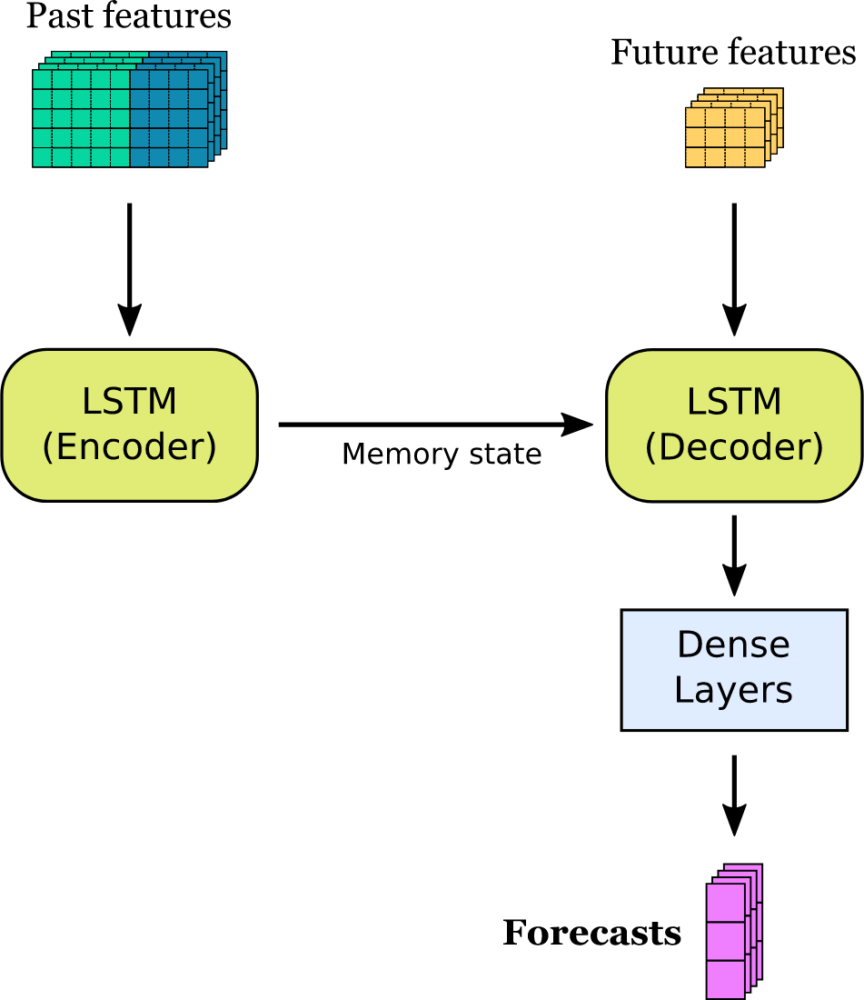

LSTM AutoEncoder model

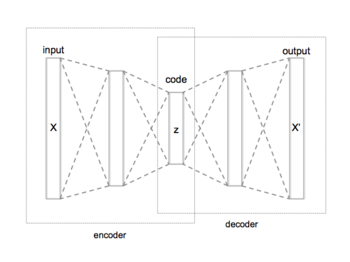

### 6.3.1 LSTM_base_model class

In [ ]:
# custome defined call back function to reduce the logging
class LSTMLogger(Callback):
  def __init__(self, display=100):
    '''
        display: Number of batches to wait before outputting loss
        '''
    self.display = display

  def on_epoch_end(self, epoch, logs=None):
    if epoch % self.display == 0:
        # you can access loss, accuracy from logs
        print('Epoch: %02d - loss: %.6f - - val_loss:  %.6f' % (epoch+1, logs['loss'], logs['val_loss']))

class MyModel(Model):

  def __init__(self,n_features=16):
    super(MyModel, self).__init__()
    self.lstm1 = LSTM(units = 32,  return_sequences = True)
    self.dropout1 = Dropout(0.2)
    self.lstm2 = LSTM(units =16, return_sequences = False)
    self.dense1 = Dense(16, activation='relu')
    self.dense2 = Dense(16, activation='relu')
    self.output1 = Dense(1,activation='relu')

  def call(self, inputs):
    x = self.lstm1(inputs)
    x = self.dropout1(x)
    x = self.lstm2(x)
    x = self.dropout1(x)
    x = self.dense1(x)
    x = self.dense2(x)
    x = self.output1(x)
    print(x.shape)
    print(inputs.shape)

    return inputs+x

class ResidualWrapper(Model):
  def __init__(self, model):
    super().__init__()
    self.model = model

  def call(self, inputs, *args, **kwargs):
    delta = self.model(inputs, *args, **kwargs)

    # The prediction for each timestep is the input
    # from the previous time step plus the delta
    # calculated by the model.
    return inputs + delta

In [ ]:
class LSTM_base_model:
  def __init__(self, n_forecast=1 ):
    self.n_forecast = n_forecast

  def LSTM_simple_model_detrended_data(self,layer_parameters=dict(), time_steps = 7,n_forecast = 7, n_features=1 , model_name=None):

    model_input = Input(shape=(time_steps, n_features))

    x = LSTM(units = layer_parameters["LSTM_layer1"],  return_sequences = True)(model_input)
    x = Dropout(0.2)(x)
    x = LSTM(units =layer_parameters["LSTM_layer2"], return_sequences = False)(x)
    x = Dropout(0.2)(x)

    x = Dense(units = n_forecast)(x)
    model = Model(model_input, x, name=model_name)
    return model

  def LSTM_simple_model(self,layer_parameters=dict(), time_steps = 7,n_forecast = 7, n_features=1,model_name=None ):

    model_input = Input(shape=(time_steps, n_features))

    x = LSTM(units = layer_parameters["LSTM_layer1"],  return_sequences = True)(model_input)
    x = Dropout(0.2)(x)
    x = LSTM(units =layer_parameters["LSTM_layer2"], return_sequences = False)(x)
    x = Dropout(0.2)(x)
    x = Dense(layer_parameters["Dense_layer1"],activation='relu')(x)
    x = Dense(layer_parameters["Dense_layer2"], activation='relu')(x)

    x = Dense(units = n_forecast, activation='relu')(x)
    model = Model(model_input, x, name=model_name)
    return model

  def CNN_LSTM_encoder_decoder(self,layer_parameters=dict(), time_steps = 7,n_forecast = 7, n_features=1, n_deterministic_features=4, n_subtime_steps=1,model_name=None):
    # (samples, time, rows, cols, channels)
    # CNN LSTM part input shape - [sub_timesteps, rows=1, cols=time_steps/n_subtime_steps, channels]
    past_inputs = Input(shape=(n_subtime_steps, 1, int(time_steps/n_subtime_steps), n_features))
    x = ConvLSTM2D(filters=layer_parameters["ConvLSTM2D_layer1"], kernel_size=layer_parameters["kernel_size_layer1"],return_sequences=True)(past_inputs)
    x = LeakyReLU()(x)
    x = BatchNormalization()(x)
    x = Dropout(0.2)(x)
    x = Flatten()(x)
    x = RepeatVector(n_forecast)(x)

    # First branch of the net is an lstm which finds an embedding for the past
    # Encoding the past
    encoder = LSTM(layer_parameters["LSTM_layer1"], return_state=True)
    encoder_outputs, state_h, state_c = encoder(x)

    future_inputs = Input(shape=(n_forecast, n_deterministic_features), name='future_inputs')
    # Combining future inputs with recurrent branch output
    decoder_lstm = LSTM(layer_parameters["LSTM_layer1"], return_sequences=True)
    x = decoder_lstm(future_inputs,
                    initial_state=[state_h, state_c])
    x = Dense(layer_parameters["Dense_layer1"], activation='relu')(x)
    x = Dense(layer_parameters["Dense_layer2"], activation='relu')(x)
    output = Dense(units = n_forecast, activation='relu')(x)

    model = Model(inputs=[past_inputs, future_inputs], outputs=output,name=model_name)
    return model

  def LSTM_model_with_extra_features(self,layer_parameters=dict(), time_steps = 7,n_forecast = 7, n_features=1, n_deterministic_features=4, n_subtime_steps=1,model_name=None):

    mdl_input1 = Input(shape=(time_steps, n_features))

    x = LSTM(units = layer_parameters["LSTM_layer1"],  return_sequences = True)(mdl_input1)
    x = Dropout(0.2)(x)
    x = LSTM(units =layer_parameters["LSTM_layer2"])(x)
    x = Dropout(0.2)(x)

    mdl_input2 = Input(shape=(n_deterministic_features,))
    #Add extra features in the middle
    concat = Concatenate()([x, mdl_input2])

    x = Dense(layer_parameters["Dense_layer1"], activation='relu')(concat)
    x = Dense(layer_parameters["Dense_layer2"], activation='relu')(x)
    output = Dense(units = n_forecast, activation='relu')(x)

    model = Model(inputs=[mdl_input1, mdl_input2], outputs=output, name=model_name)
    return model

  def LSTM_encoder_decoder(self,layer_parameters=dict(),time_steps = 7,n_forecast = 7, n_features=1, n_deterministic_features=4,model_name=None):

    # First branch of the net is an lstm which finds an embedding for the past
    past_inputs = Input(shape=(time_steps, n_features), name='past_inputs')
    # Encoding the past
    encoder = LSTM(layer_parameters["LSTM_layer1"], return_state=True)
    encoder_outputs, state_h, state_c = encoder(past_inputs)

    future_inputs = Input(shape=(n_forecast, n_deterministic_features), name='future_input_1')
    # Combining future inputs with recurrent branch output
    decoder_lstm = LSTM(layer_parameters["LSTM_layer1"], return_sequences=True)
    x = decoder_lstm(future_inputs,
                    initial_state=[state_h, state_c])
    x = Dense(layer_parameters["Dense_layer1"], activation='relu')(x)
    x = Dense(layer_parameters["Dense_layer2"], activation='relu')(x)

    output = Dense(units = n_forecast, activation='relu')(x)

    model = Model(inputs=[past_inputs, future_inputs], outputs=output,name=model_name)
    return model

  def LSTM_encoder_decoder_with_resnet(self,layer_parameters=dict(),time_steps = 7,n_forecast = 7, n_features=1, n_deterministic_features=4,model_name=None):

      # First branch of the net is an lstm which finds an embedding for the past
      past_inputs = Input(shape=(time_steps, n_features), name='past_inputs')
      # Encoding the past
      encoder = LSTM(layer_parameters["LSTM_layer1"], return_state=True)
      encoder_outputs, state_h, state_c = encoder(past_inputs)

      future_inputs = Input(shape=(n_forecast, n_deterministic_features), name='future_input_1')
      # Combining future inputs with recurrent branch output
      decoder_lstm = LSTM(layer_parameters["LSTM_layer1"], return_sequences=True)
      x = decoder_lstm(future_inputs,
                      initial_state=[state_h, state_c])
      # Final step: Add shortcut value to main path, and pass it through a RELU activation
      x = Add()([x, past_inputs])

      x = Dense(layer_parameters["Dense_layer1"], activation='relu')(x)
      x = Dense(layer_parameters["Dense_layer2"], activation='relu')(x)

      output = Dense(units = n_forecast, activation='relu')(x)

      model = Model(inputs=[past_inputs, future_inputs], outputs=output,name=model_name)
      return model

  def LSTM_auto_encoder_MLP(self, layer_parameters=dict(),n_encoded_features=5, n_timesteps=7, n_forecast=7,n_deterministic_features=4, model_name=None ):

    past_inputs = Input(shape=(n_encoded_features), name='encoded_inputs')
    future_inputs = Input(shape=(n_deterministic_features), name='future_input_1')
    x = Dense(64, activation='relu')(future_inputs)
    x = concatenate([x, past_inputs])
    x = Dense(64, activation='relu')(x)
    x = Dense(64, activation='relu')(x)
    output = Dense(units = n_forecast, activation='relu')(x)

    model = Model(inputs=[past_inputs,future_inputs], outputs=output,name=model_name)
    return model

  def prepare_auto_encoder_output(self,model_name, X_train, X_validation, X_test):

    train_encoded,validation_encoded,test_encoded = [],[],[]

    fileExists, model_file = model_utility().CheckPointModelExisting(model_name)
    if fileExists == True:
      auto_encoder_model = load_model(model_file)
      print('>loaded %s' % model_file)
      encoder = Model(inputs=auto_encoder_model.inputs, outputs=auto_encoder_model.layers[5].output,name=model_name+'encoder')
      train_encoded = encoder.predict(X_train)
      validation_encoded = encoder.predict(X_validation)
      test_encoded = encoder.predict(X_test)

    return train_encoded,validation_encoded,test_encoded

  def LSTM_encoder_decoder_detrended_data(self,layer_parameters=dict(), time_steps = 7,n_forecast = 7, n_features=1, n_deterministic_features=4,model_name=None):


    # First branch of the net is an lstm which finds an embedding for the past
    past_inputs = Input(shape=(time_steps, n_features), name='past_inputs')
    # Encoding the past
    encoder = LSTM(layer_parameters["LSTM_layer1"], return_state=True)
    encoder_outputs, state_h, state_c = encoder(past_inputs)


    future_inputs = Input(shape=(n_forecast, n_deterministic_features), name='future_input_2')
    # Combining future inputs with recurrent branch output
    decoder_lstm = LSTM(layer_parameters["LSTM_layer1"], return_sequences=True)
    x = decoder_lstm(future_inputs,
                    initial_state=[state_h, state_c])
    x = Dense(layer_parameters["Dense_layer1"], activation='tanh')(x)
    x = Dense(layer_parameters["Dense_layer2"], activation='tanh')(x)
    output = Dense(units = n_forecast)(x)

    model = Model(inputs=[past_inputs, future_inputs], outputs=output,name=model_name)
    return model

  def LSTM_auto_encoder(self,layer_parameters=dict(),time_steps = 7,n_forecast = 7, n_features= 7, n_out_features=1,model_name=None):

    model_input = Input(shape=(time_steps, n_features))
    # encoder
    x = LSTM(layer_parameters["LSTM_layer1"], activation='relu', return_sequences=True)(model_input)
    x = Dropout(0.2)(x)
    x = LSTM(layer_parameters["LSTM_layer2"], activation='relu', return_sequences=True)(x)
    x = Dropout(0.2)(x)
    output = LSTM(n_out_features, activation='relu')(x)
    x = RepeatVector(time_steps)(output)
    # decoder
    x = LSTM(layer_parameters["LSTM_layer2"], activation='relu', return_sequences=True)(x)
    x = Dropout(0.2)(x)
    x = LSTM(layer_parameters["LSTM_layer1"], activation='relu', return_sequences=True)(x)
    x = Dropout(0.2)(x)
    x = TimeDistributed(Dense(n_features))(x)

    model = Model(model_input, x, name=model_name)
    return model

  def ensemble(self,models, model_name=None):

    outputs = [model.outputs[0] for model in models]
    y = Average()(outputs)

    for i in range(len(models)):
      model = models[i]
      for layer in model.layers:
        # rename to avoid 'unique layer name' issue
        layer._name = 'default_ensemble_' + str(i+1) + '_' + layer.name

    model_inputs = [model.input for model in models]
    print(model_inputs)
    model = Model(model_inputs, y, name=model_name )
    return model

  # load models from file
  def load_all_LSTM_models(self,model_files):
    all_models = list()
    for filename in model_files:
      # load model from file
      model = load_model(filename)
      # add to list of members
      all_models.append(model)
      print('>loaded %s' % filename)
    return all_models

  # define stacked model from multiple member input models
  def define_stacked_LSTM_ensemble_model(self, members):
    # update all layers in all models to not be trainable
    for i in range(len(members)):
      model = members[i]
      for layer in model.layers:
        # make not trainable
        layer.trainable = False
        # rename to avoid 'unique layer name' issue
        layer._name = 'ensemble_' + str(i+1) + '_' + layer.name
    # define multi-headed input
    ensemble_visible = [model.input for model in members]
    # concatenate merge output from each model
    model_output_list = []
    for model in members:
      if len(model.output.shape) <= 2:
        model_output = Reshape((-1,1))(model.output)
        print(model_output.shape)
        model_output_list.append(model_output)
      else:
        model_output_list.append(model.output)
    ensemble_outputs = [model_output for model_output in model_output_list]
    merge = concatenate(ensemble_outputs)
    hidden = Dense(32, activation='relu')(merge)
    hidden = Dense(16, activation='relu')(hidden)
    output = Dense(1, activation='relu')(hidden)
    model = Model(inputs=ensemble_visible, outputs=output)
    # compile
    model.compile(optimizer = 'adam', loss = 'mean_squared_error')
    return model

  # fit a stacked model
  def fit_stacked_LSTM_model(self, model, X_train, y_train,X_validation, y_validation,name):
    # prepare input data
    checkpoint_path = 'saved_model_' + name +'16.hdf5'
    fileExists, model_file = model_utility().CheckPointModelExisting(name)
    if fileExists == False:
      # train the model from scratch
      cp_callbacks = [ ModelCheckpoint(filepath=checkpoint_path,
                                                      save_weights_only=False,
                                                      monitor='val_loss',
                                                      mode='min',
                                                      save_best_only=True,
                                                      verbose=0)]
      # fit model
      model.fit(X_train, y_train, epochs=300, verbose=1,validation_data=(X_validation, y_validation), callbacks=cp_callbacks)

    model_object = load_model(checkpoint_path)
    return model_object


  def train_stacked_LSTM_ensemble_model(self,model_files,X_train,y_train,X_validation, y_validation, name):
    members = self.load_all_LSTM_models(model_files)
    print('Loaded %d models' % len(members))
    # define ensemble model
    stacked_model = self.define_stacked_LSTM_ensemble_model(members)
    # fit stacked model on test dataset
    stacked_model = self.fit_stacked_LSTM_model(stacked_model, X_train, y_train,X_validation, y_validation,name)
    #stacked_model.fit(X_test, y_test, epochs=300, verbose=1)
    return stacked_model

  def scheduler(self, epoch,lr):
    if epoch < 50:
      return 0.001
    elif epoch < 400:
      return 0.0001
    else:
      return 0.00001


  def compile_and_train(self,model, data_set_dict,  num_epochs = 10, batch_size=16, learning_rate = 0.0001,compile=True):

    lr_schedule = LearningRateScheduler(self.scheduler, verbose=0)

    if compile == True:
      opt = optimizers.Adam(learning_rate=learning_rate, beta_1=0.9, beta_2=0.999, epsilon=1e-07, amsgrad=True)
      model.compile(optimizer = opt, loss = 'mean_squared_error')
    else:
      # update the learning rate
      print("[INFO] old learning rate: {}".format(
        K.get_value(model.optimizer.lr)))
      K.set_value(model.optimizer.lr, learning_rate)
      print("[INFO] new learning rate: {}".format(
        K.get_value(model.optimizer.lr)))

     # Output loss every 100 epochs
    logger = LSTMLogger(display=100)

    checkpoint_path = 'saved_model_' + model.name +str(batch_size)+str(learning_rate)+'.hdf5'
    cp_callbacks = [ ModelCheckpoint(filepath=checkpoint_path,
                                                    save_weights_only=False,
                                                    monitor='val_loss',
                                                    mode='min',
                                                    save_best_only=True,
                                                    verbose=0),
                    logger

                    ]

    history = model.fit(data_set_dict["X_train"], data_set_dict["y_train"], epochs = num_epochs,
                                validation_data=(data_set_dict["X_validation"], data_set_dict["y_validation"]),
                                batch_size = batch_size, callbacks=cp_callbacks, verbose=0)

    return history.history['loss'], history.history['val_loss'] , checkpoint_path


  def plot_history(self, train_loss, val_loss):
      from matplotlib import pyplot
      fig = pyplot.figure(figsize=(16,8))
      pyplot.plot(train_loss, label='train')
      pyplot.plot(val_loss, label='validation')
      pyplot.plot(np.argmin(val_loss), np.min(val_loss), marker="x", color="r", label="best model")
      pyplot.legend()
      pyplot.show()



### 6.3.2 LSTM_model_train_and_evaluation class

In [ ]:
class LSTM_model_train_and_evaluation:
  def __init__(self):
    self.lstm_model_parameters = { "time_steps": global_parameters['n_timesteps'], "forecast_steps":global_parameters['n_forecast_steps'],
                         "features":len(global_parameters['input_cols_neural_networks']), "deterministic_features":len(global_parameters['deterministic_features']),
                         "sub_timesteps":1, "batch_size": [16],"learning_rate":[0.0001] , "n_out_features": 5,
                          "lstm_layer_parameters": { "cnn_lstm_encoder_decoder" : { "ConvLSTM2D_layer1" : 4, "kernel_size_layer1": (1,3), "LSTM_layer1": 8,"Dense_layer1": 8, "Dense_layer2":8 },
                                                      "lstm_encoder_decoder" :{ "LSTM_layer1": 16,"Dense_layer1": 8, "Dense_layer2":8 },
                                                      "lstm_encoder_decoder_detrend": { "LSTM_layer1": 32,"Dense_layer1": 16, "Dense_layer2":16},
                                                      "lstm_simple_model": {  "LSTM_layer1": 32, "LSTM_layer2": 16,"Dense_layer1": 16, "Dense_layer2":16 },
                                                      "lstm_simple_model_detrend": { "LSTM_layer1": 32, "LSTM_layer2": 16, "Dense_layer1": 16, "Dense_layer2":16 },
                                                      "lstm_auto_encoder": { "LSTM_layer1": 16, "LSTM_layer2": 16},
                                                      "cnn_lstm_encoder_decoder_outlier_removed" : { "ConvLSTM2D_layer1" : 4, "kernel_size_layer1": (1,3), "LSTM_layer1": 8,"Dense_layer1": 8, "Dense_layer2":8 },
                                                      "lstm_encoder_decoder_outlier_removed" :{ "LSTM_layer1": 8,"Dense_layer1": 8, "Dense_layer2":8 },
                                                      "lstm_simple_model_outlier_removed": {  "LSTM_layer1": 32, "LSTM_layer2": 16,"Dense_layer1": 16, "Dense_layer2":16 },
                                                      "lstm_encoder_decoder_outlier_removed_resnet" :{ "LSTM_layer1": 32,"Dense_layer1": 8, "Dense_layer2":8 },
                                                      "lstm_simple_model_resnet": {  "LSTM_layer1": 64, "LSTM_layer2": 32,"LSTM_layer3": 16,"LSTM_layer4": 16,"Dense_layer1": 16, "Dense_layer2":16 },
                                                      "lstm_model_with_extra_features":{ "LSTM_layer1": 16,"LSTM_layer2": 16,"Dense_layer1": 8, "Dense_layer2":8 }
                                                   },
                         "ensemble_lstm" : ["lstm_encoder_decoder",
                                            "cnn_lstm_encoder_decoder"],
                         "ensemble_lstm_outlier_removed" : ["lstm_encoder_decoder_outlier_removed",
                                                            "cnn_lstm_encoder_decoder_outlier_removed"],
                         "ensemble_lstm_with_auto_encoder" : ["lstm_encoder_decoder_outlier_removed",
                                                            "cnn_lstm_encoder_decoder_outlier_removed",
                                                            "lstm_auto_encoder_MLP"],
                         "stacked_ensemble_lstm1" :["lstm_encoder_decoder","cnn_lstm_encoder_decoder",
                                                    "lstm_encoder_decoder_outlier_removed",
                                                    "cnn_lstm_encoder_decoder_outlier_removed"],
                        "stacked_ensemble_lstm2": ["lstm_encoder_decoder_outlier_removed",
                                                   "cnn_lstm_encoder_decoder_outlier_removed"],
                        "stacked_ensemble_lstm3": ["lstm_encoder_decoder_outlier_removed",
                                                   "cnn_lstm_encoder_decoder_outlier_removed",
                                                   "lstm_auto_encoder_MLP"],
                        "stacked_ensemble_lstm4" :["lstm_encoder_decoder",
                                                   "cnn_lstm_encoder_decoder",
                                                   "lstm_encoder_decoder_outlier_removed",
                                                   "cnn_lstm_encoder_decoder_outlier_removed",
                                                   "lstm_auto_encoder_MLP"],
                        "ensemble_of_ensembles_lstm1" :["stacked_ensemble_lstm1",
                                                   "stacked_ensemble_lstm2",
                                                   "stacked_ensemble_lstm3",
                                                   "stacked_ensemble_lstm4"],
                        "ensemble_of_ensembles_lstm2" :["stacked_ensemble_lstm2",
                                                       "stacked_ensemble_lstm4"],
                        "ensemble_of_ensembles_lstm3":["stacked_ensemble_lstm1",
                                                   "stacked_ensemble_lstm2"]

                      }

  # prepare a list of ml models
  def get_LSTM_models(self):
    models = dict()
    n_timesteps = self.lstm_model_parameters['time_steps']
    n_forecast_steps = self.lstm_model_parameters['forecast_steps']
    n_features = self.lstm_model_parameters['features']
    n_deterministic_features = self.lstm_model_parameters['deterministic_features']
    sub_timesteps = self.lstm_model_parameters['sub_timesteps']
    n_out_auto_encoder_features = self.lstm_model_parameters['n_out_features']

    layer_params = self.lstm_model_parameters["lstm_layer_parameters"]


    models['lstm_encoder_decoder'] = LSTM_base_model().LSTM_encoder_decoder(layer_params['lstm_encoder_decoder'],n_timesteps,n_forecast_steps, n_features,n_deterministic_features,'lstm_encoder_decoder')
    models['lstm_simple_model'] = LSTM_base_model().LSTM_simple_model(layer_params['lstm_simple_model'],n_timesteps,n_forecast_steps, n_features,'lstm_simple_model')
    #models['lstm_auto_encoder'] = LSTM_base_model().LSTM_auto_encoder(layer_params['lstm_auto_encoder'],n_timesteps,n_forecast_steps, n_features, n_out_auto_encoder_features,'lstm_auto_encoder')
    models['cnn_lstm_encoder_decoder'] = LSTM_base_model().CNN_LSTM_encoder_decoder(layer_params['cnn_lstm_encoder_decoder'],n_timesteps,n_forecast_steps, n_features,n_deterministic_features,sub_timesteps,'cnn_lstm_encoder_decoder')

    models['lstm_encoder_decoder_outlier_removed'] = LSTM_base_model().LSTM_encoder_decoder(layer_params['lstm_encoder_decoder_outlier_removed'],n_timesteps,n_forecast_steps, n_features,n_deterministic_features,'lstm_encoder_decoder_outlier_removed')
    models['cnn_lstm_encoder_decoder_outlier_removed'] = LSTM_base_model().CNN_LSTM_encoder_decoder(layer_params['cnn_lstm_encoder_decoder_outlier_removed'],n_timesteps,n_forecast_steps, n_features,n_deterministic_features,sub_timesteps,'cnn_lstm_encoder_decoder_outlier_removed')
    models['lstm_simple_model_outlier_removed'] = LSTM_base_model().LSTM_simple_model(layer_params['lstm_simple_model_outlier_removed'],n_timesteps,n_forecast_steps, n_features,'lstm_simple_model_outlier_removed')
    models['lstm_auto_encoder_MLP'] = LSTM_base_model().LSTM_auto_encoder_MLP(layer_params['lstm_auto_encoder'],n_out_auto_encoder_features, n_timesteps,n_forecast_steps,n_deterministic_features,'lstm_auto_encoder_MLP')

    print('Defined %d models' % len(models))
    return models

  def create_LSTM_train_datasets(self):
    # create dictonary to store different datasets
    # keys : LSTM, LSTM_detrend
    dataset_dict = {}
    # prepare LSTM datasets
    input_cols = global_parameters['input_cols_neural_networks']
    deterministic_features = global_parameters['deterministic_features']
    n_timesteps= global_parameters['n_timesteps']
    n_forecast_steps = global_parameters['n_forecast_steps']

    n_deterministic_features = len(deterministic_features)
    # create train/test/validaton split with detrend data
    LSTM_model_dataset = train_test_validation_data_set(data_final_detrended)
    X_train_lstm_detrend, y_train_lstm_detrend, X_validation_lstm_detrend,y_validation_lstm_detrend, X_test_lstm_detrend, y_test_lstm_detrend, deterministic_train_detrend,deterministic_validation_detrend, deterministic_test_detrend, n_features_detrend = LSTM_model_dataset.prepare_LSTM_datasets(n_timesteps=n_timesteps, n_forecast_steps = n_forecast_steps, input_cols = input_cols,
            deterministic_features=deterministic_features,shuffle=True)
    test_trend_values = data_final_detrended['trend'][-len(y_test_lstm_detrend):]
    test_seasonal_values = data_final_detrended['seas'][-len(y_test_lstm_detrend):]

    # create the LSTM data set
    LSTM_model_dataset = train_test_validation_data_set(data_final)
    X_train_lstm, y_train_lstm, X_validation_lstm, y_validation_lstm, X_test_lstm, y_test_lstm, deterministic_train, deterministic_validation, deterministic_test,n_features = LSTM_model_dataset.prepare_LSTM_datasets(n_timesteps=n_timesteps, n_forecast_steps = n_forecast_steps,
                                                              input_cols = input_cols, deterministic_features=deterministic_features, shuffle=True)

    # create the LSTM data set with outlier removed data
    LSTM_model_dataset = train_test_validation_data_set(data_outliersremoved)
    X_train_lstm_outlier, y_train_lstm_outlier, X_validation_lstm_outlier, y_validation_lstm_outlier, X_test_lstm_outlier, y_test_lstm_outlier, deterministic_train_outlier, deterministic_validation_outlier, deterministic_test_outlier,n_features = LSTM_model_dataset.prepare_LSTM_datasets(n_timesteps=n_timesteps, n_forecast_steps = n_forecast_steps,
                                                              input_cols = input_cols, deterministic_features=deterministic_features, validation=False,shuffle=True)




    sub_timesteps = self.lstm_model_parameters['sub_timesteps']
    n_timesteps = self.lstm_model_parameters['time_steps']

    # [samples, sub_timesteps, rows=1, cols=time_steps/n_subtime_steps, channels]
    X_train_CNN_LSTM = np.reshape(X_train_lstm,(X_train_lstm.shape[0], sub_timesteps, 1,int(n_timesteps/sub_timesteps),n_features))
    X_validation_CNN_LSTM = np.reshape(X_validation_lstm,(X_validation_lstm.shape[0], sub_timesteps, 1,int(n_timesteps/sub_timesteps),n_features))
    X_test_CNN_LSTM = np.reshape(X_test_lstm,(X_test_lstm.shape[0], sub_timesteps, 1,int(n_timesteps/sub_timesteps),n_features))

    #outlier removed data
    X_train_CNN_LSTM_outlier = np.reshape(X_train_lstm_outlier,(X_train_lstm_outlier.shape[0], sub_timesteps, 1,int(n_timesteps/sub_timesteps),n_features))
    X_validation_CNN_LSTM_outlier = np.reshape(X_validation_lstm_outlier,(X_validation_lstm_outlier.shape[0], sub_timesteps, 1,int(n_timesteps/sub_timesteps),n_features))
    X_test_CNN_LSTM_outlier = np.reshape(X_test_lstm_outlier,(X_test_lstm_outlier.shape[0], sub_timesteps, 1,int(n_timesteps/sub_timesteps),n_features))

    # extra deteministic feature shape
    deterministic_train_extra_features = np.reshape(deterministic_train_outlier,(X_train_lstm_outlier.shape[0],n_deterministic_features))
    deterministic_validation_extra_features = np.reshape(deterministic_validation_outlier,(X_validation_lstm_outlier.shape[0],n_deterministic_features))
    deterministic_test_extra_features = np.reshape(deterministic_test_outlier,(X_test_lstm_outlier.shape[0],n_deterministic_features))

    # prepare encoded data from auto encoder
    X_train_encoded,X_validation_encoded,X_test_encoded = LSTM_base_model().prepare_auto_encoder_output('lstm_auto_encoder', X_train_lstm_outlier, X_validation_lstm_outlier, X_test_lstm_outlier)
    _,X_validation_encoded_with_outlier,_ = LSTM_base_model().prepare_auto_encoder_output('lstm_auto_encoder', X_train_lstm, X_validation_lstm, X_test_lstm)

    deterministic_train_auto_encoder = deterministic_train_outlier.reshape((deterministic_train_outlier.shape[0],n_deterministic_features))
    deterministic_validation_auto_encoder = deterministic_validation_outlier.reshape((deterministic_validation_outlier.shape[0],n_deterministic_features))
    deterministic_test_auto_encoder = deterministic_test_outlier.reshape((deterministic_test_outlier.shape[0],n_deterministic_features))
    deterministic_validation_auto_encoder_with_outlier = deterministic_validation.reshape((deterministic_validation.shape[0],n_deterministic_features))

    lstm_data_set_dict = {
                    "lstm_encoder_decoder" :{ "X_train" : [X_train_lstm,deterministic_train], "y_train": y_train_lstm, "X_validation": [X_validation_lstm,deterministic_validation],
                                                "y_validation":y_validation_lstm, "X_test": [X_test_lstm,deterministic_test],"y_test":y_test_lstm , "epochs":1000},
                  "lstm_encoder_decoder_detrend": { "X_train" : [X_train_lstm_detrend,deterministic_train_detrend], "y_train": y_train_lstm_detrend, "X_validation": [X_validation_lstm_detrend,deterministic_validation_detrend],
                                                "y_validation":y_validation_lstm_detrend , "X_test": [X_test_lstm_detrend,deterministic_test_detrend],"y_test":y_test_lstm_detrend, "epochs":1000},
                  "lstm_simple_model": { "X_train" : X_train_lstm, "y_train": y_train_lstm, "X_validation": X_validation_lstm,"y_validation":y_validation_lstm ,
                                        "X_test": X_test_lstm,"y_test":y_test_lstm,"epochs":500 },
                  "lstm_simple_model_detrend": { "X_train" : X_train_lstm_detrend, "y_train": y_train_lstm_detrend, "X_validation": X_validation_lstm_detrend,
                                                "y_validation":y_validation_lstm_detrend, "X_test": X_test_lstm_detrend,"y_test":y_test_lstm_detrend , "epochs":500},
                  #"lstm_auto_encoder": { "X_train" : X_train_lstm, "y_train": y_train_lstm, "X_validation": X_validation_lstm,
                   #                             "y_validation":y_validation_lstm, "X_test": X_test_lstm,"y_test":y_test_lstm,"epochs":1000 },
                  "lstm_auto_encoder_MLP" : { "X_train" : [X_train_encoded,deterministic_train_auto_encoder], "y_train": y_train_lstm_outlier, "X_validation": [X_validation_encoded,deterministic_validation_auto_encoder],
                                                "y_validation":y_validation_lstm_outlier, "X_test": [X_test_encoded,deterministic_test_auto_encoder],"y_test":y_test_lstm_outlier,"epochs":10000 },
                  "lstm_auto_encoder": { "X_train" : X_train_lstm_outlier, "y_train": X_train_lstm_outlier, "X_validation": X_validation_lstm_outlier,
                                                "y_validation":X_validation_lstm_outlier, "X_test": X_test_lstm_outlier,"y_test":X_test_lstm_outlier,"epochs":1000 },

                  "cnn_lstm_encoder_decoder" : { "X_train" : [X_train_CNN_LSTM,deterministic_train], "y_train": y_train_lstm, "X_validation": [X_validation_CNN_LSTM,deterministic_validation],
                                                "y_validation":y_validation_lstm, "X_test": [X_test_CNN_LSTM,deterministic_test],"y_test":y_test_lstm, "epochs":3000 },
                  "lstm_encoder_decoder_outlier_removed" :{ "X_train" : [X_train_lstm_outlier,deterministic_train_outlier], "y_train": y_train_lstm_outlier, "X_validation": [X_validation_lstm_outlier,deterministic_validation_outlier],
                                                "y_validation":y_validation_lstm_outlier, "X_test": [X_test_lstm_outlier,deterministic_test_outlier],"y_test":y_test_lstm_outlier,"epochs":1500 },
                  "lstm_simple_model_outlier_removed": { "X_train" : X_train_lstm_outlier, "y_train": y_train_lstm_outlier, "X_validation": X_validation_lstm_outlier,"y_validation":y_validation_lstm_outlier ,
                                        "X_test": X_test_lstm_outlier,"y_test":y_test_lstm_outlier,"epochs":500 },
                  "cnn_lstm_encoder_decoder_outlier_removed" : { "X_train" : [X_train_CNN_LSTM_outlier,deterministic_train_outlier], "y_train": y_train_lstm_outlier, "X_validation": [X_validation_CNN_LSTM_outlier,deterministic_validation_outlier],
                                                "y_validation":y_validation_lstm_outlier, "X_test": [X_test_CNN_LSTM_outlier,deterministic_test_outlier],"y_test":y_test_lstm_outlier,"epochs":1500 },
                  "ensemble_lstm" : { "X_test": [[X_test_lstm,deterministic_test],[X_test_CNN_LSTM,deterministic_test]],"y_test":y_test_lstm},
                  "ensemble_lstm_outlier_removed" : { "X_test": [[X_test_lstm_outlier,deterministic_test_outlier],[X_test_CNN_LSTM_outlier,deterministic_test_outlier]],"y_test":y_test_lstm_outlier},
                  "ensemble_lstm_with_auto_encoder" : {"X_test": [
                                                                  [X_test_lstm_outlier,deterministic_test_outlier],
                                                                  [X_test_CNN_LSTM_outlier,deterministic_test_outlier],
                                                                  [X_test_encoded,deterministic_test_auto_encoder]
                                                                  ],"y_test":y_test_lstm_outlier},

                  "lstm_encoder_decoder_outlier_removed_resnet" :{ "X_train" : [X_train_lstm_outlier,deterministic_train_outlier], "y_train": y_train_lstm_outlier, "X_validation": [X_validation_lstm_outlier,deterministic_validation_outlier],
                                                "y_validation":y_validation_lstm_outlier, "X_test": [X_test_lstm_outlier,deterministic_test_outlier],"y_test":y_test_lstm_outlier,"epochs":50 },
                  "lstm_simple_model_resnet": { "X_train" : X_train_lstm_outlier, "y_train": y_train_lstm_outlier, "X_validation": X_validation_lstm_outlier,"y_validation":y_validation_lstm_outlier ,
                                        "X_test": X_test_lstm_outlier,"y_test":y_test_lstm_outlier,"epochs":10 },
                   "lstm_model_with_extra_features" :{ "X_train" : [X_train_lstm_outlier,deterministic_train_extra_features], "y_train": y_train_lstm_outlier, "X_validation": [X_validation_lstm_outlier,deterministic_validation_extra_features],
                                                "y_validation":y_validation_lstm_outlier, "X_test": [X_test_lstm_outlier,deterministic_test_extra_features],"y_test":y_test_lstm_outlier,"epochs":2000 } ,

                  "stacked_ensemble_lstm1":  {  "X_validation": [
                                                                 [X_validation_lstm,deterministic_validation],
                                                                 [X_validation_CNN_LSTM,deterministic_validation],
                                                                 [X_validation_lstm,deterministic_validation],
                                                                 [X_validation_CNN_LSTM,deterministic_validation]],
                                                "y_validation":y_validation_lstm,
                                              "X_test": [[X_test_lstm_outlier,deterministic_test_outlier],
                                                         [X_test_CNN_LSTM_outlier,deterministic_test_outlier],
                                                         [X_test_lstm_outlier,deterministic_test_outlier],
                                                         [X_test_CNN_LSTM_outlier,deterministic_test_outlier]
                                                         ],
                                              "y_test":y_test_lstm_outlier},
                  "stacked_ensemble_lstm2":  {  "X_validation": [
                                                                 [X_train_lstm_outlier,deterministic_train_outlier],
                                                                 [X_train_CNN_LSTM_outlier,deterministic_train_outlier]
                                                                 ],"y_validation":y_train_lstm_outlier,
                                              "X_test": [[X_test_lstm_outlier,deterministic_test_outlier],
                                                         [X_test_CNN_LSTM_outlier,deterministic_test_outlier]],
                                              "y_test":y_test_lstm_outlier},
                   "stacked_ensemble_lstm3":  {  "X_validation": [[X_train_lstm_outlier,deterministic_train_outlier],
                                                                  [X_train_CNN_LSTM_outlier,deterministic_train_outlier],
                                                                  [X_train_encoded,deterministic_train_auto_encoder]
                                                                  ],
                                               "y_validation":y_train_lstm_outlier,
                                                  "X_test": [[X_test_lstm_outlier,deterministic_test_outlier],
                                                             [X_test_CNN_LSTM_outlier,deterministic_test_outlier],
                                                             [X_test_encoded,deterministic_test_auto_encoder]
                                                             ],
                                               "y_test":y_test_lstm_outlier},
                   "stacked_ensemble_lstm4":  {  "X_validation": [[X_validation_lstm,deterministic_validation],
                                                                  [X_validation_CNN_LSTM,deterministic_validation],
                                                                  [X_validation_lstm,deterministic_validation],
                                                                  [X_validation_CNN_LSTM,deterministic_validation],
                                                                  [X_validation_encoded_with_outlier,deterministic_validation_auto_encoder_with_outlier]
                                                  ],
                                                "y_validation":y_validation_lstm,
                                                "X_test": [[X_test_lstm_outlier,deterministic_test_outlier],
                                                           [X_test_CNN_LSTM_outlier,deterministic_test_outlier],
                                                           [X_test_lstm_outlier,deterministic_test_outlier],
                                                           [X_test_CNN_LSTM_outlier,deterministic_test_outlier],
                                                           [X_test_encoded,deterministic_test_auto_encoder]],
                                               "y_test":y_test_lstm_outlier},

                  "ensemble_of_ensembles_lstm1":  {  "X_validation":[ [
                                                          [X_validation_lstm,deterministic_validation],
                                                          [X_validation_CNN_LSTM,deterministic_validation],
                                                          [X_validation_lstm,deterministic_validation],
                                                          [X_validation_CNN_LSTM,deterministic_validation]
                                                          ],
                                                          [[X_validation_lstm,deterministic_validation],
                                                          [X_validation_CNN_LSTM,deterministic_validation]
                                                          ],
                                                          [[X_validation_lstm,deterministic_validation],
                                                          [X_validation_CNN_LSTM,deterministic_validation],
                                                          [X_validation_encoded_with_outlier,deterministic_validation_auto_encoder_with_outlier]
                                                          ],
                                                          [[X_validation_lstm,deterministic_validation],
                                                          [X_validation_CNN_LSTM,deterministic_validation],
                                                          [X_validation_lstm,deterministic_validation],
                                                          [X_validation_CNN_LSTM,deterministic_validation],
                                                          [X_validation_encoded_with_outlier,deterministic_validation_auto_encoder_with_outlier]
                                                        ]
                                                      ],
                                                "y_validation":y_validation_lstm,

                                              "X_test": [[[X_test_lstm_outlier,deterministic_test_outlier],
                                                         [X_test_CNN_LSTM_outlier,deterministic_test_outlier],
                                                         [X_test_lstm_outlier,deterministic_test_outlier],
                                                         [X_test_CNN_LSTM_outlier,deterministic_test_outlier]
                                                         ],
                                                         [[X_test_lstm_outlier,deterministic_test_outlier],
                                                         [X_test_CNN_LSTM_outlier,deterministic_test_outlier]],
                                                         [[X_test_lstm_outlier,deterministic_test_outlier],
                                                          [X_test_CNN_LSTM_outlier,deterministic_test_outlier],
                                                          [X_test_encoded,deterministic_test_auto_encoder]
                                                         ],
                                                         [[X_test_lstm_outlier,deterministic_test_outlier],
                                                           [X_test_CNN_LSTM_outlier,deterministic_test_outlier],
                                                           [X_test_lstm_outlier,deterministic_test_outlier],
                                                           [X_test_CNN_LSTM_outlier,deterministic_test_outlier],
                                                           [X_test_encoded,deterministic_test_auto_encoder]]
                                                         ],
                                              "y_test":y_test_lstm_outlier
                                              },
                          "ensemble_of_ensembles_lstm2":  {  "X_validation":[
                                                          [[X_validation_lstm,deterministic_validation],
                                                          [X_validation_CNN_LSTM,deterministic_validation]
                                                          ],
                                                          [[X_validation_lstm,deterministic_validation],
                                                          [X_validation_CNN_LSTM,deterministic_validation],
                                                          [X_validation_lstm,deterministic_validation],
                                                          [X_validation_CNN_LSTM,deterministic_validation],
                                                          [X_validation_encoded_with_outlier,deterministic_validation_auto_encoder_with_outlier]
                                                        ]
                                                      ],
                                                "y_validation":y_validation_lstm,

                                              "X_test": [
                                                         [[X_test_lstm_outlier,deterministic_test_outlier],
                                                         [X_test_CNN_LSTM_outlier,deterministic_test_outlier]],
                                                         [[X_test_lstm_outlier,deterministic_test_outlier],
                                                           [X_test_CNN_LSTM_outlier,deterministic_test_outlier],
                                                           [X_test_lstm_outlier,deterministic_test_outlier],
                                                           [X_test_CNN_LSTM_outlier,deterministic_test_outlier],
                                                           [X_test_encoded,deterministic_test_auto_encoder]]
                                                         ],
                                              "y_test":y_test_lstm_outlier
                                              },

                  "ensemble_of_ensembles_lstm3":
                              {  "X_validation":[ [
                                              [X_validation_lstm,deterministic_validation],
                                              [X_validation_CNN_LSTM,deterministic_validation],
                                              [X_validation_lstm,deterministic_validation],
                                              [X_validation_CNN_LSTM,deterministic_validation]
                                              ],
                                              [[X_validation_lstm,deterministic_validation],
                                              [X_validation_CNN_LSTM,deterministic_validation]
                                              ]
                                          ],
                                    "y_validation":y_validation_lstm,

                                  "X_test": [[[X_test_lstm_outlier,deterministic_test_outlier],
                                              [X_test_CNN_LSTM_outlier,deterministic_test_outlier],
                                              [X_test_lstm_outlier,deterministic_test_outlier],
                                              [X_test_CNN_LSTM_outlier,deterministic_test_outlier]
                                              ],
                                              [[X_test_lstm_outlier,deterministic_test_outlier],
                                              [X_test_CNN_LSTM_outlier,deterministic_test_outlier]
                                               ]
                                              ],
                                  "y_test":y_test_lstm_outlier
                             }

    }
    return lstm_data_set_dict

  def train_LSTM_models(self,models=dict(), epochs=10):
    lstm_data_set_dict = self.create_LSTM_train_datasets()
    model_training_results =  dict()
    for name, model in models.items():
      for batch_size in self.lstm_model_parameters["batch_size"]:
        for learning_rate in self.lstm_model_parameters["learning_rate"] :
          print(f"Now training {name}...")
          num_epochs = lstm_data_set_dict[name]['epochs']

          fileExists, model_file = model_utility().CheckPointModelExisting(name)
          if fileExists == True:
            #load the model with the checkpoint file
            print(model_file)
            model = load_model(model_file)
            compile = False;
            learning_rate = 0.0001
            num_epochs = 1000
            batch_size = 16
          else:
            compile = True
          print(f"number of epochs - {str(num_epochs)}")
          train_loss, val_loss, checkpoint_path = LSTM_base_model().compile_and_train(model,lstm_data_set_dict[name], num_epochs = num_epochs, batch_size=batch_size,learning_rate=learning_rate,compile=compile)

          train_loss = pd.DataFrame(train_loss, columns=['train_loss'])
          val_loss = pd.DataFrame(val_loss, columns=['val_loss'])
          plot_data_set = pd.concat([train_loss,val_loss], axis=1)
          model_utility().plotly_graphs(plot_data_set,name)

          model_training_results[name, batch_size, learning_rate] = {"model_weights": checkpoint_path, "val_loss": val_loss, "train_loss":train_loss }
    return model_training_results, lstm_data_set_dict

  def evaluate_LSTM_models(self,model_training_results,data_set_dict):
    models = self.get_LSTM_models()
    ensemble_models = {}
    ensemble_models['ensemble_lstm'] = []
    ensemble_models['ensemble_lstm_outlier_removed'] = []
    ensemble_models['ensemble_lstm_with_auto_encoder'] = []

    loss_values = {}
    for name, model_object in models.items():
      fileExists, model_file = model_utility().CheckPointModelExisting(name)
      if fileExists == True:
        #load the model with the checkpoint file
        print(model_file)
        model_object = load_model(model_file)

        predicts,y_actual, loss_values[name] = self.predict_model(model_object,data_set_dict[name]["X_test"],data_set_dict[name]["y_test"])
        print("best loss value", name, loss_values[name])
        predicts = pd.DataFrame(predicts, columns=['Predicted'])
        y_test_df = pd.DataFrame(y_actual, columns=['Actual'])
        plot_data_set = pd.concat([predicts,y_test_df], axis=1)
        model_utility().plotly_graphs(plot_data_set,name)

        if name in self.lstm_model_parameters["ensemble_lstm"]:
          ensemble_models['ensemble_lstm'].append(model_object)
        if name in self.lstm_model_parameters["ensemble_lstm_outlier_removed"]:
          ensemble_models['ensemble_lstm_outlier_removed'].append(model_object)
        if name in self.lstm_model_parameters["ensemble_lstm_with_auto_encoder"]:
          ensemble_models['ensemble_lstm_with_auto_encoder'].append(model_object)

    for ensemble_name in ['ensemble_lstm','ensemble_lstm_outlier_removed','ensemble_lstm_with_auto_encoder']:
      #evaluate simple ensemble models of different LSTM models
      ensemble_models[ensemble_name] = np.array(ensemble_models[ensemble_name])
      ensemble_model = LSTM_base_model().ensemble(ensemble_models[ensemble_name],ensemble_name)
      predicts, y_actual, loss_values[ensemble_name] = self.predict_model(ensemble_model, data_set_dict[ensemble_name]["X_test"],data_set_dict[ensemble_name]["y_test"] )

      predicts = pd.DataFrame(predicts, columns=['Predicted'])
      y_test_df = pd.DataFrame(y_actual, columns=['Actual'])
      plot_data_set = pd.concat([predicts,y_test_df], axis=1)
      model_utility().plotly_graphs(plot_data_set,ensemble_name)

    # stacked ensemble models
    for ensemble_name in ['stacked_ensemble_lstm'+str(i+1) for i in range(4)] + ['ensemble_of_ensembles_lstm'+str(j+1) for j in range(3)]:
      stacked_model_files = []
      for model_name in self.lstm_model_parameters[ensemble_name]:
        fileExists, model_file = model_utility().CheckPointModelExisting(model_name)
        if fileExists == True:
          stacked_model_files.append(model_file)
      stacked_lstm_model = LSTM_base_model().train_stacked_LSTM_ensemble_model(stacked_model_files,data_set_dict[ensemble_name]["X_validation"],data_set_dict[ensemble_name]["y_validation"],data_set_dict[ensemble_name]["X_test"],data_set_dict[ensemble_name]["y_test"],ensemble_name)
      predicts, y_actual, loss_values[ensemble_name] = self.predict_model(stacked_lstm_model, data_set_dict[ensemble_name]["X_test"],data_set_dict[ensemble_name]["y_test"] )

      predicts = pd.DataFrame(predicts, columns=['Predicted'])
      y_test_df = pd.DataFrame(y_actual, columns=['Actual'])
      plot_data_set = pd.concat([predicts,y_test_df], axis=1)
      model_utility().plotly_graphs(plot_data_set,ensemble_name)

    loss_values_df =  model_utility().convert_dict_dataframe(loss_values)

    return loss_values_df


  def inverse_detrend(self,predicts,trend,seasonal):
    predicts = predicts + trend
    return predicts

  def predict_model(self,model,input, y_test, model_type=None, trend=None, seasonal=None):
    # show the validation trend for a few cell i
    predicts = model.predict(input)
    if(model.name in ['lstm_auto_encoder']):
      predicts = predicts[:,-1:]
      print(predicts.shape)
    predicts = np.reshape(predicts, (predicts.shape[0], self.lstm_model_parameters['forecast_steps']))
    if(model_type== 'detrend'):# inverse the detrend by adding trend and seasonal info
      trend = np.reshape(trend.values, (predicts.shape[0], 1))
      seasonal = np.reshape(seasonal.values, (predicts.shape[0], 1))
      predicts = inverse_detrend(predicts,trend,seasonal)
      y_test = inverse_detrend(y_test,trend,seasonal)

    loss_values = model_utility().calculate_metrics(y_test, predicts,n_sample_size=y_test.shape[0],n_input_variables=int(len(global_parameters['input_cols_neural_networks'])* global_parameters['n_timesteps']))

    predicts = scaler_target.inverse_transform(predicts)
    y_actual = scaler_target.inverse_transform(y_test)
    return predicts, y_actual, loss_values

# 7 - Model training and evaluation

## 7.1 Model Training with Regression and Ensemble models

### 7.1.1 Model training with normal data

In [ ]:
loss_values_all_models = []

Defined 20 models
linear_regression
default model fitting...
Now tuning LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False).


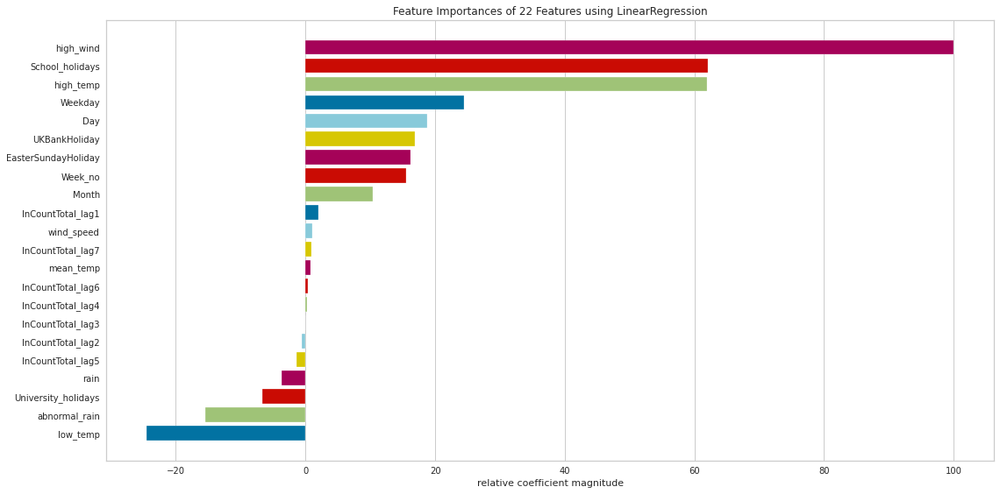

Cross CV validation...
RFE CV tuning...
RFECV - optimal number of features  14
RFE CV - optimal features  ['InCountTotal_lag1', 'Month', 'Weekday', 'Day', 'Week_no', 'rain', 'abnormal_rain', 'high_temp', 'low_temp', 'high_wind', 'EasterSundayHoliday', 'University_holidays', 'School_holidays', 'UKBankHoliday']


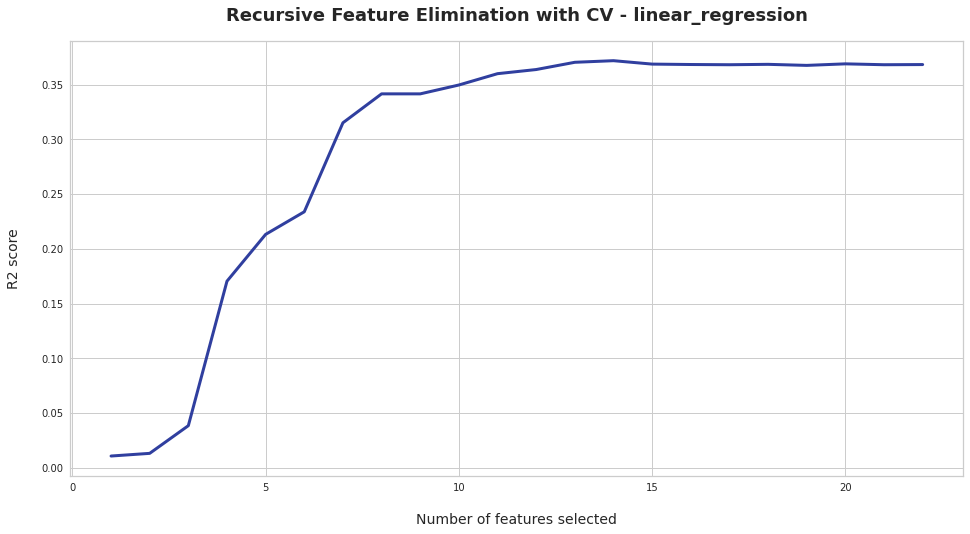

lassoRegressor
default model fitting...
Now tuning Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
      normalize=False, positive=False, precompute=False, random_state=None,
      selection='cyclic', tol=0.0001, warm_start=False).


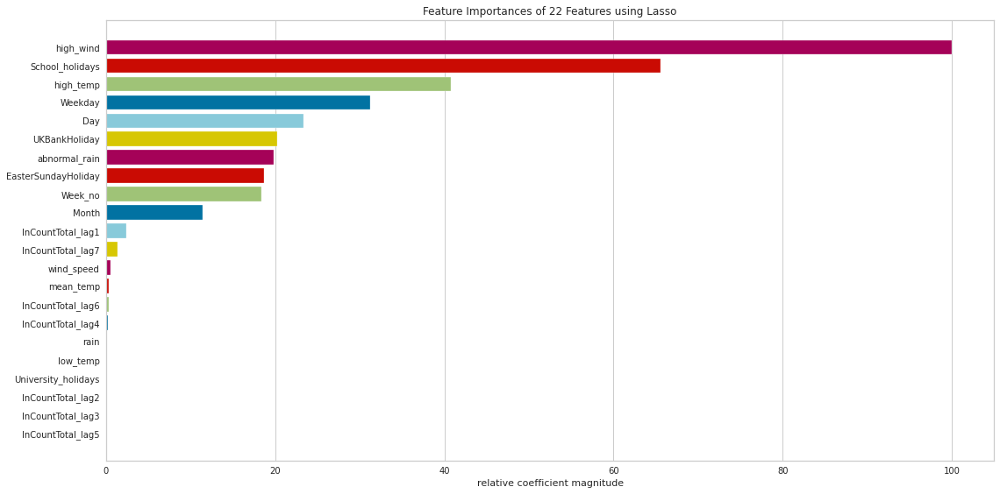

Cross CV validation...
RFE CV tuning...
RFECV - optimal number of features  11
RFE CV - optimal features  ['InCountTotal_lag1', 'Month', 'Weekday', 'Day', 'Week_no', 'abnormal_rain', 'high_temp', 'high_wind', 'EasterSundayHoliday', 'School_holidays', 'UKBankHoliday']


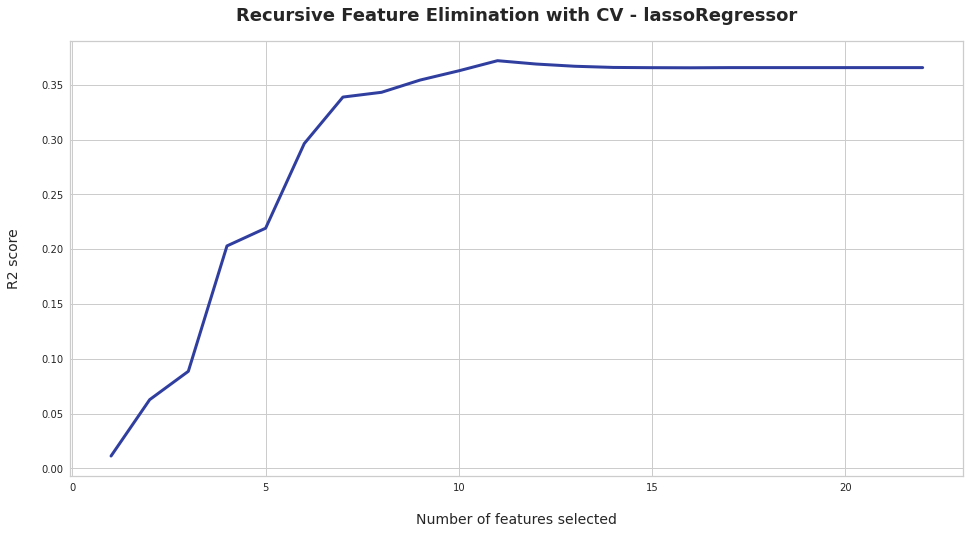

ridgeRegressor
default model fitting...
Now tuning Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=None, solver='auto', tol=0.001).


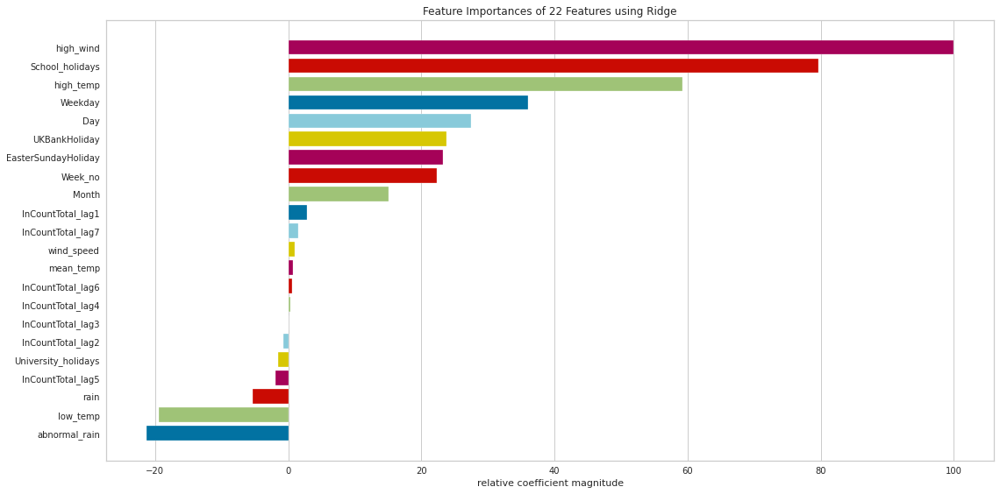

Cross CV validation...
RFE CV tuning...
RFECV - optimal number of features  14
RFE CV - optimal features  ['InCountTotal_lag5', 'InCountTotal_lag1', 'Month', 'Weekday', 'Day', 'Week_no', 'rain', 'abnormal_rain', 'high_temp', 'low_temp', 'high_wind', 'EasterSundayHoliday', 'School_holidays', 'UKBankHoliday']


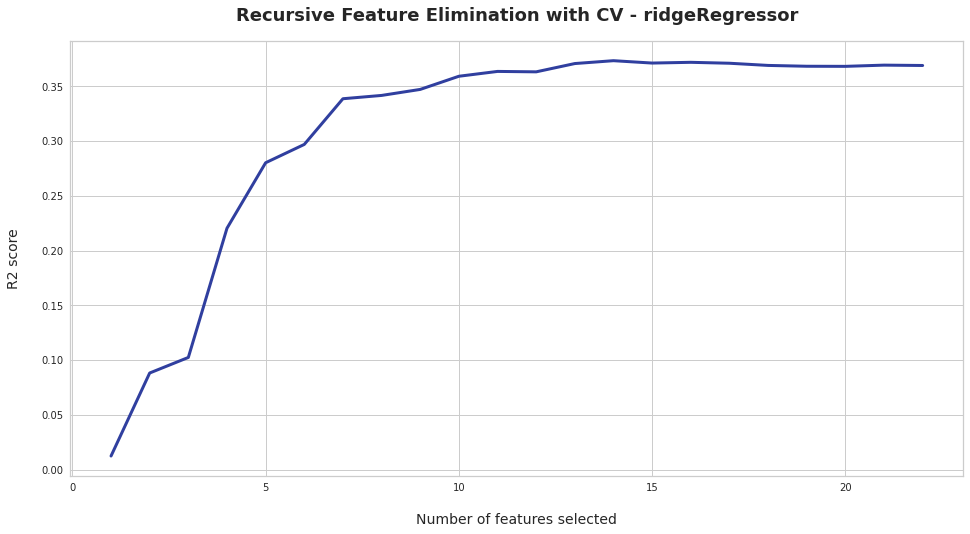

elastic_net
default model fitting...
Now tuning ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='cyclic', tol=0.0001, warm_start=False).


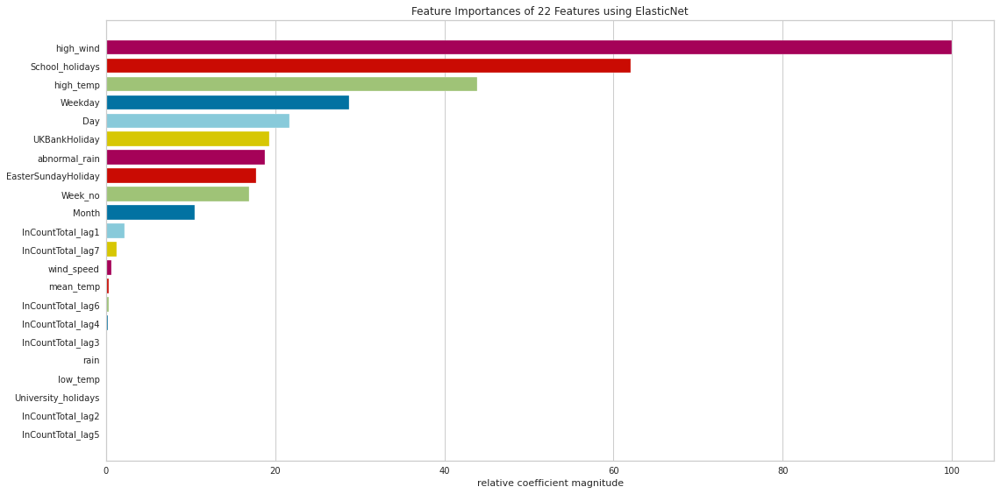

Cross CV validation...
RFE CV tuning...
RFECV - optimal number of features  11
RFE CV - optimal features  ['InCountTotal_lag1', 'Month', 'Weekday', 'Day', 'Week_no', 'abnormal_rain', 'high_temp', 'high_wind', 'EasterSundayHoliday', 'School_holidays', 'UKBankHoliday']


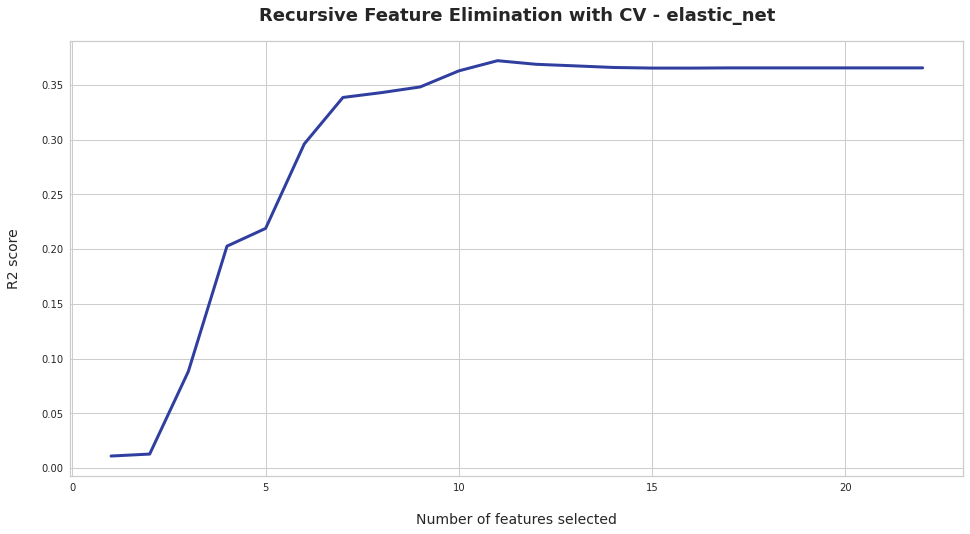

huberRegressor
default model fitting...
Now tuning HuberRegressor(alpha=0.0001, epsilon=1.35, fit_intercept=True, max_iter=100,
               tol=1e-05, warm_start=False).


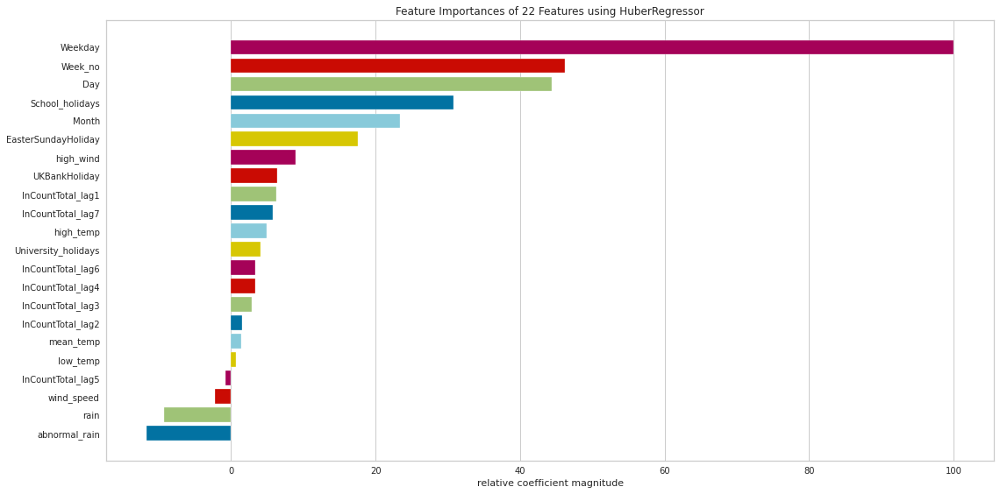

Cross CV validation...
RFE CV tuning...
RFECV - optimal number of features  13
RFE CV - optimal features  ['InCountTotal_lag7', 'InCountTotal_lag1', 'Month', 'Weekday', 'Day', 'Week_no', 'rain', 'abnormal_rain', 'high_wind', 'EasterSundayHoliday', 'University_holidays', 'School_holidays', 'UKBankHoliday']


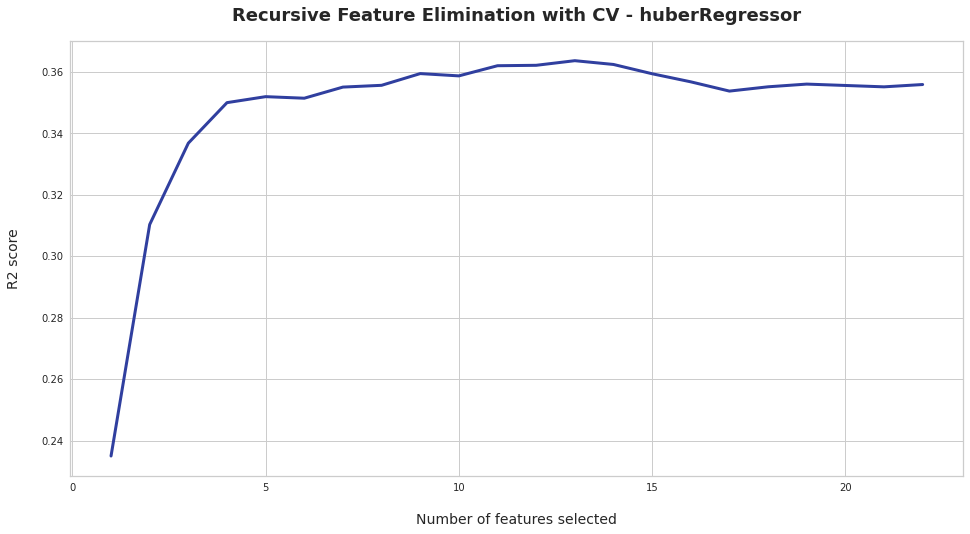

passive_aggressor
default model fitting...
Now tuning PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=None, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False).


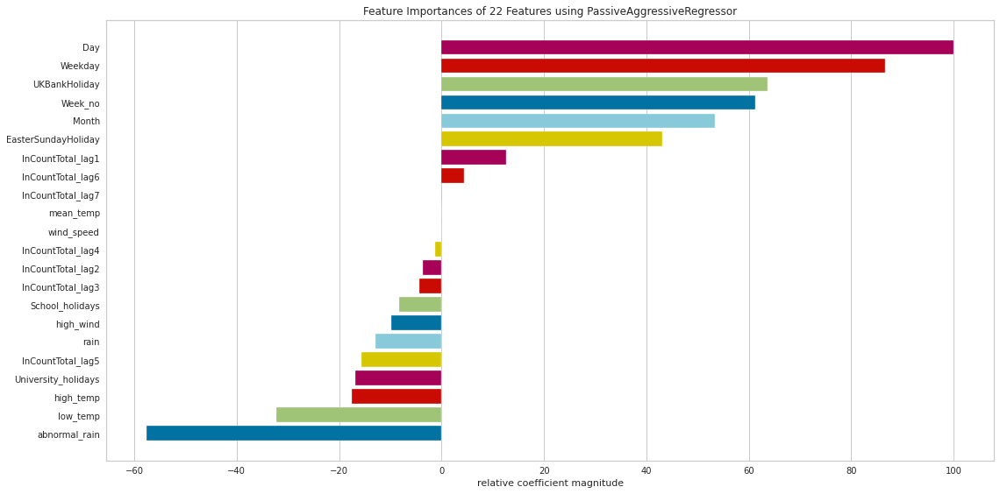

Cross CV validation...
RFE CV tuning...
RFECV - optimal number of features  11
RFE CV - optimal features  ['InCountTotal_lag5', 'Month', 'Weekday', 'Day', 'Week_no', 'rain', 'abnormal_rain', 'low_temp', 'high_wind', 'University_holidays', 'UKBankHoliday']


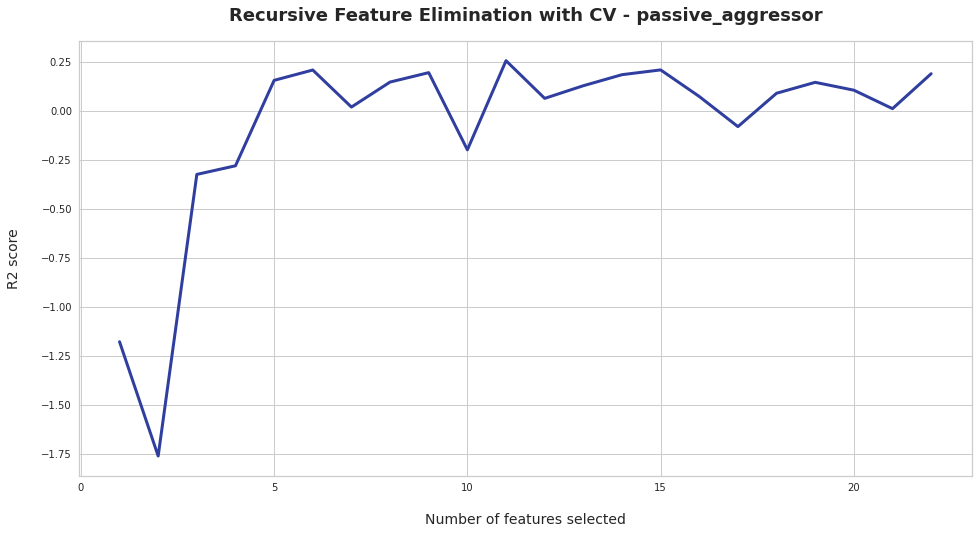

sgd
default model fitting...
Now tuning SGDRegressor(alpha=0.0001, average=False, early_stopping=False, epsilon=0.1,
             eta0=0.01, fit_intercept=True, l1_ratio=0.15,
             learning_rate='invscaling', loss='squared_loss', max_iter=1000,
             n_iter_no_change=5, penalty='l2', power_t=0.25, random_state=None,
             shuffle=True, tol=0.001, validation_fraction=0.1, verbose=0,
             warm_start=False).


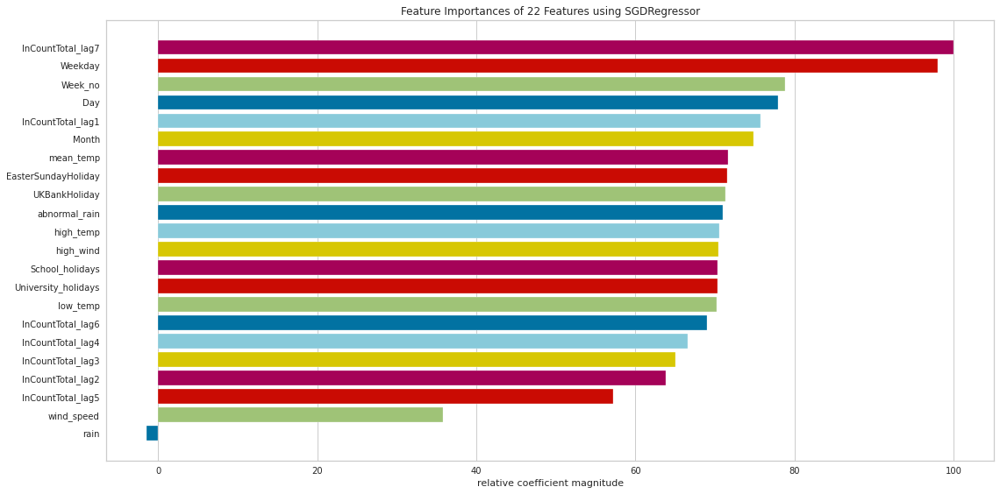

Cross CV validation...
RFE CV tuning...
RFECV - optimal number of features  13
RFE CV - optimal features  ['InCountTotal_lag7', 'InCountTotal_lag1', 'Month', 'Weekday', 'Day', 'Week_no', 'abnormal_rain', 'high_temp', 'high_wind', 'EasterSundayHoliday', 'University_holidays', 'School_holidays', 'UKBankHoliday']


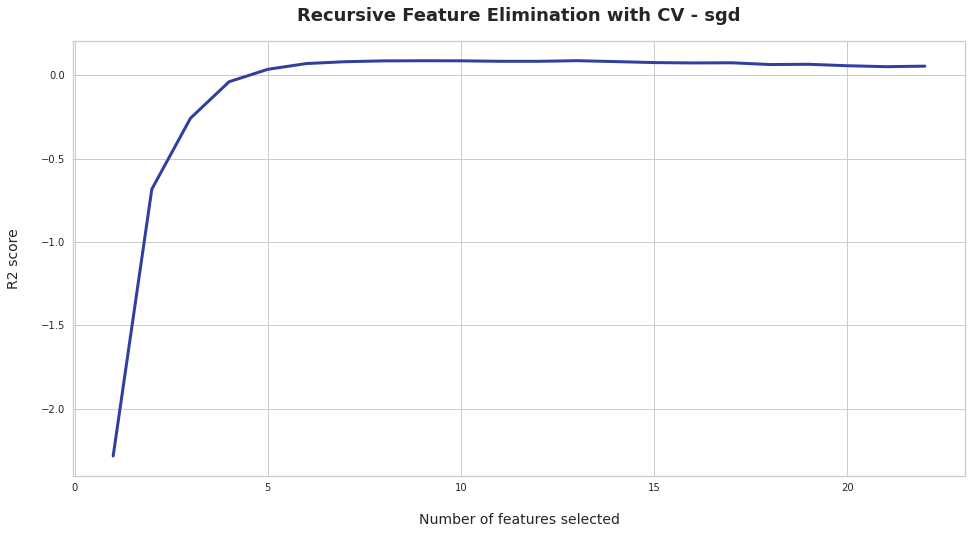

knn_regressor
default model fitting...
Now tuning KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=None, n_neighbors=7, p=2,
                    weights='uniform').
Cross CV validation...
decisiontree_regressor
default model fitting...
Now tuning DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best').


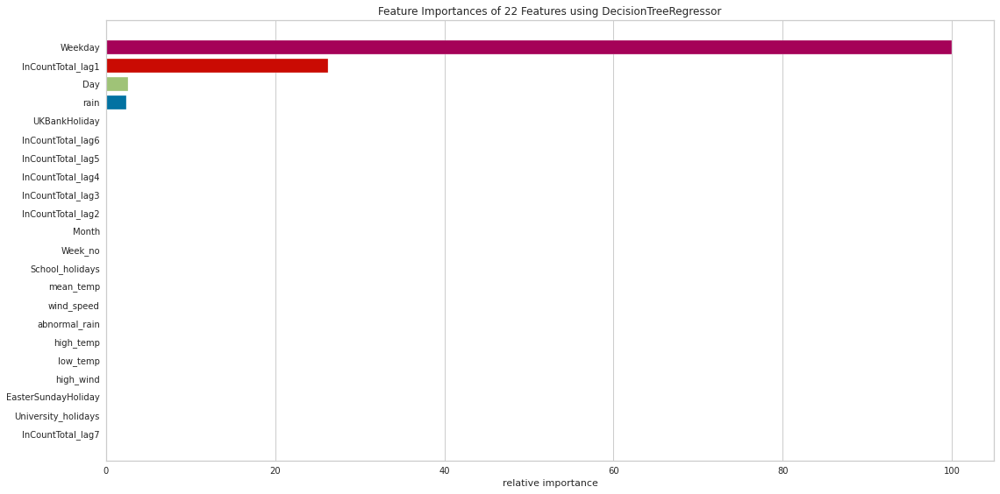

Cross CV validation...
RFE CV tuning...
RFECV - optimal number of features  17
RFE CV - optimal features  ['InCountTotal_lag2', 'InCountTotal_lag1', 'Month', 'Weekday', 'Day', 'Week_no', 'mean_temp', 'rain', 'wind_speed', 'abnormal_rain', 'high_temp', 'low_temp', 'high_wind', 'EasterSundayHoliday', 'University_holidays', 'School_holidays', 'UKBankHoliday']


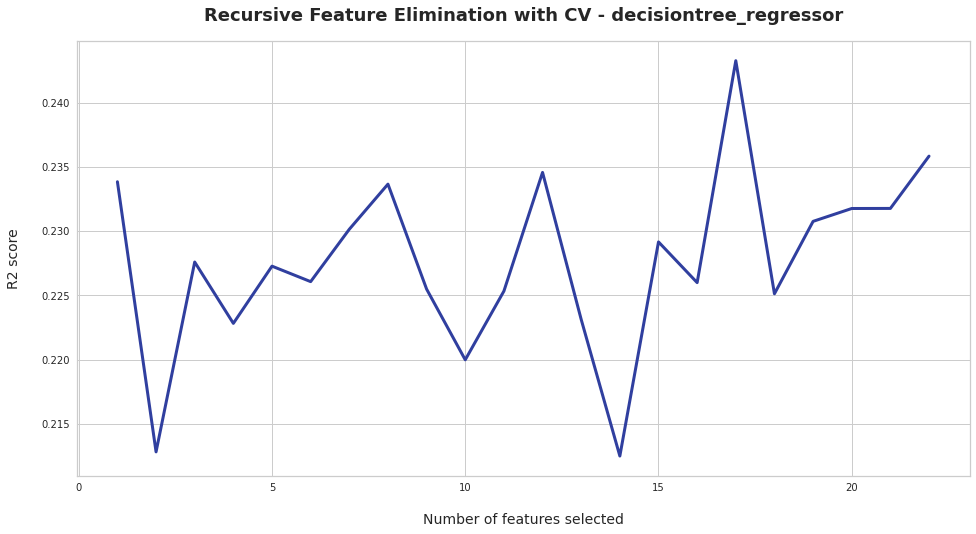

extra_tree_regressor
default model fitting...
Now tuning ExtraTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                   max_features='auto', max_leaf_nodes=None,
                   min_impurity_decrease=0.0, min_impurity_split=None,
                   min_samples_leaf=1, min_samples_split=2,
                   min_weight_fraction_leaf=0.0, random_state=None,
                   splitter='random').


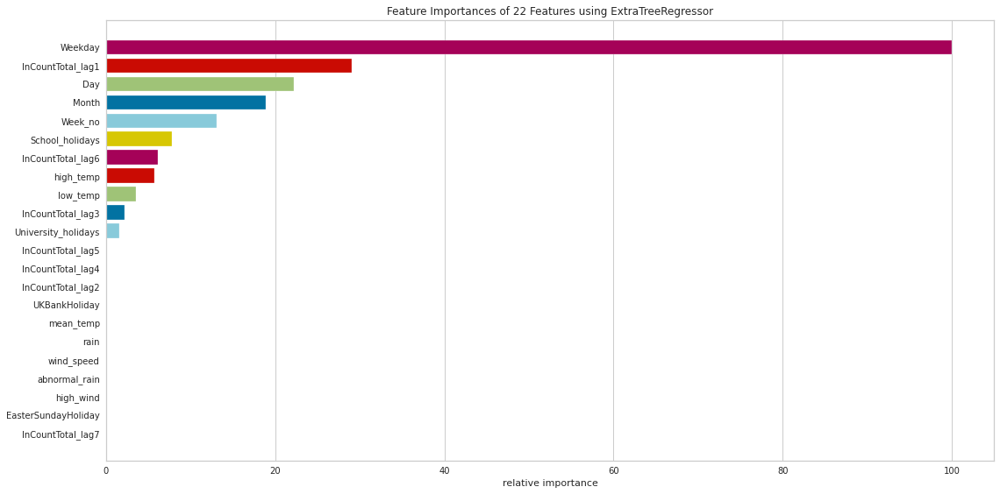

Cross CV validation...
RFE CV tuning...
RFECV - optimal number of features  5
RFE CV - optimal features  ['InCountTotal_lag3', 'InCountTotal_lag1', 'Month', 'Weekday', 'Week_no']


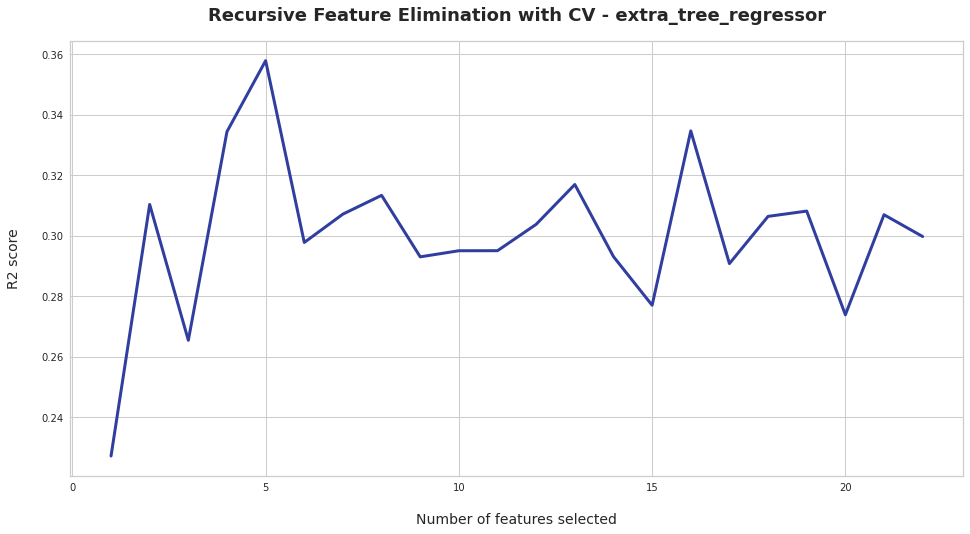

svm_regressor
default model fitting...
Now tuning SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1, gamma='scale',
    kernel='rbf', max_iter=-1, shrinking=True, tol=0.001, verbose=False).
Cross CV validation...
adaBoost
default model fitting...
Now tuning AdaBoostRegressor(base_estimator=None, learning_rate=1.0, loss='linear',
                  n_estimators=200, random_state=None).


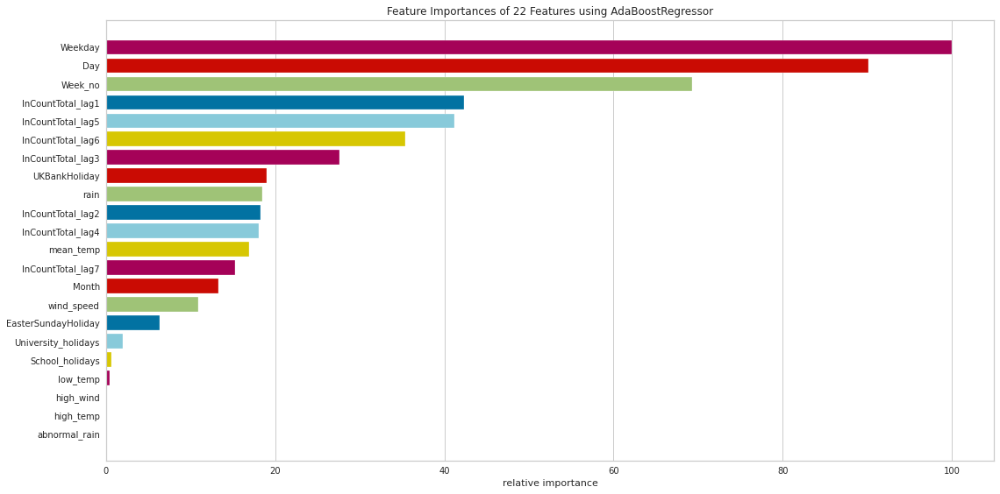

Cross CV validation...
RFE CV tuning...
RFECV - optimal number of features  19
RFE CV - optimal features  ['InCountTotal_lag7', 'InCountTotal_lag6', 'InCountTotal_lag5', 'InCountTotal_lag4', 'InCountTotal_lag3', 'InCountTotal_lag2', 'InCountTotal_lag1', 'Month', 'Weekday', 'Day', 'Week_no', 'mean_temp', 'rain', 'wind_speed', 'low_temp', 'EasterSundayHoliday', 'University_holidays', 'School_holidays', 'UKBankHoliday']


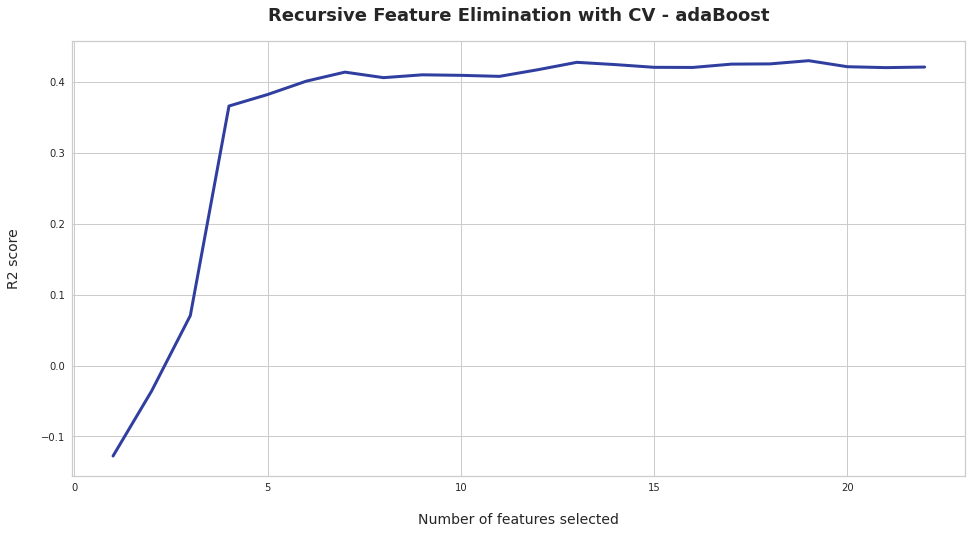

bagging
default model fitting...
Now tuning BaggingRegressor(base_estimator=None, bootstrap=True, bootstrap_features=False,
                 max_features=1.0, max_samples=1.0, n_estimators=200,
                 n_jobs=None, oob_score=False, random_state=None, verbose=0,
                 warm_start=False).
Cross CV validation...
random_forest
default model fitting...
Now tuning RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=200, n_jobs=None, oob_score=False,
                      random_state=None, verbose=0, warm_start=False).


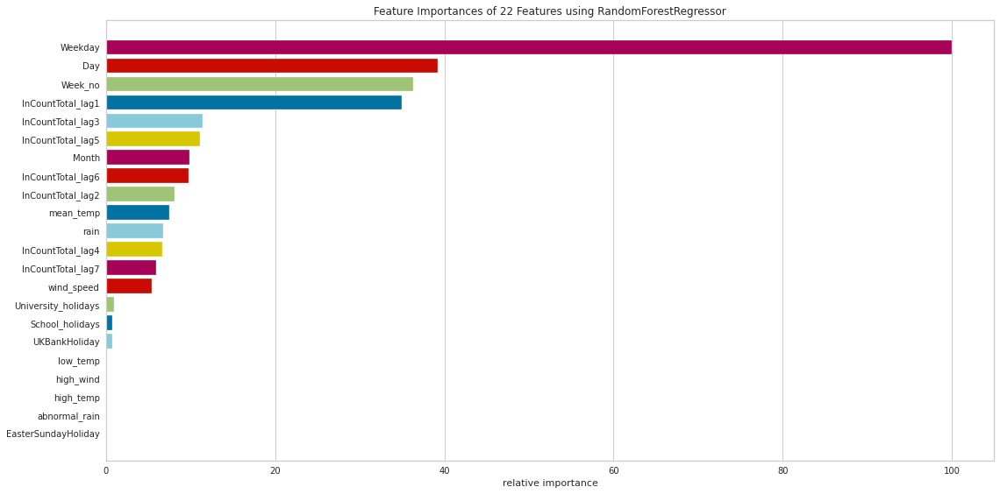

Cross CV validation...
RFE CV tuning...
RFECV - optimal number of features  21
RFE CV - optimal features  ['InCountTotal_lag7', 'InCountTotal_lag6', 'InCountTotal_lag5', 'InCountTotal_lag4', 'InCountTotal_lag3', 'InCountTotal_lag2', 'InCountTotal_lag1', 'Month', 'Weekday', 'Day', 'Week_no', 'mean_temp', 'rain', 'wind_speed', 'abnormal_rain', 'high_temp', 'low_temp', 'high_wind', 'University_holidays', 'School_holidays', 'UKBankHoliday']


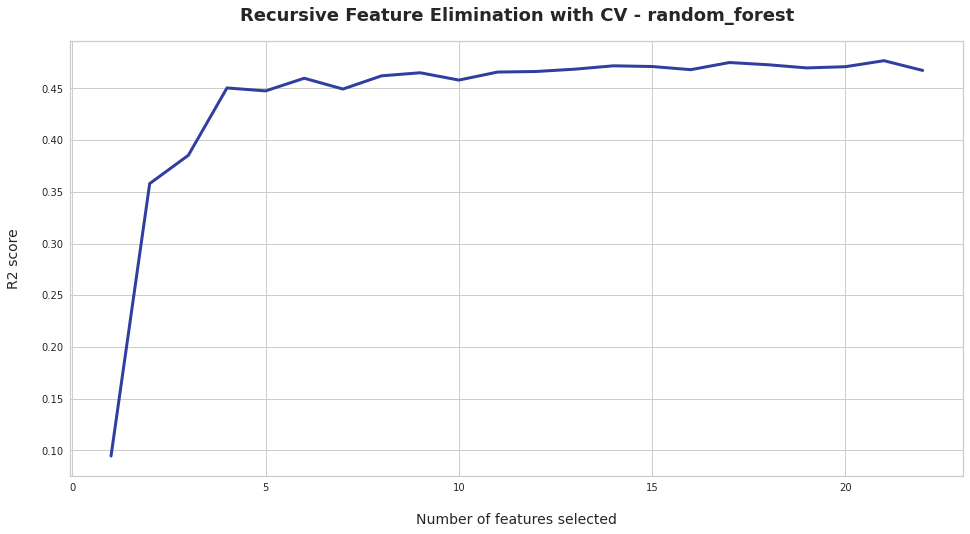

extra_trees_regressor
default model fitting...
Now tuning ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=200, n_jobs=None, oob_score=False,
                    random_state=None, verbose=0, warm_start=False).


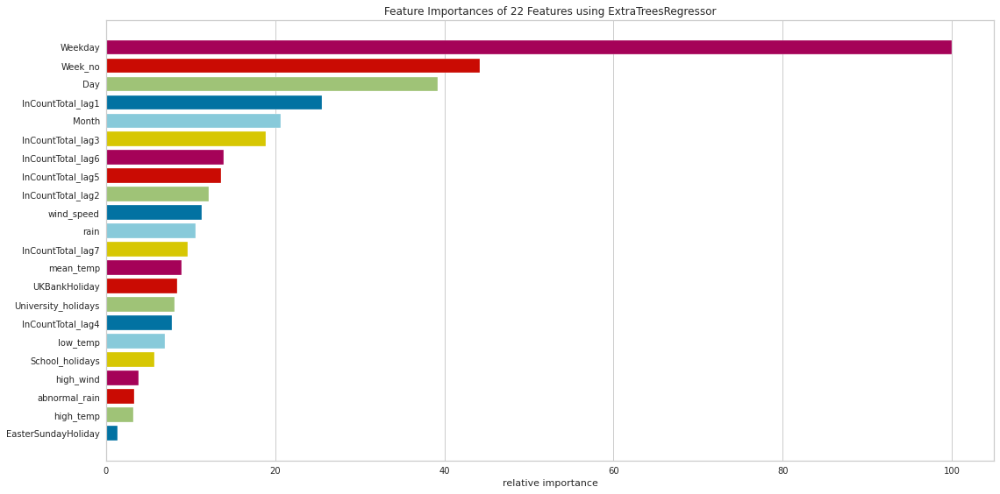

Cross CV validation...
RFE CV tuning...
RFECV - optimal number of features  13
RFE CV - optimal features  ['InCountTotal_lag7', 'InCountTotal_lag6', 'InCountTotal_lag5', 'InCountTotal_lag3', 'InCountTotal_lag2', 'InCountTotal_lag1', 'Month', 'Weekday', 'Day', 'Week_no', 'mean_temp', 'rain', 'wind_speed']


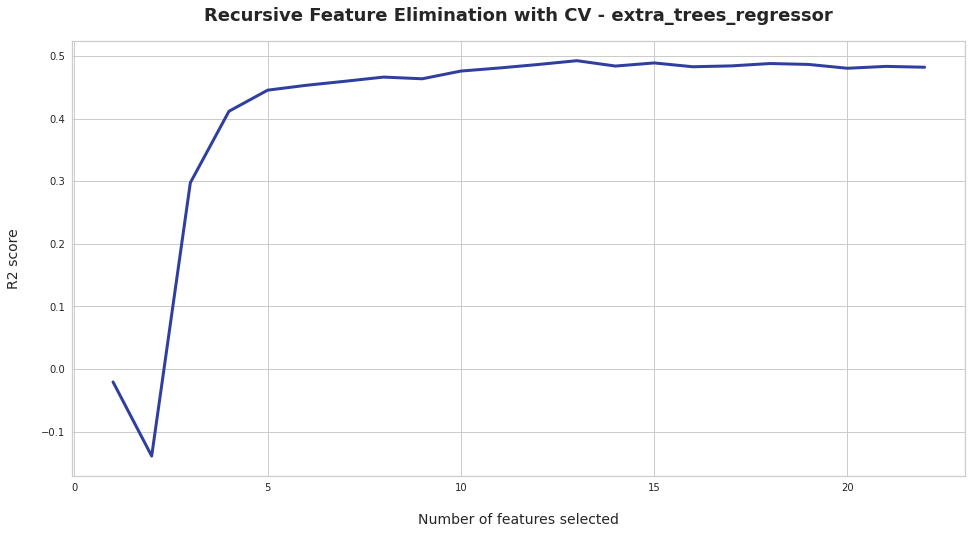

gradient_boosting_regressor
default model fitting...
Now tuning GradientBoostingRegressor(alpha=0.9, ccp_alpha=0.0, criterion='friedman_mse',
                          init=None, learning_rate=0.1, loss='ls', max_depth=3,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=200,
                          n_iter_no_change=None, presort='deprecated',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False).


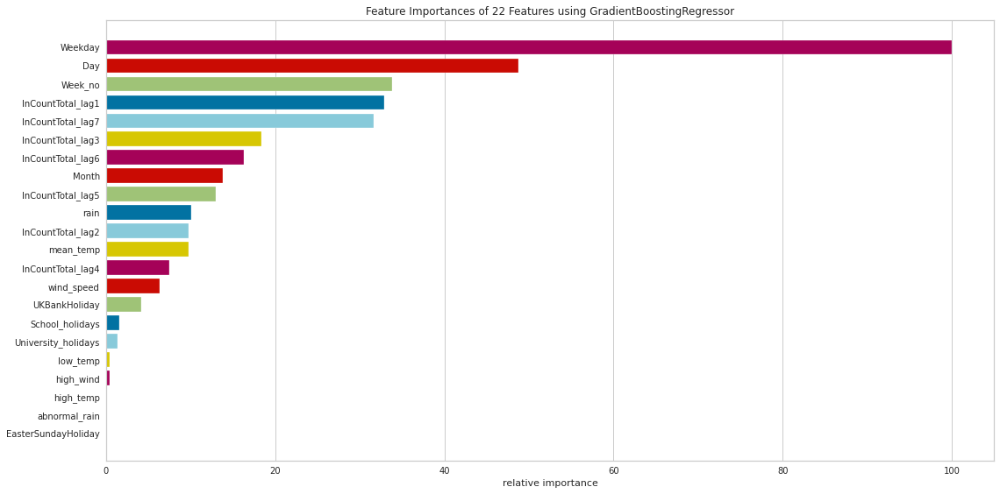

Cross CV validation...
RFE CV tuning...
RFECV - optimal number of features  19
RFE CV - optimal features  ['InCountTotal_lag7', 'InCountTotal_lag6', 'InCountTotal_lag5', 'InCountTotal_lag4', 'InCountTotal_lag3', 'InCountTotal_lag2', 'InCountTotal_lag1', 'Month', 'Weekday', 'Day', 'Week_no', 'mean_temp', 'rain', 'wind_speed', 'abnormal_rain', 'low_temp', 'University_holidays', 'School_holidays', 'UKBankHoliday']


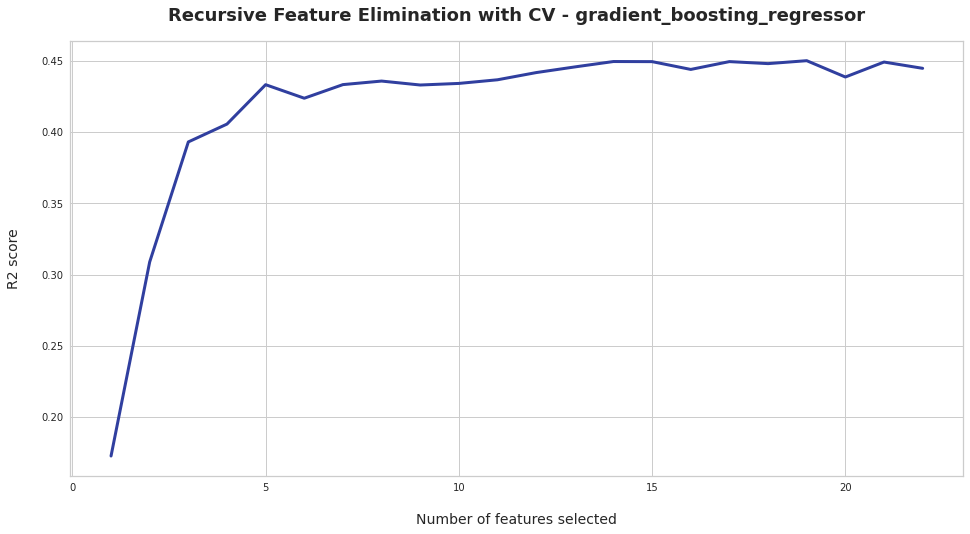

XGBoost
default model fitting...
Now tuning XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0,
             importance_type='gain', learning_rate=0.1, max_delta_step=0,
             max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
             n_jobs=1, nthread=None, objective='reg:squarederror',
             random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
             seed=None, silent=None, subsample=1, verbosity=1).


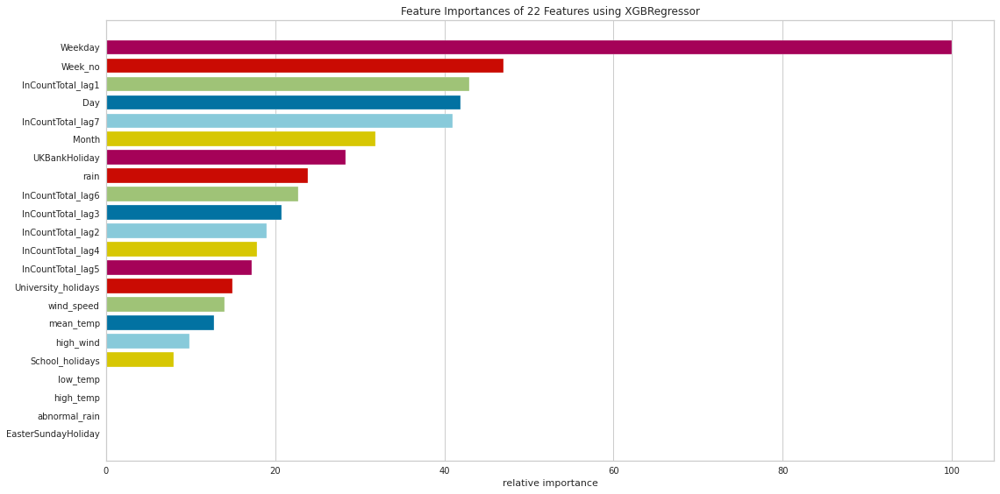

Cross CV validation...
RFE CV tuning...
RFECV - optimal number of features  18
RFE CV - optimal features  ['InCountTotal_lag7', 'InCountTotal_lag6', 'InCountTotal_lag5', 'InCountTotal_lag4', 'InCountTotal_lag3', 'InCountTotal_lag2', 'InCountTotal_lag1', 'Month', 'Weekday', 'Day', 'Week_no', 'mean_temp', 'rain', 'wind_speed', 'abnormal_rain', 'University_holidays', 'School_holidays', 'UKBankHoliday']


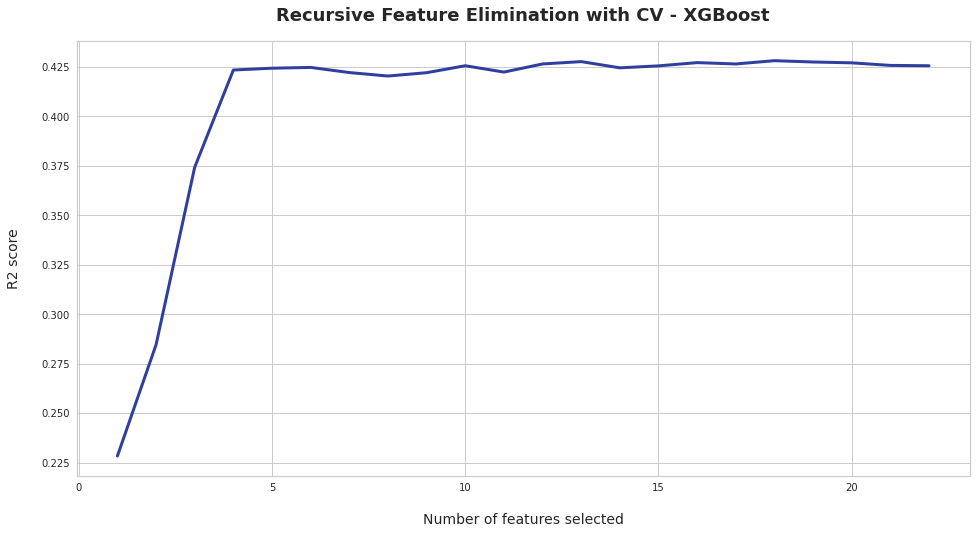

LightGradientBoosting
default model fitting...
Now tuning LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
              importance_type='split', learning_rate=0.1, max_depth=-1,
              min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
              n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
              random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
              subsample=1.0, subsample_for_bin=200000, subsample_freq=0).
Cross CV validation...
CategoricalGradientBoosting
default model fitting...
Now tuning <catboost.core.CatBoostRegressor object at 0x7f621aaf02e8>.
Cross CV validation...
NeuralNet_MLP
default model fitting...
Now tuning MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_fun=15000, max_ite

In [ ]:
reg_models = regression_model(data_final,dataset_type='normal_shuffled')
_,_,_, _, _, loss_normal_df = reg_models.train_and_evaluate_models(shuffle=True)
loss_values_all_models.append(loss_normal_df)

In [ ]:
loss_normal_df.sort_values('mape').head(25)

,Model_type,mape,mse,me,mae,mpe,rmse,R2 score,Adj R2 score,AIC,BIC
69,CategoricalGradientBoosting_normal_shuffled_rs...,18.263525,0.005194,-0.015631,0.049655,0.038009,0.072067,0.434226,0.395149,-1831.931066,-1742.743143
57,gradient_boosting_regressor_normal_shuffled_de...,19.053325,0.005619,-0.019268,0.052443,0.032152,0.074962,0.387865,0.345586,-1803.814333,-1714.626410
68,CategoricalGradientBoosting_normal_shuffled_de...,19.332720,0.004999,-0.014414,0.048720,0.055079,0.070706,0.455398,0.417783,-1845.546436,-1756.358513
61,XGBoost_normal_shuffled_default_model,19.616281,0.005520,-0.017470,0.052288,0.044728,0.074295,0.398706,0.357175,-1810.193359,-1721.005436
46,bagging_normal_shuffled_default_model,19.909527,0.004860,-0.011332,0.047372,0.071547,0.069714,0.470573,0.434006,-1855.635402,-1766.447479
43,adaBoost_normal_shuffled_rscv_model,19.954299,0.005272,-0.006670,0.051145,0.078954,0.072610,0.425676,0.386007,-1826.575925,-1737.388002
49,random_forest_normal_shuffled_default_model,20.072601,0.004724,-0.011216,0.046808,0.074598,0.068733,0.485368,0.449822,-1865.753745,-1776.565822
65,LightGradientBoosting_normal_shuffled_default_...,20.169817,0.005365,-0.015131,0.050980,0.055039,0.073246,0.415568,0.375202,-1820.347930,-1731.160007
66,LightGradientBoosting_normal_shuffled_rscv_model,20.187940,0.005135,-0.015762,0.049409,0.059171,0.071660,0.440596,0.401959,-1835.973252,-1746.785329
45,adaBoost_normal_shuffled_rfecv_model,20.272623,0.005194,-0.006177,0.050850,0.083976,0.072068,0.434221,0.395143,-1831.927648,-1742.739725


Defined 20 models
linear_regression
default model fitting...
Now tuning LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False).


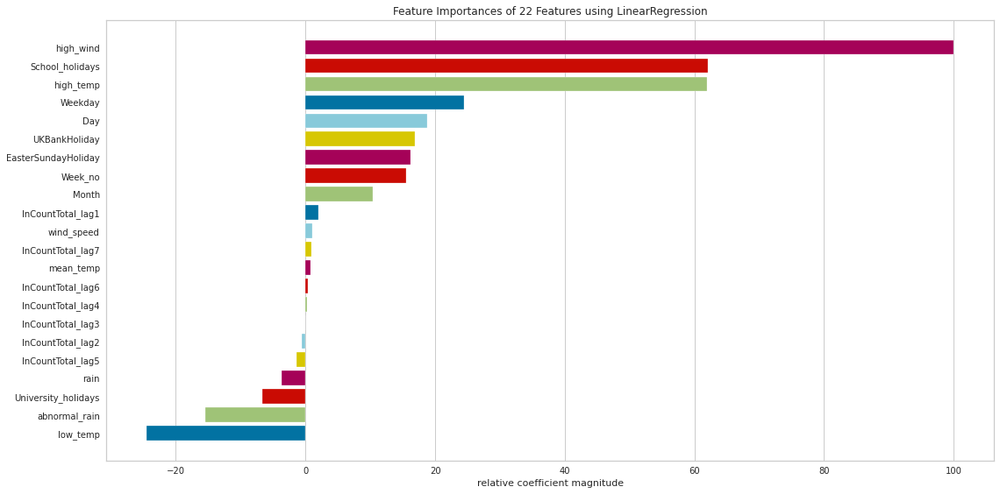

Cross CV validation...
lassoRegressor
default model fitting...
Now tuning Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
      normalize=False, positive=False, precompute=False, random_state=None,
      selection='cyclic', tol=0.0001, warm_start=False).


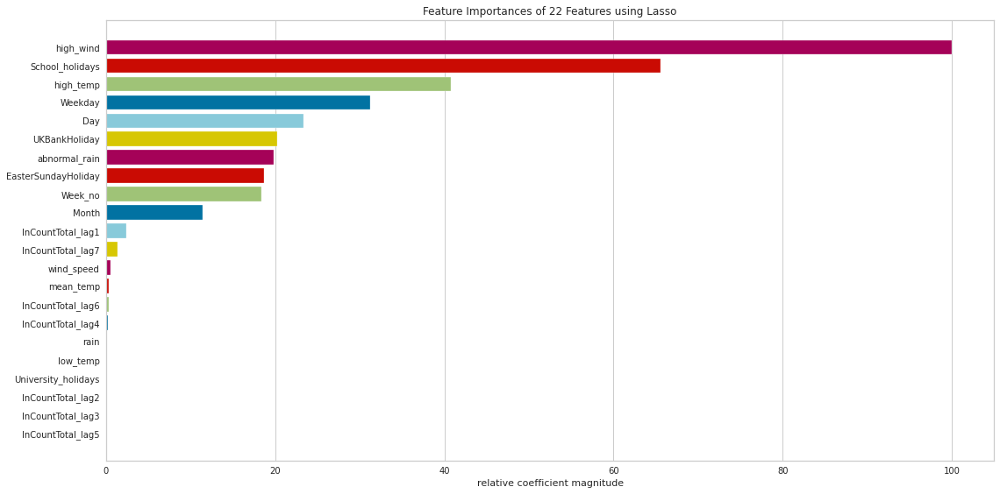

Cross CV validation...
ridgeRegressor
default model fitting...
Now tuning Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=None, solver='auto', tol=0.001).


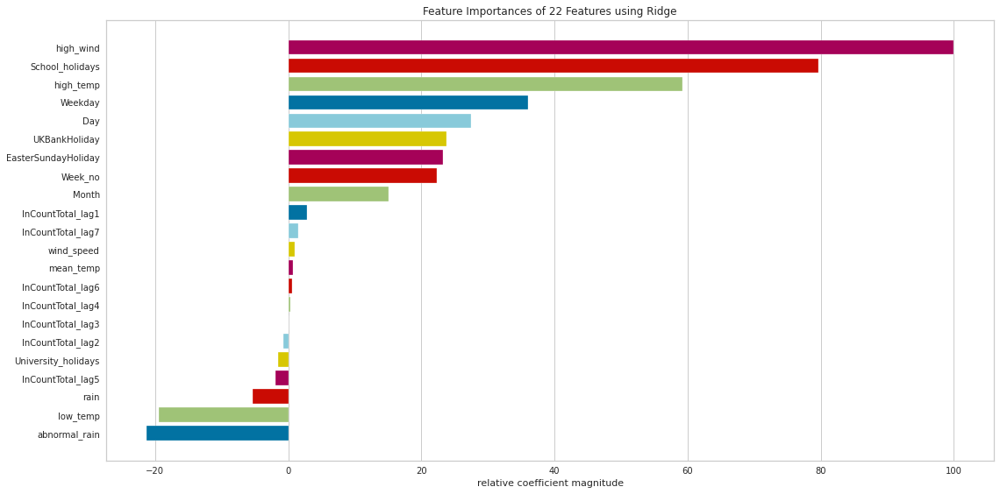

Cross CV validation...
elastic_net
default model fitting...
Now tuning ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='cyclic', tol=0.0001, warm_start=False).


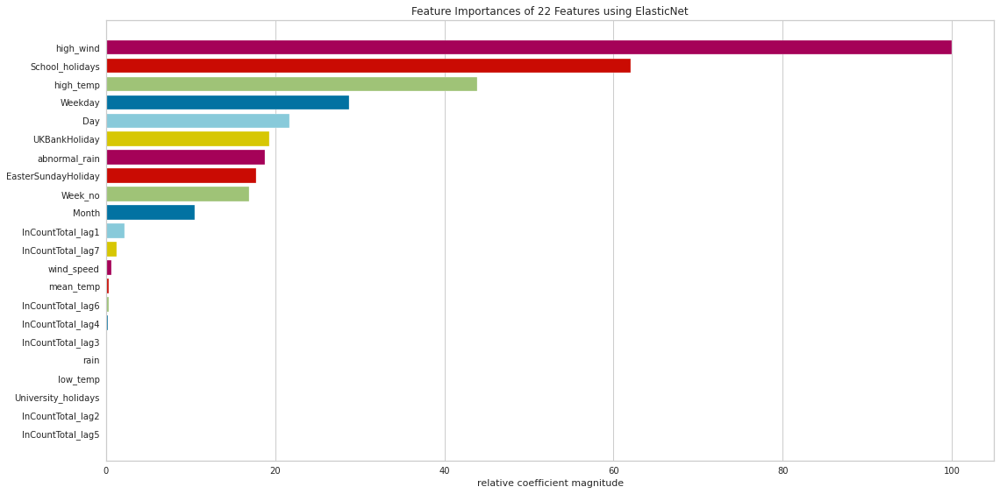

Cross CV validation...
huberRegressor
default model fitting...
Now tuning HuberRegressor(alpha=0.0001, epsilon=1.35, fit_intercept=True, max_iter=100,
               tol=1e-05, warm_start=False).


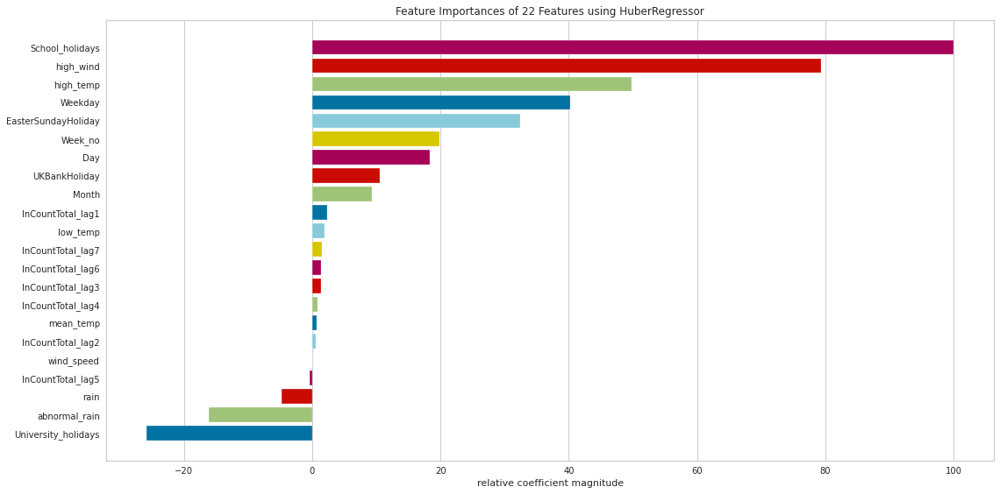

Cross CV validation...
passive_aggressor
default model fitting...
Now tuning PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=None, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False).


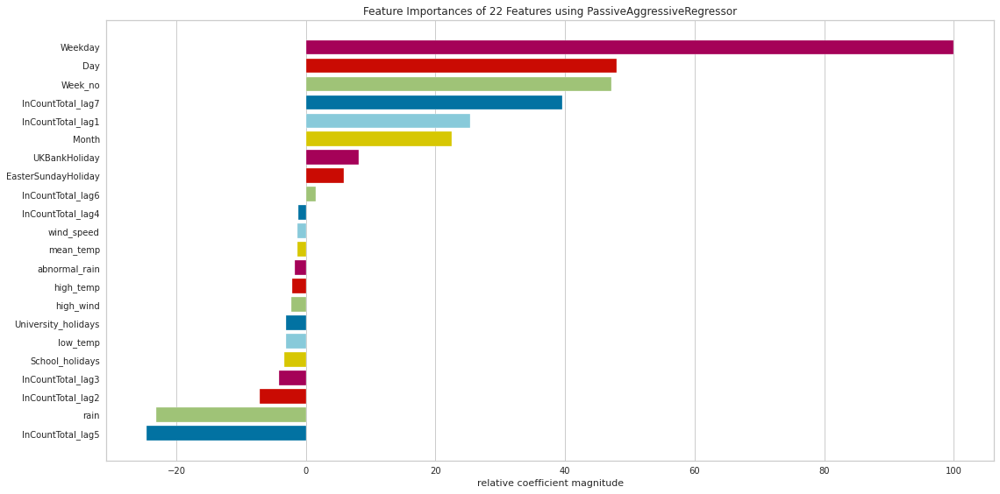

Cross CV validation...
sgd
default model fitting...
Now tuning SGDRegressor(alpha=0.0001, average=False, early_stopping=False, epsilon=0.1,
             eta0=0.01, fit_intercept=True, l1_ratio=0.15,
             learning_rate='invscaling', loss='squared_loss', max_iter=1000,
             n_iter_no_change=5, penalty='l2', power_t=0.25, random_state=None,
             shuffle=True, tol=0.001, validation_fraction=0.1, verbose=0,
             warm_start=False).


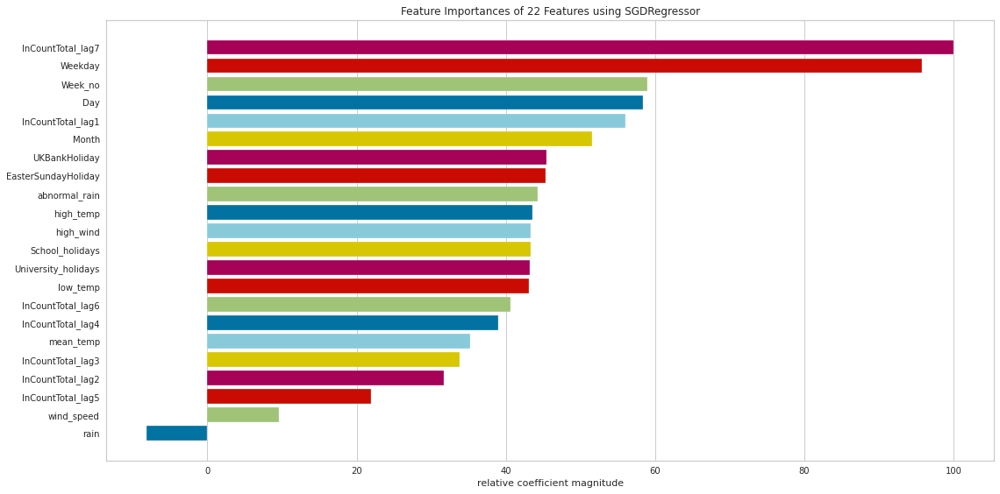

Cross CV validation...
knn_regressor
default model fitting...
Now tuning KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=None, n_neighbors=7, p=2,
                    weights='uniform').
Cross CV validation...
decisiontree_regressor
default model fitting...
Now tuning DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best').


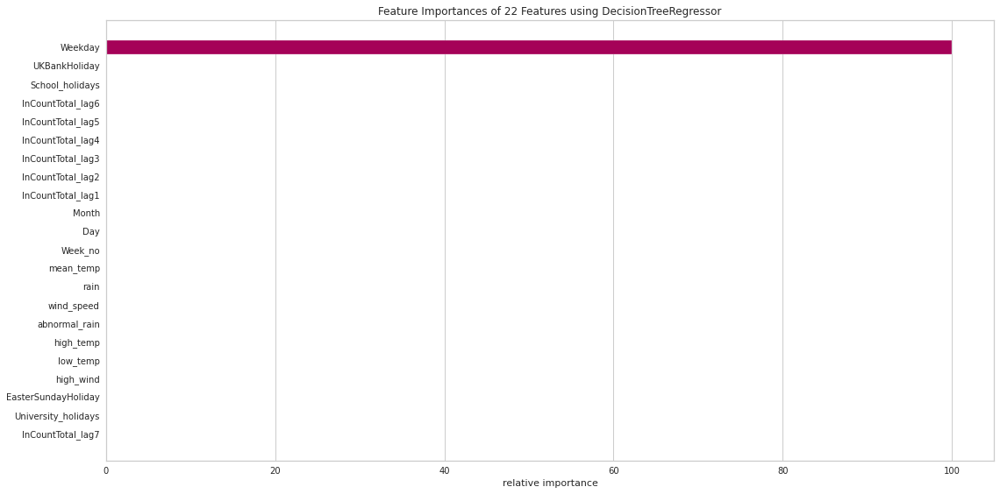

Cross CV validation...
extra_tree_regressor
default model fitting...
Now tuning ExtraTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                   max_features='auto', max_leaf_nodes=None,
                   min_impurity_decrease=0.0, min_impurity_split=None,
                   min_samples_leaf=1, min_samples_split=2,
                   min_weight_fraction_leaf=0.0, random_state=None,
                   splitter='random').


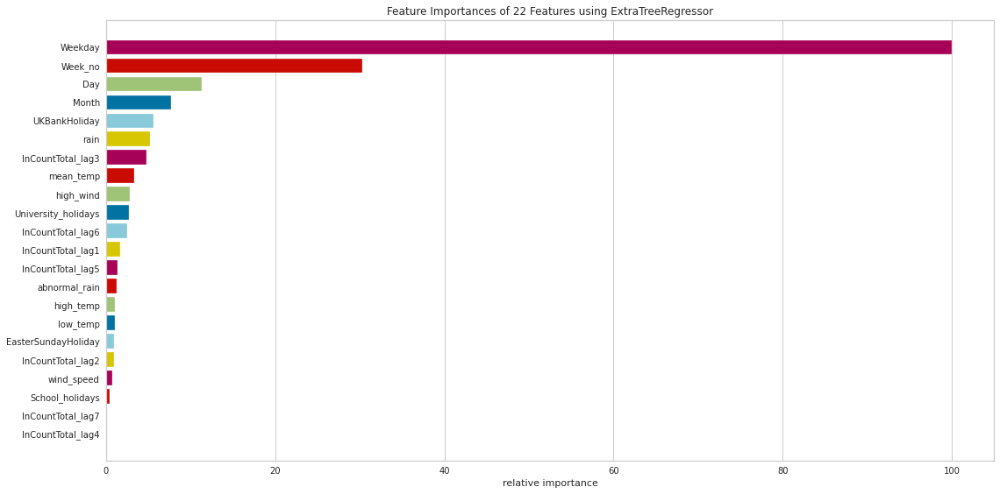

Cross CV validation...
svm_regressor
default model fitting...
Now tuning SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1, gamma='scale',
    kernel='rbf', max_iter=-1, shrinking=True, tol=0.001, verbose=False).
Cross CV validation...
adaBoost
default model fitting...
Now tuning AdaBoostRegressor(base_estimator=None, learning_rate=1.0, loss='linear',
                  n_estimators=200, random_state=None).


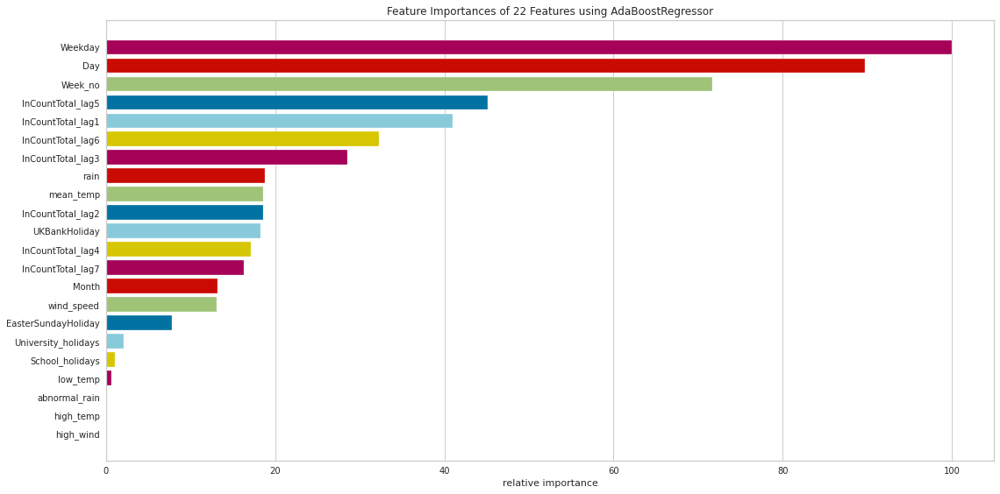

Cross CV validation...
bagging
default model fitting...
Now tuning BaggingRegressor(base_estimator=None, bootstrap=True, bootstrap_features=False,
                 max_features=1.0, max_samples=1.0, n_estimators=200,
                 n_jobs=None, oob_score=False, random_state=None, verbose=0,
                 warm_start=False).
Cross CV validation...
random_forest
default model fitting...
Now tuning RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=200, n_jobs=None, oob_score=False,
                      random_state=None, verbose=0, warm_start=False).


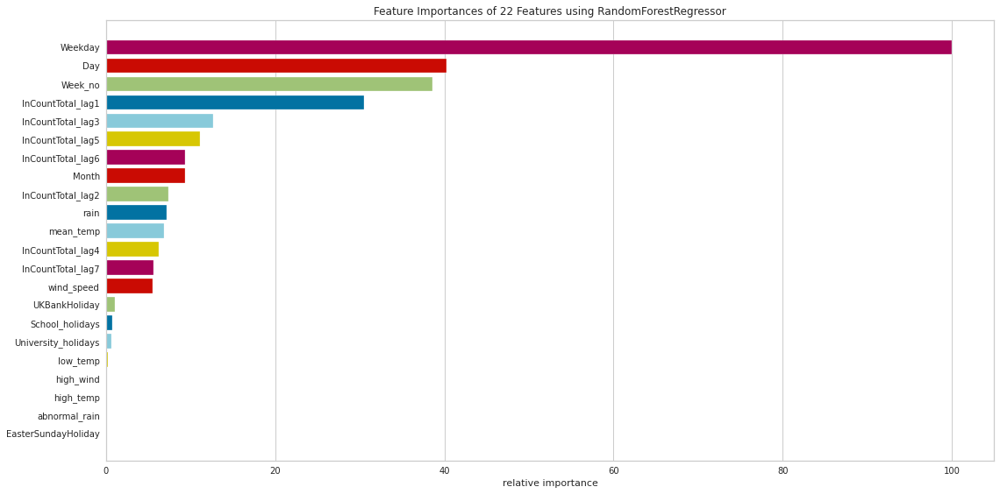

Cross CV validation...
extra_trees_regressor
default model fitting...
Now tuning ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=200, n_jobs=None, oob_score=False,
                    random_state=None, verbose=0, warm_start=False).


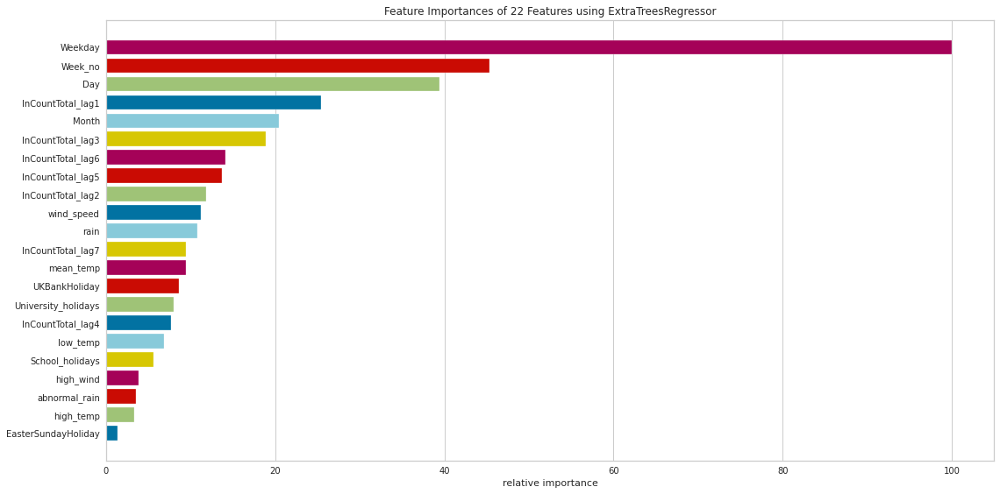

Cross CV validation...
gradient_boosting_regressor
default model fitting...
Now tuning GradientBoostingRegressor(alpha=0.9, ccp_alpha=0.0, criterion='friedman_mse',
                          init=None, learning_rate=0.1, loss='ls', max_depth=3,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=200,
                          n_iter_no_change=None, presort='deprecated',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False).


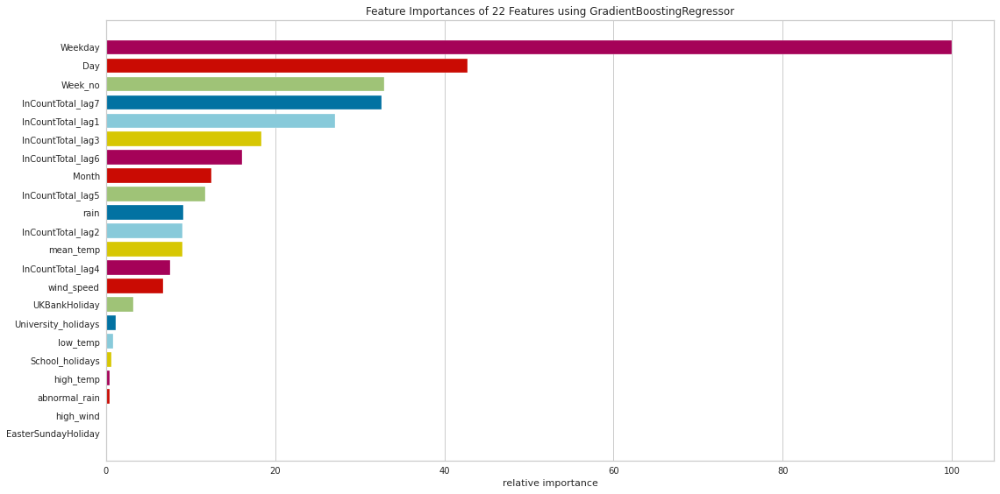

Cross CV validation...
XGBoost
default model fitting...
Now tuning XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0,
             importance_type='gain', learning_rate=0.1, max_delta_step=0,
             max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
             n_jobs=1, nthread=None, objective='reg:squarederror',
             random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
             seed=None, silent=None, subsample=1, verbosity=1).


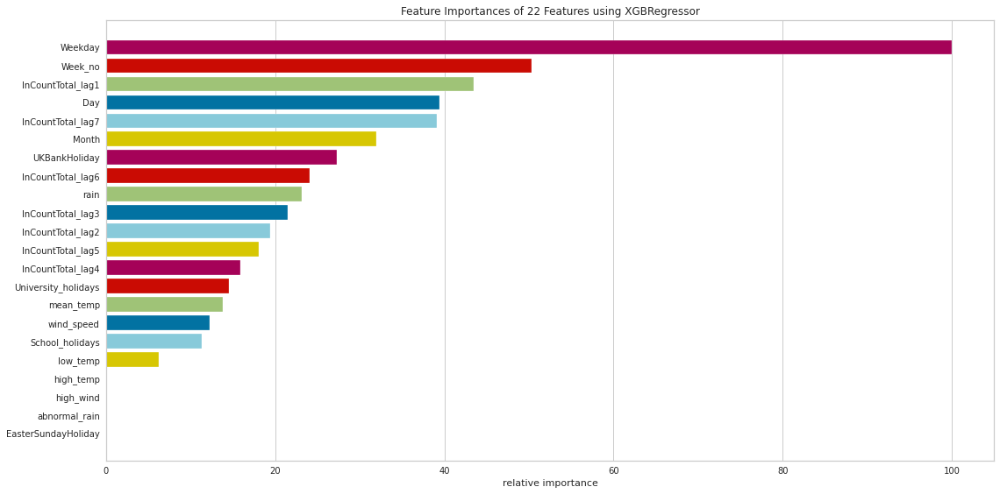

Cross CV validation...
LightGradientBoosting
default model fitting...
Now tuning LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
              importance_type='split', learning_rate=0.1, max_depth=-1,
              min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
              n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
              random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
              subsample=1.0, subsample_for_bin=200000, subsample_freq=0).
Cross CV validation...
CategoricalGradientBoosting
default model fitting...
Now tuning <catboost.core.CatBoostRegressor object at 0x7f6fe5b24828>.
Cross CV validation...
NeuralNet_MLP
default model fitting...
Now tuning MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001,

In [ ]:
reg_models = regression_model(data_final,dataset_type='normal')
_,_,_,_,_, loss_normal_df = reg_models.train_and_evaluate_models(RFEcross_validation=False)
loss_values_all_models.append(loss_normal_df)

In [ ]:
loss_normal_df.sort_values('mape').head(25)

,Model_type,mape,mse,me,mae,mpe,rmse,R2 score,Adj R2 score,AIC,BIC
27,extra_tree_regressor_normal_default_model,17.682390,0.008169,-0.017258,0.066361,-0.023696,0.090383,0.110105,0.048641,-1670.242505,-1581.054582
54,CategoricalGradientBoosting_normal_default_model,19.219415,0.005016,-0.012846,0.048502,0.057750,0.070826,0.453540,0.415797,-1844.330756,-1755.142833
39,random_forest_normal_default_model,19.329474,0.004768,-0.011744,0.047151,0.065599,0.069048,0.480637,0.444765,-1862.487309,-1773.299387
48,XGBoost_normal_default_model,19.616281,0.005520,-0.017470,0.052288,0.044728,0.074295,0.398706,0.357175,-1810.193359,-1721.005436
36,bagging_normal_default_model,20.046916,0.004821,-0.012070,0.047167,0.071957,0.069433,0.474825,0.438552,-1858.514507,-1769.326584
45,gradient_boosting_regressor_normal_default_model,20.077972,0.005698,-0.019247,0.052820,0.041361,0.075486,0.379278,0.336405,-1798.840849,-1709.652926
51,LightGradientBoosting_normal_default_model,20.169817,0.005365,-0.015131,0.050980,0.055039,0.073246,0.415568,0.375202,-1820.347930,-1731.160007
52,LightGradientBoosting_normal_rscv_model,20.187940,0.005135,-0.015762,0.049409,0.059171,0.071660,0.440596,0.401959,-1835.973252,-1746.785329
42,extra_trees_regressor_normal_default_model,20.331362,0.005121,-0.014982,0.050016,0.060256,0.071561,0.442141,0.403610,-1836.960468,-1747.772545
55,CategoricalGradientBoosting_normal_rscv_model,20.421376,0.005221,-0.016520,0.049868,0.060150,0.072255,0.431278,0.391997,-1830.075596,-1740.887673


### 7.1.2 Model training with detrended data

Defined 20 models
linear_regression
default model fitting...
Now tuning LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False).


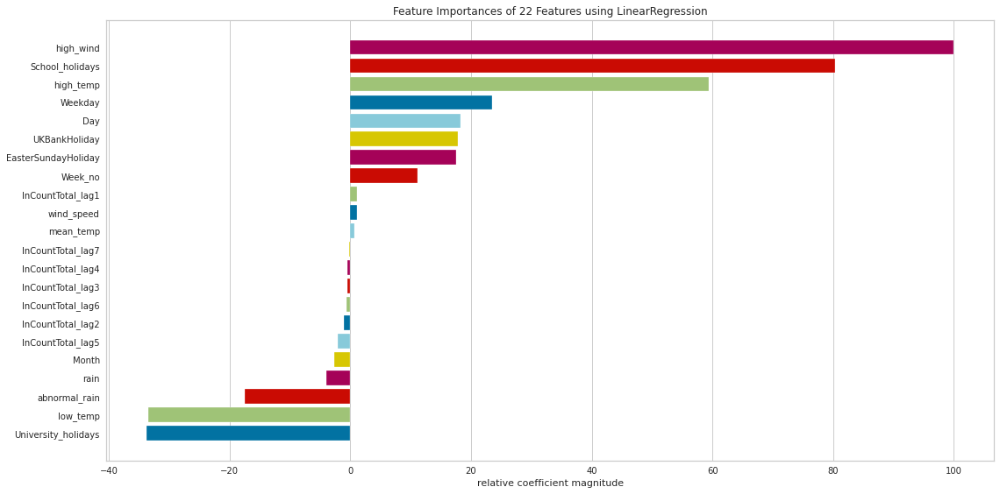

Cross CV validation...
lassoRegressor
default model fitting...
Now tuning Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
      normalize=False, positive=False, precompute=False, random_state=None,
      selection='cyclic', tol=0.0001, warm_start=False).


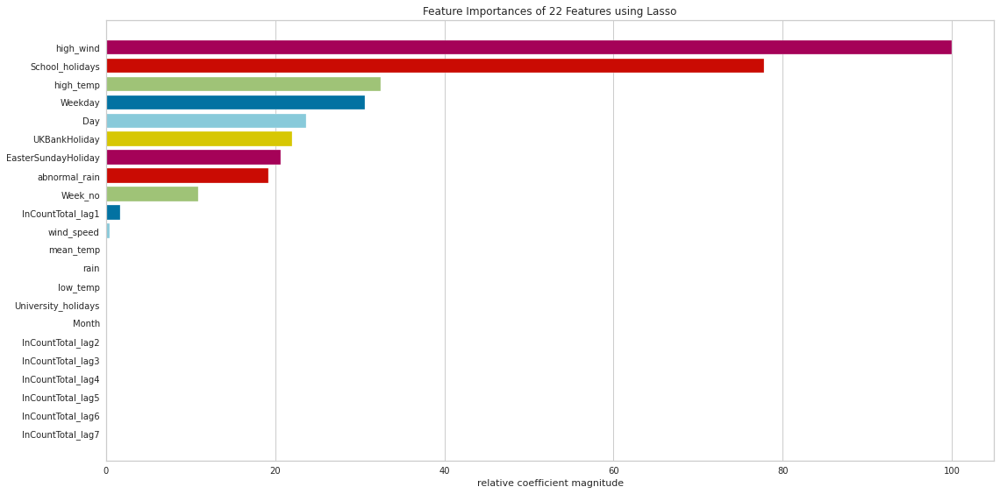

Cross CV validation...
ridgeRegressor
default model fitting...
Now tuning Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=None, solver='auto', tol=0.001).


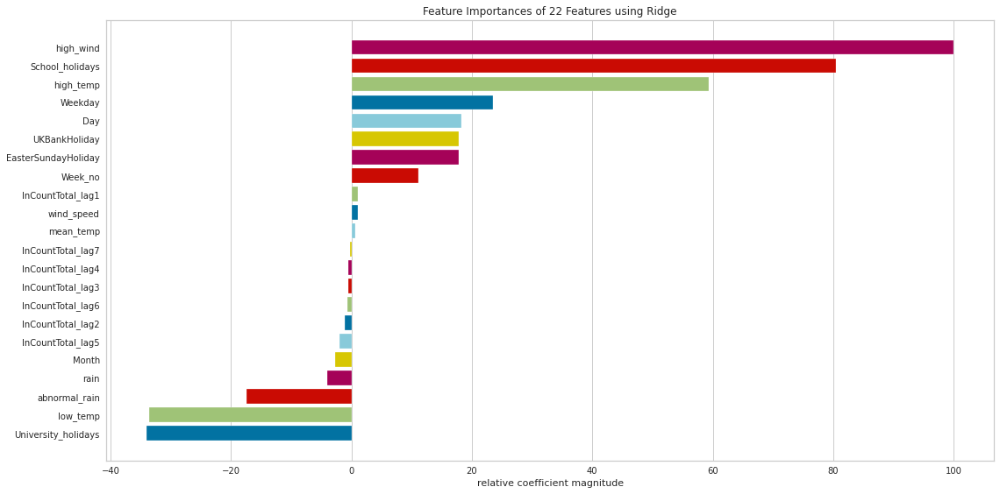

Cross CV validation...
elastic_net
default model fitting...
Now tuning ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='cyclic', tol=0.0001, warm_start=False).


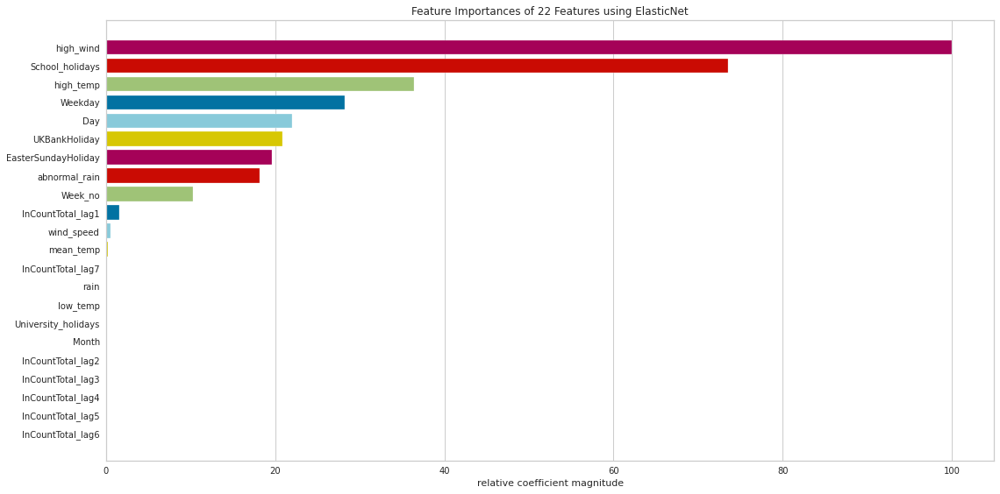

Cross CV validation...
huberRegressor
default model fitting...
Now tuning HuberRegressor(alpha=0.0001, epsilon=1.35, fit_intercept=True, max_iter=100,
               tol=1e-05, warm_start=False).


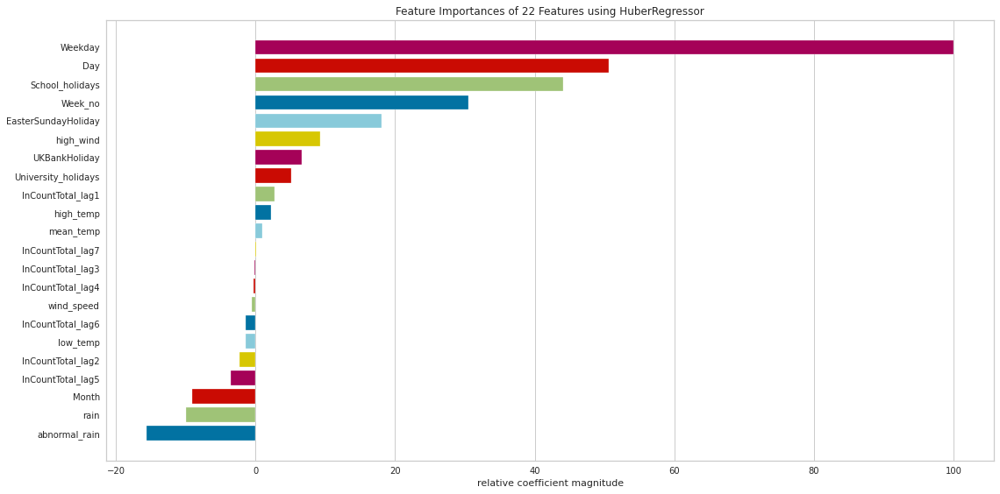

Cross CV validation...
passive_aggressor
default model fitting...
Now tuning PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=None, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False).


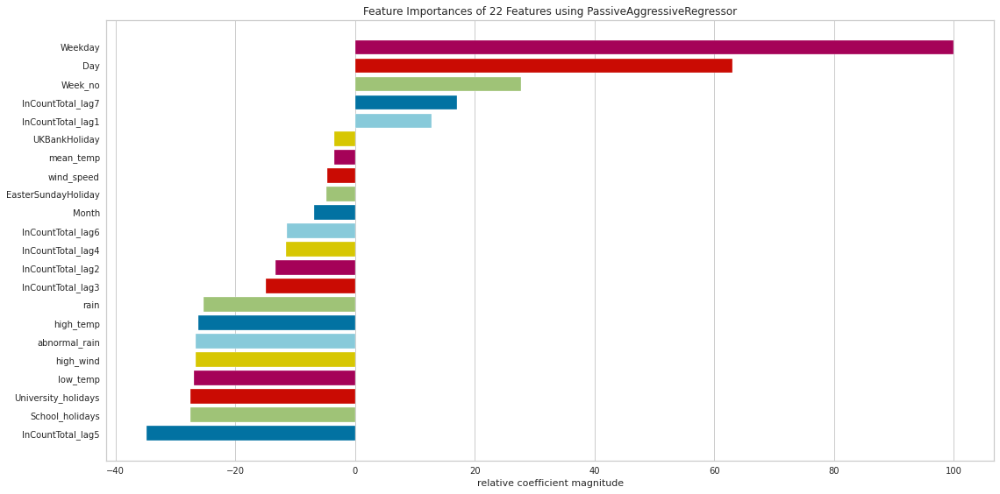

Cross CV validation...
sgd
default model fitting...
Now tuning SGDRegressor(alpha=0.0001, average=False, early_stopping=False, epsilon=0.1,
             eta0=0.01, fit_intercept=True, l1_ratio=0.15,
             learning_rate='invscaling', loss='squared_loss', max_iter=1000,
             n_iter_no_change=5, penalty='l2', power_t=0.25, random_state=None,
             shuffle=True, tol=0.001, validation_fraction=0.1, verbose=0,
             warm_start=False).


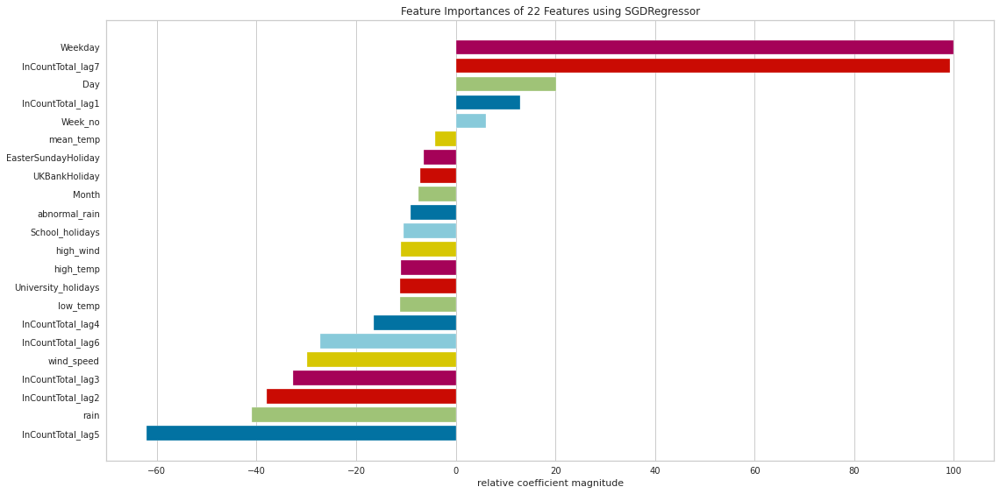

Cross CV validation...
knn_regressor
default model fitting...
Now tuning KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=None, n_neighbors=7, p=2,
                    weights='uniform').
Cross CV validation...
decisiontree_regressor
default model fitting...
Now tuning DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best').


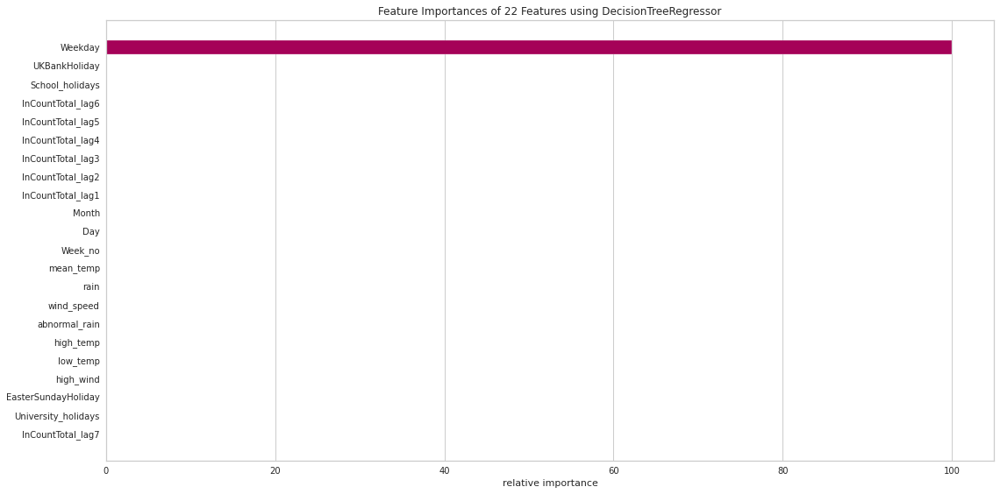

Cross CV validation...
extra_tree_regressor
default model fitting...
Now tuning ExtraTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                   max_features='auto', max_leaf_nodes=None,
                   min_impurity_decrease=0.0, min_impurity_split=None,
                   min_samples_leaf=1, min_samples_split=2,
                   min_weight_fraction_leaf=0.0, random_state=None,
                   splitter='random').


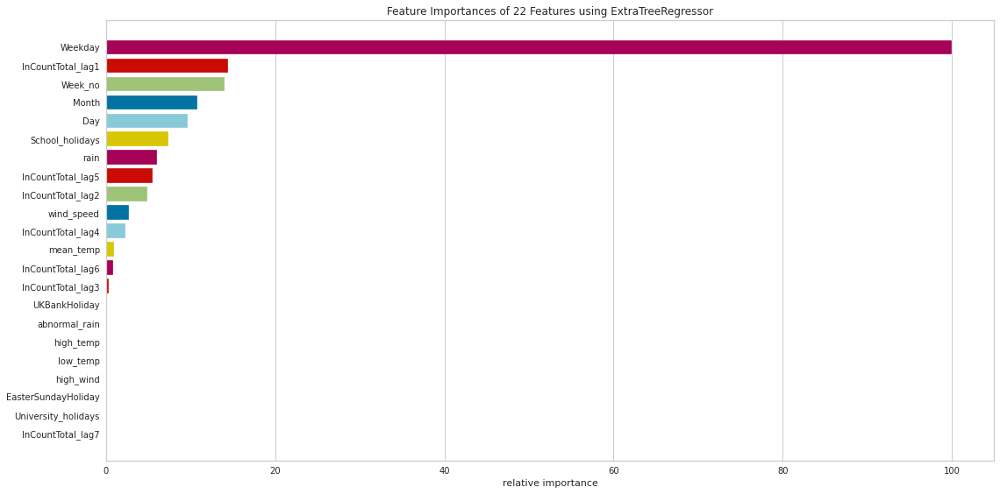

Cross CV validation...
svm_regressor
default model fitting...
Now tuning SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1, gamma='scale',
    kernel='rbf', max_iter=-1, shrinking=True, tol=0.001, verbose=False).
Cross CV validation...
adaBoost
default model fitting...
Now tuning AdaBoostRegressor(base_estimator=None, learning_rate=1.0, loss='linear',
                  n_estimators=200, random_state=None).


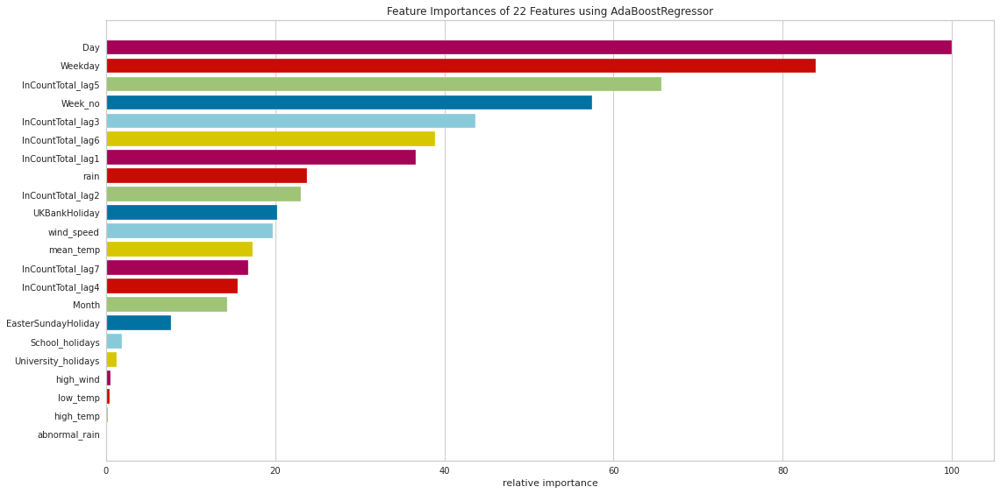

Cross CV validation...
bagging
default model fitting...
Now tuning BaggingRegressor(base_estimator=None, bootstrap=True, bootstrap_features=False,
                 max_features=1.0, max_samples=1.0, n_estimators=200,
                 n_jobs=None, oob_score=False, random_state=None, verbose=0,
                 warm_start=False).
Cross CV validation...
random_forest
default model fitting...
Now tuning RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=200, n_jobs=None, oob_score=False,
                      random_state=None, verbose=0, warm_start=False).


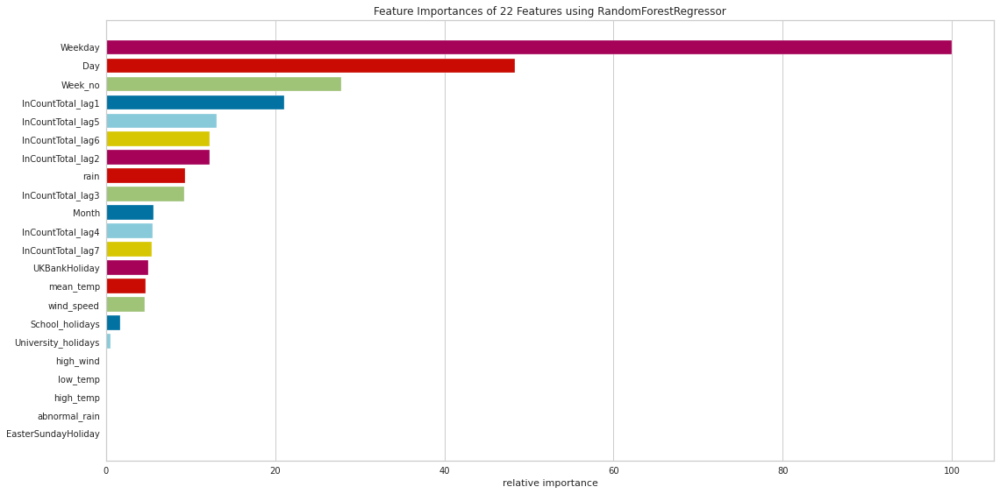

Cross CV validation...
extra_trees_regressor
default model fitting...
Now tuning ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=200, n_jobs=None, oob_score=False,
                    random_state=None, verbose=0, warm_start=False).


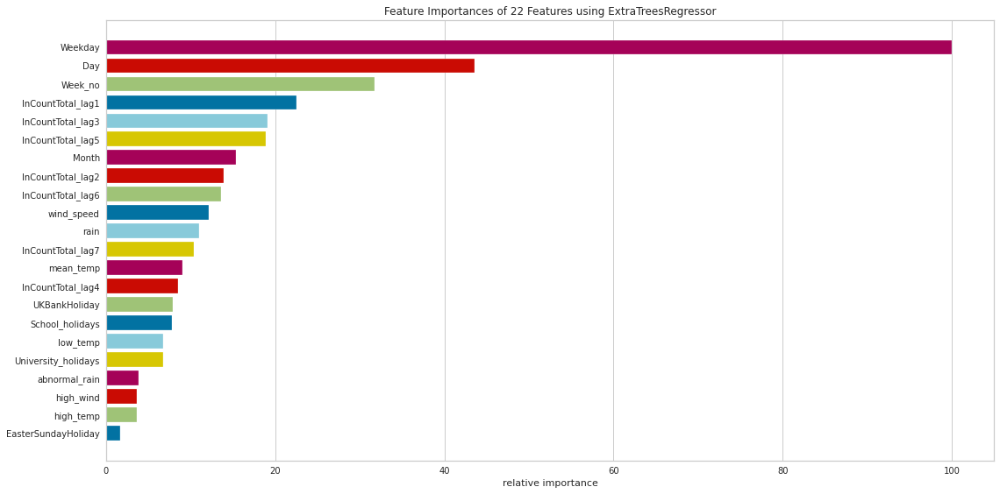

Cross CV validation...
gradient_boosting_regressor
default model fitting...
Now tuning GradientBoostingRegressor(alpha=0.9, ccp_alpha=0.0, criterion='friedman_mse',
                          init=None, learning_rate=0.1, loss='ls', max_depth=3,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=200,
                          n_iter_no_change=None, presort='deprecated',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False).


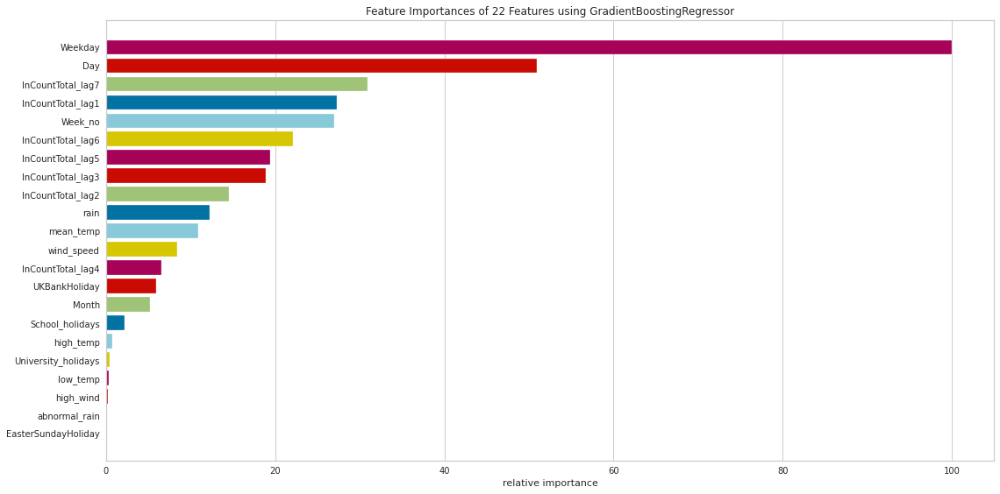

Cross CV validation...
XGBoost
default model fitting...
Now tuning XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0,
             importance_type='gain', learning_rate=0.1, max_delta_step=0,
             max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
             n_jobs=1, nthread=None, objective='reg:squarederror',
             random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
             seed=None, silent=None, subsample=1, verbosity=1).


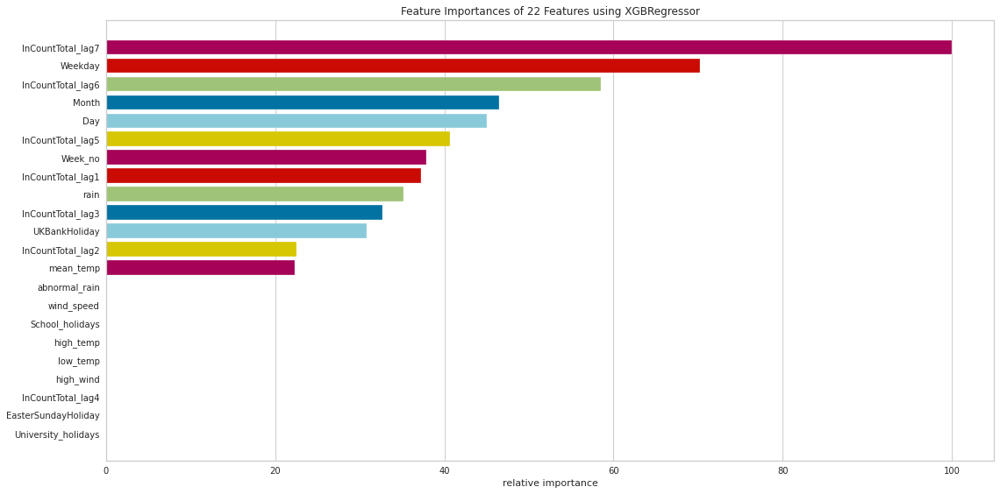

Cross CV validation...
LightGradientBoosting
default model fitting...
Now tuning LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
              importance_type='split', learning_rate=0.1, max_depth=-1,
              min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
              n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
              random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
              subsample=1.0, subsample_for_bin=200000, subsample_freq=0).
Cross CV validation...
CategoricalGradientBoosting
default model fitting...
Now tuning <catboost.core.CatBoostRegressor object at 0x7f621a928cc0>.
Cross CV validation...
NeuralNet_MLP
default model fitting...
Now tuning MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001,

In [ ]:
reg_models = regression_model(data_final_detrended,dataset_type='detrend')
regression_models,modelPredictions,cvPredictions, rscvPredictions, rfecvPredictions, loss_df_detrend = reg_models.train_and_evaluate_models(RFEcross_validation=False)
loss_values_all_models.append(loss_df_detrend)

In [ ]:
loss_df_detrend.sort_values('mape').head(25)

,Model_type,mape,mse,me,mae,mpe,rmse,R2 score,Adj R2 score,AIC,BIC
54,CategoricalGradientBoosting_detrend_default_model,21.457379,0.004542,0.002549,0.045715,0.121962,0.067392,0.496815,0.462060,-1879.821992,-1790.634069
39,random_forest_detrend_default_model,21.712014,0.004468,0.002848,0.045207,0.127209,0.066844,0.504957,0.470765,-1885.645936,-1796.458013
42,extra_trees_regressor_detrend_default_model,21.869475,0.004536,0.001159,0.044584,0.125946,0.067350,0.497441,0.462730,-1880.266618,-1791.078695
55,CategoricalGradientBoosting_detrend_rscv_model,21.996109,0.004640,0.002547,0.046437,0.125338,0.068121,0.485874,0.450363,-1872.142654,-1782.954731
46,gradient_boosting_regressor_detrend_rscv_model,22.069257,0.004558,0.000140,0.046746,0.120444,0.067516,0.494966,0.460084,-1878.513021,-1789.325098
36,bagging_detrend_default_model,22.210751,0.004600,0.003643,0.045458,0.133388,0.067822,0.490378,0.455178,-1875.283801,-1786.095878
51,LightGradientBoosting_detrend_default_model,23.165806,0.004891,0.000777,0.047814,0.128339,0.069933,0.458161,0.420736,-1853.399854,-1764.211931
40,random_forest_detrend_rscv_model,23.298646,0.004636,0.000934,0.045841,0.136995,0.068085,0.486410,0.450937,-1872.515353,-1783.327430
52,LightGradientBoosting_detrend_rscv_model,23.321796,0.004541,0.001635,0.046679,0.136005,0.067388,0.496870,0.462119,-1879.860799,-1790.672876
43,extra_trees_regressor_detrend_rscv_model,23.324899,0.004553,0.001030,0.044034,0.141469,0.067479,0.495517,0.460673,-1878.902180,-1789.714257


### 7.1.3 Model training with outlier removed data

Defined 20 models
linear_regression
default model fitting...
Now tuning LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False).


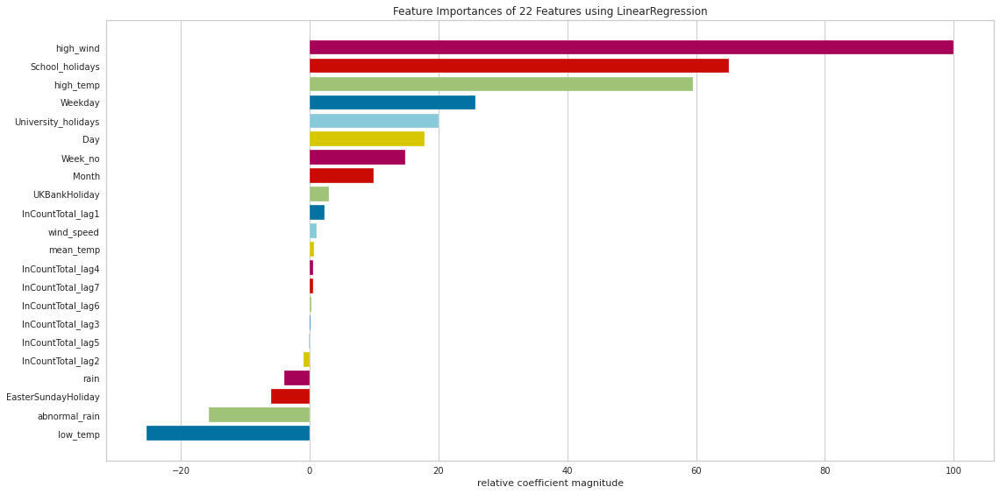

Cross CV validation...
lassoRegressor
default model fitting...
Now tuning Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
      normalize=False, positive=False, precompute=False, random_state=None,
      selection='cyclic', tol=0.0001, warm_start=False).


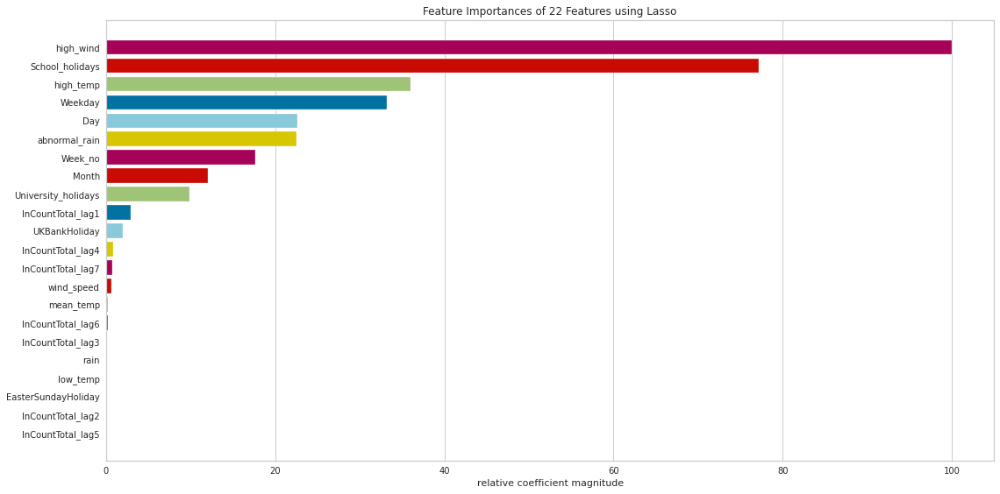

Cross CV validation...
ridgeRegressor
default model fitting...
Now tuning Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=None, solver='auto', tol=0.001).


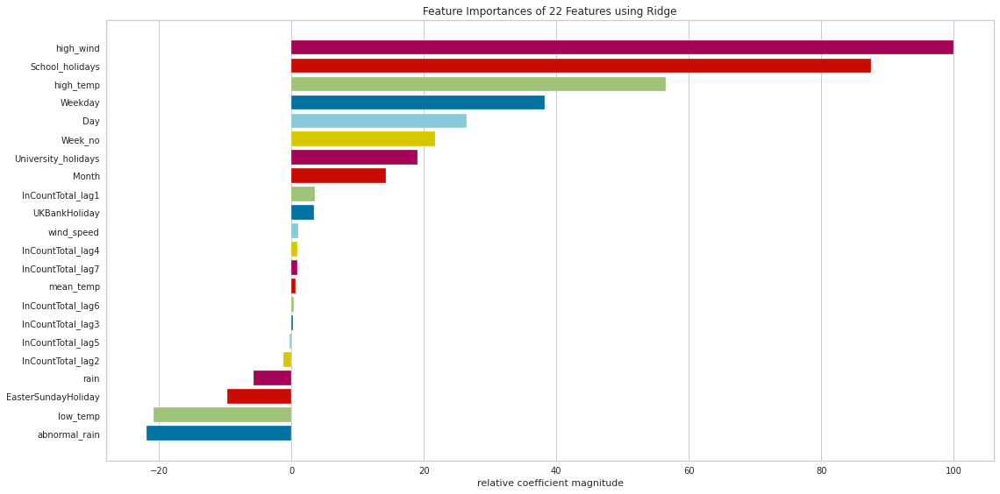

Cross CV validation...
elastic_net
default model fitting...
Now tuning ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='cyclic', tol=0.0001, warm_start=False).


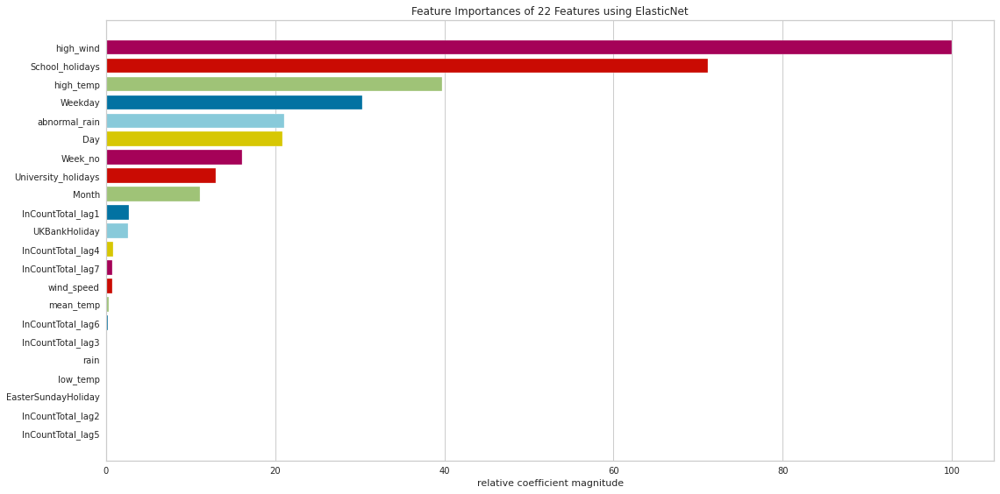

Cross CV validation...
huberRegressor
default model fitting...
Now tuning HuberRegressor(alpha=0.0001, epsilon=1.35, fit_intercept=True, max_iter=100,
               tol=1e-05, warm_start=False).


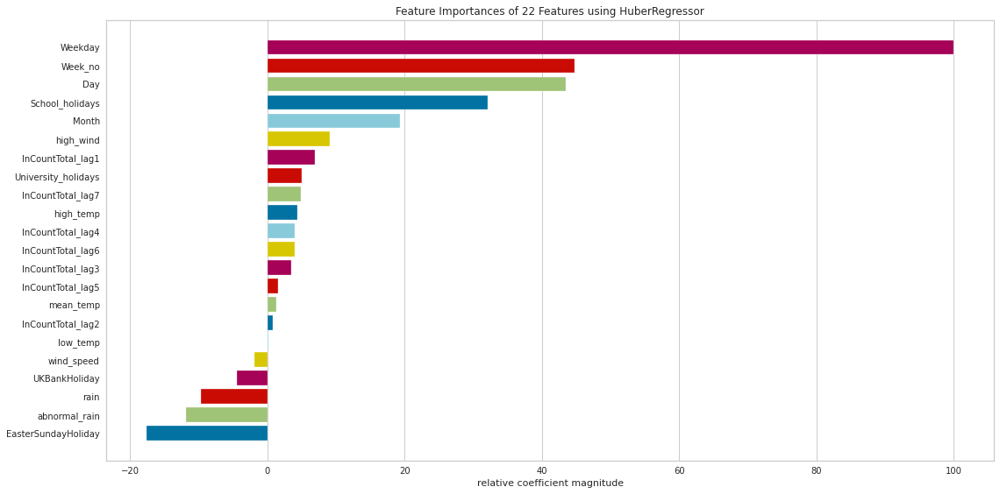

Cross CV validation...
passive_aggressor
default model fitting...
Now tuning PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=None, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False).


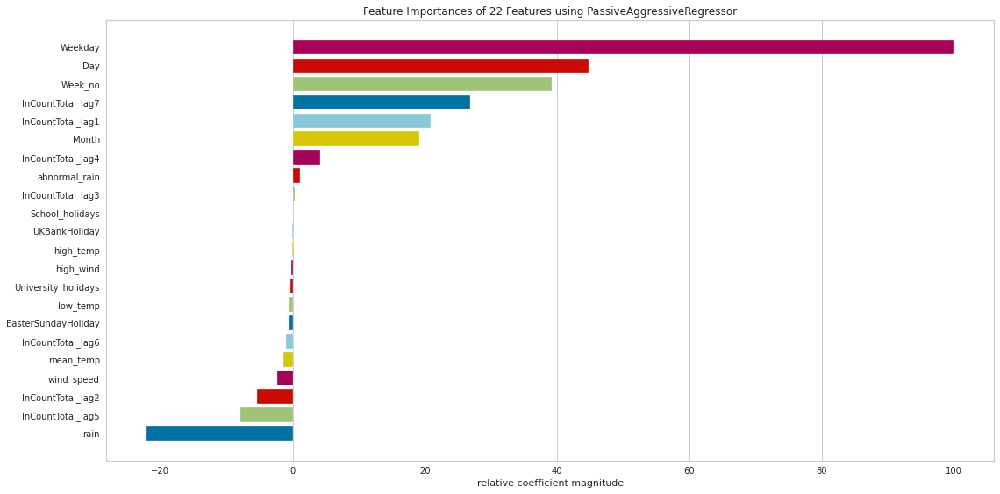

Cross CV validation...
sgd
default model fitting...
Now tuning SGDRegressor(alpha=0.0001, average=False, early_stopping=False, epsilon=0.1,
             eta0=0.01, fit_intercept=True, l1_ratio=0.15,
             learning_rate='invscaling', loss='squared_loss', max_iter=1000,
             n_iter_no_change=5, penalty='l2', power_t=0.25, random_state=None,
             shuffle=True, tol=0.001, validation_fraction=0.1, verbose=0,
             warm_start=False).


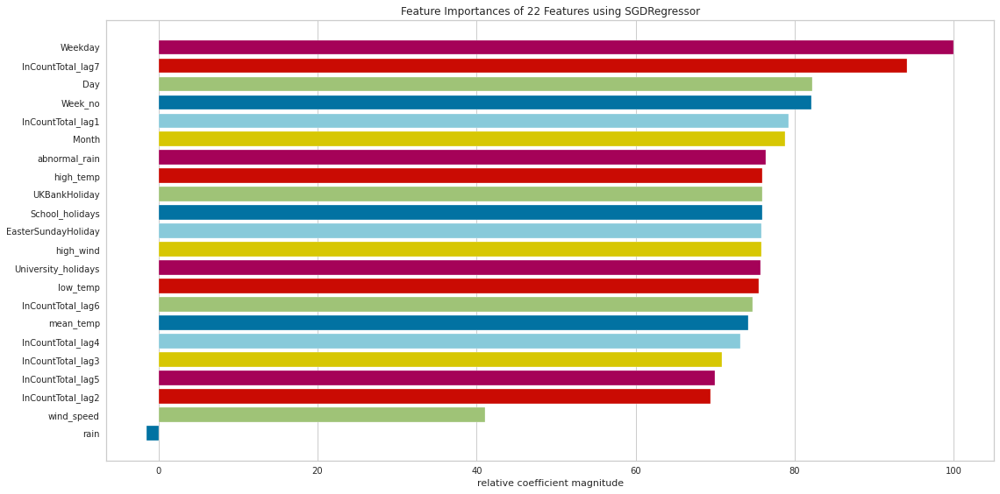

Cross CV validation...
knn_regressor
default model fitting...
Now tuning KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=None, n_neighbors=7, p=2,
                    weights='uniform').
Cross CV validation...
decisiontree_regressor
default model fitting...
Now tuning DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best').


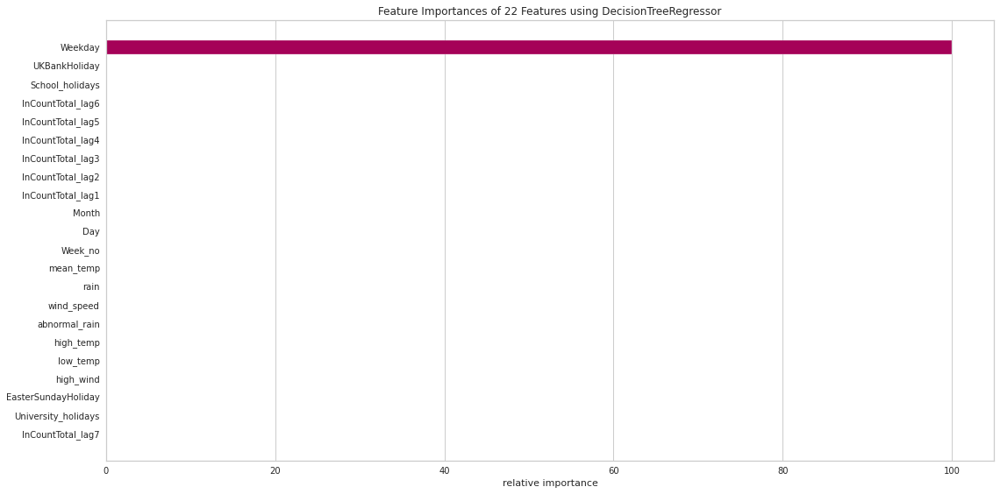

Cross CV validation...
extra_tree_regressor
default model fitting...
Now tuning ExtraTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                   max_features='auto', max_leaf_nodes=None,
                   min_impurity_decrease=0.0, min_impurity_split=None,
                   min_samples_leaf=1, min_samples_split=2,
                   min_weight_fraction_leaf=0.0, random_state=None,
                   splitter='random').


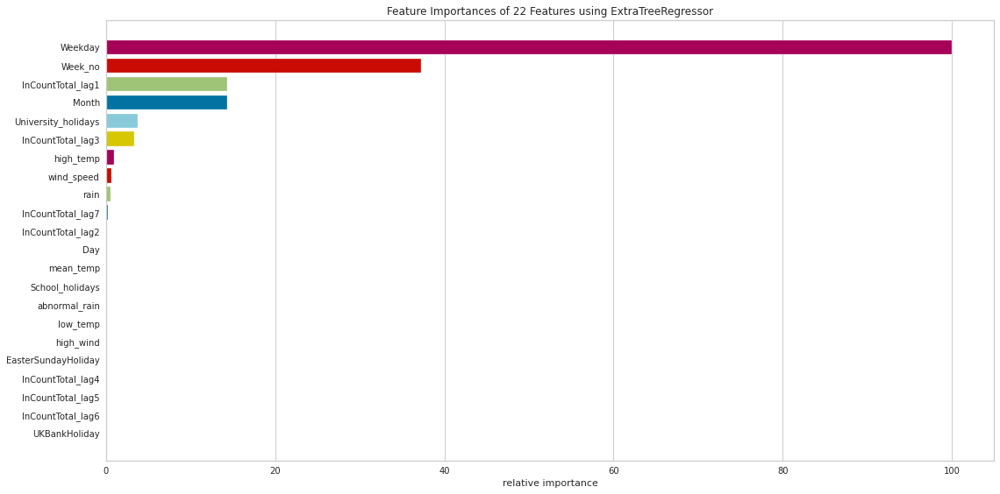

Cross CV validation...
svm_regressor
default model fitting...
Now tuning SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1, gamma='scale',
    kernel='rbf', max_iter=-1, shrinking=True, tol=0.001, verbose=False).
Cross CV validation...
adaBoost
default model fitting...
Now tuning AdaBoostRegressor(base_estimator=None, learning_rate=1.0, loss='linear',
                  n_estimators=200, random_state=None).


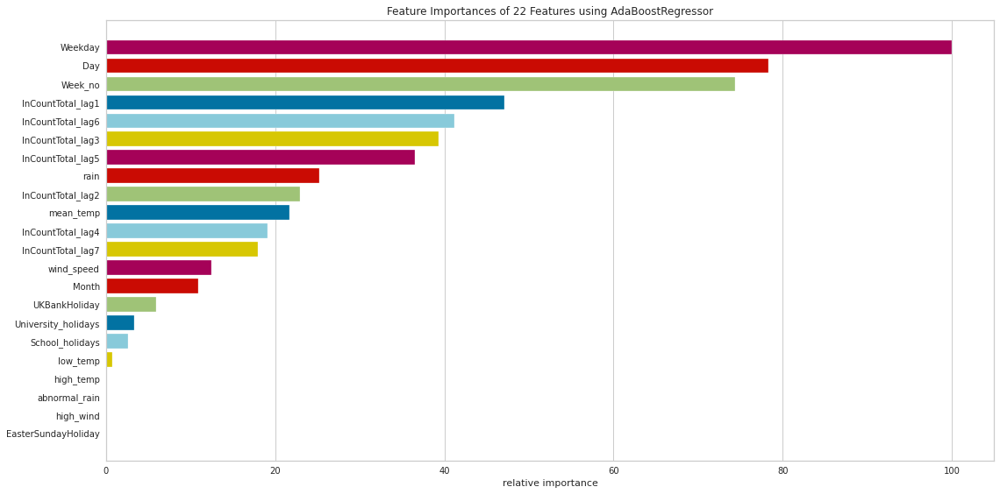

Cross CV validation...
bagging
default model fitting...
Now tuning BaggingRegressor(base_estimator=None, bootstrap=True, bootstrap_features=False,
                 max_features=1.0, max_samples=1.0, n_estimators=200,
                 n_jobs=None, oob_score=False, random_state=None, verbose=0,
                 warm_start=False).
Cross CV validation...
random_forest
default model fitting...
Now tuning RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=200, n_jobs=None, oob_score=False,
                      random_state=None, verbose=0, warm_start=False).


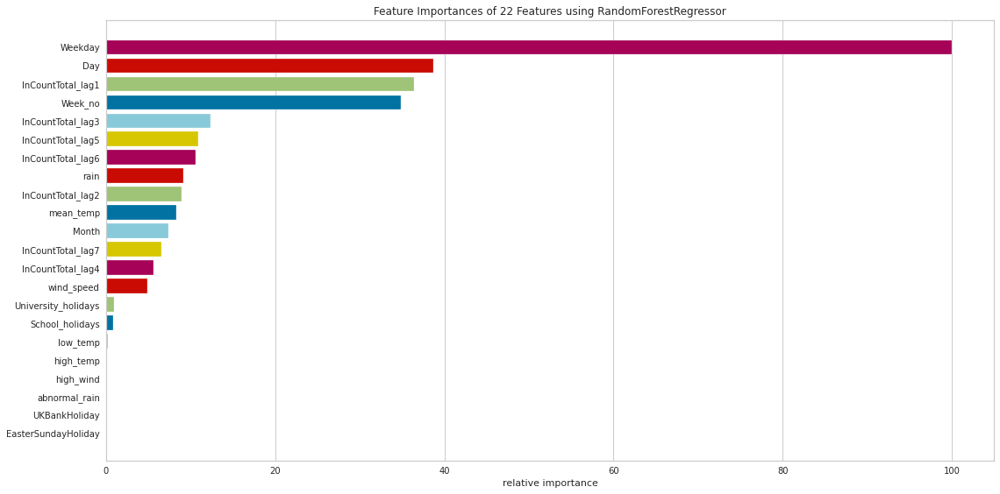

Cross CV validation...
extra_trees_regressor
default model fitting...
Now tuning ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=200, n_jobs=None, oob_score=False,
                    random_state=None, verbose=0, warm_start=False).


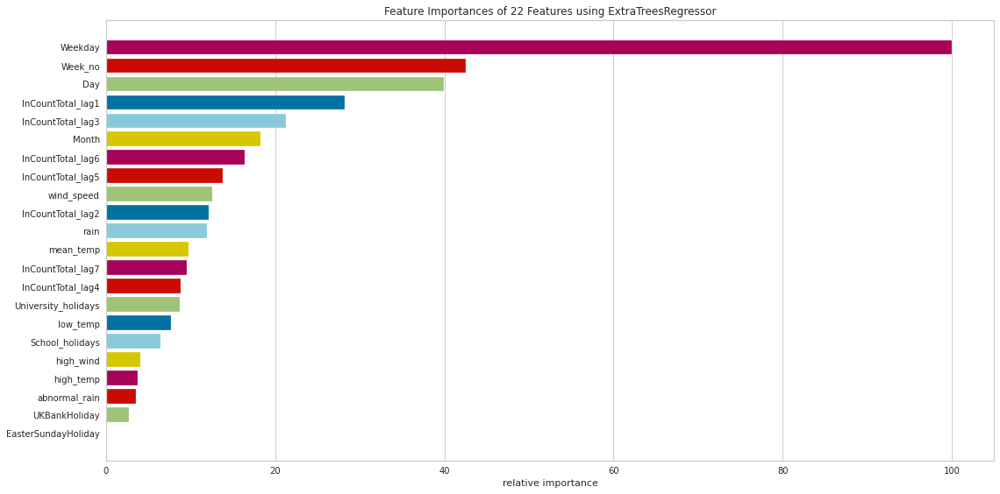

Cross CV validation...
gradient_boosting_regressor
default model fitting...
Now tuning GradientBoostingRegressor(alpha=0.9, ccp_alpha=0.0, criterion='friedman_mse',
                          init=None, learning_rate=0.1, loss='ls', max_depth=3,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=200,
                          n_iter_no_change=None, presort='deprecated',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False).


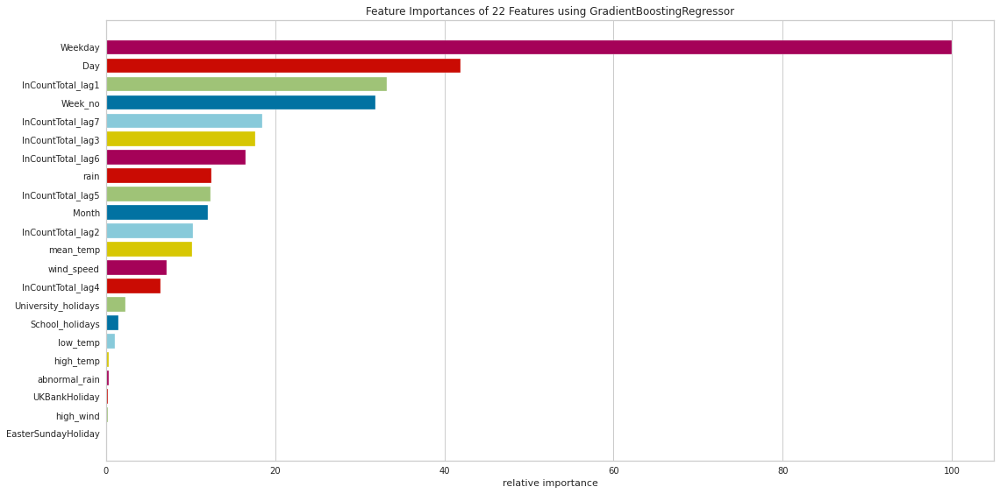

Cross CV validation...
XGBoost
default model fitting...
Now tuning XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0,
             importance_type='gain', learning_rate=0.1, max_delta_step=0,
             max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
             n_jobs=1, nthread=None, objective='reg:squarederror',
             random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
             seed=None, silent=None, subsample=1, verbosity=1).


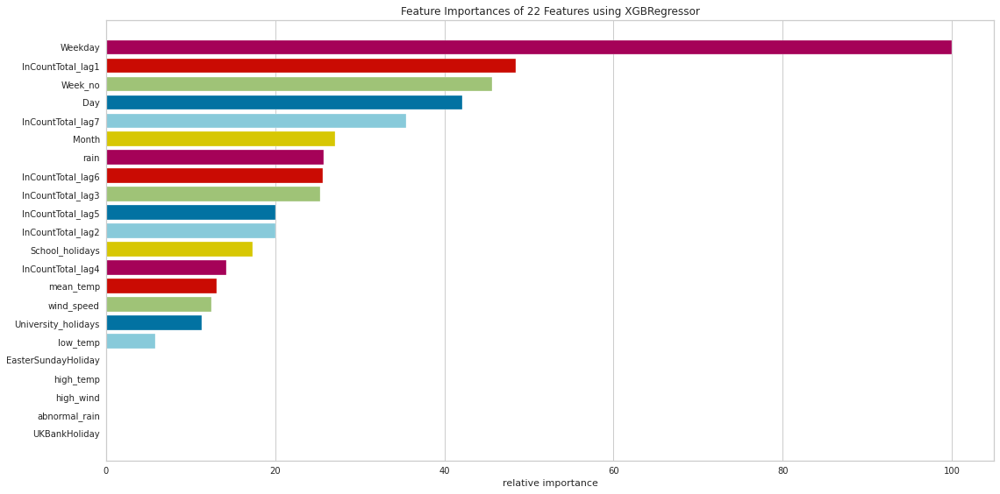

Cross CV validation...
LightGradientBoosting
default model fitting...
Now tuning LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
              importance_type='split', learning_rate=0.1, max_depth=-1,
              min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
              n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
              random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
              subsample=1.0, subsample_for_bin=200000, subsample_freq=0).
Cross CV validation...
CategoricalGradientBoosting
default model fitting...
Now tuning <catboost.core.CatBoostRegressor object at 0x7f621ae56b70>.
Cross CV validation...
NeuralNet_MLP
default model fitting...
Now tuning MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001,

In [ ]:
reg_models = regression_model(data_outliersremoved,dataset_type='Outliers_Removed')
_,_,_, _,_,loss_df_outlier_removed = reg_models.train_and_evaluate_models(RFEcross_validation=False)
loss_values_all_models.append(loss_df_outlier_removed)

In [ ]:
loss_df_outlier_removed.sort_values('mape').head(25)

,Model_type,mape,mse,me,mae,mpe,rmse,R2 score,Adj R2 score,AIC,BIC
36,bagging_Outliers_Removed_default_model,11.848841,0.004226,-0.013662,0.044947,-0.010737,0.065008,0.469750,0.433126,-1905.531793,-1816.343870
39,random_forest_Outliers_Removed_default_model,11.914107,0.004233,-0.013702,0.045073,-0.010174,0.065059,0.468929,0.432248,-1904.979633,-1815.791710
54,CategoricalGradientBoosting_Outliers_Removed_d...,11.991476,0.004348,-0.012474,0.045386,-0.007304,0.065937,0.454493,0.416815,-1895.404784,-1806.216861
45,gradient_boosting_regressor_Outliers_Removed_d...,12.200679,0.004716,-0.017607,0.047294,-0.021928,0.068674,0.408271,0.367401,-1866.369071,-1777.181148
40,random_forest_Outliers_Removed_rscv_model,12.246133,0.004436,-0.014421,0.046272,-0.010279,0.066600,0.443471,0.405032,-1888.263732,-1799.075809
52,LightGradientBoosting_Outliers_Removed_rscv_model,12.250636,0.004421,-0.016398,0.046592,-0.017115,0.066490,0.445303,0.406991,-1889.440826,-1800.252903
43,extra_trees_regressor_Outliers_Removed_rscv_model,12.401251,0.004387,-0.015785,0.047088,-0.016281,0.066232,0.449598,0.411583,-1892.216093,-1803.028170
42,extra_trees_regressor_Outliers_Removed_default...,12.447798,0.004447,-0.015137,0.047098,-0.014163,0.066684,0.442069,0.403533,-1887.365394,-1798.177471
48,XGBoost_Outliers_Removed_default_model,12.577377,0.004815,-0.017862,0.048142,-0.018978,0.069387,0.395919,0.354196,-1858.993631,-1769.805708
55,CategoricalGradientBoosting_Outliers_Removed_r...,12.691450,0.004432,-0.013857,0.047479,-0.008073,0.066570,0.443965,0.405561,-1888.580893,-1799.392970


Defined 20 models
linear_regression
default model fitting...
Now tuning LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False).


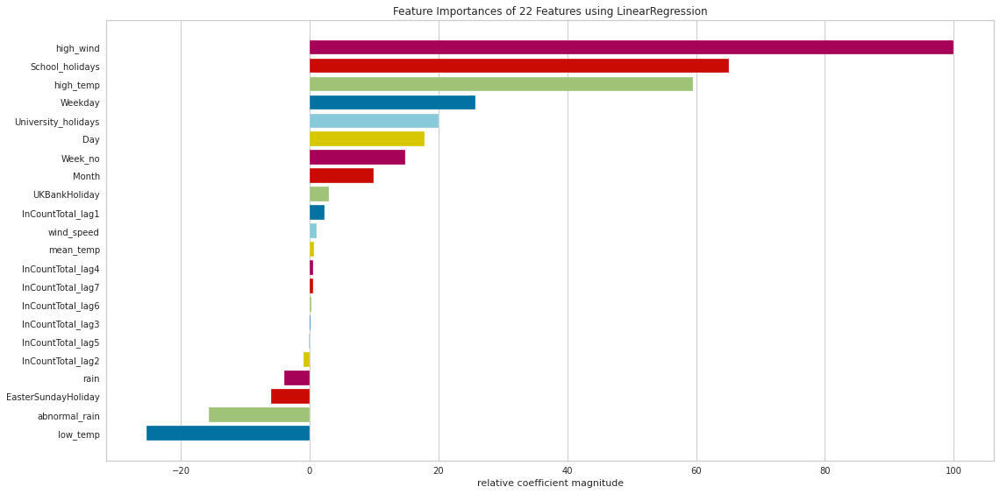

Cross CV validation...
lassoRegressor
default model fitting...
Now tuning Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
      normalize=False, positive=False, precompute=False, random_state=None,
      selection='cyclic', tol=0.0001, warm_start=False).


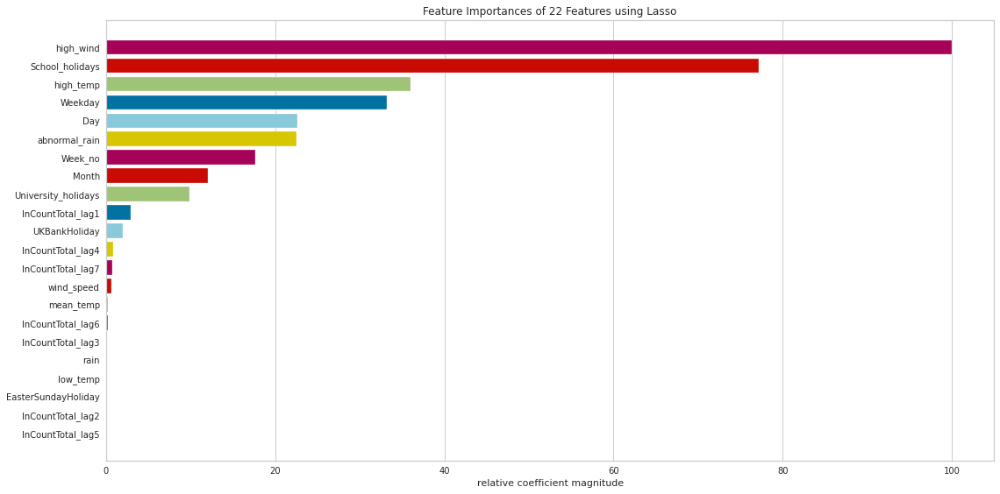

Cross CV validation...
ridgeRegressor
default model fitting...
Now tuning Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=None, solver='auto', tol=0.001).


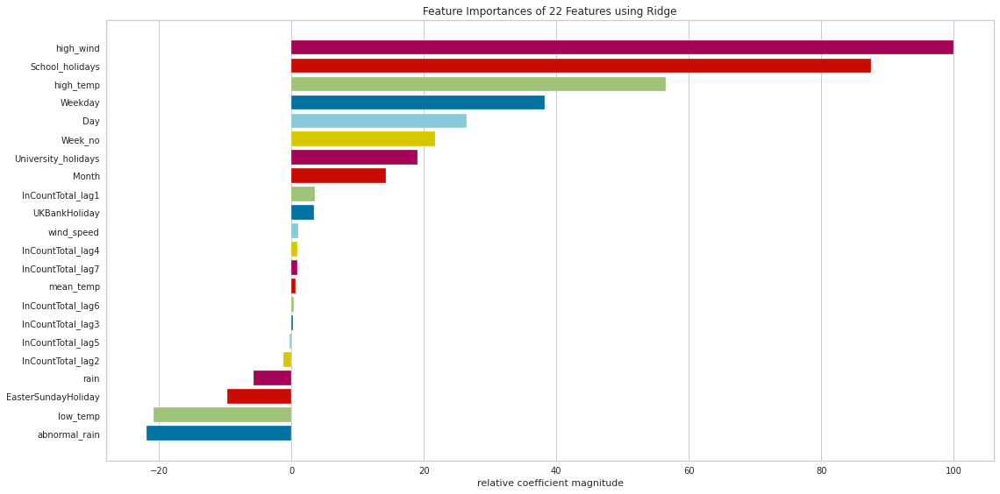

Cross CV validation...
elastic_net
default model fitting...
Now tuning ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='cyclic', tol=0.0001, warm_start=False).


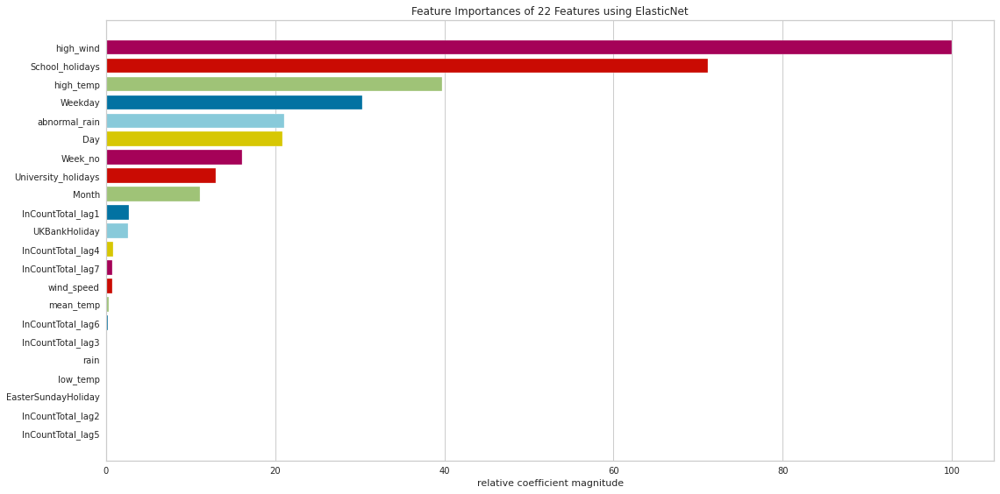

Cross CV validation...
huberRegressor
default model fitting...
Now tuning HuberRegressor(alpha=0.0001, epsilon=1.35, fit_intercept=True, max_iter=100,
               tol=1e-05, warm_start=False).


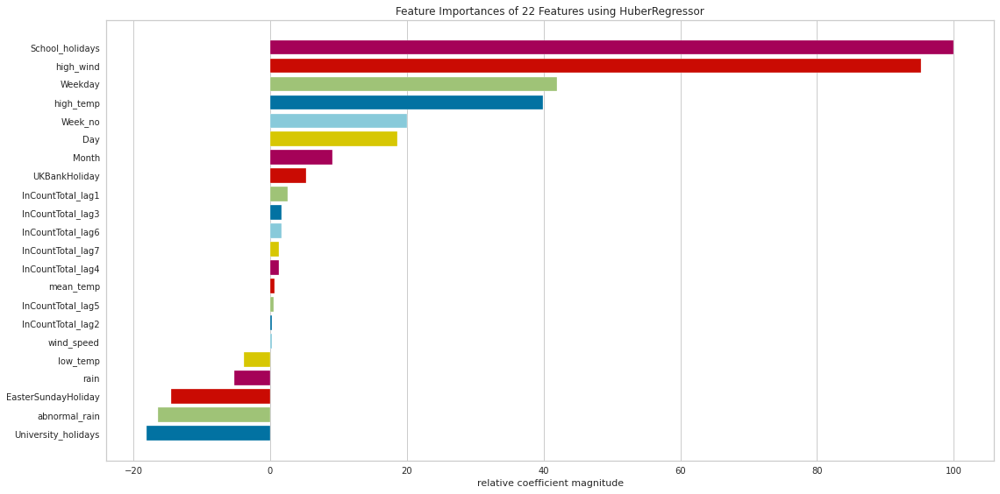

Cross CV validation...
passive_aggressor
default model fitting...
Now tuning PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=None, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False).


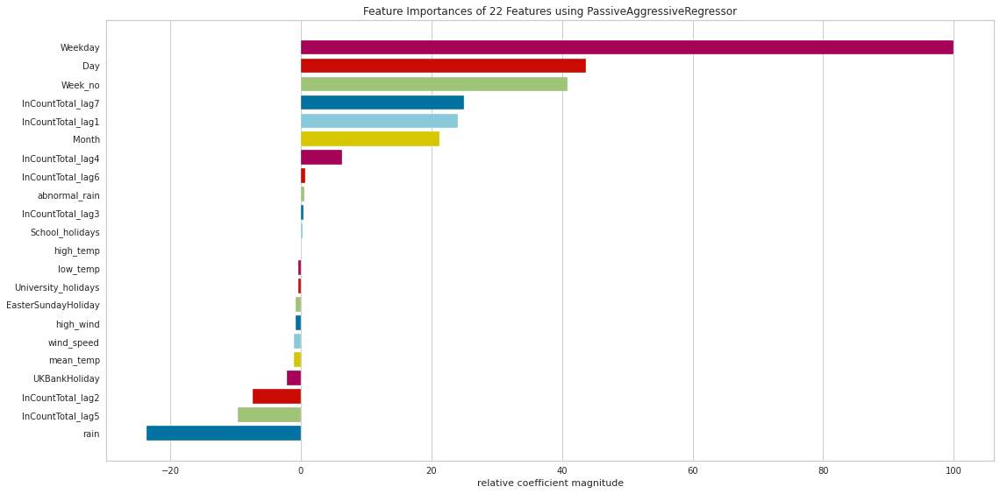

Cross CV validation...
sgd
default model fitting...
Now tuning SGDRegressor(alpha=0.0001, average=False, early_stopping=False, epsilon=0.1,
             eta0=0.01, fit_intercept=True, l1_ratio=0.15,
             learning_rate='invscaling', loss='squared_loss', max_iter=1000,
             n_iter_no_change=5, penalty='l2', power_t=0.25, random_state=None,
             shuffle=True, tol=0.001, validation_fraction=0.1, verbose=0,
             warm_start=False).


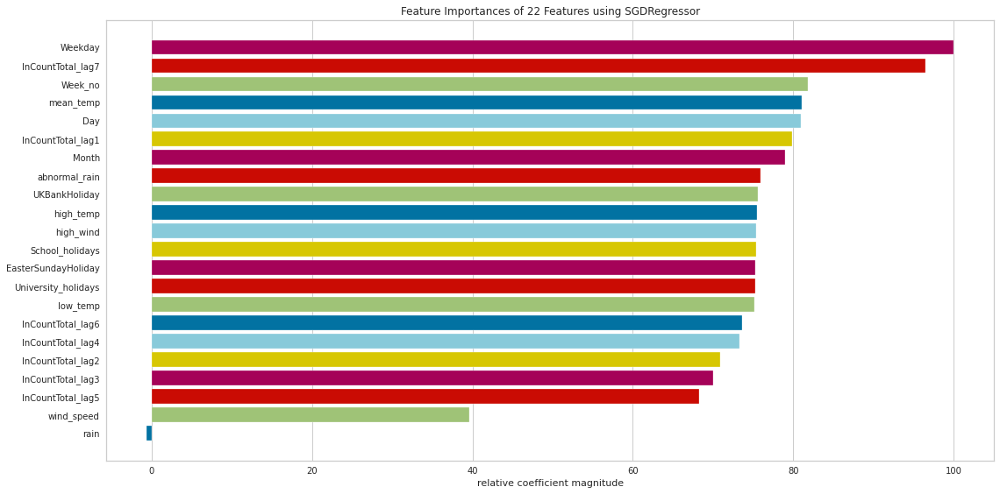

Cross CV validation...
knn_regressor
default model fitting...
Now tuning KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=None, n_neighbors=7, p=2,
                    weights='uniform').
Cross CV validation...
decisiontree_regressor
default model fitting...
Now tuning DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best').


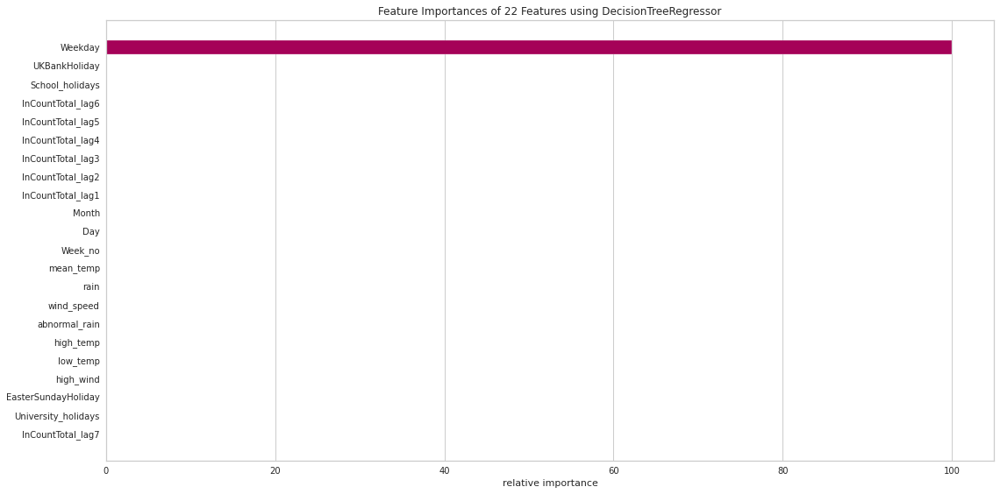

Cross CV validation...
extra_tree_regressor
default model fitting...
Now tuning ExtraTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                   max_features='auto', max_leaf_nodes=None,
                   min_impurity_decrease=0.0, min_impurity_split=None,
                   min_samples_leaf=1, min_samples_split=2,
                   min_weight_fraction_leaf=0.0, random_state=None,
                   splitter='random').


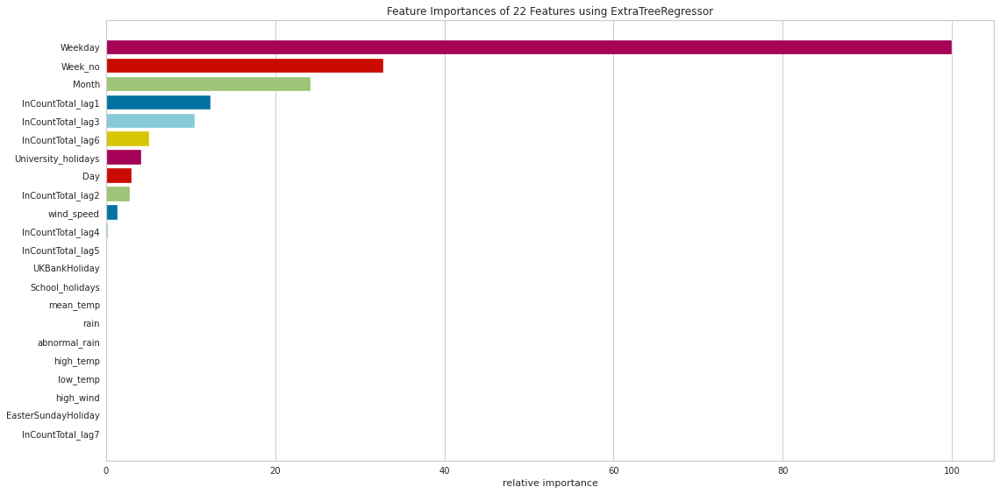

Cross CV validation...
svm_regressor
default model fitting...
Now tuning SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1, gamma='scale',
    kernel='rbf', max_iter=-1, shrinking=True, tol=0.001, verbose=False).
Cross CV validation...
adaBoost
default model fitting...
Now tuning AdaBoostRegressor(base_estimator=None, learning_rate=1.0, loss='linear',
                  n_estimators=200, random_state=None).


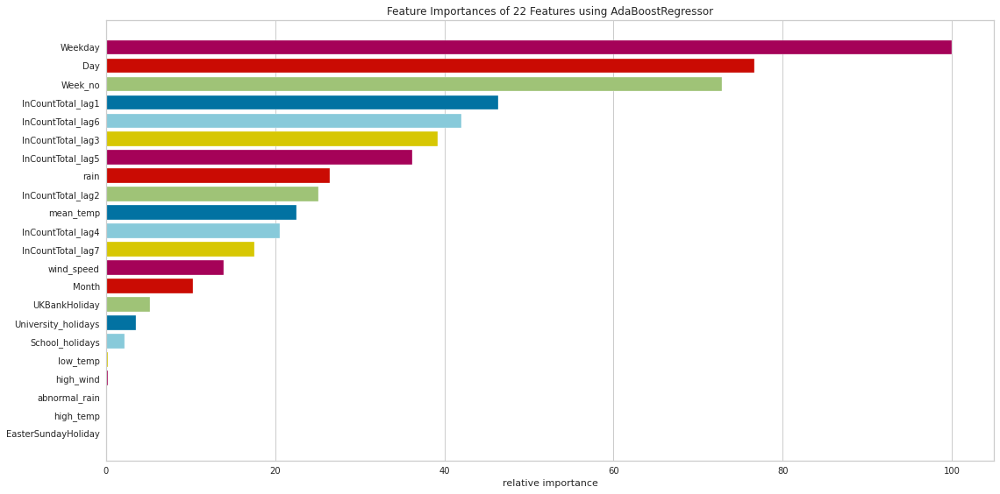

Cross CV validation...
bagging
default model fitting...
Now tuning BaggingRegressor(base_estimator=None, bootstrap=True, bootstrap_features=False,
                 max_features=1.0, max_samples=1.0, n_estimators=200,
                 n_jobs=None, oob_score=False, random_state=None, verbose=0,
                 warm_start=False).
Cross CV validation...
random_forest
default model fitting...
Now tuning RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=200, n_jobs=None, oob_score=False,
                      random_state=None, verbose=0, warm_start=False).


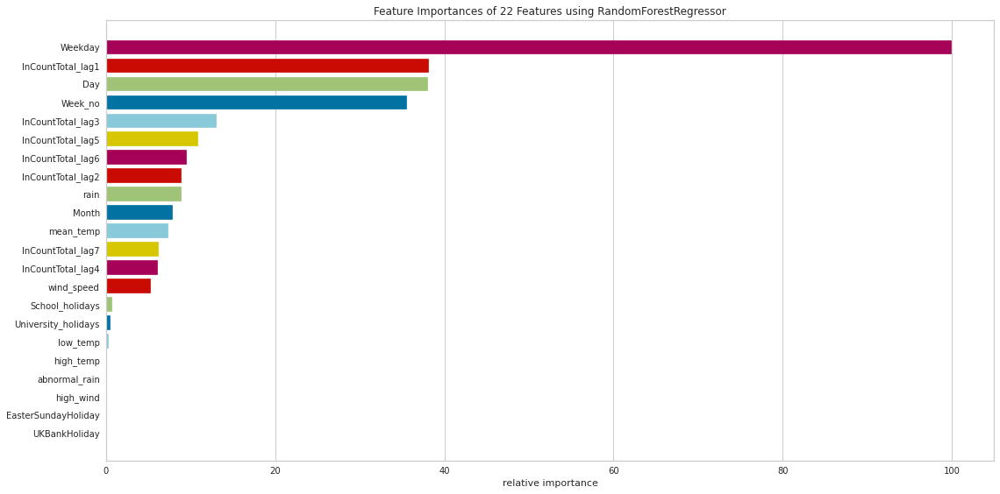

Cross CV validation...
extra_trees_regressor
default model fitting...
Now tuning ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=200, n_jobs=None, oob_score=False,
                    random_state=None, verbose=0, warm_start=False).


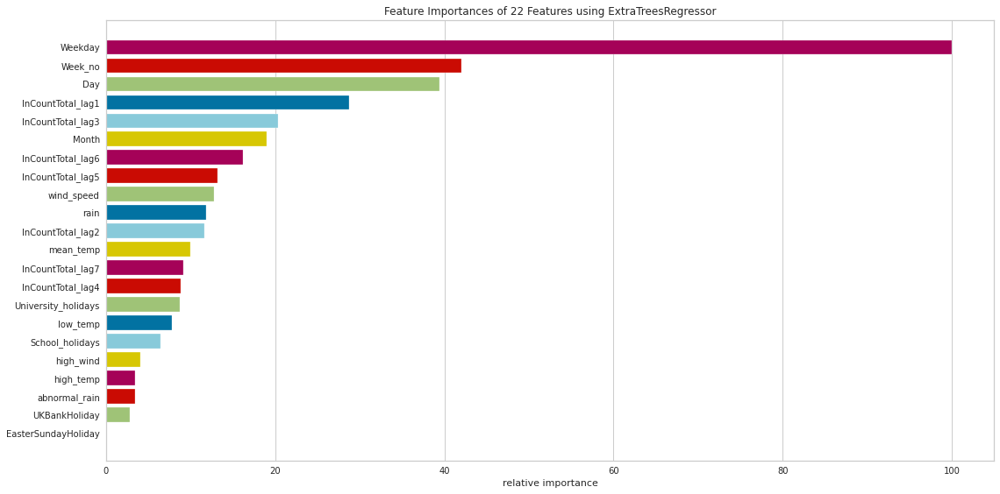

Cross CV validation...
gradient_boosting_regressor
default model fitting...
Now tuning GradientBoostingRegressor(alpha=0.9, ccp_alpha=0.0, criterion='friedman_mse',
                          init=None, learning_rate=0.1, loss='ls', max_depth=3,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=200,
                          n_iter_no_change=None, presort='deprecated',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False).


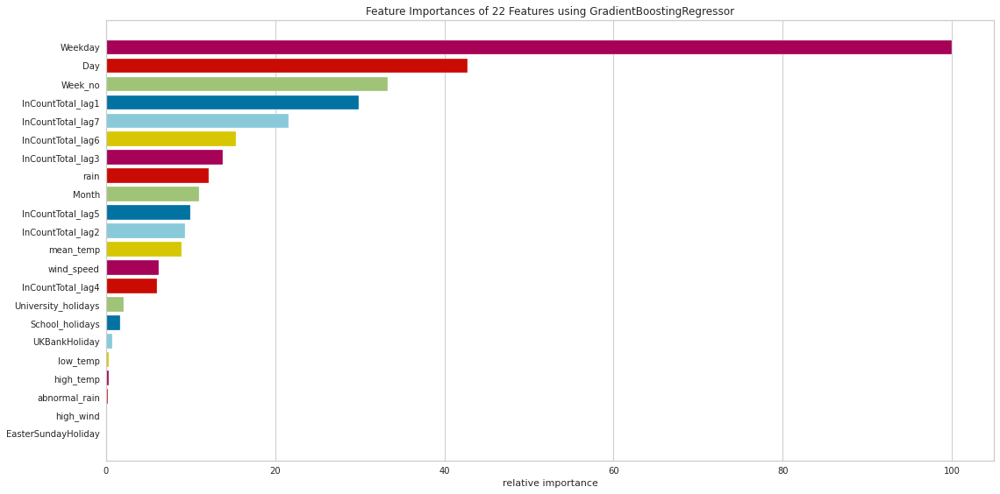

Cross CV validation...
XGBoost
default model fitting...
Now tuning XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0,
             importance_type='gain', learning_rate=0.1, max_delta_step=0,
             max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
             n_jobs=1, nthread=None, objective='reg:squarederror',
             random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
             seed=None, silent=None, subsample=1, verbosity=1).


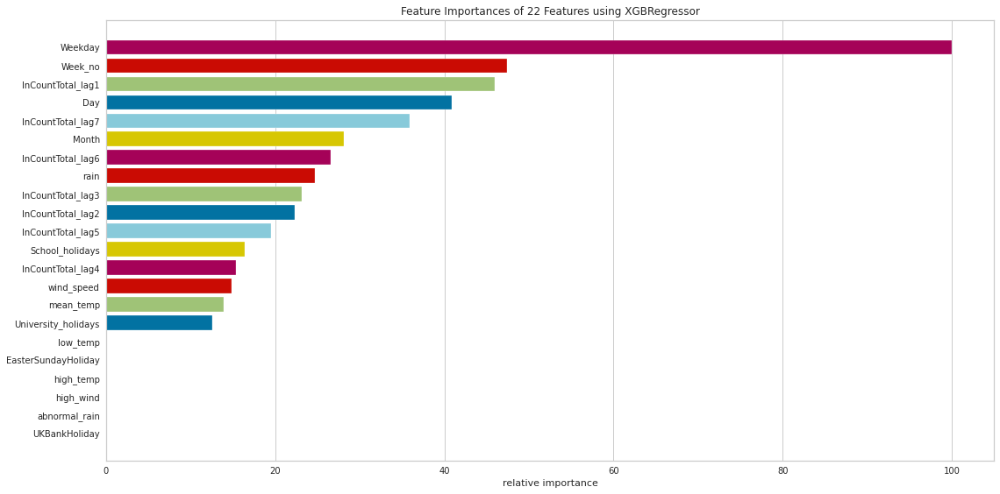

Cross CV validation...
LightGradientBoosting
default model fitting...
Now tuning LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
              importance_type='split', learning_rate=0.1, max_depth=-1,
              min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
              n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
              random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
              subsample=1.0, subsample_for_bin=200000, subsample_freq=0).
Cross CV validation...
CategoricalGradientBoosting
default model fitting...
Now tuning <catboost.core.CatBoostRegressor object at 0x7f6221c494e0>.
Cross CV validation...
NeuralNet_MLP
default model fitting...
Now tuning MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001,

In [ ]:
reg_models = regression_model(data_outliersremoved,dataset_type='Outliers_Removed_shuffled')
_,_,_, _,_,loss_df_outlier_removed = reg_models.train_and_evaluate_models(RFEcross_validation=False, shuffle=True)
loss_values_all_models.append(loss_df_outlier_removed)

In [ ]:
loss_df_outlier_removed.sort_values('mape').head(25)

,Model_type,mape,mse,me,mae,mpe,rmse,R2 score,Adj R2 score,AIC,BIC
36,bagging_Outliers_Removed_shuffled_default_model,11.830063,0.004170,-0.012911,0.044775,-0.008453,0.064574,0.476813,0.440677,-1910.319207,-1821.131284
39,random_forest_Outliers_Removed_shuffled_defaul...,11.919705,0.004280,-0.013415,0.045139,-0.009311,0.065419,0.463036,0.425948,-1901.040112,-1811.852189
40,random_forest_Outliers_Removed_shuffled_rscv_m...,12.206357,0.004391,-0.014796,0.046110,-0.011349,0.066261,0.449112,0.411063,-1891.900879,-1802.712956
45,gradient_boosting_regressor_Outliers_Removed_s...,12.226600,0.004668,-0.017608,0.047306,-0.021741,0.068326,0.414245,0.373788,-1869.991776,-1780.803853
52,LightGradientBoosting_Outliers_Removed_shuffle...,12.250636,0.004421,-0.016398,0.046592,-0.017115,0.066490,0.445303,0.406991,-1889.440826,-1800.252903
54,CategoricalGradientBoosting_Outliers_Removed_s...,12.358471,0.004391,-0.013838,0.046761,-0.010404,0.066263,0.449089,0.411038,-1891.885690,-1802.697767
55,CategoricalGradientBoosting_Outliers_Removed_s...,12.382344,0.004613,-0.016361,0.047490,-0.016135,0.067916,0.421260,0.381287,-1874.292851,-1785.104928
42,extra_trees_regressor_Outliers_Removed_shuffle...,12.439136,0.004390,-0.014971,0.047177,-0.014015,0.066254,0.449243,0.411203,-1891.985750,-1802.797827
43,extra_trees_regressor_Outliers_Removed_shuffle...,12.506122,0.004521,-0.015130,0.047404,-0.013946,0.067240,0.432722,0.393540,-1881.433938,-1792.246015
46,gradient_boosting_regressor_Outliers_Removed_s...,12.552768,0.004658,-0.017173,0.048187,-0.017462,0.068247,0.415601,0.375238,-1870.819267,-1781.631344


### 7.1.4 Model training with extra features

Defined 20 models
linear_regression
default model fitting...
Now tuning LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False).


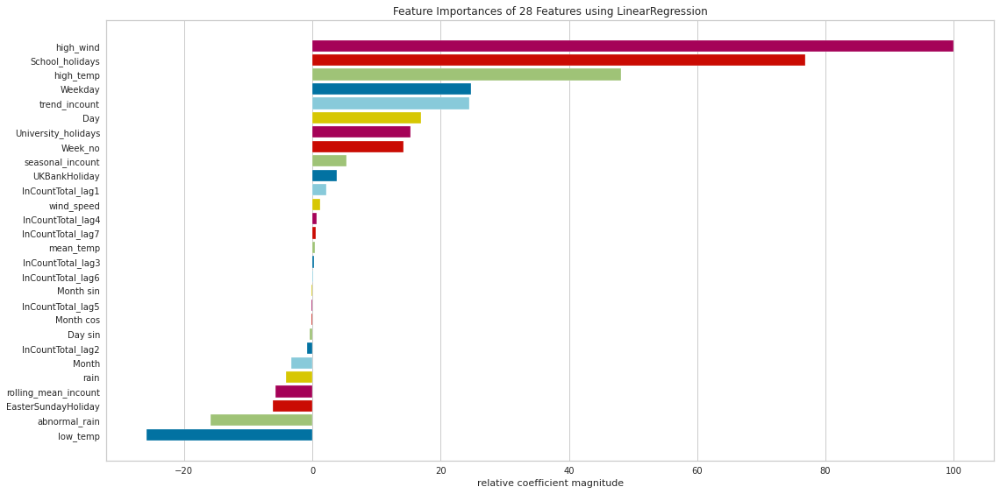

Cross CV validation...
lassoRegressor
default model fitting...
Now tuning Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
      normalize=False, positive=False, precompute=False, random_state=None,
      selection='cyclic', tol=0.0001, warm_start=False).


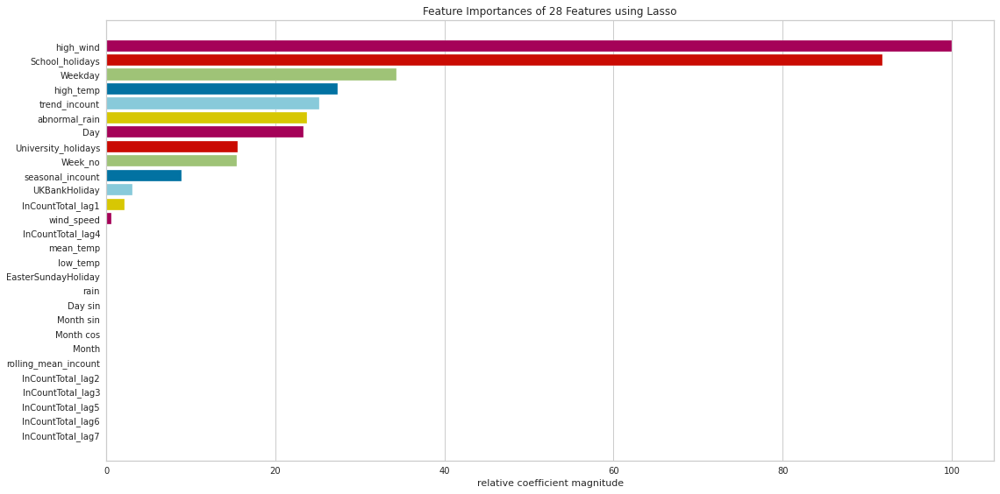

Cross CV validation...
ridgeRegressor
default model fitting...
Now tuning Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=None, solver='auto', tol=0.001).


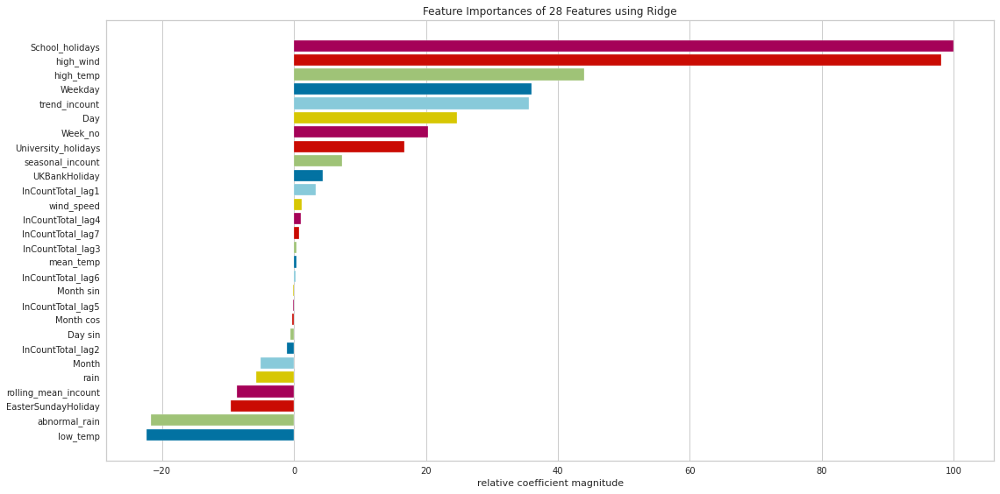

Cross CV validation...
elastic_net
default model fitting...
Now tuning ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='cyclic', tol=0.0001, warm_start=False).


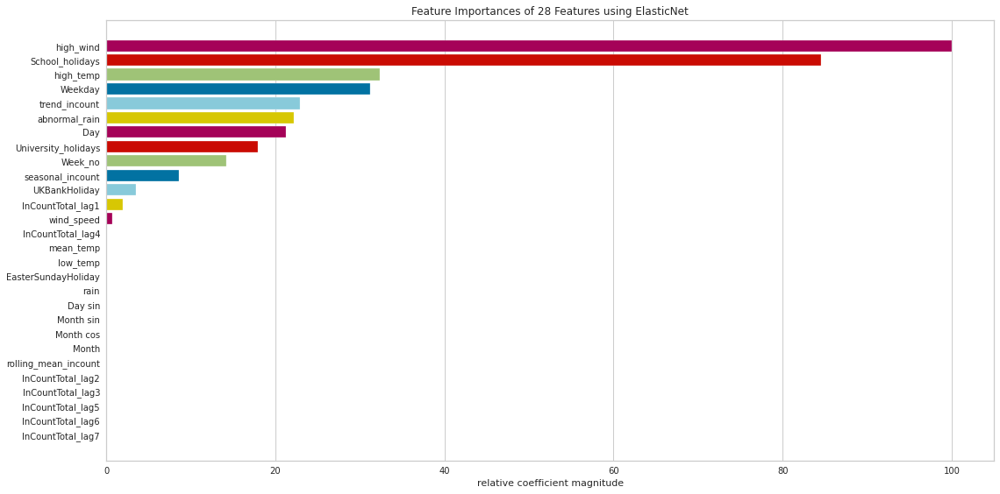

Cross CV validation...
huberRegressor
default model fitting...
Now tuning HuberRegressor(alpha=0.0001, epsilon=1.35, fit_intercept=True, max_iter=100,
               tol=1e-05, warm_start=False).


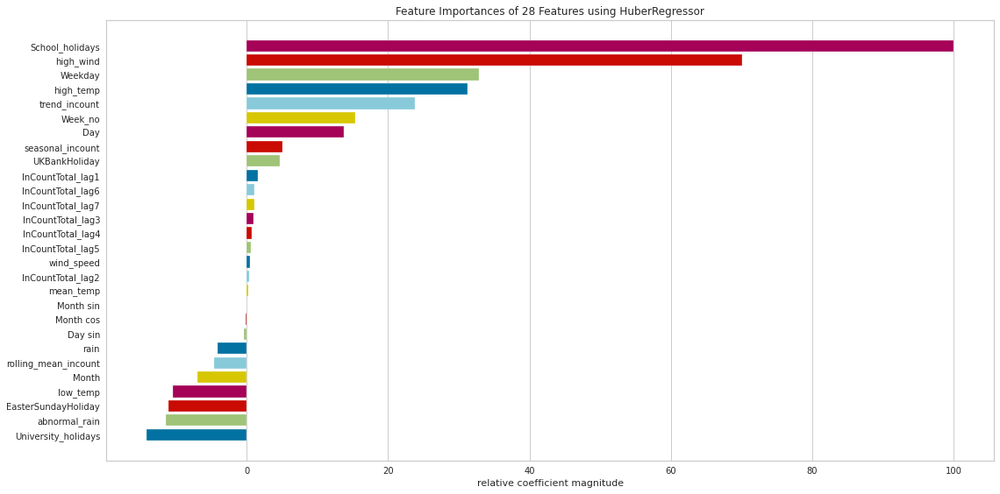

Cross CV validation...
passive_aggressor
default model fitting...
Now tuning PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=None, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False).


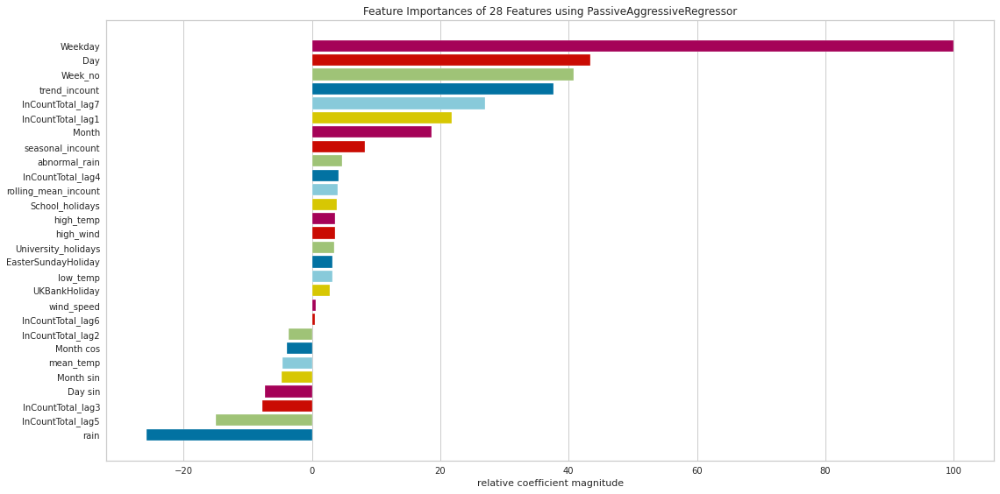

Cross CV validation...
sgd
default model fitting...
Now tuning SGDRegressor(alpha=0.0001, average=False, early_stopping=False, epsilon=0.1,
             eta0=0.01, fit_intercept=True, l1_ratio=0.15,
             learning_rate='invscaling', loss='squared_loss', max_iter=1000,
             n_iter_no_change=5, penalty='l2', power_t=0.25, random_state=None,
             shuffle=True, tol=0.001, validation_fraction=0.1, verbose=0,
             warm_start=False).


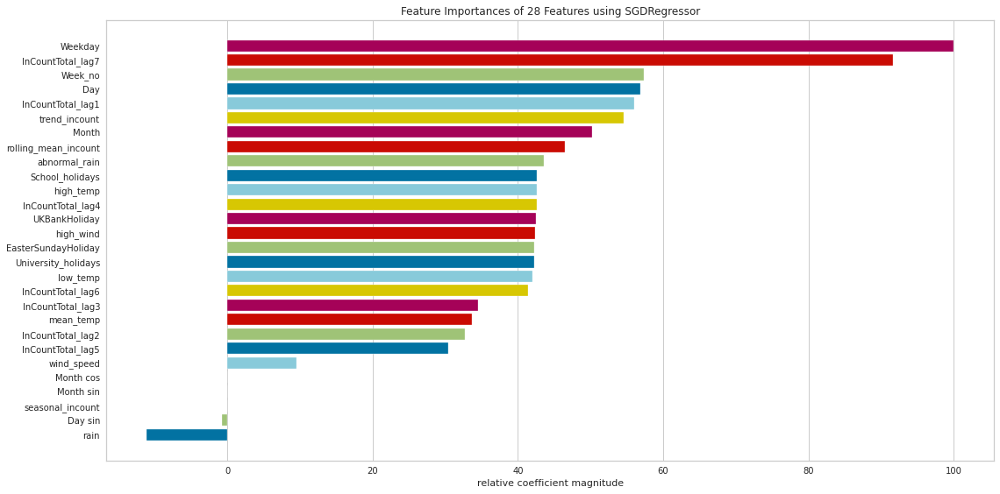

Cross CV validation...
knn_regressor
default model fitting...
Now tuning KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=None, n_neighbors=7, p=2,
                    weights='uniform').
Cross CV validation...
decisiontree_regressor
default model fitting...
Now tuning DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best').


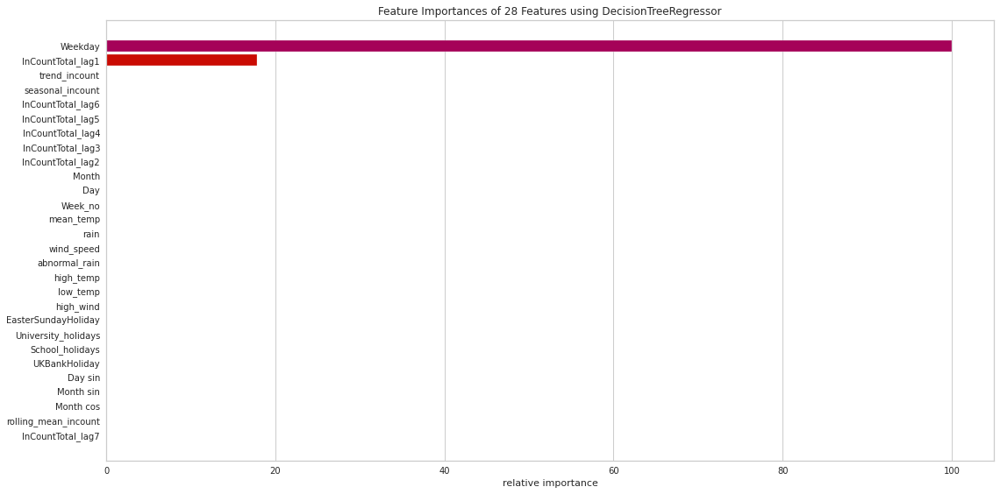

Cross CV validation...
extra_tree_regressor
default model fitting...
Now tuning ExtraTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                   max_features='auto', max_leaf_nodes=None,
                   min_impurity_decrease=0.0, min_impurity_split=None,
                   min_samples_leaf=1, min_samples_split=2,
                   min_weight_fraction_leaf=0.0, random_state=None,
                   splitter='random').


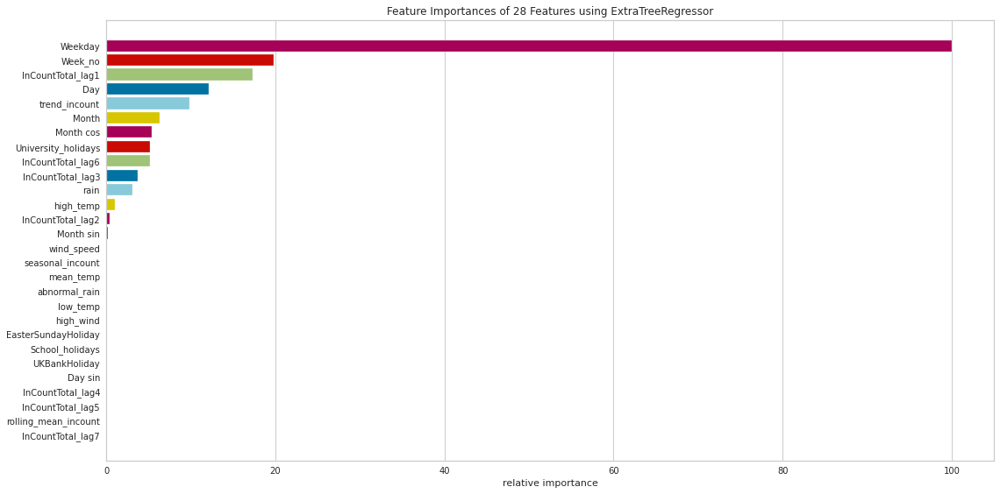

Cross CV validation...
svm_regressor
default model fitting...
Now tuning SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1, gamma='scale',
    kernel='rbf', max_iter=-1, shrinking=True, tol=0.001, verbose=False).
Cross CV validation...
adaBoost
default model fitting...
Now tuning AdaBoostRegressor(base_estimator=None, learning_rate=1.0, loss='linear',
                  n_estimators=200, random_state=None).


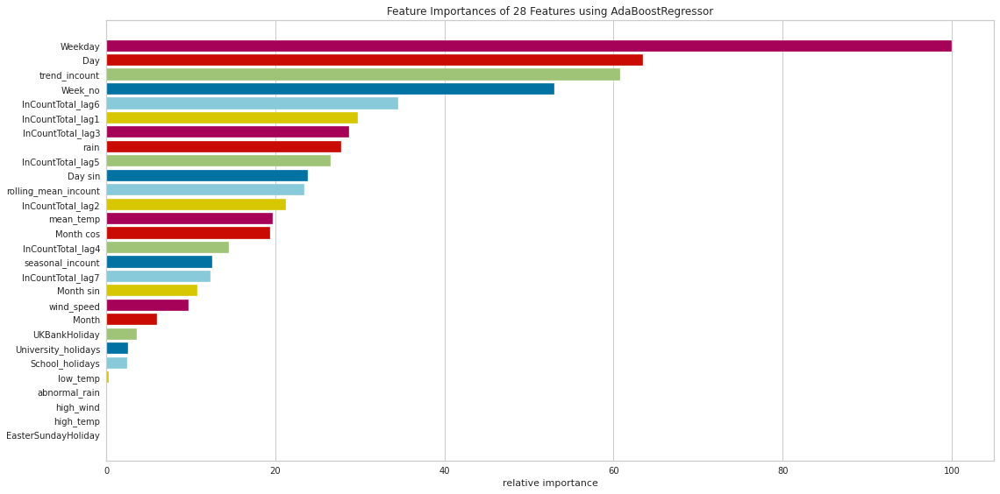

Cross CV validation...
bagging
default model fitting...
Now tuning BaggingRegressor(base_estimator=None, bootstrap=True, bootstrap_features=False,
                 max_features=1.0, max_samples=1.0, n_estimators=200,
                 n_jobs=None, oob_score=False, random_state=None, verbose=0,
                 warm_start=False).
Cross CV validation...
random_forest
default model fitting...
Now tuning RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=200, n_jobs=None, oob_score=False,
                      random_state=None, verbose=0, warm_start=False).


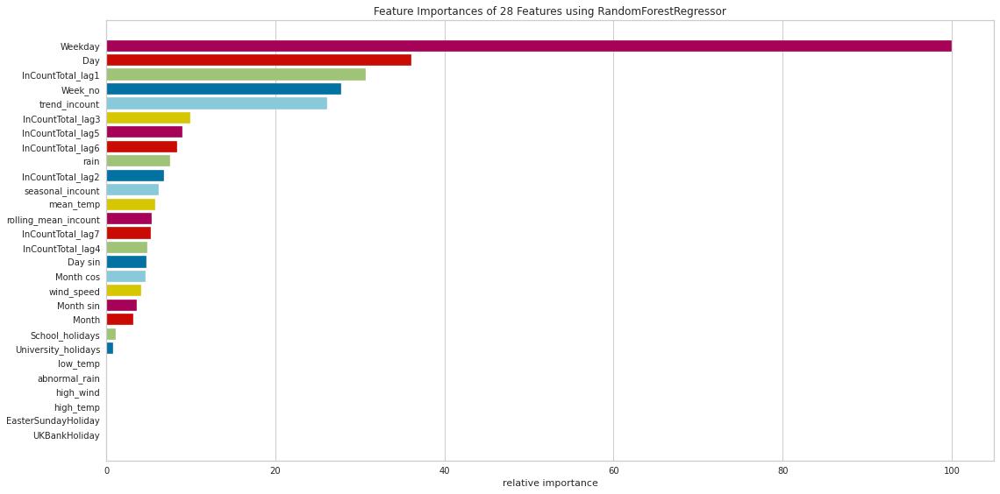

Cross CV validation...
extra_trees_regressor
default model fitting...
Now tuning ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=200, n_jobs=None, oob_score=False,
                    random_state=None, verbose=0, warm_start=False).


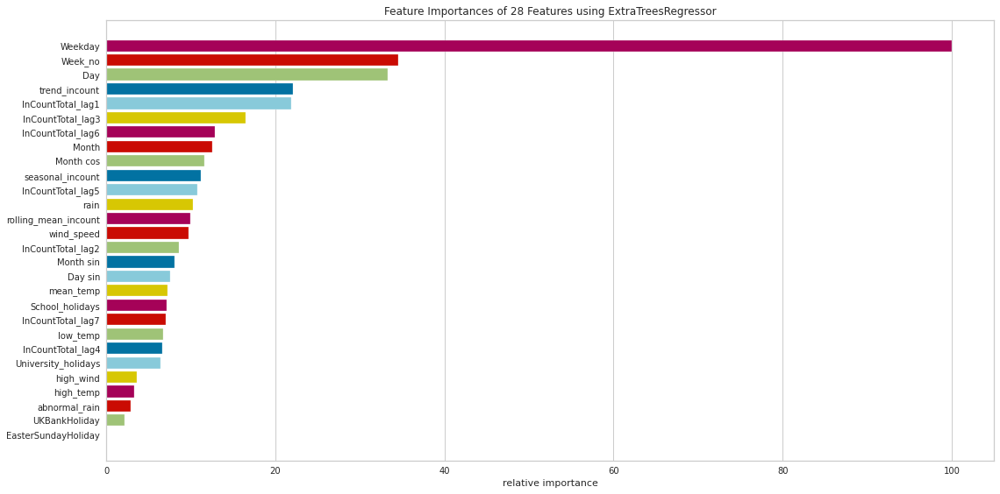

Cross CV validation...
gradient_boosting_regressor
default model fitting...
Now tuning GradientBoostingRegressor(alpha=0.9, ccp_alpha=0.0, criterion='friedman_mse',
                          init=None, learning_rate=0.1, loss='ls', max_depth=3,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=200,
                          n_iter_no_change=None, presort='deprecated',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False).


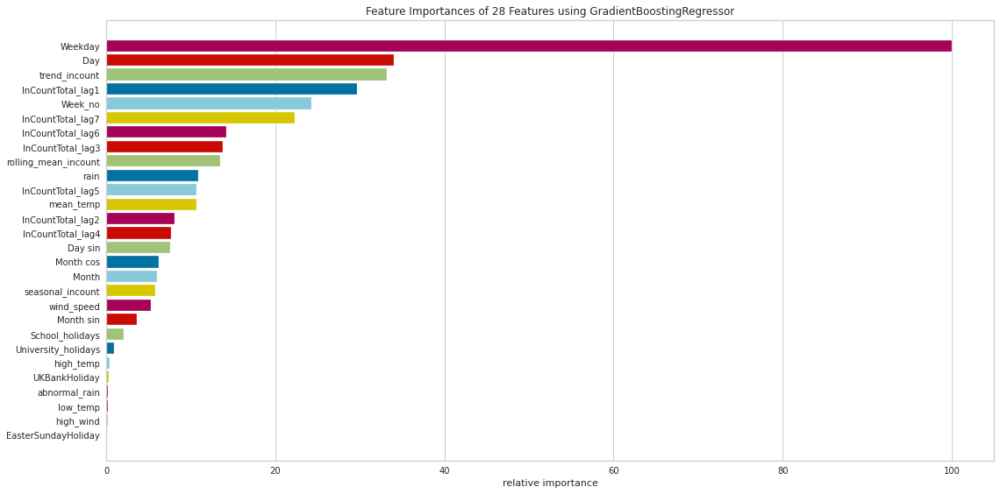

Cross CV validation...
XGBoost
default model fitting...
Now tuning XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0,
             importance_type='gain', learning_rate=0.1, max_delta_step=0,
             max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
             n_jobs=1, nthread=None, objective='reg:squarederror',
             random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
             seed=None, silent=None, subsample=1, verbosity=1).


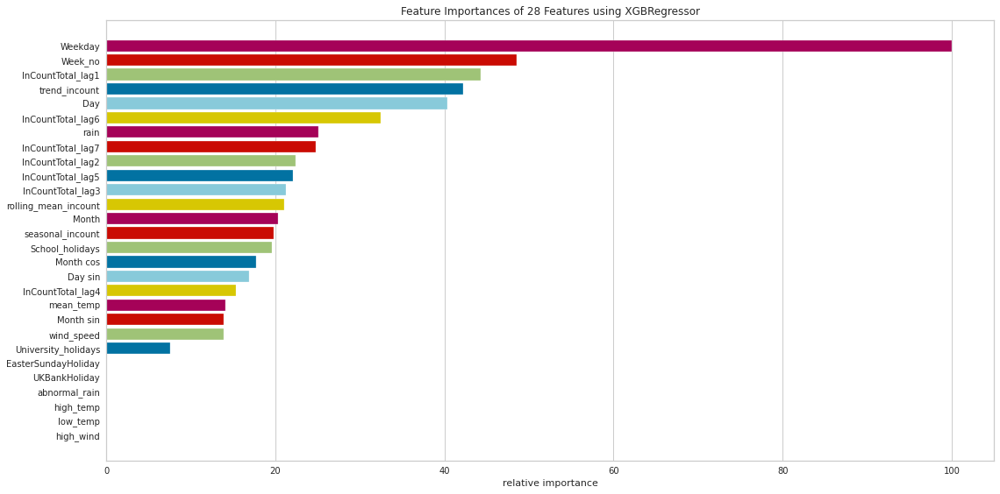

Cross CV validation...
LightGradientBoosting
default model fitting...
Now tuning LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
              importance_type='split', learning_rate=0.1, max_depth=-1,
              min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
              n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
              random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
              subsample=1.0, subsample_for_bin=200000, subsample_freq=0).
Cross CV validation...
CategoricalGradientBoosting
default model fitting...
Now tuning <catboost.core.CatBoostRegressor object at 0x7f6222260c18>.
Cross CV validation...
NeuralNet_MLP
default model fitting...
Now tuning MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001,

In [ ]:
reg_models = regression_model(data_outliersremoved,dataset_type='OutliersRemoved_extra_features_shuffled')
_,_,_, _, _, loss_normal_df = reg_models.train_and_evaluate_models(RFEcross_validation=False,shuffle=True, extra_input_features=True)
loss_values_all_models.append(loss_normal_df)

In [ ]:
loss_df = pd.concat([loss_each_model for loss_each_model in loss_values_all_models], axis=0).reset_index(drop=True)


In [ ]:
loss_df.sort_values('mape').head(25)

,Model_type,mape,mse,me,mae,mpe,rmse,R2 score,Adj R2 score,AIC,BIC
230,bagging_Outliers_Removed_shuffled_default_model,11.830063,0.004170,-0.012911,0.044775,-0.008453,0.064574,0.476813,0.440677,-1910.319207,-1821.131284
170,bagging_Outliers_Removed_default_model,11.848841,0.004226,-0.013662,0.044947,-0.010737,0.065008,0.469750,0.433126,-1905.531793,-1816.343870
173,random_forest_Outliers_Removed_default_model,11.914107,0.004233,-0.013702,0.045073,-0.010174,0.065059,0.468929,0.432248,-1904.979633,-1815.791710
233,random_forest_Outliers_Removed_shuffled_defaul...,11.919705,0.004280,-0.013415,0.045139,-0.009311,0.065419,0.463036,0.425948,-1901.040112,-1811.852189
298,extra_trees_regressor_OutliersRemoved_extra_fe...,11.932610,0.003866,0.001586,0.042341,3.387984,0.062019,0.482543,NaN,NaN,NaN
188,CategoricalGradientBoosting_Outliers_Removed_d...,11.991476,0.004348,-0.012474,0.045386,-0.007304,0.065937,0.454493,0.416815,-1895.404784,-1806.216861
179,gradient_boosting_regressor_Outliers_Removed_d...,12.200679,0.004716,-0.017607,0.047294,-0.021928,0.068674,0.408271,0.367401,-1866.369071,-1777.181148
234,random_forest_Outliers_Removed_shuffled_rscv_m...,12.206357,0.004391,-0.014796,0.046110,-0.011349,0.066261,0.449112,0.411063,-1891.900879,-1802.712956
239,gradient_boosting_regressor_Outliers_Removed_s...,12.226600,0.004668,-0.017608,0.047306,-0.021741,0.068326,0.414245,0.373788,-1869.991776,-1780.803853
174,random_forest_Outliers_Removed_rscv_model,12.246133,0.004436,-0.014421,0.046272,-0.010279,0.066600,0.443471,0.405032,-1888.263732,-1799.075809


### 7.1.5 Model training with PCA feaures

Defined 20 models
linear_regression
default model fitting...
Now tuning LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False).


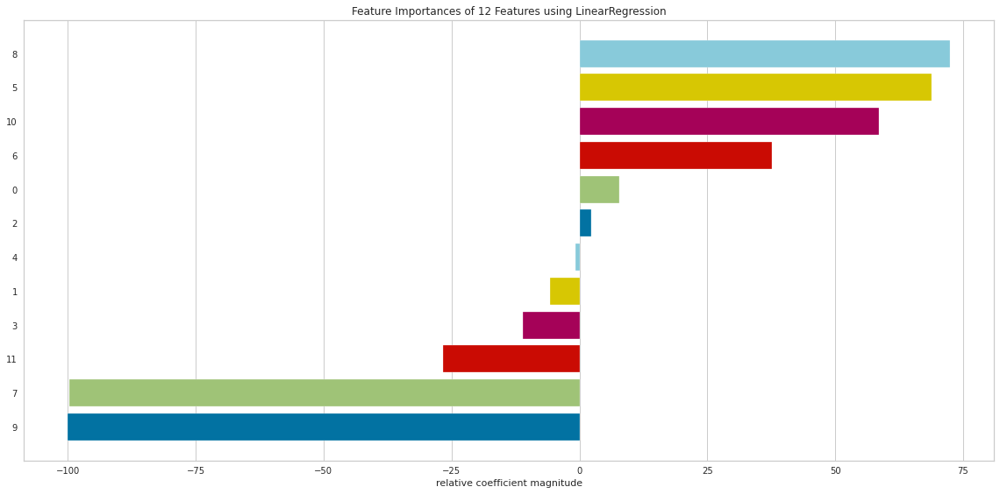

Cross CV validation...
lassoRegressor
default model fitting...
Now tuning Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
      normalize=False, positive=False, precompute=False, random_state=None,
      selection='cyclic', tol=0.0001, warm_start=False).


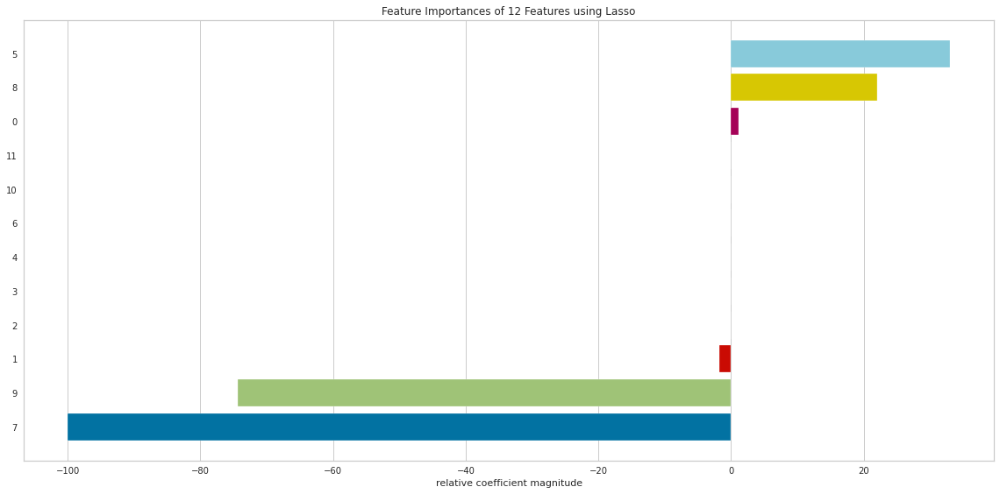

Cross CV validation...
ridgeRegressor
default model fitting...
Now tuning Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=None, solver='auto', tol=0.001).


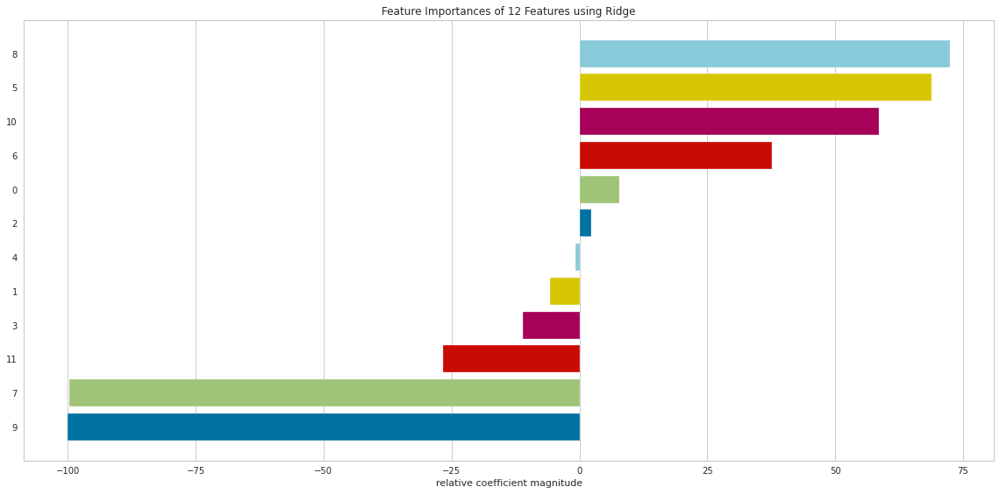

Cross CV validation...
elastic_net
default model fitting...
Now tuning ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='cyclic', tol=0.0001, warm_start=False).


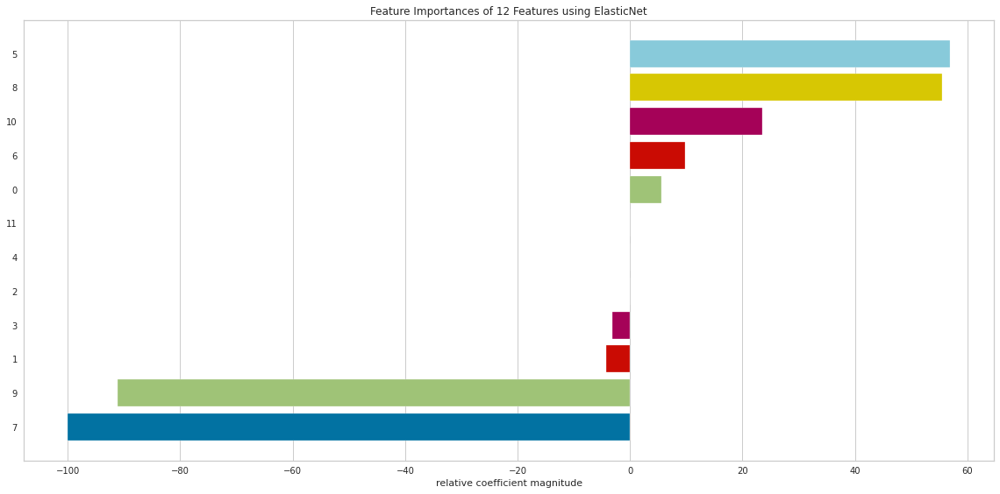

Cross CV validation...
huberRegressor
default model fitting...
Now tuning HuberRegressor(alpha=0.0001, epsilon=1.35, fit_intercept=True, max_iter=100,
               tol=1e-05, warm_start=False).


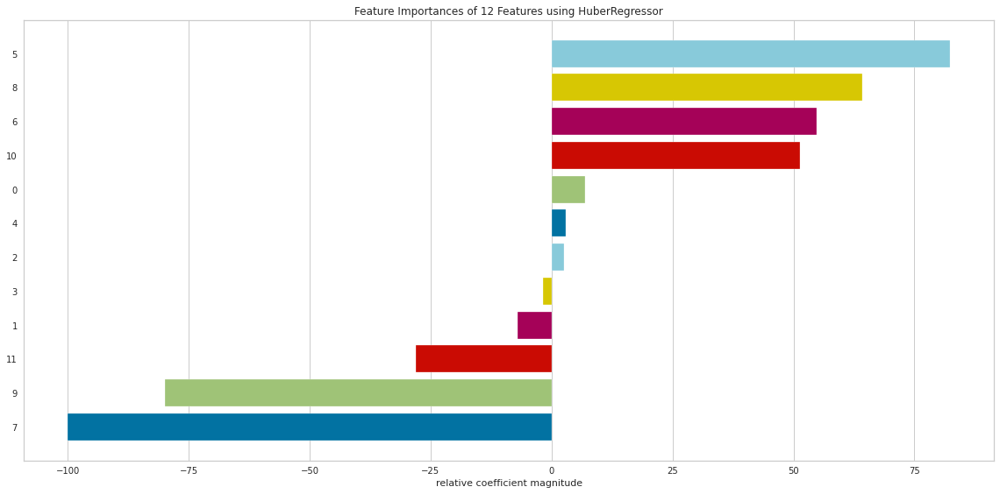

Cross CV validation...
passive_aggressor
default model fitting...
Now tuning PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=None, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False).


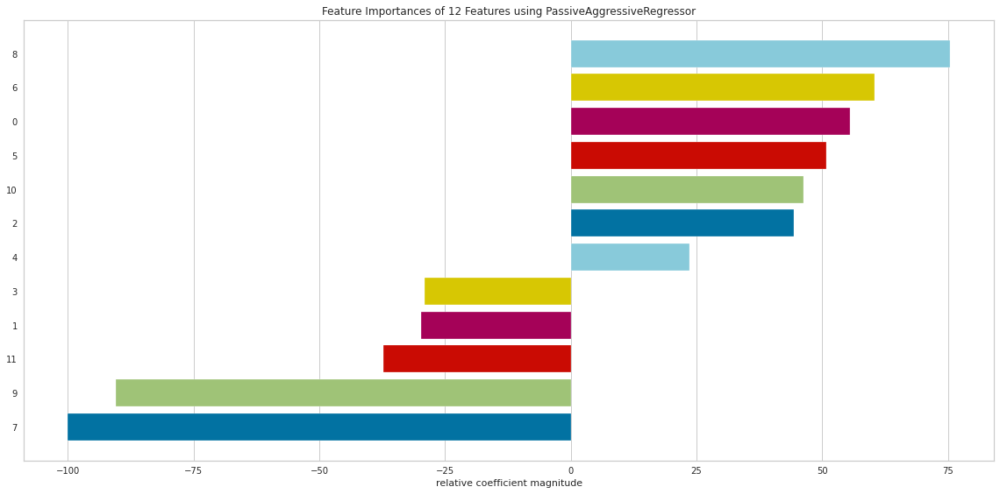

Cross CV validation...
sgd
default model fitting...
Now tuning SGDRegressor(alpha=0.0001, average=False, early_stopping=False, epsilon=0.1,
             eta0=0.01, fit_intercept=True, l1_ratio=0.15,
             learning_rate='invscaling', loss='squared_loss', max_iter=1000,
             n_iter_no_change=5, penalty='l2', power_t=0.25, random_state=None,
             shuffle=True, tol=0.001, validation_fraction=0.1, verbose=0,
             warm_start=False).


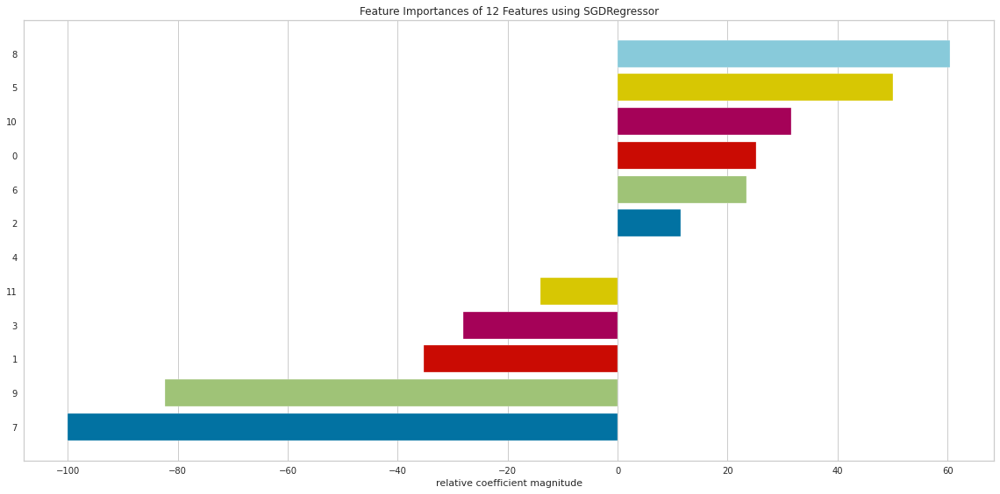

Cross CV validation...
knn_regressor
default model fitting...
Now tuning KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=None, n_neighbors=7, p=2,
                    weights='uniform').
Cross CV validation...
decisiontree_regressor
default model fitting...
Now tuning DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best').


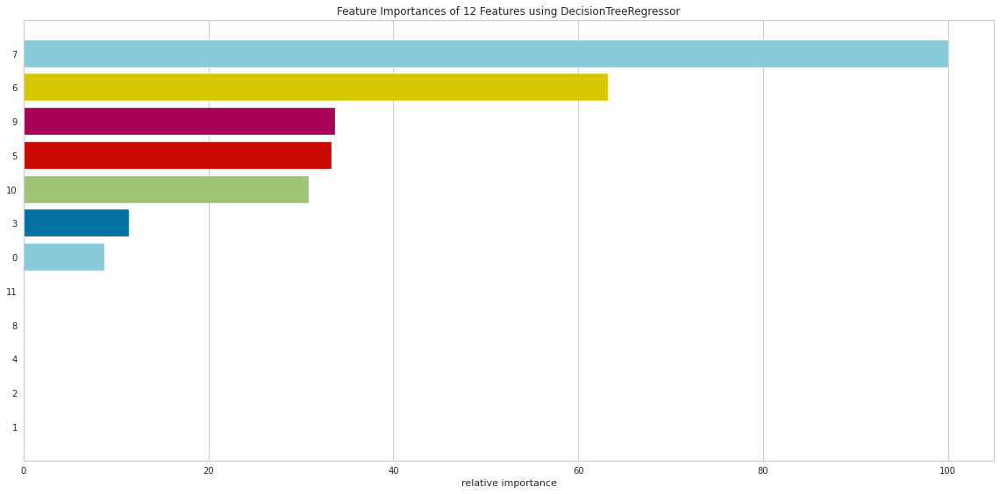

Cross CV validation...
extra_tree_regressor
default model fitting...
Now tuning ExtraTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                   max_features='auto', max_leaf_nodes=None,
                   min_impurity_decrease=0.0, min_impurity_split=None,
                   min_samples_leaf=1, min_samples_split=2,
                   min_weight_fraction_leaf=0.0, random_state=None,
                   splitter='random').


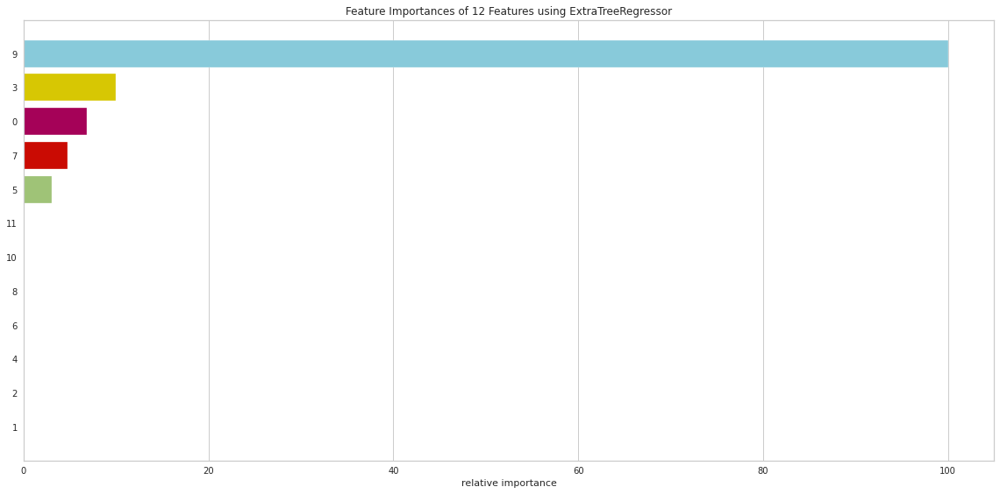

Cross CV validation...
svm_regressor
default model fitting...
Now tuning SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1, gamma='scale',
    kernel='rbf', max_iter=-1, shrinking=True, tol=0.001, verbose=False).
Cross CV validation...
adaBoost
default model fitting...
Now tuning AdaBoostRegressor(base_estimator=None, learning_rate=1.0, loss='linear',
                  n_estimators=200, random_state=None).


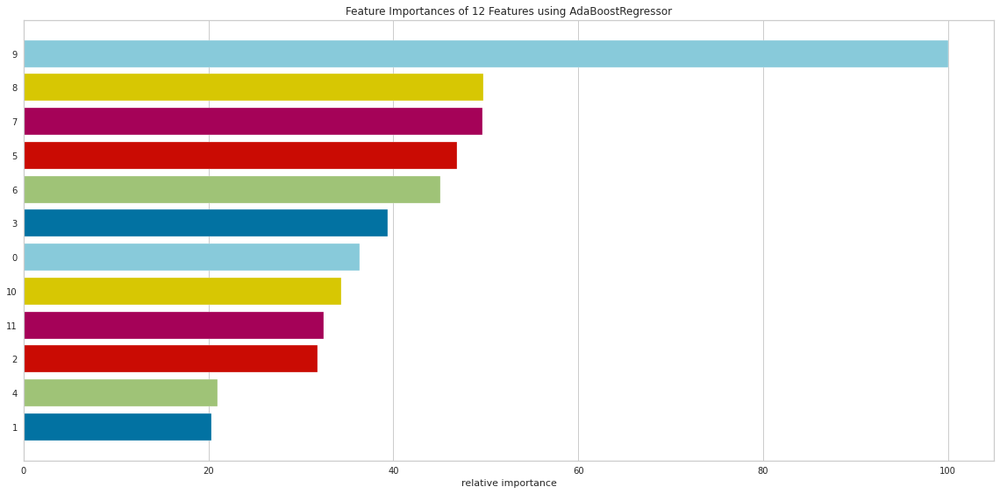

Cross CV validation...
bagging
default model fitting...
Now tuning BaggingRegressor(base_estimator=None, bootstrap=True, bootstrap_features=False,
                 max_features=1.0, max_samples=1.0, n_estimators=200,
                 n_jobs=None, oob_score=False, random_state=None, verbose=0,
                 warm_start=False).
Cross CV validation...
random_forest
default model fitting...
Now tuning RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=200, n_jobs=None, oob_score=False,
                      random_state=None, verbose=0, warm_start=False).


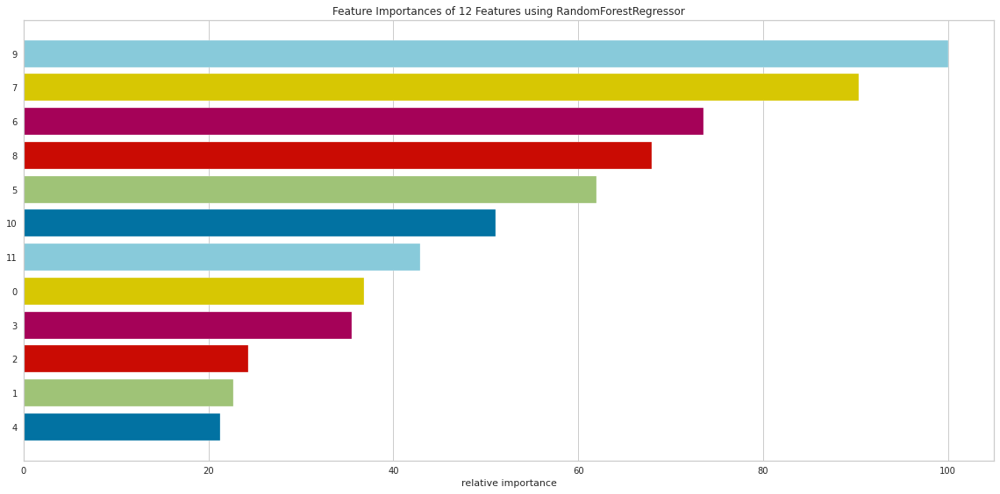

Cross CV validation...
extra_trees_regressor
default model fitting...
Now tuning ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=200, n_jobs=None, oob_score=False,
                    random_state=None, verbose=0, warm_start=False).


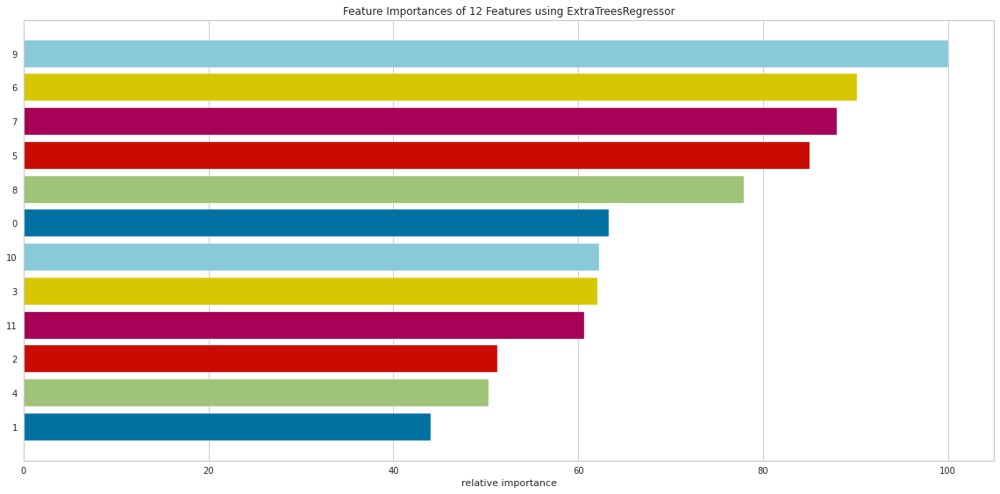

Cross CV validation...
gradient_boosting_regressor
default model fitting...
Now tuning GradientBoostingRegressor(alpha=0.9, ccp_alpha=0.0, criterion='friedman_mse',
                          init=None, learning_rate=0.1, loss='ls', max_depth=3,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=200,
                          n_iter_no_change=None, presort='deprecated',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False).


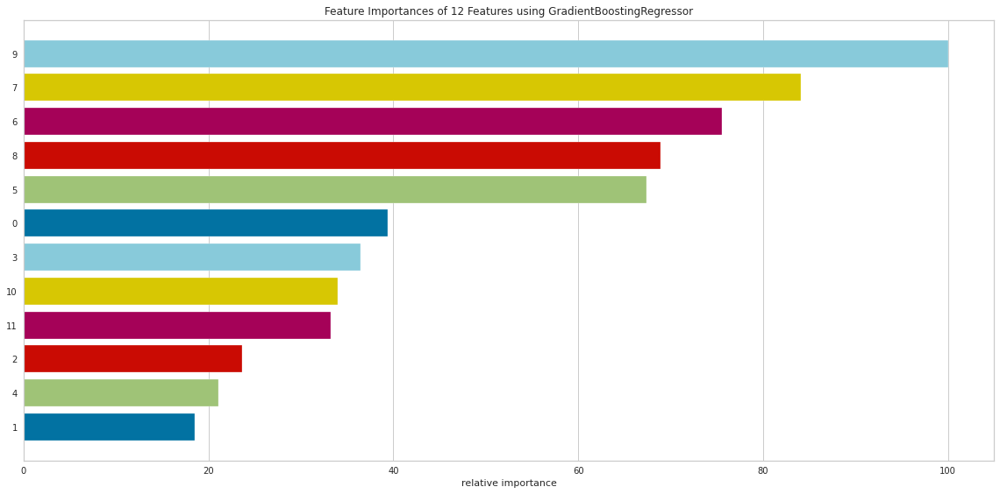

Cross CV validation...
XGBoost
default model fitting...
Now tuning XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0,
             importance_type='gain', learning_rate=0.1, max_delta_step=0,
             max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
             n_jobs=1, nthread=None, objective='reg:squarederror',
             random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
             seed=None, silent=None, subsample=1, verbosity=1).


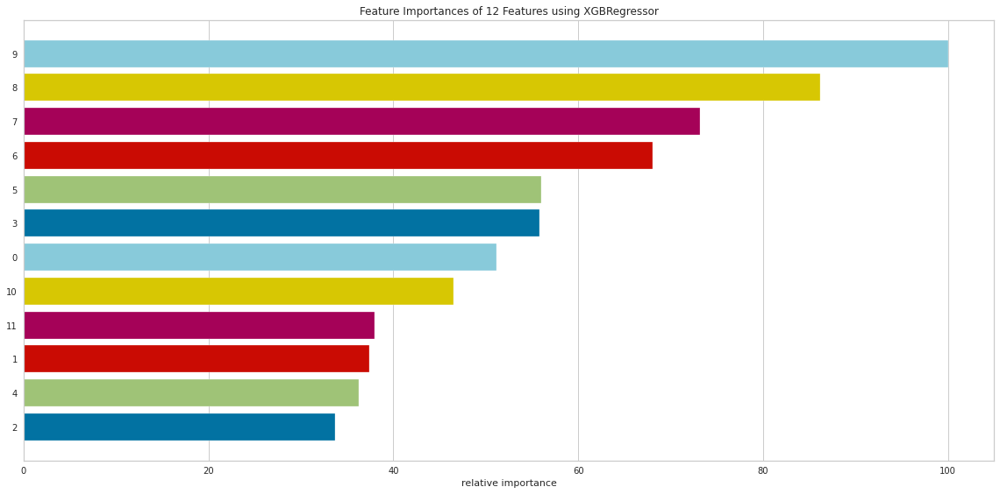

Cross CV validation...
LightGradientBoosting
default model fitting...
Now tuning LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
              importance_type='split', learning_rate=0.1, max_depth=-1,
              min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
              n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
              random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
              subsample=1.0, subsample_for_bin=200000, subsample_freq=0).
Cross CV validation...
CategoricalGradientBoosting
default model fitting...
Now tuning <catboost.core.CatBoostRegressor object at 0x7f6222f61400>.
Cross CV validation...
NeuralNet_MLP
default model fitting...
Now tuning MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001,

In [ ]:
reg_models = regression_model(princdf,dataset_type='PCA_features')
_,_,_, _, _, loss_pca_df = reg_models.train_and_evaluate_models(RFEcross_validation=False,pcaFeatures=True)
loss_values_all_models.append(loss_pca_df)

In [ ]:
loss_pca_df.sort_values('mape').head(25)

,Model_type,mape,mse,me,mae,mpe,rmse,R2 score,Adj R2 score,AIC,BIC
25,decisiontree_regressor_PCA_features_rscv_model,26.724401,0.009123,-0.022357,0.069848,0.074432,0.095513,-0.001671,-0.038770,-1688.401991,-1637.703325
52,LightGradientBoosting_PCA_features_rscv_model,26.804916,0.008612,-0.015611,0.065561,0.102041,0.092803,0.054354,0.019331,-1709.410305,-1658.711640
56,CategoricalGradientBoosting_PCA_features_cross...,26.865394,0.007539,-0.001042,0.062709,14.151786,0.086643,0.140314,NaN,NaN,NaN
41,random_forest_PCA_features_crosscv_model,27.046286,0.007961,-0.000423,0.064869,14.094334,0.088939,0.099603,NaN,NaN,NaN
3,lassoRegressor_PCA_features_default_model,27.101444,0.009454,-0.018628,0.070133,0.091321,0.097234,-0.038100,-0.076548,-1675.363276,-1624.664611
9,elastic_net_PCA_features_default_model,27.101444,0.009454,-0.018628,0.070133,0.091321,0.097234,-0.038100,-0.076548,-1675.363276,-1624.664611
40,random_forest_PCA_features_rscv_model,27.102499,0.008352,-0.014731,0.064415,0.109839,0.091387,0.082993,0.049030,-1720.634944,-1669.936278
4,lassoRegressor_PCA_features_rscv_model,27.222340,0.009127,-0.016749,0.068768,0.098939,0.095537,-0.002183,-0.039300,-1688.215618,-1637.516952
35,adaBoost_PCA_features_crosscv_model,27.265759,0.008135,-0.002082,0.065957,13.618792,0.089911,0.079749,NaN,NaN,NaN
18,sgd_PCA_features_default_model,27.294103,0.009394,-0.018320,0.069953,0.094086,0.096922,-0.031446,-0.069647,-1677.710468,-1627.011802


### 7.1.6 Model training with Weekly data

Defined 20 models
linear_regression
default model fitting...
Now tuning LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False).


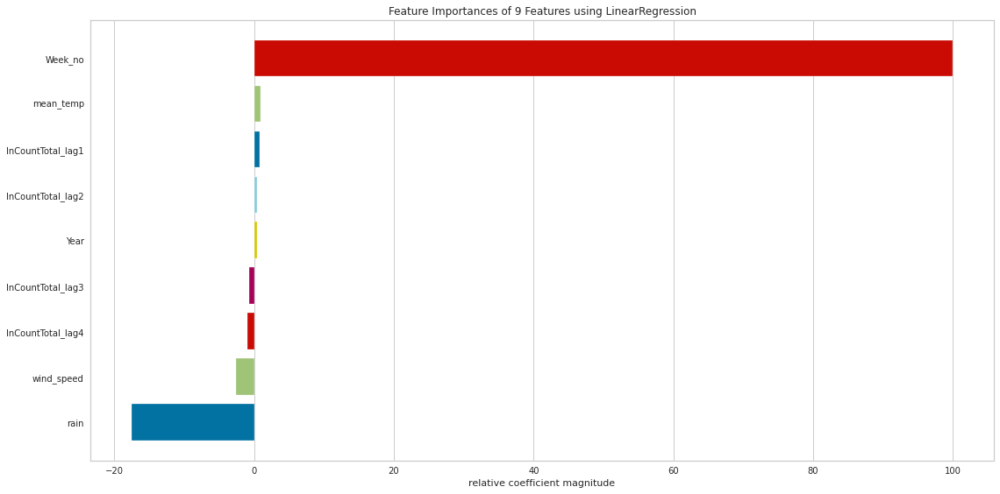

Cross CV validation...
lassoRegressor
default model fitting...
Now tuning Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
      normalize=False, positive=False, precompute=False, random_state=None,
      selection='cyclic', tol=0.0001, warm_start=False).


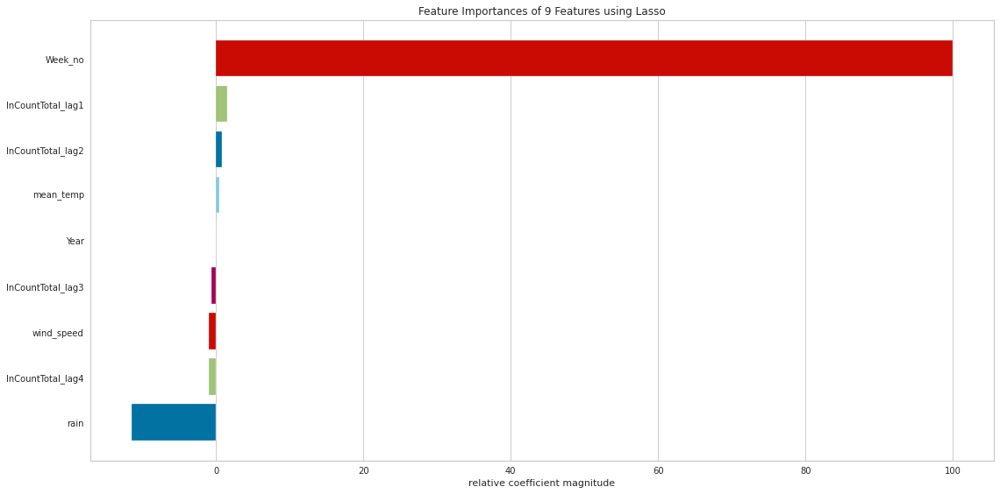

Cross CV validation...
ridgeRegressor
default model fitting...
Now tuning Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=None, solver='auto', tol=0.001).


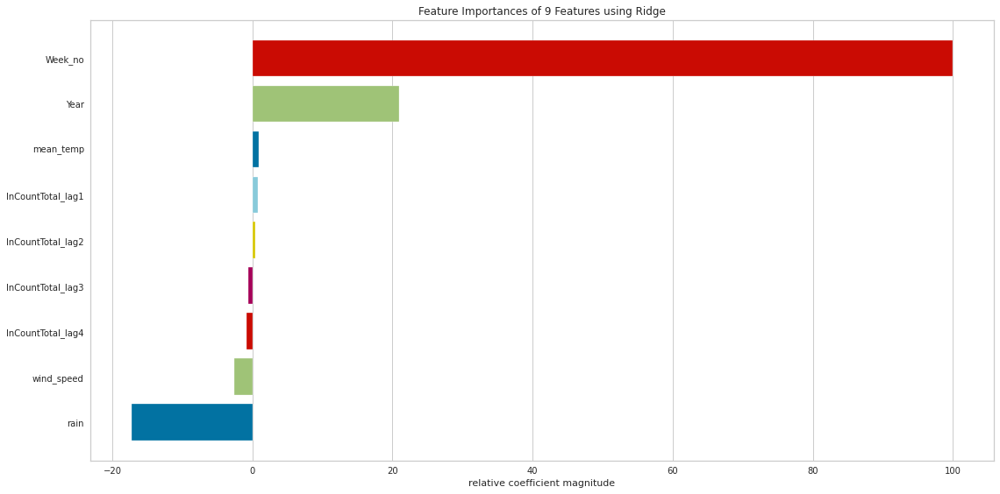

Cross CV validation...
elastic_net
default model fitting...
Now tuning ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='cyclic', tol=0.0001, warm_start=False).


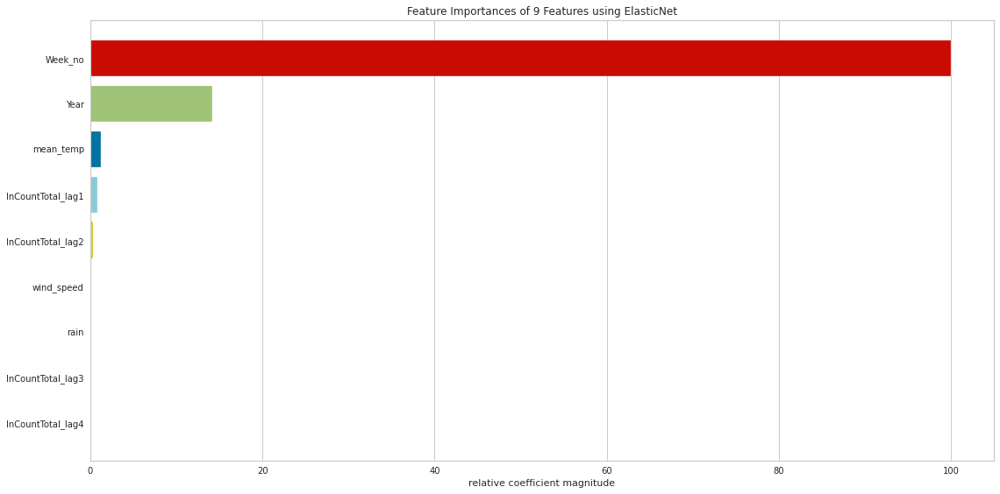

Cross CV validation...
huberRegressor
default model fitting...
Now tuning HuberRegressor(alpha=0.0001, epsilon=1.35, fit_intercept=True, max_iter=100,
               tol=1e-05, warm_start=False).


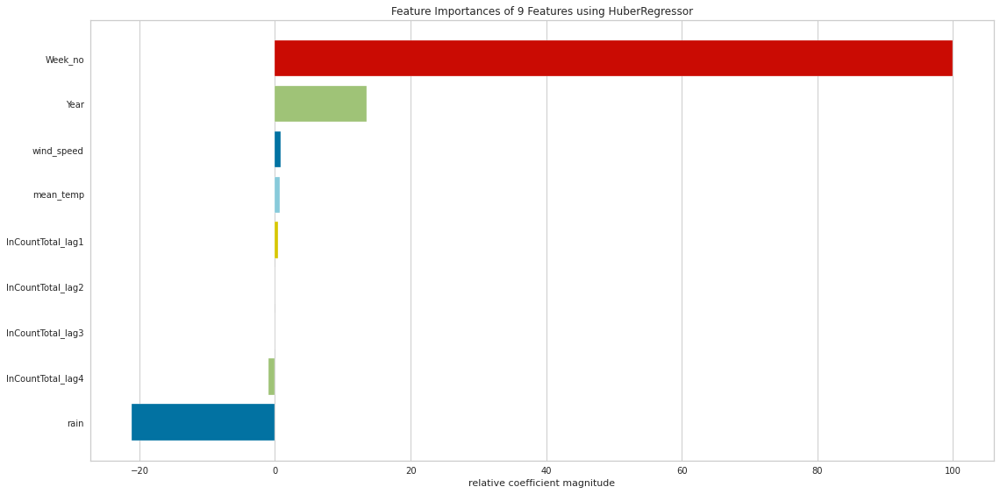

Cross CV validation...
passive_aggressor
default model fitting...
Now tuning PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=None, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False).


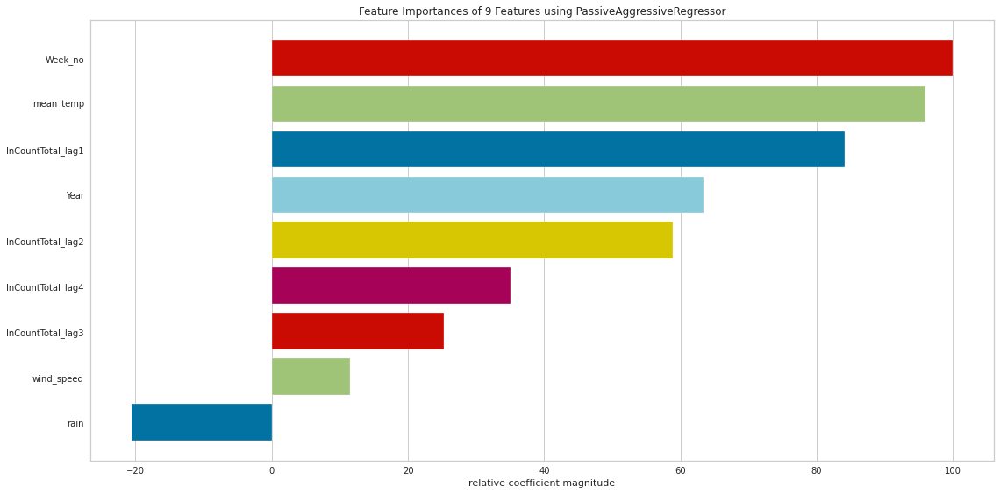

Cross CV validation...
sgd
default model fitting...
Now tuning SGDRegressor(alpha=0.0001, average=False, early_stopping=False, epsilon=0.1,
             eta0=0.01, fit_intercept=True, l1_ratio=0.15,
             learning_rate='invscaling', loss='squared_loss', max_iter=1000,
             n_iter_no_change=5, penalty='l2', power_t=0.25, random_state=None,
             shuffle=True, tol=0.001, validation_fraction=0.1, verbose=0,
             warm_start=False).


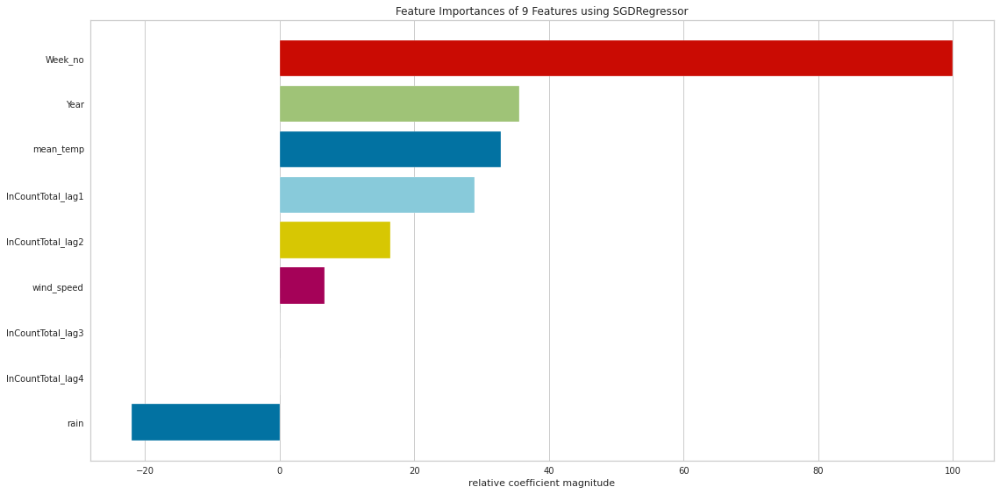

Cross CV validation...
knn_regressor
default model fitting...
Now tuning KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=None, n_neighbors=7, p=2,
                    weights='uniform').
Cross CV validation...
decisiontree_regressor
default model fitting...
Now tuning DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best').


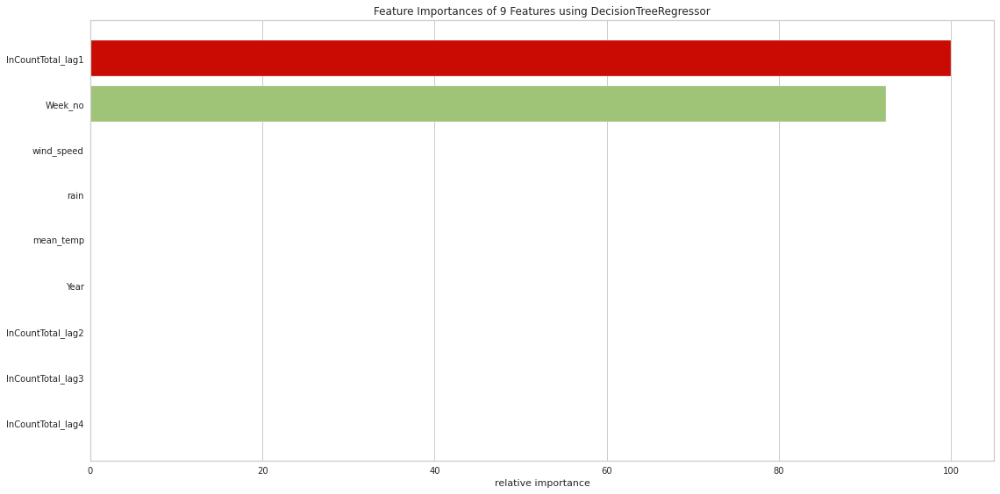

Cross CV validation...
extra_tree_regressor
default model fitting...
Now tuning ExtraTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                   max_features='auto', max_leaf_nodes=None,
                   min_impurity_decrease=0.0, min_impurity_split=None,
                   min_samples_leaf=1, min_samples_split=2,
                   min_weight_fraction_leaf=0.0, random_state=None,
                   splitter='random').


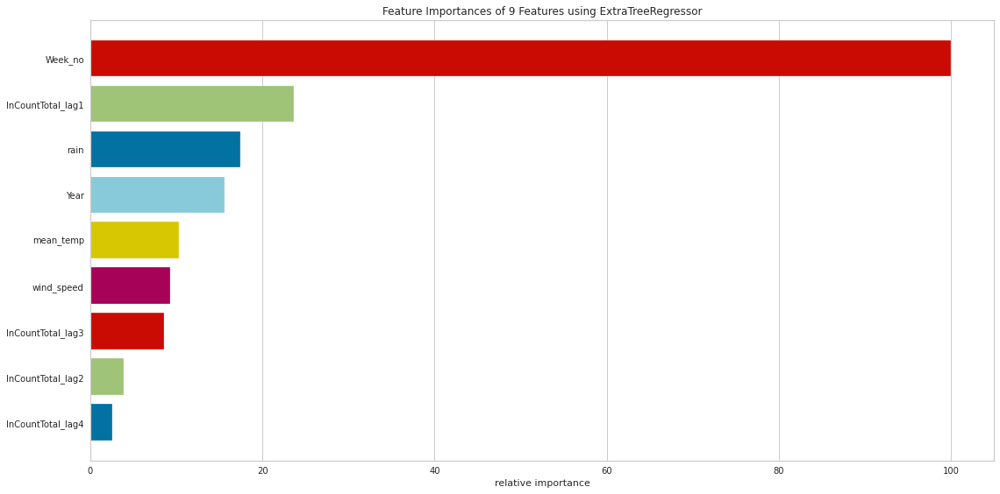

Cross CV validation...
svm_regressor
default model fitting...
Now tuning SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1, gamma='scale',
    kernel='rbf', max_iter=-1, shrinking=True, tol=0.001, verbose=False).
Cross CV validation...
adaBoost
default model fitting...
Now tuning AdaBoostRegressor(base_estimator=None, learning_rate=1.0, loss='linear',
                  n_estimators=200, random_state=None).


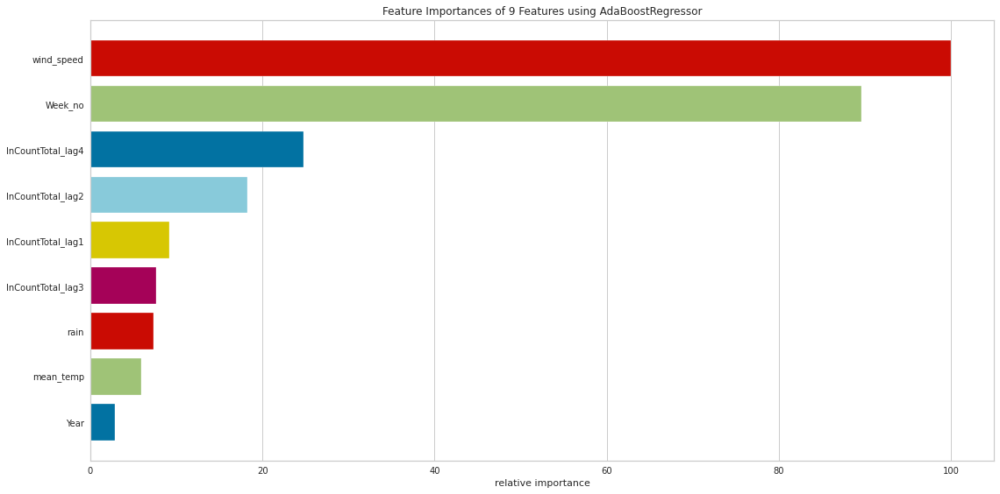

Cross CV validation...
bagging
default model fitting...
Now tuning BaggingRegressor(base_estimator=None, bootstrap=True, bootstrap_features=False,
                 max_features=1.0, max_samples=1.0, n_estimators=200,
                 n_jobs=None, oob_score=False, random_state=None, verbose=0,
                 warm_start=False).
Cross CV validation...
random_forest
default model fitting...
Now tuning RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=200, n_jobs=None, oob_score=False,
                      random_state=None, verbose=0, warm_start=False).


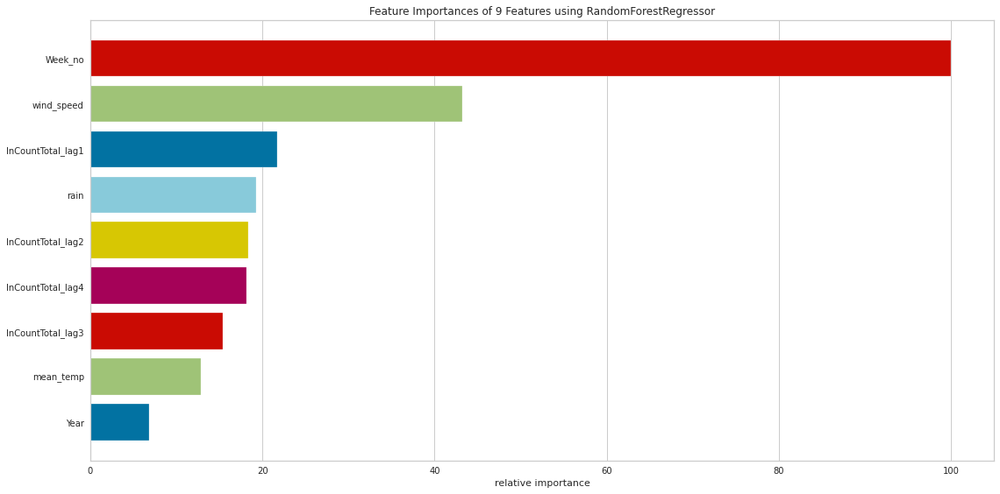

Cross CV validation...
extra_trees_regressor
default model fitting...
Now tuning ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=200, n_jobs=None, oob_score=False,
                    random_state=None, verbose=0, warm_start=False).


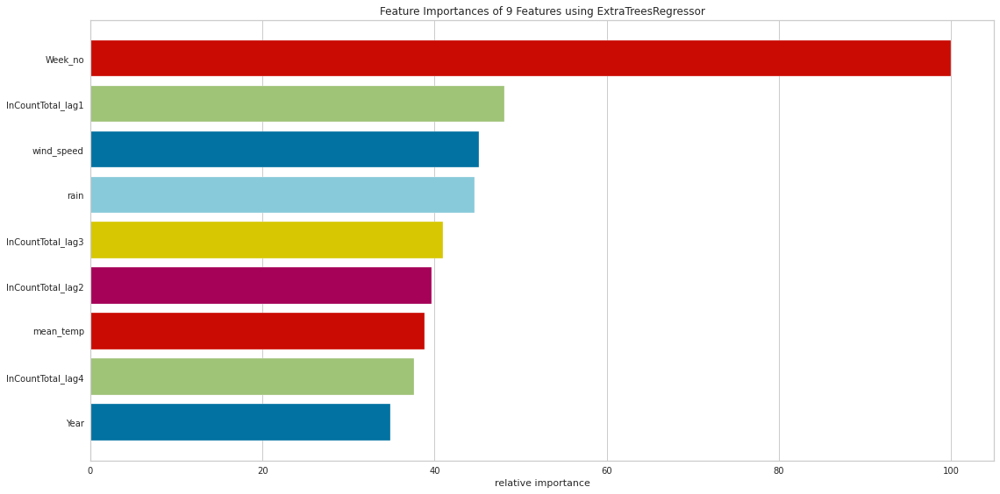

Cross CV validation...
gradient_boosting_regressor
default model fitting...
Now tuning GradientBoostingRegressor(alpha=0.9, ccp_alpha=0.0, criterion='friedman_mse',
                          init=None, learning_rate=0.1, loss='ls', max_depth=3,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=200,
                          n_iter_no_change=None, presort='deprecated',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False).


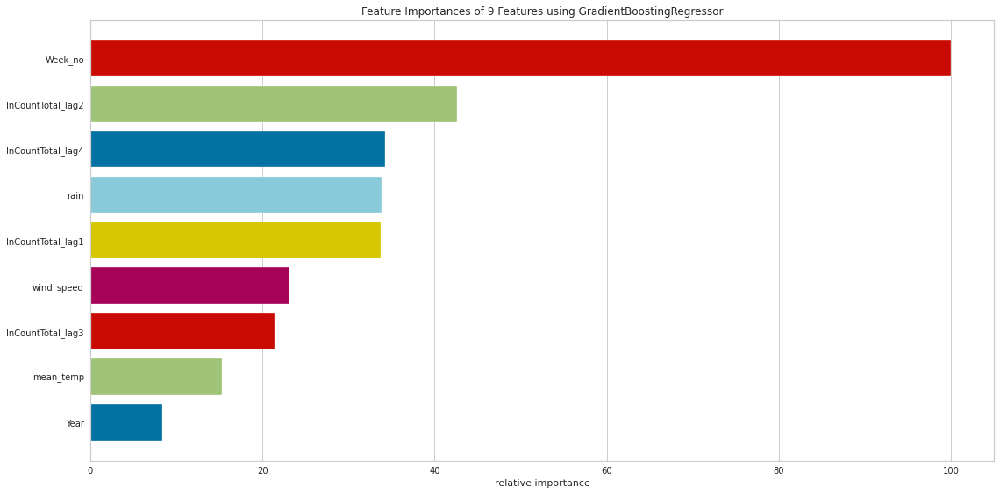

Cross CV validation...
XGBoost
default model fitting...
Now tuning XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0,
             importance_type='gain', learning_rate=0.1, max_delta_step=0,
             max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
             n_jobs=1, nthread=None, objective='reg:squarederror',
             random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
             seed=None, silent=None, subsample=1, verbosity=1).


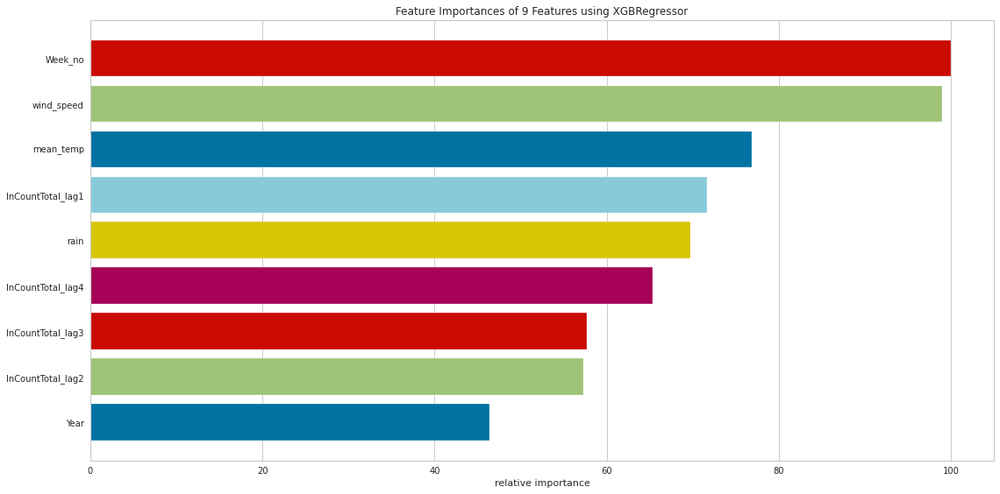

Cross CV validation...
LightGradientBoosting
default model fitting...
Now tuning LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
              importance_type='split', learning_rate=0.1, max_depth=-1,
              min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
              n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
              random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
              subsample=1.0, subsample_for_bin=200000, subsample_freq=0).
Cross CV validation...
CategoricalGradientBoosting
default model fitting...
Now tuning <catboost.core.CatBoostRegressor object at 0x7f621b478d68>.
Cross CV validation...
NeuralNet_MLP
default model fitting...
Now tuning MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001,

In [ ]:
reg_models = regression_model(data_weekly,dataset_type='weekly_data')
_,_,_, _, _, loss_weekly_df = reg_models.train_and_evaluate_models(RFEcross_validation=False,weekly_data=True)



In [ ]:
loss_weekly_df.sort_values('mape').head(15)

,Model_type,mape,mse,me,mae,mpe,rmse,R2 score,Adj R2 score,AIC,BIC
16,passive_aggressor_weekly_data_rscv_model,7.322431,0.069203,-0.053238,0.201995,-0.011249,0.263065,0.431688,0.025751,-46.767702,-34.578943
57,NeuralNet_MLP_weekly_data_default_model,7.521019,0.076316,-0.045137,0.209089,-0.007298,0.276254,0.373275,-0.074386,-44.321753,-32.132994
42,extra_trees_regressor_weekly_data_default_model,7.593979,0.085440,-0.049187,0.211409,-0.008136,0.292301,0.298348,-0.202832,-41.498516,-29.309757
10,elastic_net_weekly_data_rscv_model,7.604363,0.086880,-0.095026,0.216313,-0.024186,0.294754,0.286523,-0.223103,-41.080706,-28.891947
18,sgd_weekly_data_default_model,7.696587,0.080257,-0.040726,0.211471,-0.005835,0.283296,0.340914,-0.129861,-43.063119,-30.874361
7,ridgeRegressor_weekly_data_rscv_model,7.716040,0.087065,-0.082116,0.218258,-0.019288,0.295067,0.285005,-0.225705,-41.027590,-28.838831
0,linear_regression_weekly_data_default_model,7.728431,0.086534,-0.079074,0.218293,-0.018129,0.294167,0.289362,-0.218236,-41.180393,-28.991635
1,linear_regression_weekly_data_rscv_model,7.813878,0.095666,-0.119821,0.223899,-0.033625,0.309299,0.214370,-0.346795,-38.672300,-26.483541
12,huberRegressor_weekly_data_default_model,7.971273,0.099953,-0.109871,0.227959,-0.029165,0.316154,0.179162,-0.407150,-37.576330,-25.387572
4,lassoRegressor_weekly_data_rscv_model,7.988315,0.102159,-0.129113,0.229825,-0.036573,0.319624,0.161045,-0.438208,-37.030541,-24.841783


In [ ]:
loss_weekly_df.sort_values('mape').to_csv("weekly_data_model_loss_values.csv")

## 7.2 Model training with LSTM

In [ ]:
## if model is already trained and model files are available, then don't train LSTM again
if global_parameters['lstm_training_needed'] == True:
  lstm_train_eval_objct = LSTM_model_train_and_evaluation()
  lstm_models = lstm_train_eval_objct.get_LSTM_models()
  model_training_results, lstm_data_set_dict = lstm_train_eval_objct.train_LSTM_models(lstm_models)#/


In [ ]:
# evaluate all the models which are trained
lstm_train_eval_objct = LSTM_model_train_and_evaluation()
lstm_data_set_dict = lstm_train_eval_objct.create_LSTM_train_datasets()
loss_lstm_df = lstm_train_eval_objct.evaluate_LSTM_models(None,lstm_data_set_dict)


Defined 7 models


IndexError: ignored

In [ ]:
loss_values_all_models.append(loss_lstm_df)
loss_lstm_df.sort_values('mape').to_csv("lstm_best_models.csv")
loss_lstm_df.sort_values('mape').head(25)

,Model_type,mape,mse,me,mae,mpe,rmse,R2 score,Adj R2 score,AIC,BIC
16,ensemble_of_ensembles_lstm3,10.881565,0.003314,-0.008190,0.041015,0.000034,0.057567,0.618135,-0.050130,-933.017662,-487.852361
11,stacked_ensemble_lstm2,10.891049,0.003273,-0.003190,0.040578,0.011875,0.057212,0.622832,-0.037213,-935.616757,-490.451456
10,stacked_ensemble_lstm1,10.902380,0.003348,-0.007735,0.040937,0.002323,0.057858,0.614270,-0.060757,-930.903148,-485.737847
8,ensemble_lstm_outlier_removed,10.986730,0.003331,-0.007378,0.041243,0.003038,0.057713,0.616199,-0.055453,-931.955811,-486.790509
12,stacked_ensemble_lstm3,10.992788,0.003274,-0.003725,0.040974,0.010238,0.057217,0.622765,-0.037395,-935.579831,-490.414529
15,ensemble_of_ensembles_lstm2,11.003166,0.003297,-0.006856,0.041194,0.001643,0.057417,0.620123,-0.044663,-934.113825,-488.948524
14,ensemble_of_ensembles_lstm1,11.036401,0.003289,-0.005891,0.041269,0.003800,0.057346,0.621066,-0.042069,-934.635868,-489.470567
13,stacked_ensemble_lstm4,11.199462,0.003300,-0.000119,0.041117,0.019013,0.057443,0.619783,-0.045596,-933.926211,-488.760910
9,ensemble_lstm_with_auto_encoder,11.441193,0.003490,-0.006453,0.042928,0.009863,0.059078,0.597824,-0.105983,-922.135293,-476.969991
4,cnn_lstm_encoder_decoder_outlier_removed,11.704837,0.003955,-0.009998,0.044963,-0.004986,0.062885,0.544323,-0.253112,-895.907205,-450.741903


## 7.7 Show model results

In [ ]:
loss_df = pd.concat([loss_each_model for loss_each_model in loss_values_all_models], axis=0).reset_index(drop=True)


In [ ]:
print(tabulate(loss_df, headers="keys", floatfmt=".4f", tablefmt='fancy_grid'))

╒═════╤═══════════════════════════════════════════════════════════════════════════════════╤═════════════════╤═══════════════════════╤═══════════════╤══════════════╤══════════════════╤═══════════════╤══════════════════════════╤════════════════╤════════════╤════════════╕
│     │ Model_type                                                                        │            mape │                   mse │            me │          mae │              mpe │          rmse │                 R2 score │   Adj R2 score │        AIC │        BIC │
╞═════╪═══════════════════════════════════════════════════════════════════════════════════╪═════════════════╪═══════════════════════╪═══════════════╪══════════════╪══════════════════╪═══════════════╪══════════════════════════╪════════════════╪════════════╪════════════╡
│   0 │ linear_regression_normal_shuffled_default_model                                   │         31.5971 │                0.0130 │       -0.0197 │       0.0860 │           0.0903 │       

In [ ]:
n_top = 10
print('best MAPE models \n',tabulate(loss_df.nsmallest(n_top,'mape')[['Model_type','mape']], headers="keys", floatfmt=".4f", tablefmt='fancy_grid'))
print('best MSE models \n',tabulate(loss_df.nsmallest(n_top,'mse')[['Model_type','mse']], headers="keys", floatfmt=".4f", tablefmt='fancy_grid'))
print('best R2 score models \n',tabulate(loss_df.nlargest(n_top,'R2 score')[['Model_type','R2 score']], headers="keys", floatfmt=".4f", tablefmt='fancy_grid'))
print('best Adj R2 score  models \n',tabulate(loss_df.nlargest(n_top,'Adj R2 score')[['Model_type','Adj R2 score']], headers="keys", floatfmt=".4f", tablefmt='fancy_grid'))
print('best AIC models \n',tabulate(loss_df.nsmallest(n_top,'AIC')[['Model_type','AIC']], headers="keys", floatfmt=".4f", tablefmt='fancy_grid'))
print('best BIC models \n',tabulate(loss_df.nsmallest(n_top,'BIC')[['Model_type','BIC']], headers="keys", floatfmt=".4f", tablefmt='fancy_grid'))


best MAPE models 
 ╒═════╤═════════════════════════════════════════════════════════════════════════════╤═════════╕
│     │ Model_type                                                                  │    mape │
╞═════╪═════════════════════════════════════════════════════════════════════════════╪═════════╡
│ 230 │ bagging_Outliers_Removed_shuffled_default_model                             │ 11.8301 │
├─────┼─────────────────────────────────────────────────────────────────────────────┼─────────┤
│ 170 │ bagging_Outliers_Removed_default_model                                      │ 11.8488 │
├─────┼─────────────────────────────────────────────────────────────────────────────┼─────────┤
│ 173 │ random_forest_Outliers_Removed_default_model                                │ 11.9141 │
├─────┼─────────────────────────────────────────────────────────────────────────────┼─────────┤
│ 233 │ random_forest_Outliers_Removed_shuffled_default_model                       │ 11.9197 │
├─────┼──────────────

In [ ]:
loss_df.sort_values('mape').head(25)

,Model_type,mape,mse,me,mae,mpe,rmse,R2 score,Adj R2 score,AIC,BIC
230,bagging_Outliers_Removed_shuffled_default_model,11.830063,0.004170,-0.012911,0.044775,-0.008453,0.064574,0.476813,0.440677,-1910.319207,-1821.131284
170,bagging_Outliers_Removed_default_model,11.848841,0.004226,-0.013662,0.044947,-0.010737,0.065008,0.469750,0.433126,-1905.531793,-1816.343870
173,random_forest_Outliers_Removed_default_model,11.914107,0.004233,-0.013702,0.045073,-0.010174,0.065059,0.468929,0.432248,-1904.979633,-1815.791710
233,random_forest_Outliers_Removed_shuffled_defaul...,11.919705,0.004280,-0.013415,0.045139,-0.009311,0.065419,0.463036,0.425948,-1901.040112,-1811.852189
298,extra_trees_regressor_OutliersRemoved_extra_fe...,11.932610,0.003866,0.001586,0.042341,3.387984,0.062019,0.482543,NaN,NaN,NaN
188,CategoricalGradientBoosting_Outliers_Removed_d...,11.991476,0.004348,-0.012474,0.045386,-0.007304,0.065937,0.454493,0.416815,-1895.404784,-1806.216861
179,gradient_boosting_regressor_Outliers_Removed_d...,12.200679,0.004716,-0.017607,0.047294,-0.021928,0.068674,0.408271,0.367401,-1866.369071,-1777.181148
234,random_forest_Outliers_Removed_shuffled_rscv_m...,12.206357,0.004391,-0.014796,0.046110,-0.011349,0.066261,0.449112,0.411063,-1891.900879,-1802.712956
239,gradient_boosting_regressor_Outliers_Removed_s...,12.226600,0.004668,-0.017608,0.047306,-0.021741,0.068326,0.414245,0.373788,-1869.991776,-1780.803853
174,random_forest_Outliers_Removed_rscv_model,12.246133,0.004436,-0.014421,0.046272,-0.010279,0.066600,0.443471,0.405032,-1888.263732,-1799.075809


In [ ]:
loss_df.sort_values('mape').to_csv("loss_values_all_models.csv")